[View in Colaboratory](https://colab.research.google.com/github/rajaswa/Google_Collaboratory_Projects/blob/master/Digit_Generation_by_GAN.ipynb)

In [1]:
!pip3 install http://download.pytorch.org/whl/cu80/torch-0.4.1-cp36-cp36m-linux_x86_64.whl 

In [2]:
!pip3 install torchvision

In [3]:
!pip install tensorboardX

In [0]:
#Imports

import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets


In [0]:
#Logger class

import os
import numpy as np
import errno
import torchvision.utils as vutils
from tensorboardX import SummaryWriter
from IPython import display
from matplotlib import pyplot as plt
import torch

'''
    TensorBoard Data will be stored in './runs' path
'''


class Logger:

    def __init__(self, model_name, data_name):
        self.model_name = model_name
        self.data_name = data_name

        self.comment = '{}_{}'.format(model_name, data_name)
        self.data_subdir = '{}/{}'.format(model_name, data_name)

        # TensorBoard
        self.writer = SummaryWriter(comment=self.comment)

    def log(self, d_error, g_error, epoch, n_batch, num_batches):

        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()

        step = Logger._step(epoch, n_batch, num_batches)
        self.writer.add_scalar(
            '{}/D_error'.format(self.comment), d_error, step)
        self.writer.add_scalar(
            '{}/G_error'.format(self.comment), g_error, step)

    def log_images(self, images, num_images, epoch, n_batch, num_batches, format='NCHW', normalize=True):
        '''
        input images are expected in format (NCHW)
        '''
        if type(images) == np.ndarray:
            images = torch.from_numpy(images)
        
        if format=='NHWC':
            images = images.transpose(1,3)
        

        step = Logger._step(epoch, n_batch, num_batches)
        img_name = '{}/images{}'.format(self.comment, '')

        # Make horizontal grid from image tensor
        horizontal_grid = vutils.make_grid(
            images, normalize=normalize, scale_each=True)
        # Make vertical grid from image tensor
        nrows = int(np.sqrt(num_images))
        grid = vutils.make_grid(
            images, nrow=nrows, normalize=True, scale_each=True)

        # Add horizontal images to tensorboard
        self.writer.add_image(img_name, horizontal_grid, step)

        # Save plots
        self.save_torch_images(horizontal_grid, grid, epoch, n_batch)

    def save_torch_images(self, horizontal_grid, grid, epoch, n_batch, plot_horizontal=True):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)

        # Plot and save horizontal
        fig = plt.figure(figsize=(16, 16))
        plt.imshow(np.moveaxis(horizontal_grid.numpy(), 0, -1))
        plt.axis('off')
        if plot_horizontal:
            display.display(plt.gcf())
        self._save_images(fig, epoch, n_batch, 'hori')
        plt.close()

        # Save squared
        fig = plt.figure()
        plt.imshow(np.moveaxis(grid.numpy(), 0, -1))
        plt.axis('off')
        self._save_images(fig, epoch, n_batch)
        plt.close()

    def _save_images(self, fig, epoch, n_batch, comment=''):
        out_dir = './data/images/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        fig.savefig('{}/{}_epoch_{}_batch_{}.png'.format(out_dir,
                                                         comment, epoch, n_batch))

    def display_status(self, epoch, num_epochs, n_batch, num_batches, d_error, g_error, d_pred_real, d_pred_fake):
        
        # var_class = torch.autograd.variable.Variable
        if isinstance(d_error, torch.autograd.Variable):
            d_error = d_error.data.cpu().numpy()
        if isinstance(g_error, torch.autograd.Variable):
            g_error = g_error.data.cpu().numpy()
        if isinstance(d_pred_real, torch.autograd.Variable):
            d_pred_real = d_pred_real.data
        if isinstance(d_pred_fake, torch.autograd.Variable):
            d_pred_fake = d_pred_fake.data
        
        
        print('Epoch: [{}/{}], Batch Num: [{}/{}]'.format(
            epoch,num_epochs, n_batch, num_batches)
             )
        print('Discriminator Loss: {:.4f}, Generator Loss: {:.4f}'.format(d_error, g_error))
        print('D(x): {:.4f}, D(G(z)): {:.4f}'.format(d_pred_real.mean(), d_pred_fake.mean()))

    def save_models(self, generator, discriminator, epoch):
        out_dir = './data/models/{}'.format(self.data_subdir)
        Logger._make_dir(out_dir)
        torch.save(generator.state_dict(),
                   '{}/G_epoch_{}'.format(out_dir, epoch))
        torch.save(discriminator.state_dict(),
                   '{}/D_epoch_{}'.format(out_dir, epoch))

    def close(self):
        self.writer.close()

    # Private Functionality

    @staticmethod
    def _step(epoch, n_batch, num_batches):
        return epoch * num_batches + n_batch

    @staticmethod
    def _make_dir(directory):
        try:
            os.makedirs(directory)
        except OSError as e:
            if e.errno != errno.EEXIST:
                raise




In [0]:
#Dataset class

def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5, .5, .5), (.5, .5, .5))
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, transform=compose, download=True)

# Load data
data = mnist_data()

# Create loader with data, so that we can iterate over it
data_loader = torch.utils.data.DataLoader(data, batch_size=100, shuffle=True)
# Num batches
num_batches = len(data_loader)

In [0]:
#Discriminator

class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential( 
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

discriminator = DiscriminatorNet()

if(torch.cuda.is_available):
    discriminator = discriminator.cuda()

In [0]:
#Dimensionality changing 

def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [0]:
#Generator

class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        self.hidden1 = nn.Sequential(            
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )

    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

generator = GeneratorNet()

if(torch.cuda.is_available):
    generator = generator.cuda()

In [0]:
#Random noise sampler

def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

In [0]:
#Optimizers

d_optimizer = optim.Adam(discriminator.parameters(), lr=0.0002)
g_optimizer = optim.Adam(generator.parameters(), lr=0.0002)


In [0]:
#Loss fucntion

loss = nn.BCELoss()

In [0]:
#Target vectors

def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [0]:
#Discriminator Trainer

def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # 1.1 Train on Real Data
    prediction_real = discriminator(real_data.cuda())
    prediction_real = prediction_real.cuda()
    # Calculate error and backpropagate
    error_real = loss(prediction_real.cuda(), ones_target(N).cuda())
    error_real = error_real.cuda()
    error_real.backward()

    # 1.2 Train on Fake Data
    prediction_fake = discriminator(fake_data.cuda())
    prediction_fake = prediction_fake.cuda()
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake.cuda(), zeros_target(N).cuda())
    error_fake = error_fake.cuda()
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [0]:
#Generator Trainer

def train_generator(optimizer, fake_data):
    N = fake_data.size(0)

    # Reset gradients
    optimizer.zero_grad()

    # Sample noise and generate fake data
    prediction = discriminator(fake_data.cuda())
    prediction = prediction.cuda()

    # Calculate error and backpropagate
    error = loss(prediction.cuda(), ones_target(N).cuda())
    error = error.cuda()
    error.backward()

    # Update weights with gradients
    optimizer.step()

    # Return error
    return error

In [0]:
#Testing

num_test_samples = 16
test_noise = noise(num_test_samples)

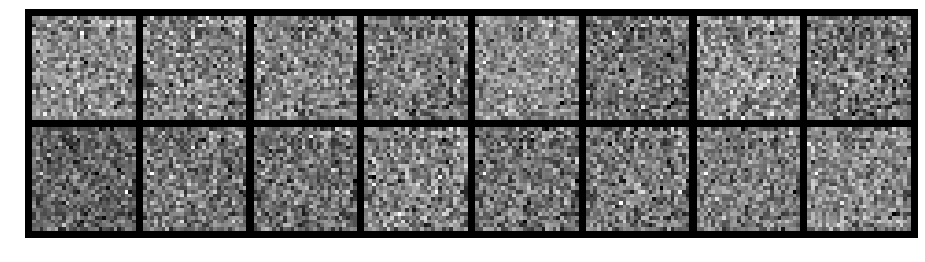

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.4204, Generator Loss: 0.6729
D(x): 0.4942, D(G(z)): 0.5110


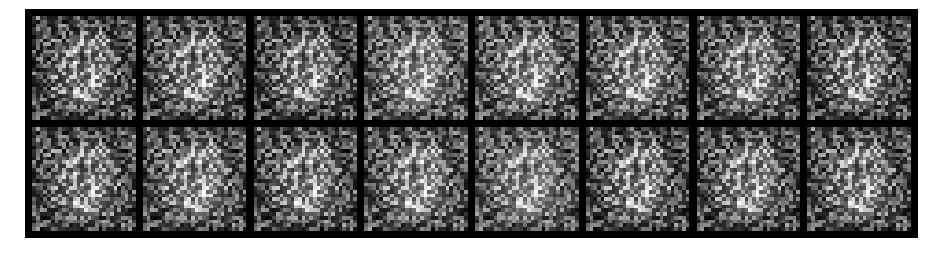

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 0.8606, Generator Loss: 1.9491
D(x): 0.7153, D(G(z)): 0.3362


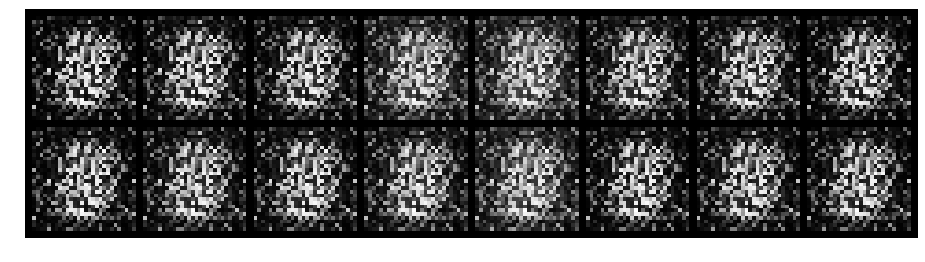

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.4540, Generator Loss: 2.9950
D(x): 0.8677, D(G(z)): 0.2357


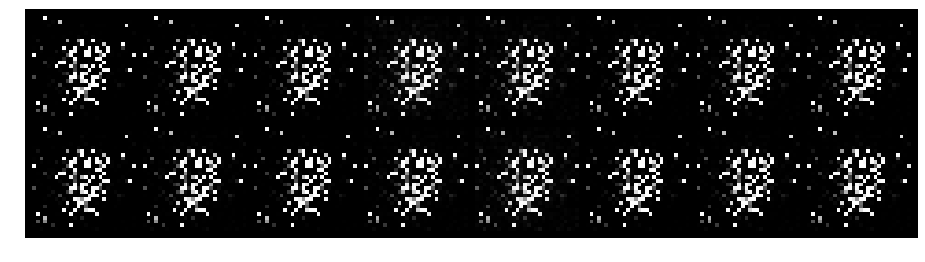

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.0808, Generator Loss: 4.6682
D(x): 0.9632, D(G(z)): 0.0354


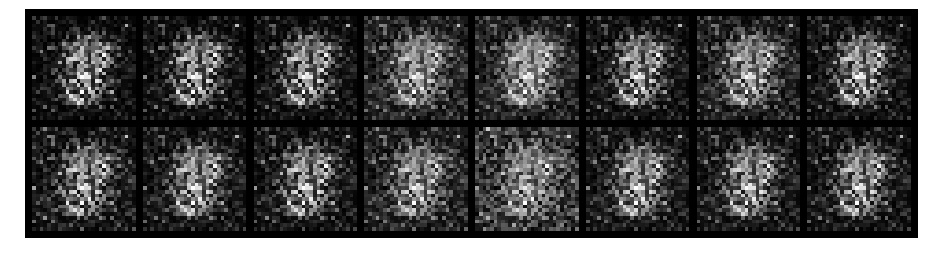

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.8928, Generator Loss: 5.2223
D(x): 0.6101, D(G(z)): 0.1779


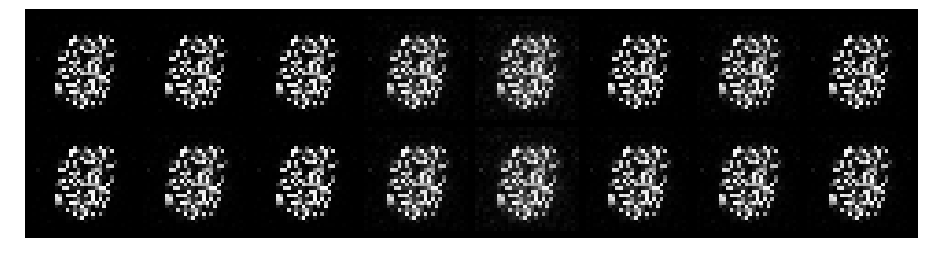

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.6348, Generator Loss: 3.0582
D(x): 0.7687, D(G(z)): 0.2419


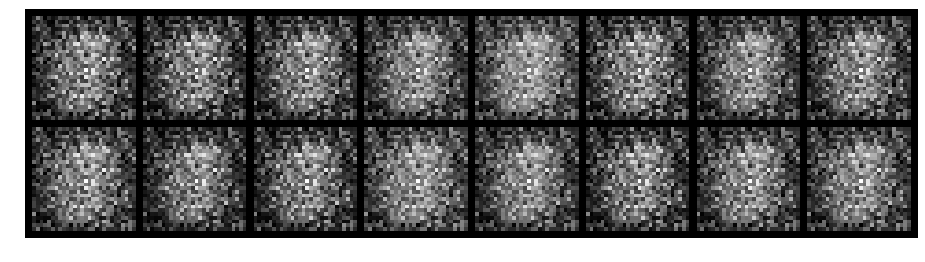

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 1.0477, Generator Loss: 0.9638
D(x): 0.7139, D(G(z)): 0.4898


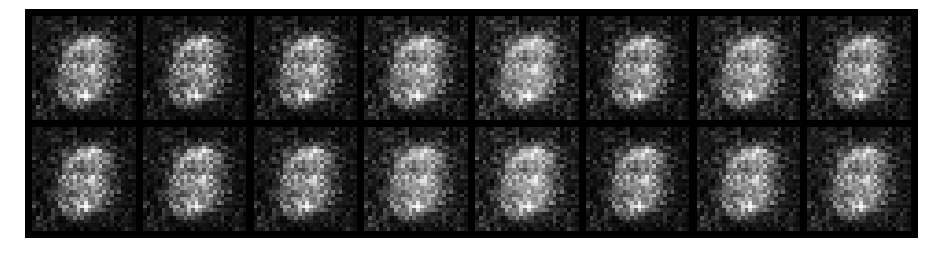

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 1.0703, Generator Loss: 1.3682
D(x): 0.6852, D(G(z)): 0.4286


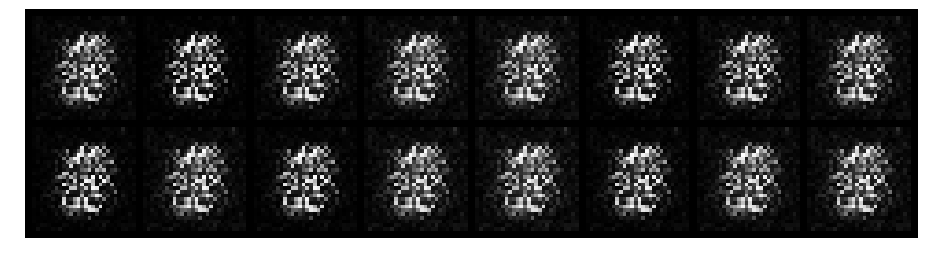

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.6303, Generator Loss: 2.5535
D(x): 0.7295, D(G(z)): 0.2202


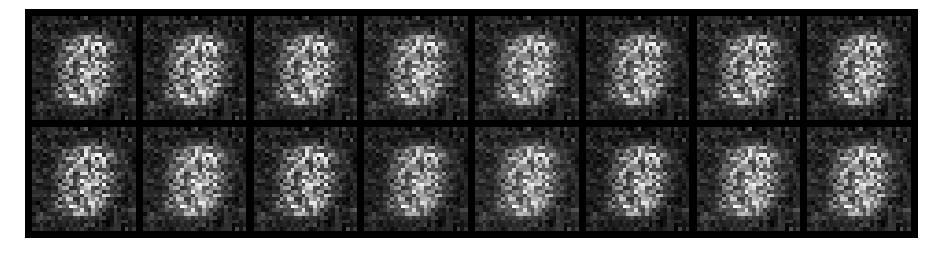

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.9440, Generator Loss: 1.1096
D(x): 0.7420, D(G(z)): 0.4439


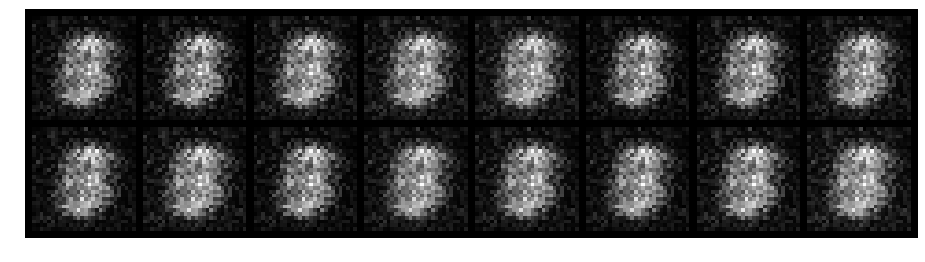

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.9021, Generator Loss: 1.1375
D(x): 0.6620, D(G(z)): 0.3413


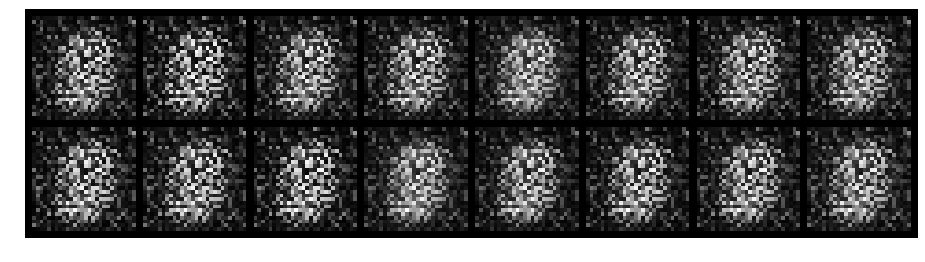

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 0.4344, Generator Loss: 3.9824
D(x): 0.8864, D(G(z)): 0.2121


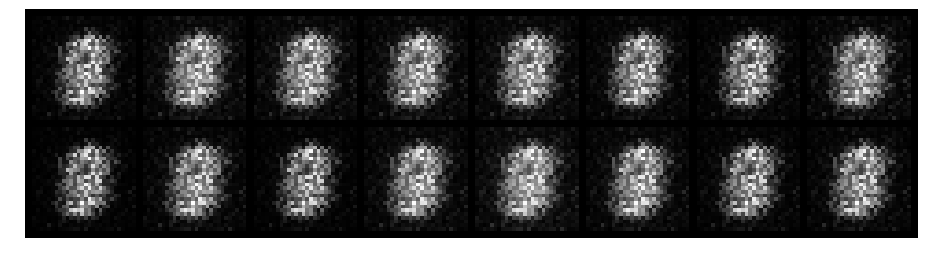

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 1.0664, Generator Loss: 1.0416
D(x): 0.6388, D(G(z)): 0.4373


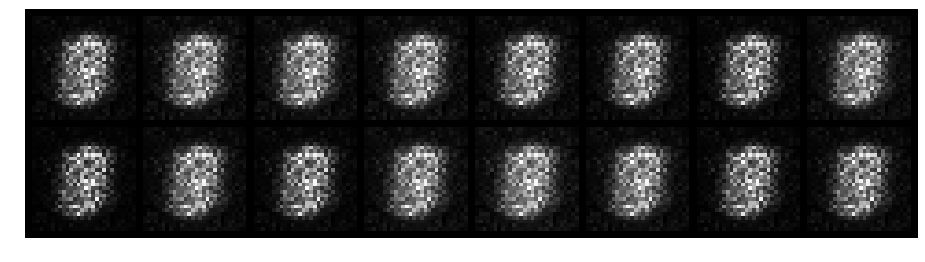

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.8261, Generator Loss: 1.9250
D(x): 0.6825, D(G(z)): 0.2947


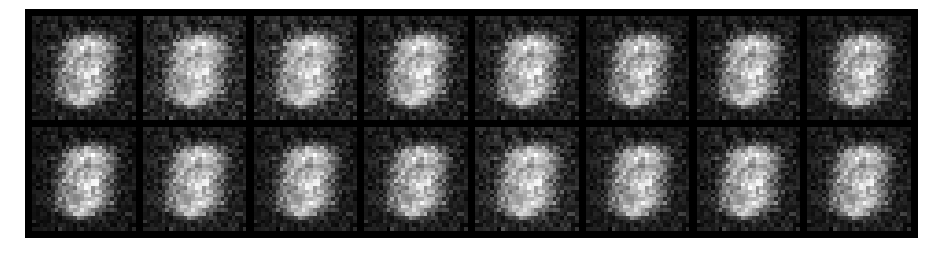

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.1030, Generator Loss: 1.1802
D(x): 0.7320, D(G(z)): 0.4070


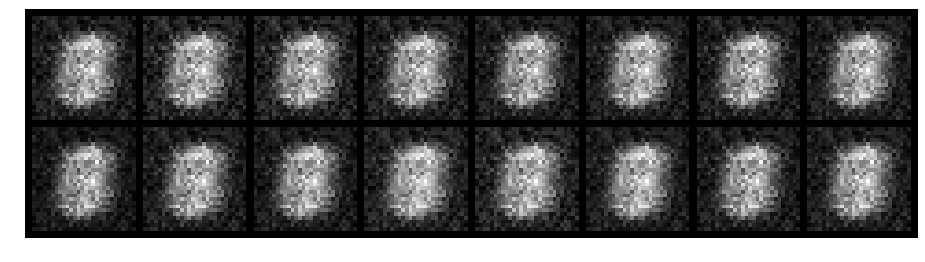

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.8343, Generator Loss: 1.5606
D(x): 0.7544, D(G(z)): 0.3405


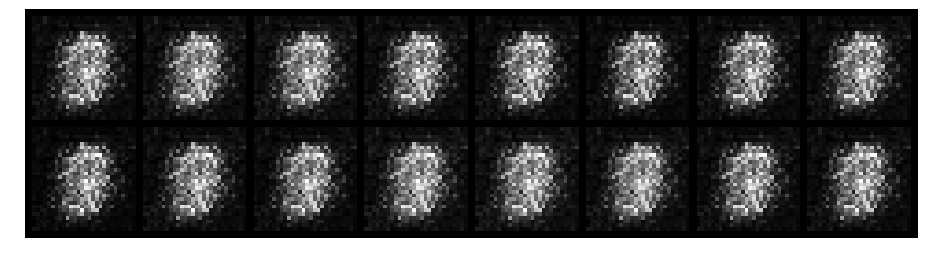

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.5268, Generator Loss: 3.9637
D(x): 0.8001, D(G(z)): 0.1850


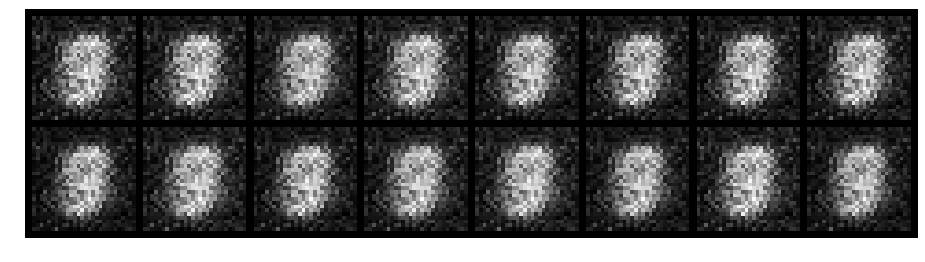

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.9429, Generator Loss: 1.4944
D(x): 0.7252, D(G(z)): 0.3479


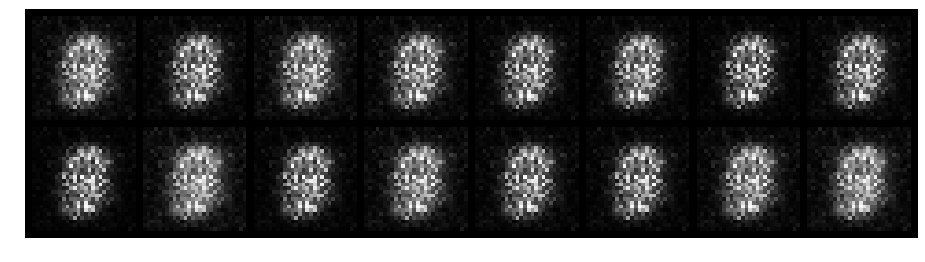

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.7911, Generator Loss: 2.0756
D(x): 0.7230, D(G(z)): 0.2554


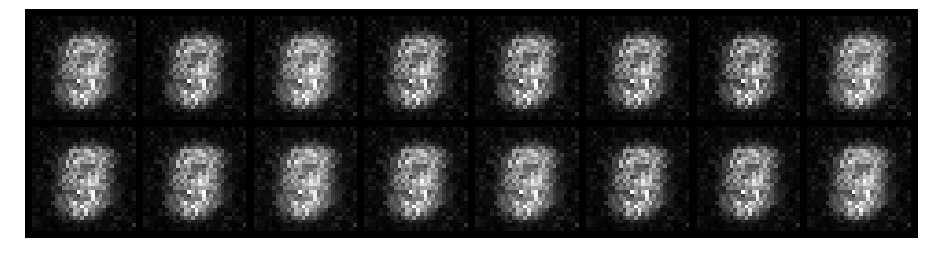

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 1.3148, Generator Loss: 1.7675
D(x): 0.6531, D(G(z)): 0.3998


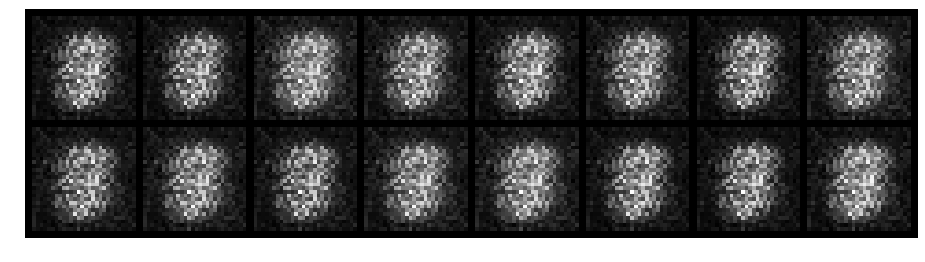

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.4507, Generator Loss: 2.2320
D(x): 0.8501, D(G(z)): 0.2075


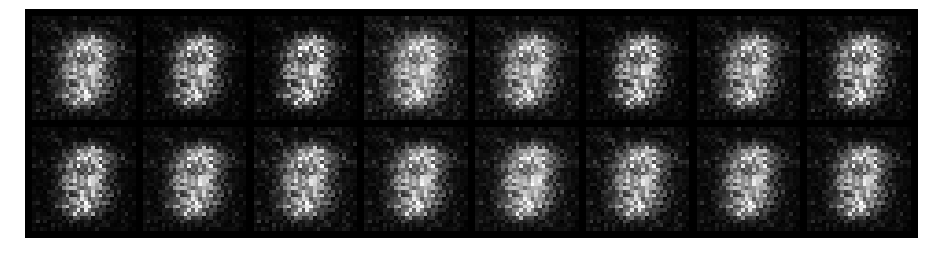

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.3757, Generator Loss: 2.4727
D(x): 0.9117, D(G(z)): 0.2094


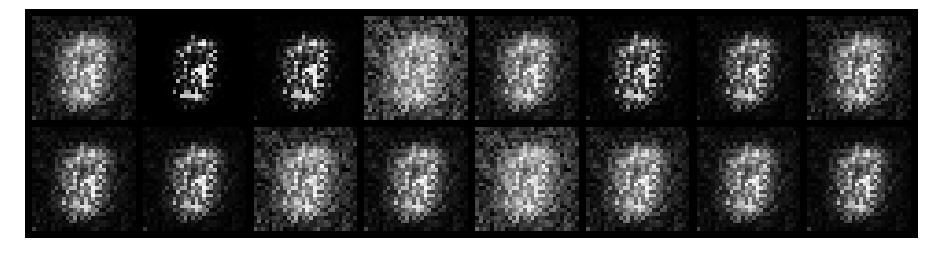

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.6105, Generator Loss: 3.6297
D(x): 0.9553, D(G(z)): 0.2954


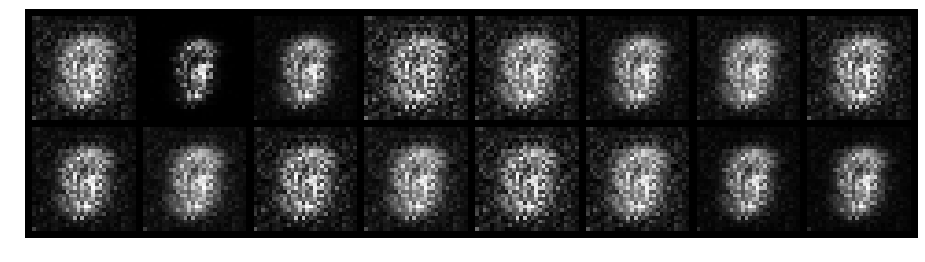

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 1.1596, Generator Loss: 1.1966
D(x): 0.7001, D(G(z)): 0.3726


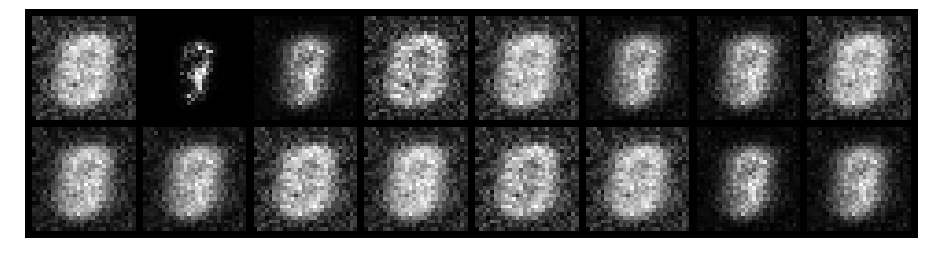

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.6357, Generator Loss: 2.7955
D(x): 0.8504, D(G(z)): 0.1989


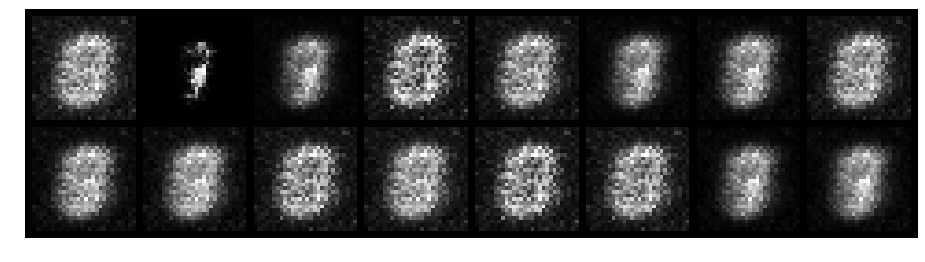

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.6646, Generator Loss: 2.1376
D(x): 0.8230, D(G(z)): 0.2827


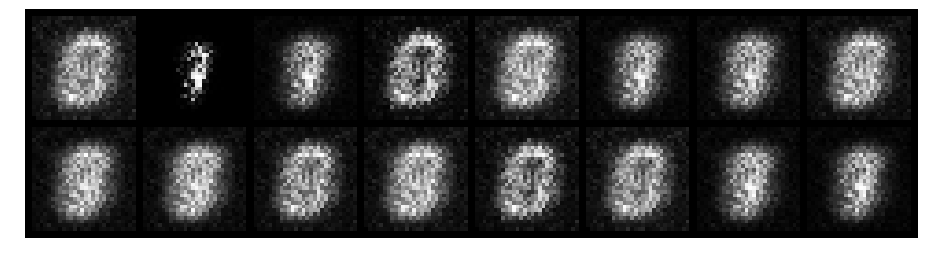

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.8259, Generator Loss: 1.5719
D(x): 0.7479, D(G(z)): 0.2823


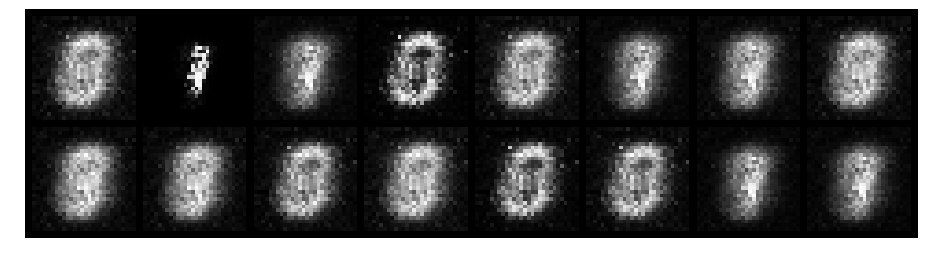

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.4205, Generator Loss: 2.2397
D(x): 0.8718, D(G(z)): 0.1555


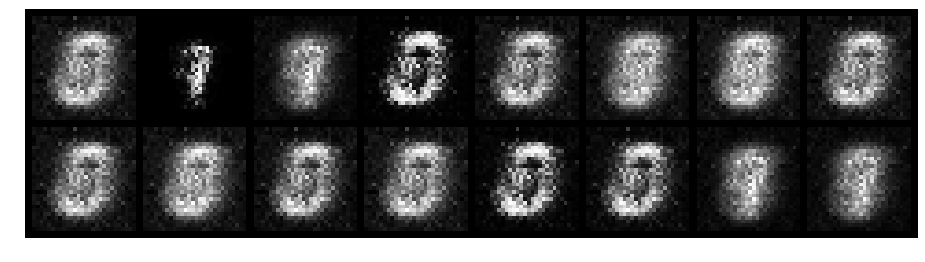

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.5351, Generator Loss: 3.8163
D(x): 0.8050, D(G(z)): 0.0574


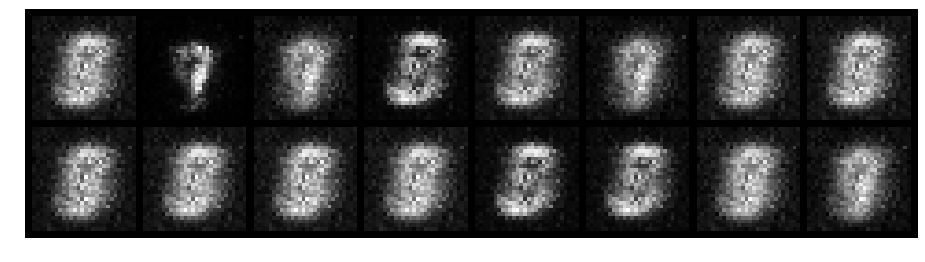

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.4536, Generator Loss: 2.9415
D(x): 0.8507, D(G(z)): 0.0990


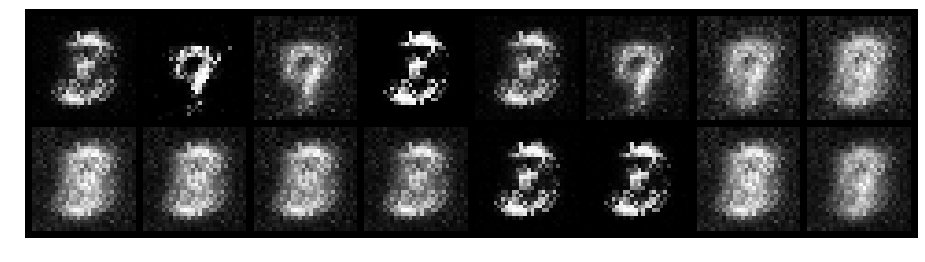

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.6734, Generator Loss: 2.1750
D(x): 0.8488, D(G(z)): 0.2524


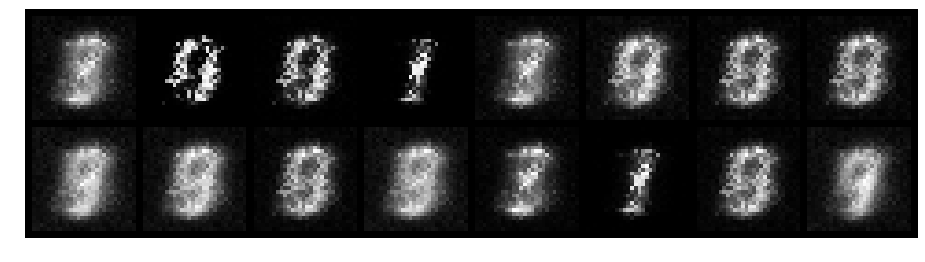

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.9526, Generator Loss: 2.4346
D(x): 0.6891, D(G(z)): 0.2032


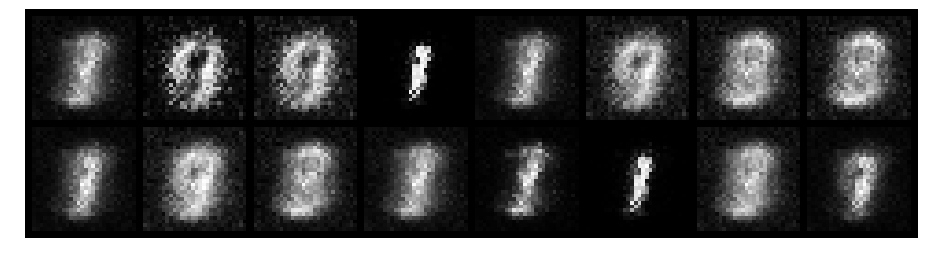

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3786, Generator Loss: 2.3556
D(x): 0.8696, D(G(z)): 0.1471


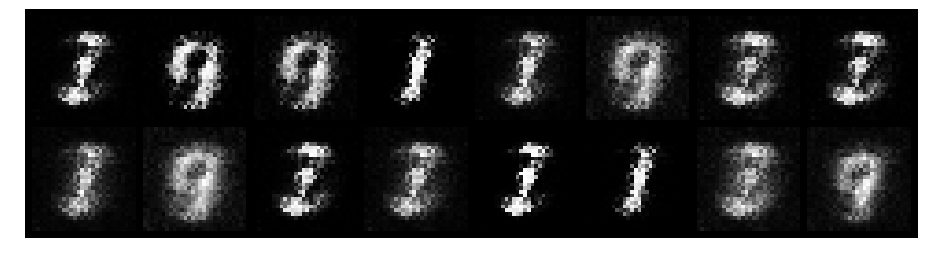

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 1.2998, Generator Loss: 2.3598
D(x): 0.6265, D(G(z)): 0.2105


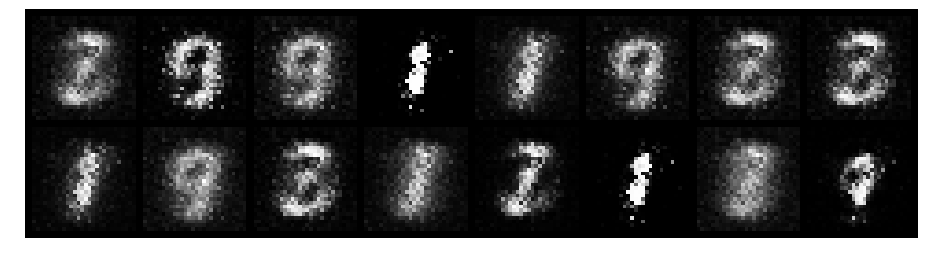

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.2800, Generator Loss: 2.9372
D(x): 0.9281, D(G(z)): 0.1133


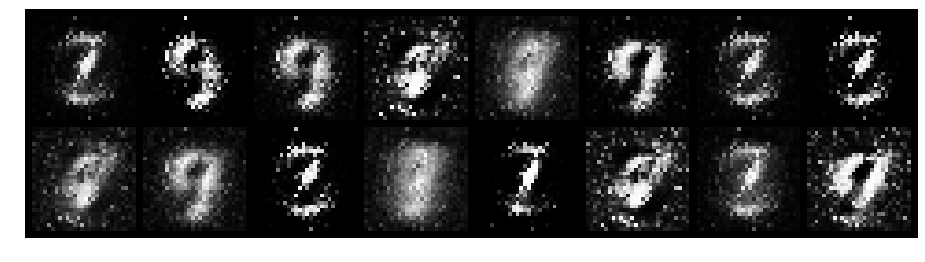

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.4767, Generator Loss: 2.8505
D(x): 0.8659, D(G(z)): 0.1519


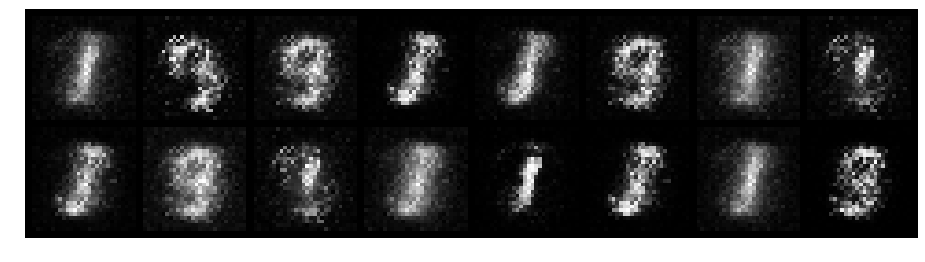

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.2939, Generator Loss: 3.1545
D(x): 0.8762, D(G(z)): 0.0852


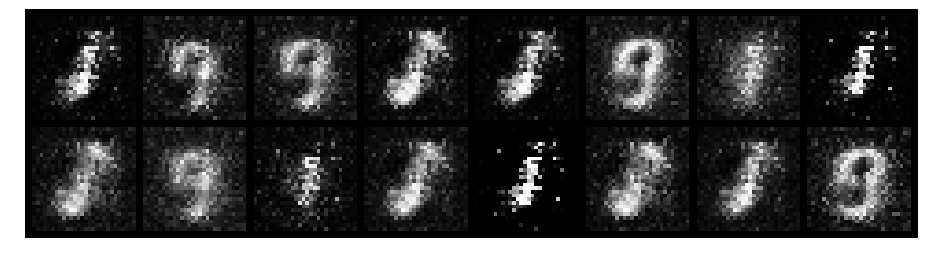

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.4816, Generator Loss: 3.5460
D(x): 0.8604, D(G(z)): 0.1071


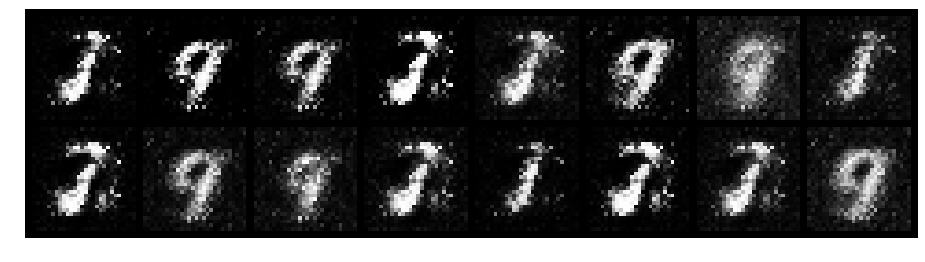

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.4602, Generator Loss: 2.9181
D(x): 0.8667, D(G(z)): 0.1288


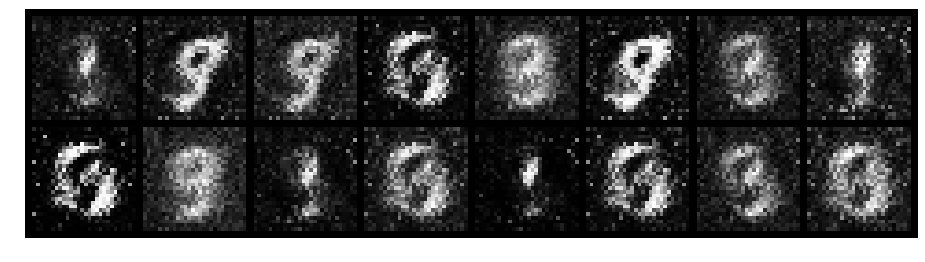

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.2248, Generator Loss: 2.8025
D(x): 0.9303, D(G(z)): 0.1006


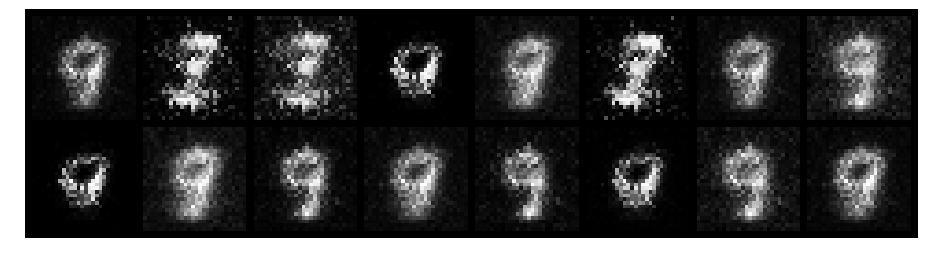

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.9716, Generator Loss: 1.0287
D(x): 0.7826, D(G(z)): 0.4561


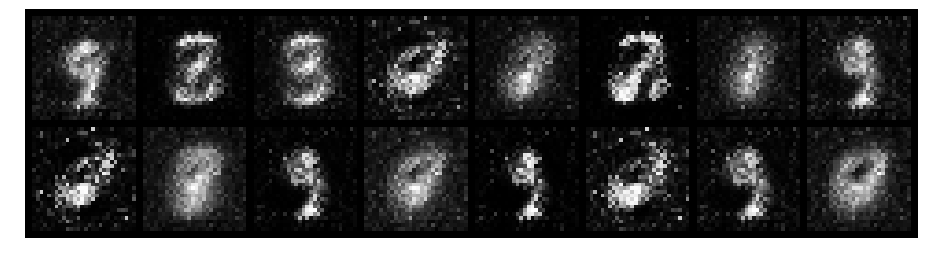

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.6645, Generator Loss: 2.0664
D(x): 0.7947, D(G(z)): 0.2230


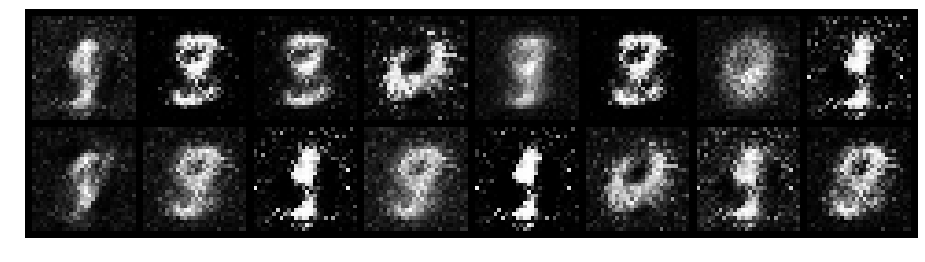

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.4852, Generator Loss: 2.6578
D(x): 0.8931, D(G(z)): 0.2007


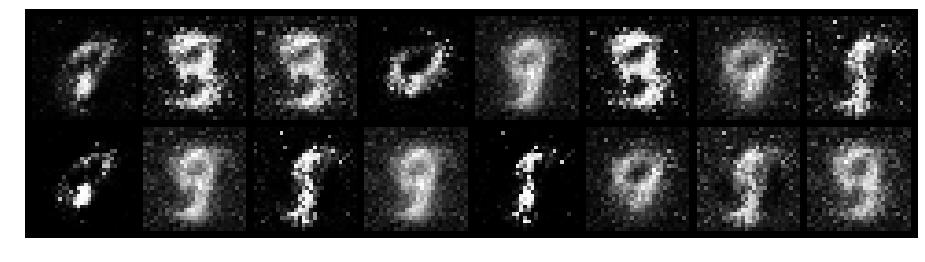

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.5825, Generator Loss: 2.2743
D(x): 0.8130, D(G(z)): 0.2047


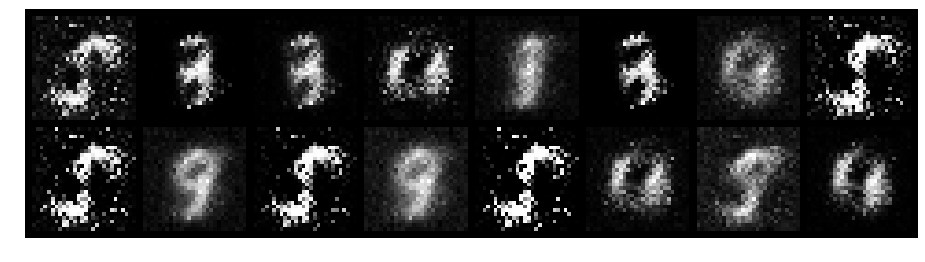

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.7326, Generator Loss: 1.5286
D(x): 0.7881, D(G(z)): 0.3058


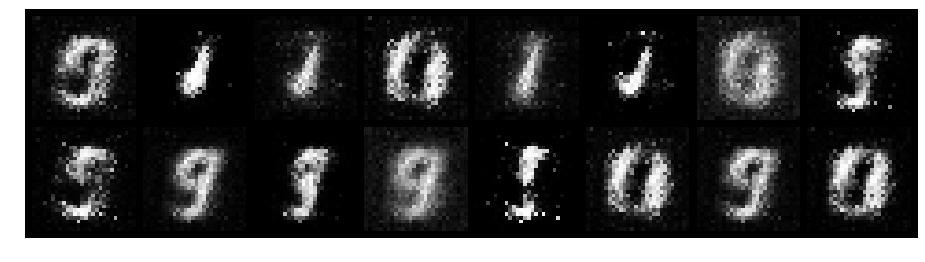

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.4246, Generator Loss: 2.9659
D(x): 0.8483, D(G(z)): 0.1033


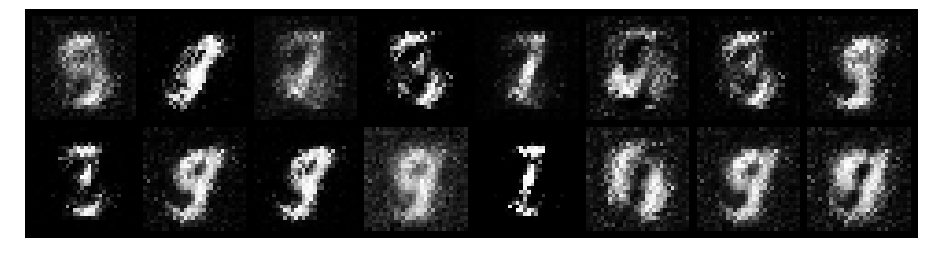

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.4195, Generator Loss: 1.9107
D(x): 0.9179, D(G(z)): 0.2268


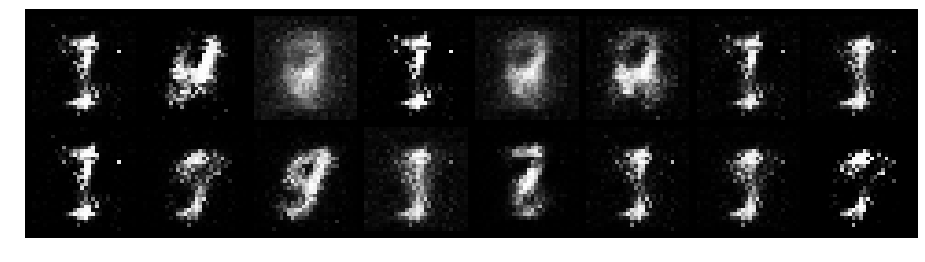

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.2943, Generator Loss: 3.1244
D(x): 0.9316, D(G(z)): 0.1325


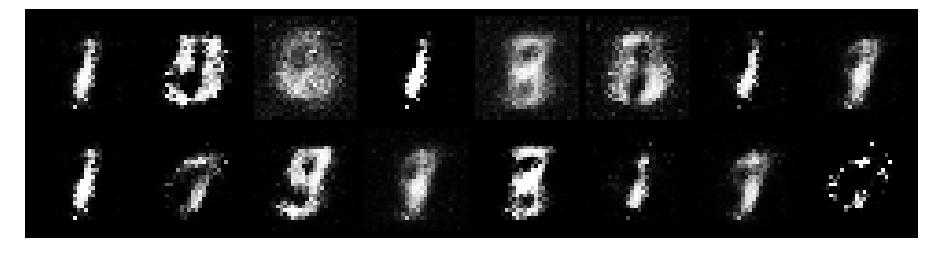

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.4995, Generator Loss: 2.3414
D(x): 0.8299, D(G(z)): 0.1638


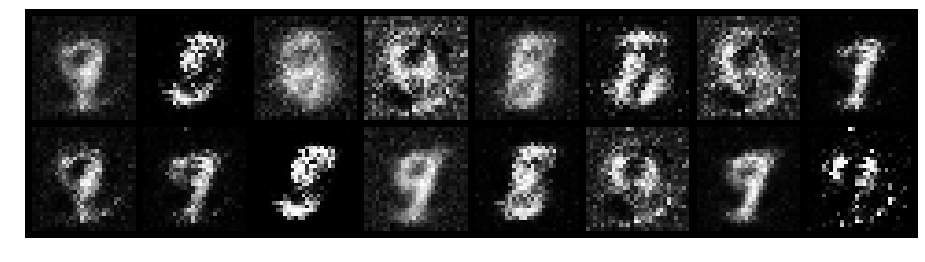

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.7190, Generator Loss: 1.8767
D(x): 0.8503, D(G(z)): 0.2883


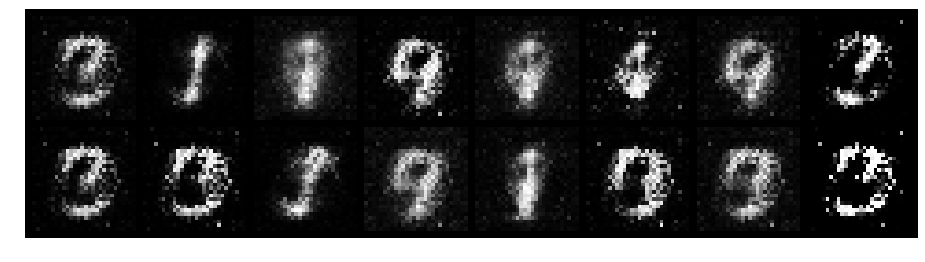

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.5642, Generator Loss: 2.6045
D(x): 0.8073, D(G(z)): 0.1774


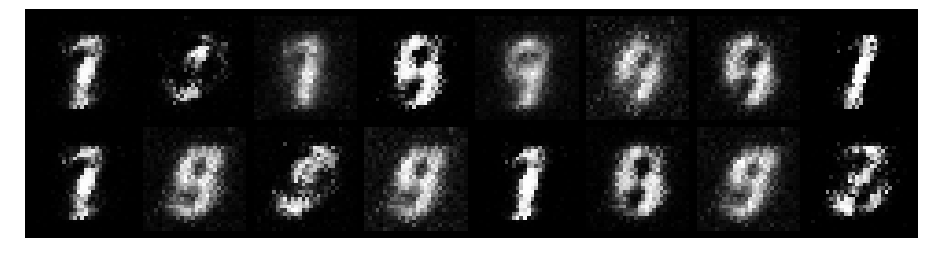

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.8136, Generator Loss: 2.2470
D(x): 0.7345, D(G(z)): 0.2468


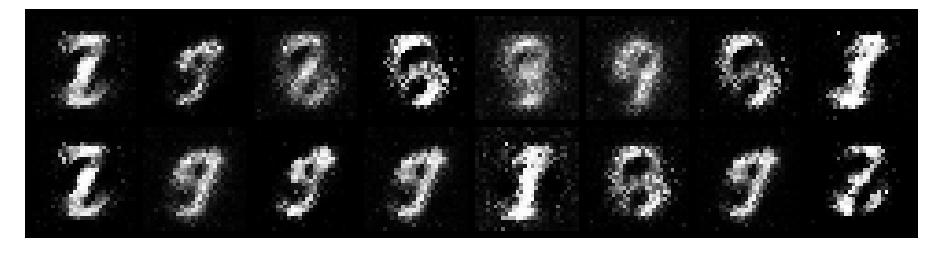

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.4397, Generator Loss: 3.3985
D(x): 0.8284, D(G(z)): 0.0638


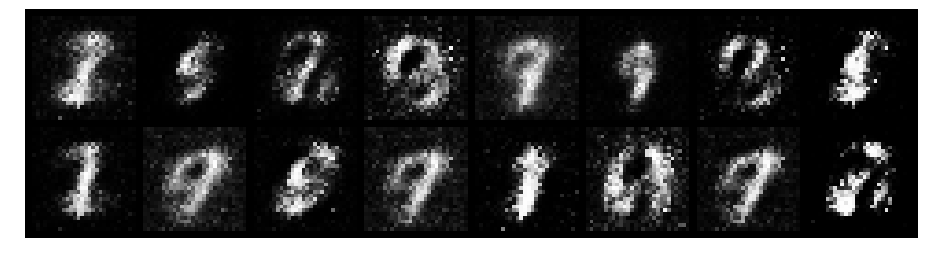

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.8456, Generator Loss: 2.2224
D(x): 0.7390, D(G(z)): 0.2047


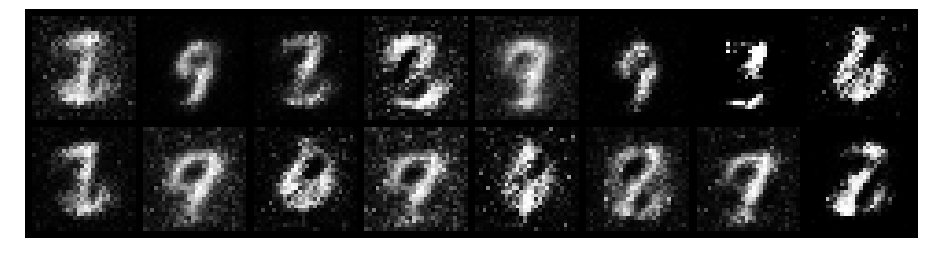

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.7862, Generator Loss: 2.3342
D(x): 0.8169, D(G(z)): 0.2802


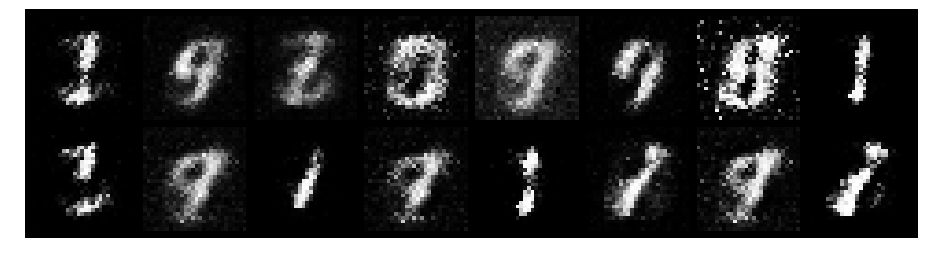

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.6760, Generator Loss: 2.0533
D(x): 0.8836, D(G(z)): 0.2988


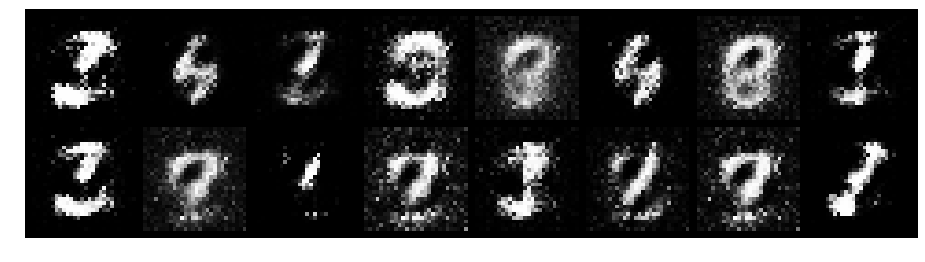

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.4502, Generator Loss: 2.2740
D(x): 0.8577, D(G(z)): 0.1716


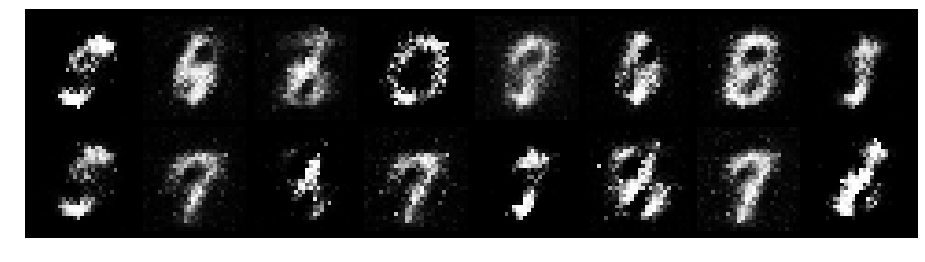

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.3141, Generator Loss: 2.8406
D(x): 0.8741, D(G(z)): 0.0986


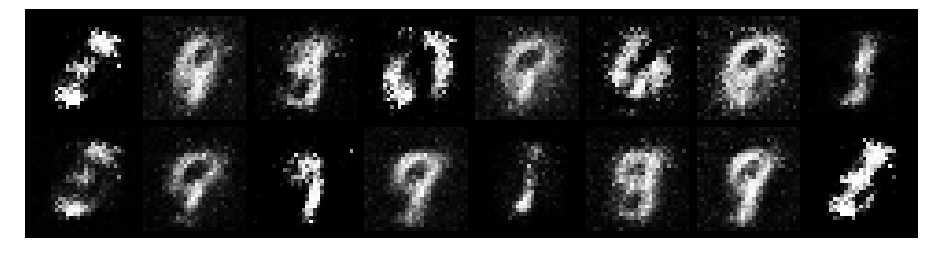

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.3871, Generator Loss: 2.2089
D(x): 0.9225, D(G(z)): 0.2095


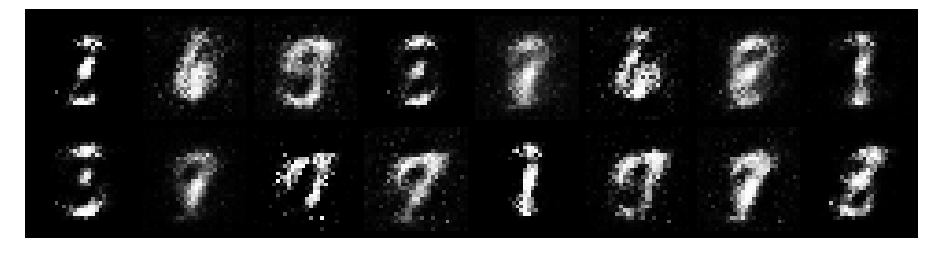

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.7944, Generator Loss: 2.3925
D(x): 0.7616, D(G(z)): 0.2025


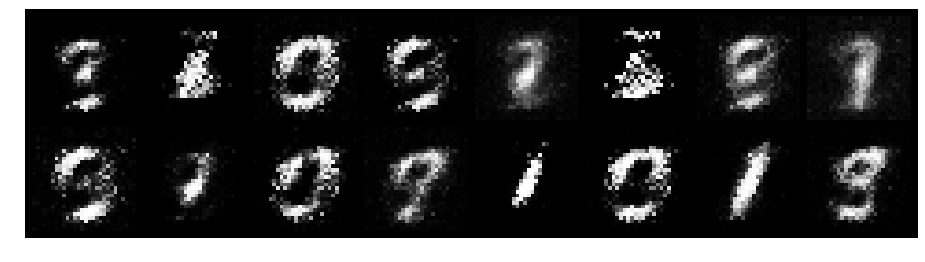

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.6243, Generator Loss: 1.9932
D(x): 0.8058, D(G(z)): 0.2325


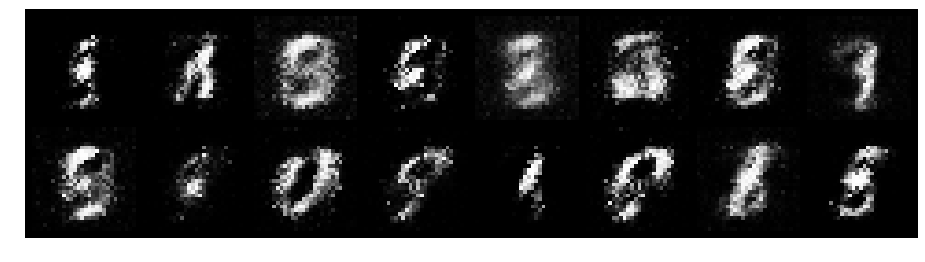

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.5158, Generator Loss: 2.1058
D(x): 0.8558, D(G(z)): 0.2364


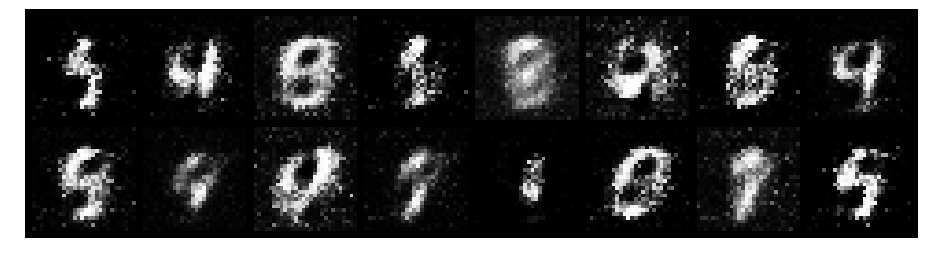

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 1.3255, Generator Loss: 1.4024
D(x): 0.5169, D(G(z)): 0.3298


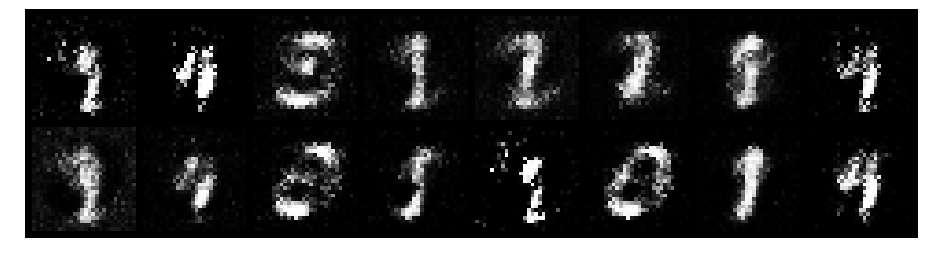

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.6472, Generator Loss: 2.4062
D(x): 0.8686, D(G(z)): 0.2711


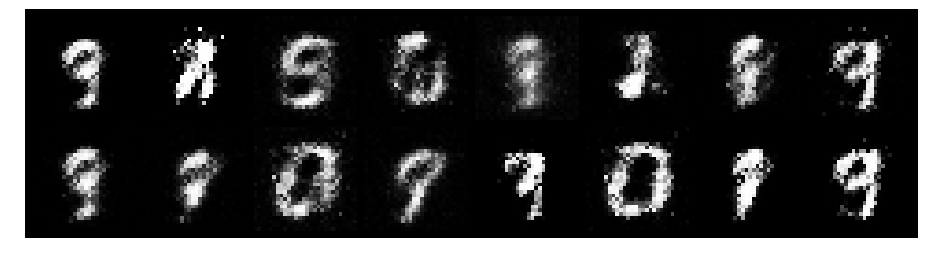

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.5004, Generator Loss: 2.5397
D(x): 0.8061, D(G(z)): 0.1254


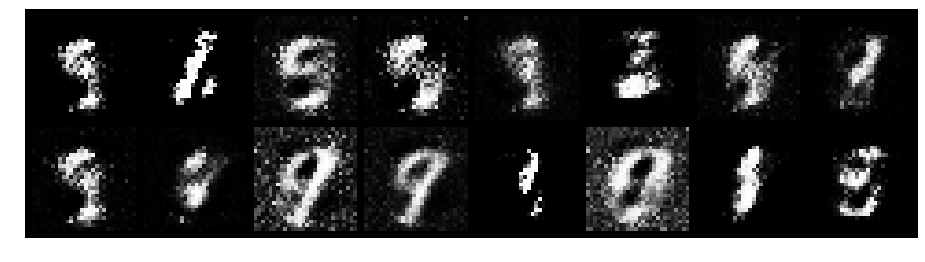

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.4657, Generator Loss: 2.8130
D(x): 0.8567, D(G(z)): 0.1426


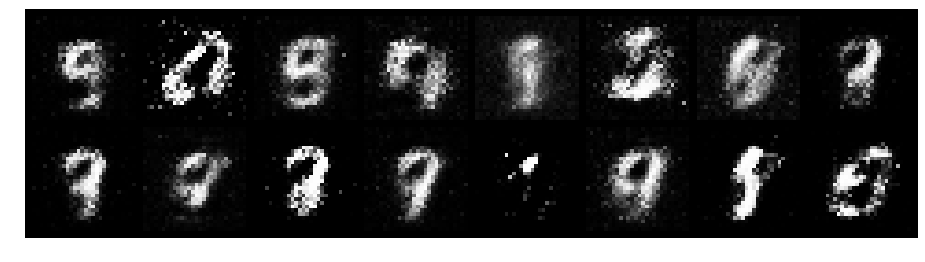

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.4055, Generator Loss: 2.9511
D(x): 0.8497, D(G(z)): 0.1496


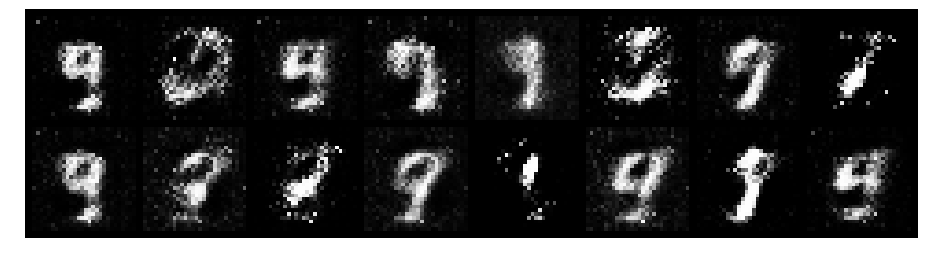

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.5050, Generator Loss: 2.0646
D(x): 0.8761, D(G(z)): 0.2339


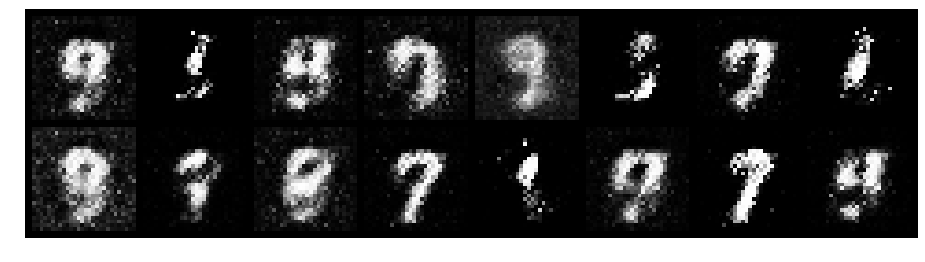

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.8979, Generator Loss: 2.0606
D(x): 0.7778, D(G(z)): 0.2988


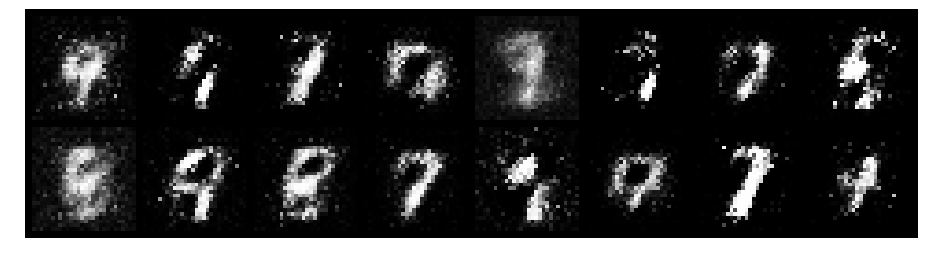

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.7293, Generator Loss: 1.9464
D(x): 0.8180, D(G(z)): 0.2830


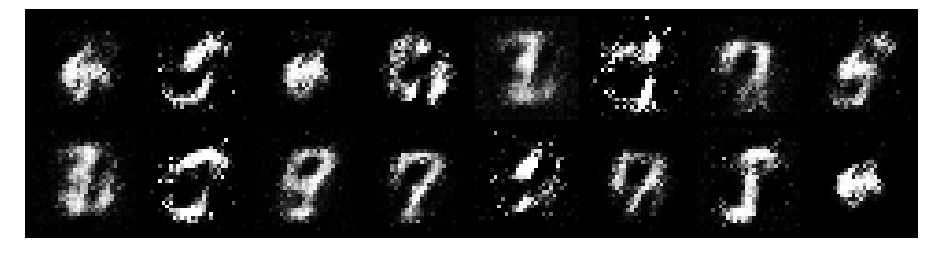

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.9020, Generator Loss: 2.2599
D(x): 0.6602, D(G(z)): 0.1968


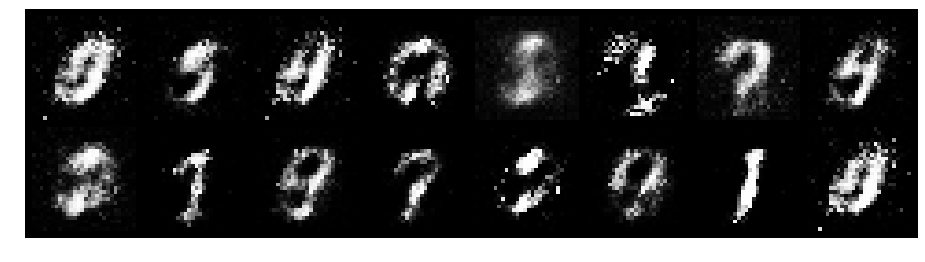

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.6515, Generator Loss: 1.7979
D(x): 0.8339, D(G(z)): 0.2766


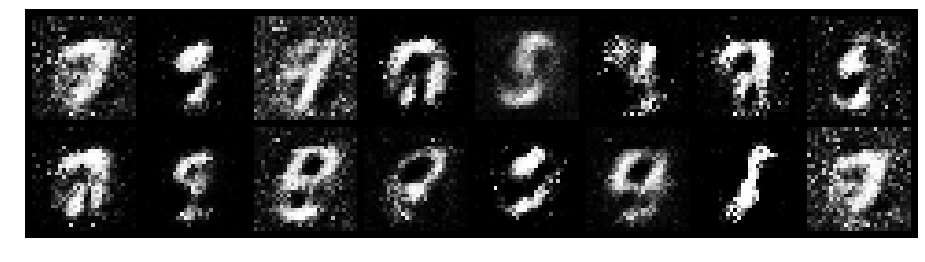

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.6006, Generator Loss: 2.2151
D(x): 0.7898, D(G(z)): 0.1823


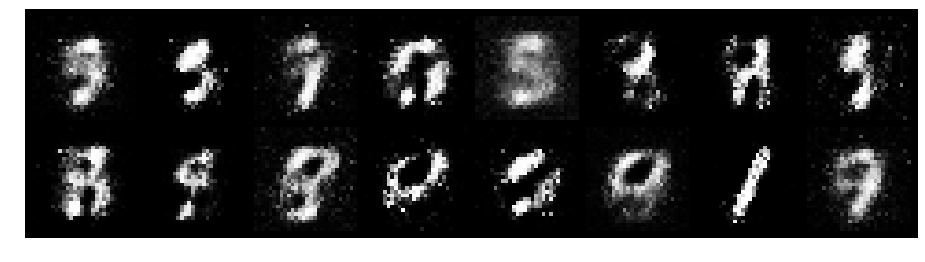

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.8550, Generator Loss: 1.9483
D(x): 0.7612, D(G(z)): 0.2921


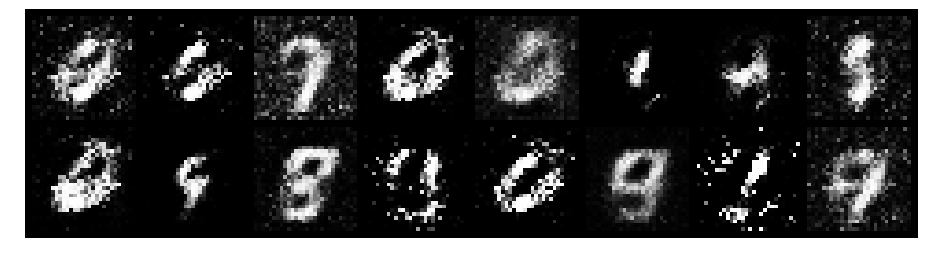

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.7801, Generator Loss: 2.4836
D(x): 0.7024, D(G(z)): 0.2003


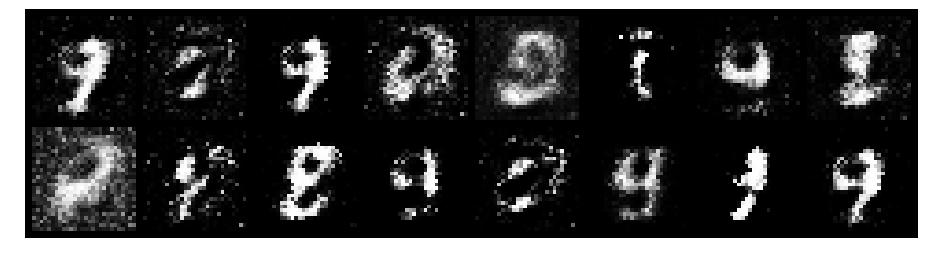

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.5028, Generator Loss: 2.4159
D(x): 0.7870, D(G(z)): 0.1397


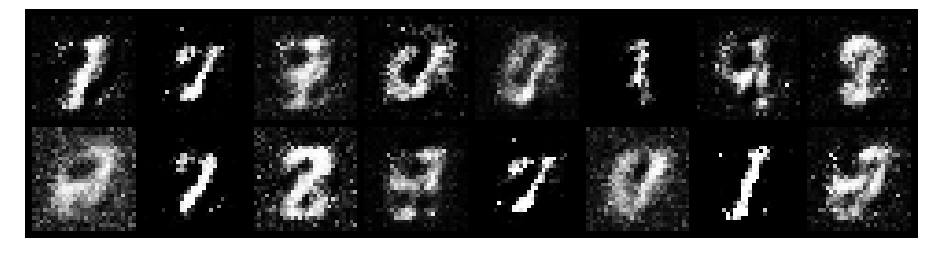

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.6330, Generator Loss: 1.9117
D(x): 0.7821, D(G(z)): 0.2243


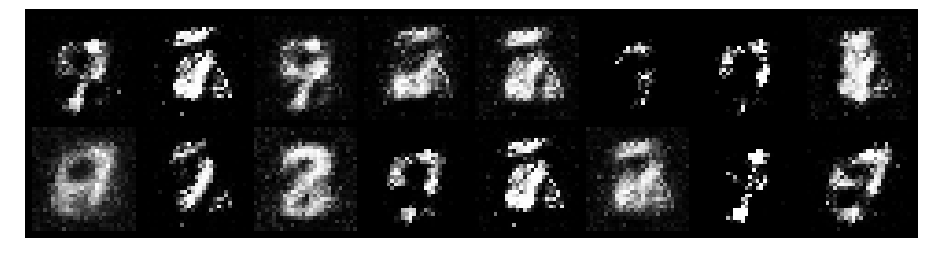

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.5364, Generator Loss: 1.9554
D(x): 0.8355, D(G(z)): 0.2093


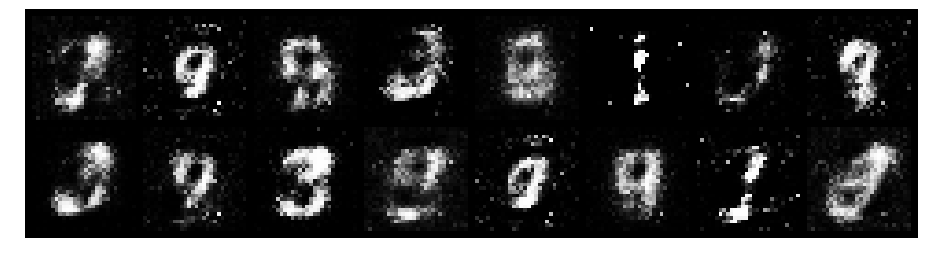

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.7667, Generator Loss: 2.0696
D(x): 0.8158, D(G(z)): 0.2749


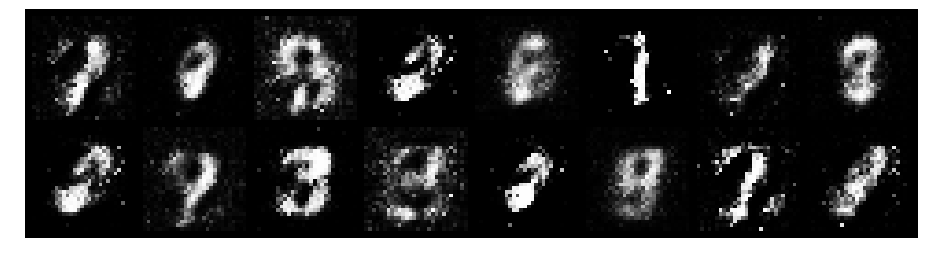

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.5973, Generator Loss: 2.1486
D(x): 0.8288, D(G(z)): 0.2387


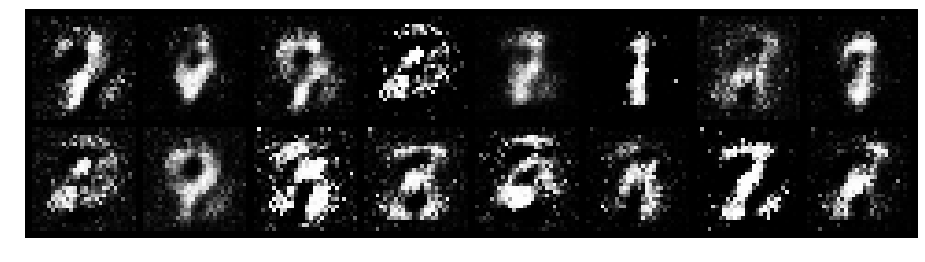

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.9111, Generator Loss: 1.8566
D(x): 0.7486, D(G(z)): 0.3135


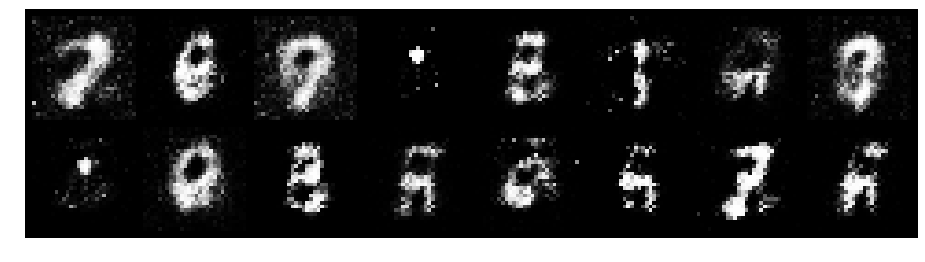

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.7345, Generator Loss: 2.3329
D(x): 0.7647, D(G(z)): 0.1803


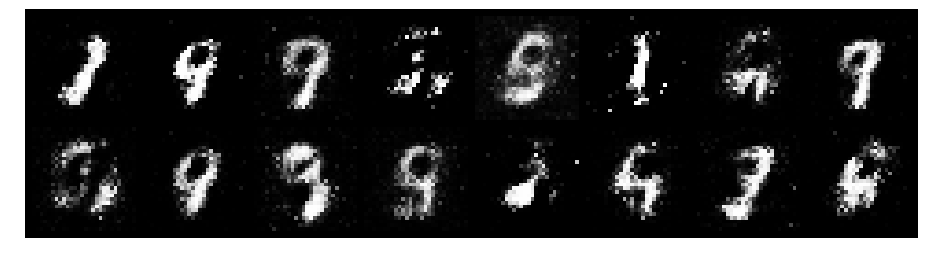

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.5409, Generator Loss: 1.7228
D(x): 0.8345, D(G(z)): 0.2306


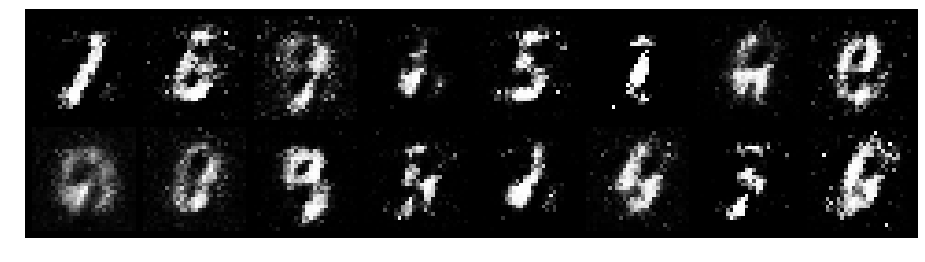

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.8972, Generator Loss: 1.2573
D(x): 0.6785, D(G(z)): 0.3053


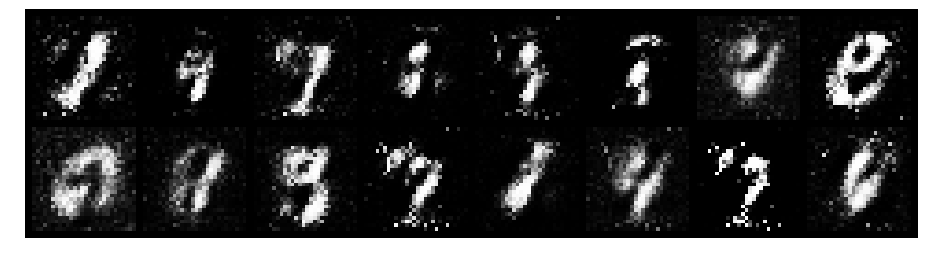

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.7758, Generator Loss: 2.2926
D(x): 0.7145, D(G(z)): 0.1831


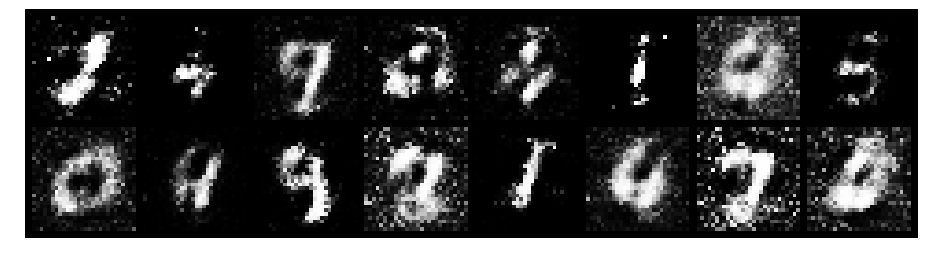

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.9898, Generator Loss: 2.0766
D(x): 0.7472, D(G(z)): 0.3061


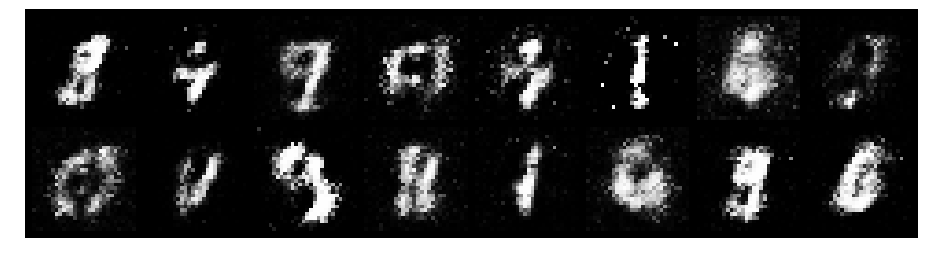

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.7989, Generator Loss: 2.0514
D(x): 0.7123, D(G(z)): 0.2191


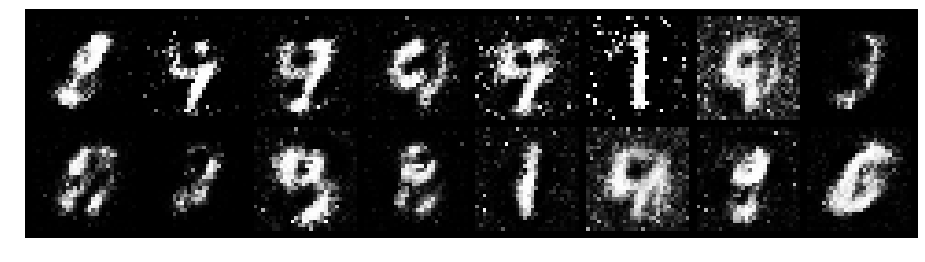

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.8952, Generator Loss: 1.6928
D(x): 0.6728, D(G(z)): 0.2622


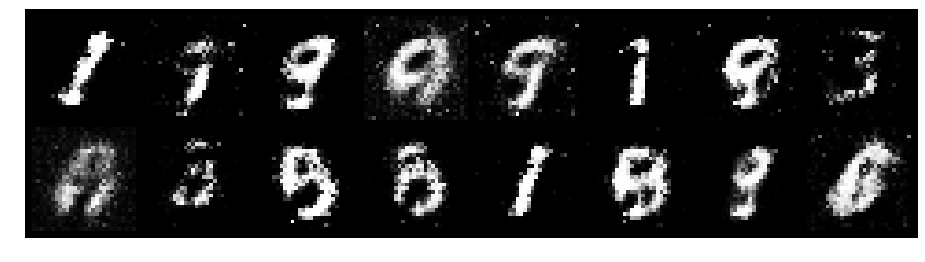

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.8148, Generator Loss: 2.5025
D(x): 0.7148, D(G(z)): 0.1922


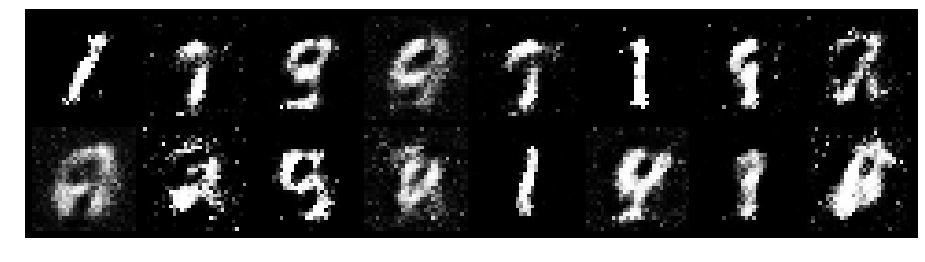

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.6108, Generator Loss: 2.4909
D(x): 0.8101, D(G(z)): 0.1829


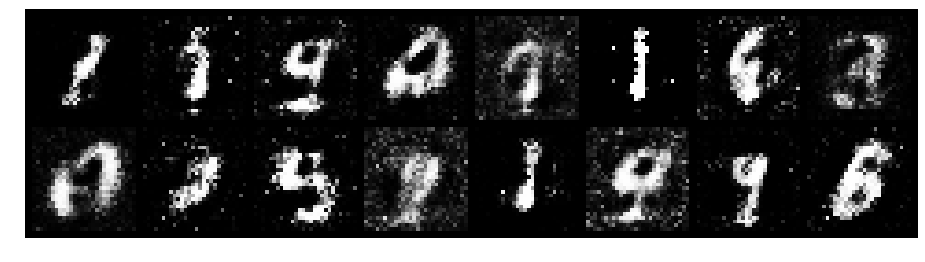

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.5033, Generator Loss: 2.3047
D(x): 0.8427, D(G(z)): 0.1845


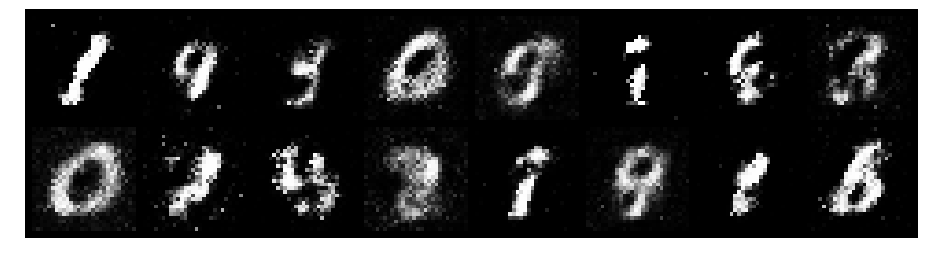

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.7069, Generator Loss: 2.2374
D(x): 0.7788, D(G(z)): 0.2385


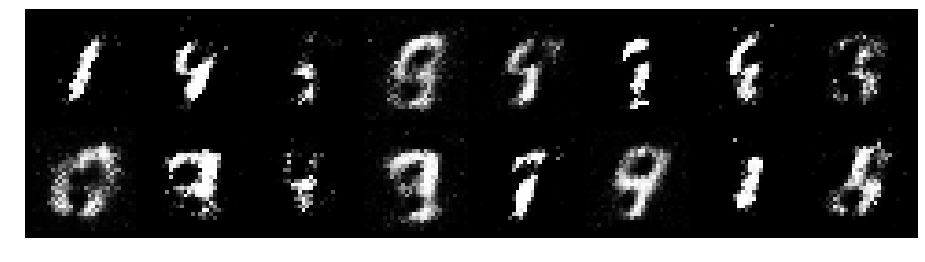

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.8759, Generator Loss: 1.7351
D(x): 0.7824, D(G(z)): 0.3178


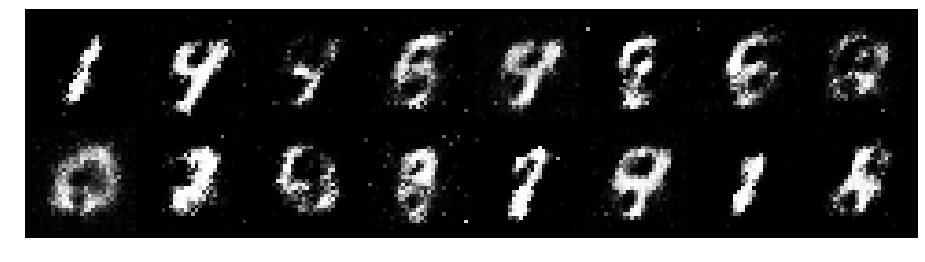

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.7951, Generator Loss: 2.0145
D(x): 0.7453, D(G(z)): 0.2423


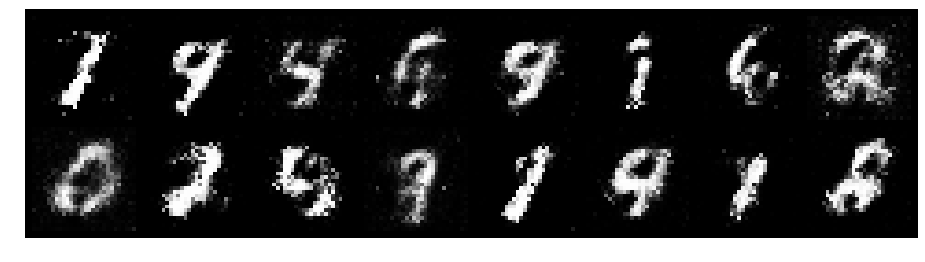

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.7111, Generator Loss: 1.7541
D(x): 0.7634, D(G(z)): 0.2074


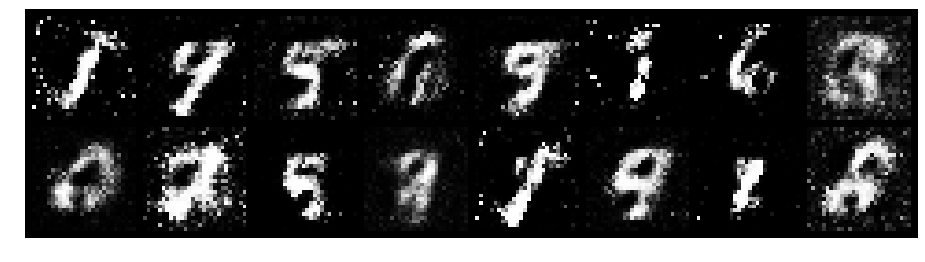

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.9599, Generator Loss: 1.9453
D(x): 0.6380, D(G(z)): 0.1948


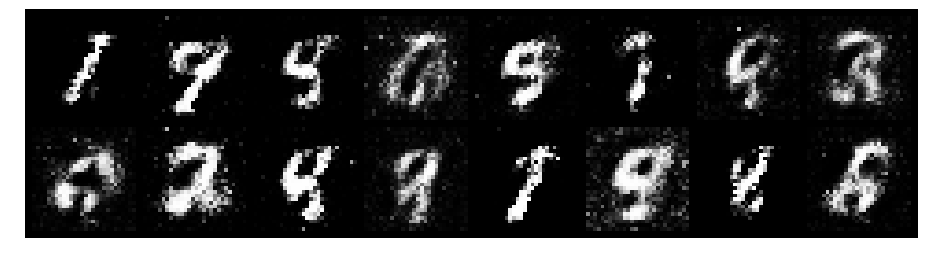

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.8836, Generator Loss: 1.5259
D(x): 0.7588, D(G(z)): 0.3377


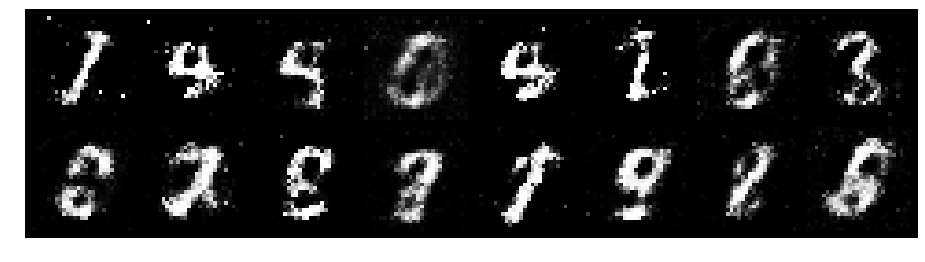

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.7714, Generator Loss: 1.5451
D(x): 0.7368, D(G(z)): 0.2662


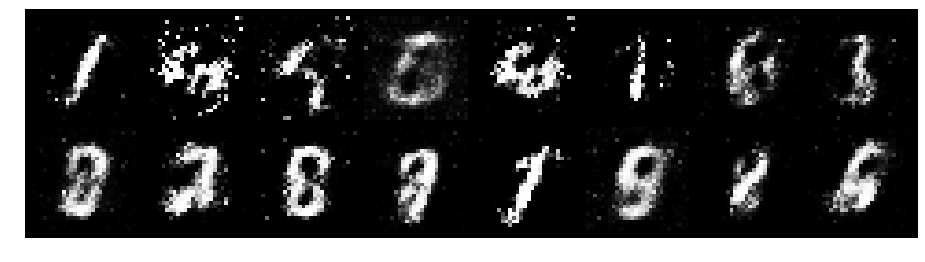

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 1.0355, Generator Loss: 1.4853
D(x): 0.6400, D(G(z)): 0.2941


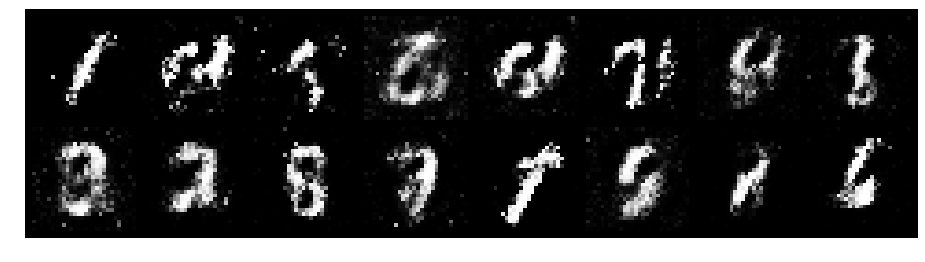

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.7405, Generator Loss: 1.6506
D(x): 0.7378, D(G(z)): 0.2350


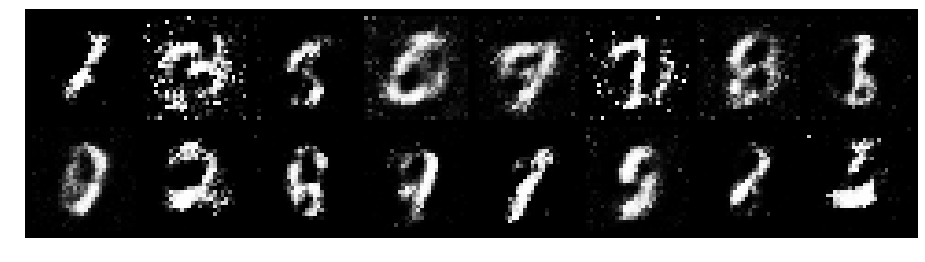

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.8336, Generator Loss: 1.6596
D(x): 0.7940, D(G(z)): 0.3311


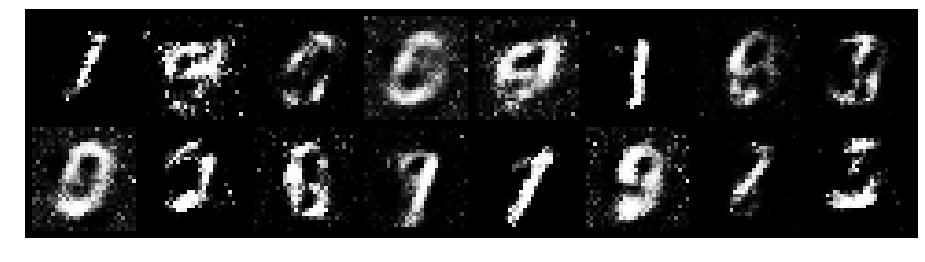

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.9966, Generator Loss: 1.8485
D(x): 0.6238, D(G(z)): 0.2768


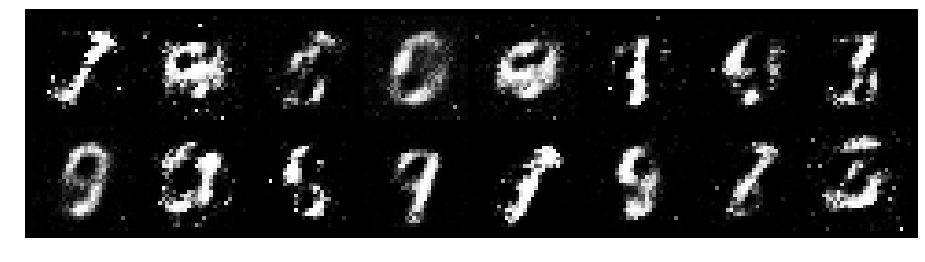

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 1.1417, Generator Loss: 1.8197
D(x): 0.6116, D(G(z)): 0.3042


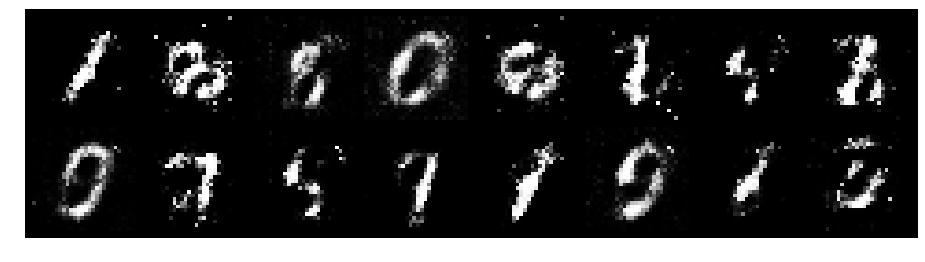

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 0.9550, Generator Loss: 1.6144
D(x): 0.6801, D(G(z)): 0.3024


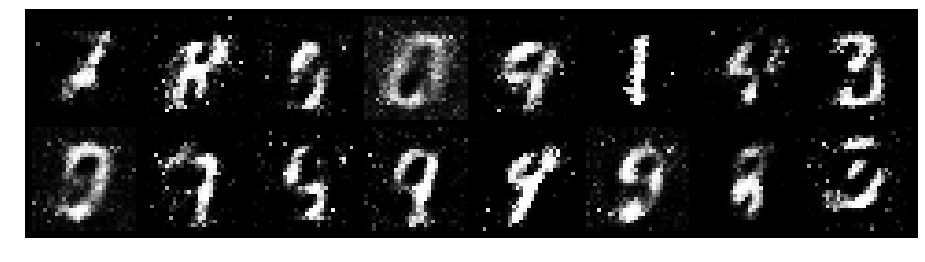

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.9449, Generator Loss: 1.5852
D(x): 0.7071, D(G(z)): 0.3080


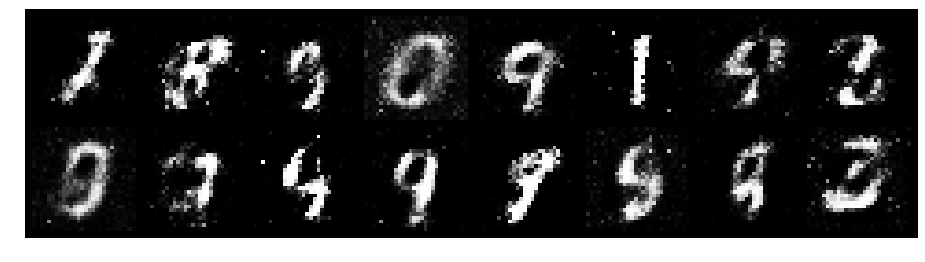

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 1.0169, Generator Loss: 1.4440
D(x): 0.7546, D(G(z)): 0.3856


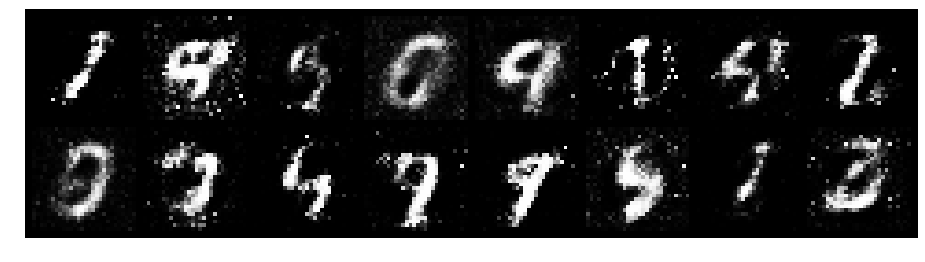

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.8958, Generator Loss: 1.9020
D(x): 0.7097, D(G(z)): 0.2680


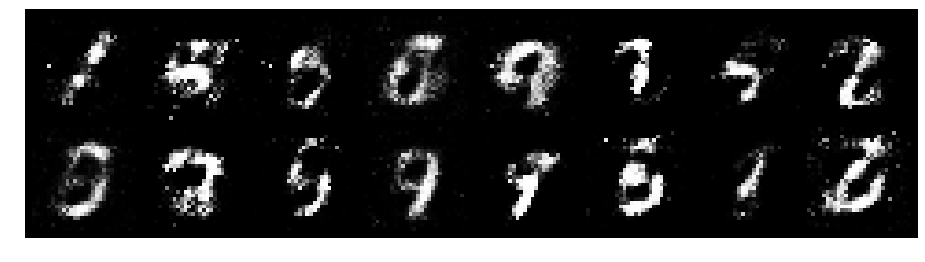

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.6055, Generator Loss: 2.3680
D(x): 0.7883, D(G(z)): 0.1789


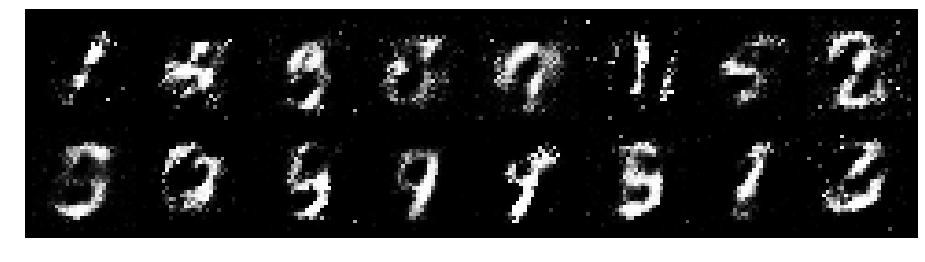

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.8829, Generator Loss: 1.6743
D(x): 0.6838, D(G(z)): 0.2481


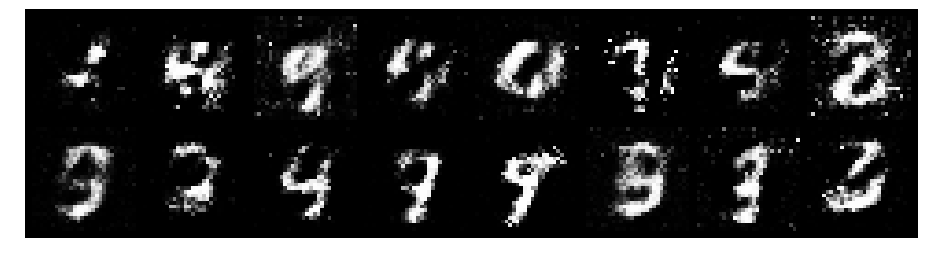

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.7452, Generator Loss: 1.8942
D(x): 0.7202, D(G(z)): 0.2416


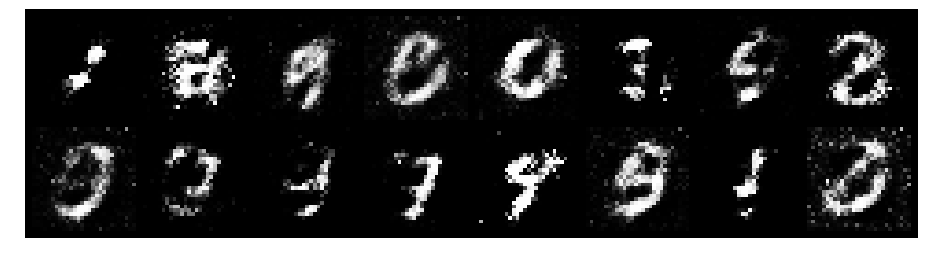

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.7498, Generator Loss: 1.6790
D(x): 0.7746, D(G(z)): 0.2983


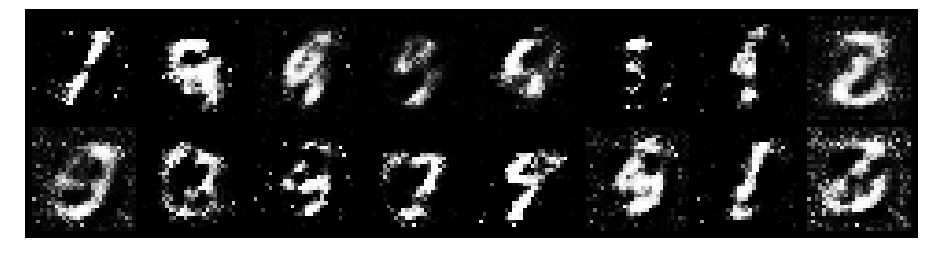

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.8105, Generator Loss: 1.9980
D(x): 0.7583, D(G(z)): 0.2705


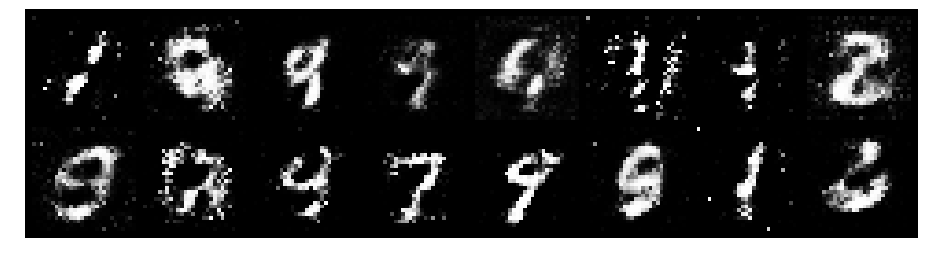

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.6710, Generator Loss: 2.0283
D(x): 0.7660, D(G(z)): 0.2055


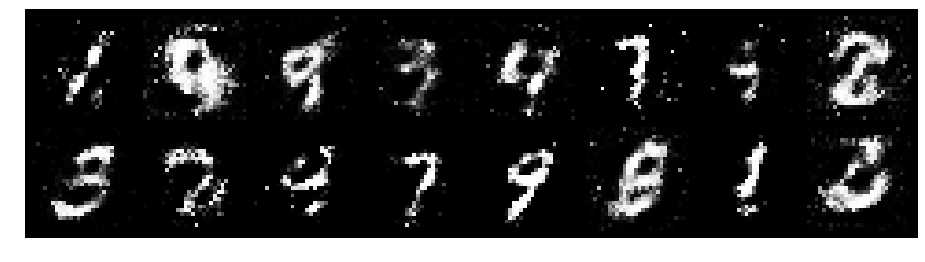

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.9693, Generator Loss: 1.8076
D(x): 0.7881, D(G(z)): 0.3496


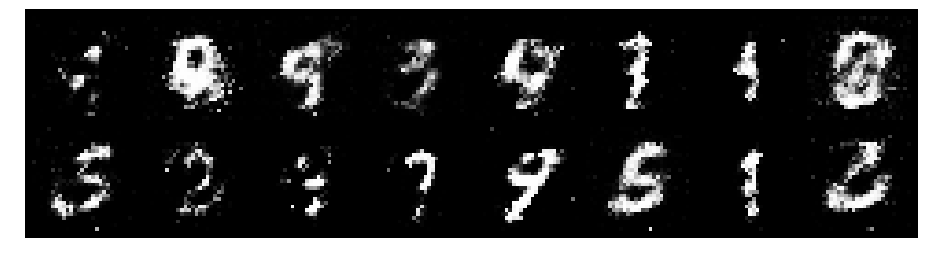

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.8310, Generator Loss: 1.3978
D(x): 0.6794, D(G(z)): 0.2430


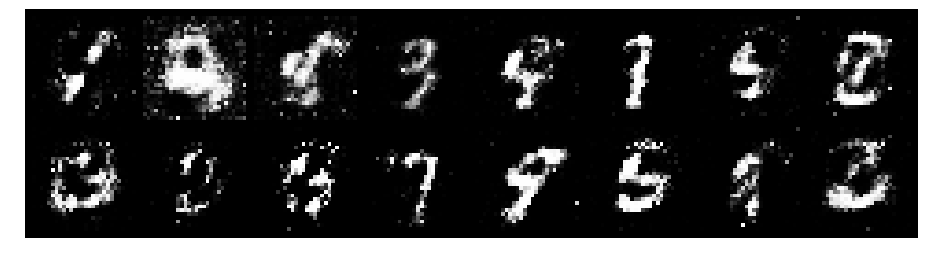

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.9946, Generator Loss: 1.3678
D(x): 0.7239, D(G(z)): 0.3761


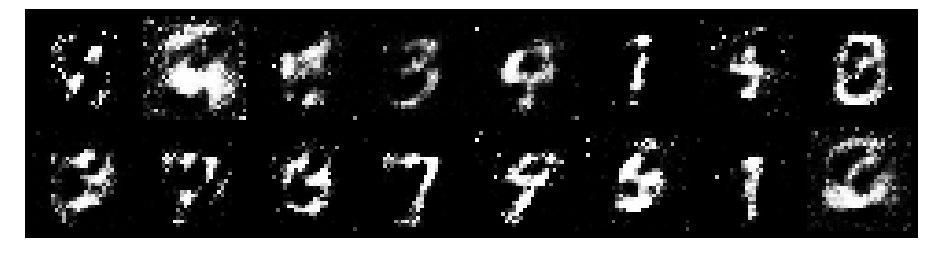

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 1.1419, Generator Loss: 2.0220
D(x): 0.6336, D(G(z)): 0.2551


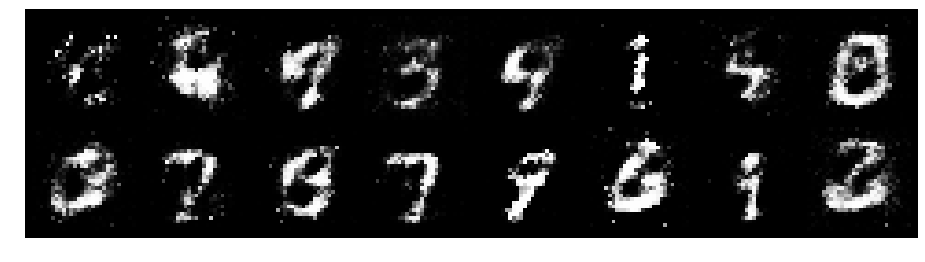

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.8825, Generator Loss: 1.6268
D(x): 0.7381, D(G(z)): 0.3109


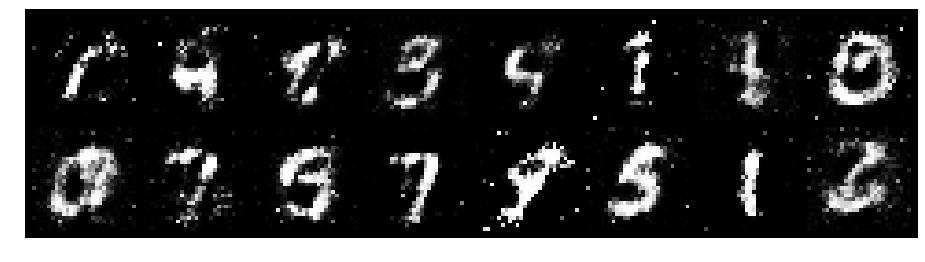

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.8229, Generator Loss: 1.6003
D(x): 0.6993, D(G(z)): 0.2831


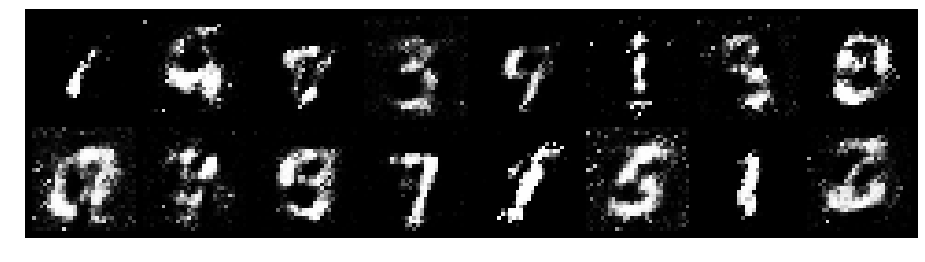

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.7776, Generator Loss: 2.0047
D(x): 0.7412, D(G(z)): 0.2536


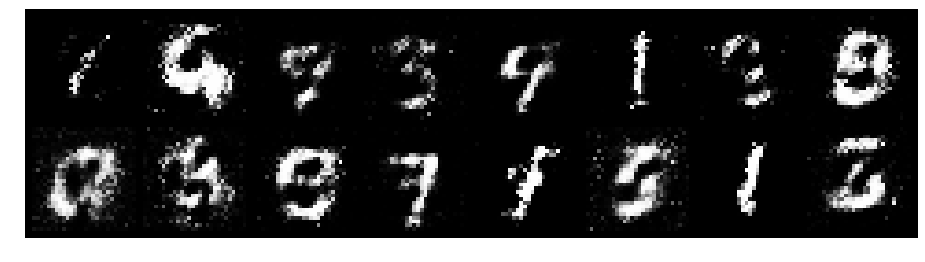

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.7706, Generator Loss: 1.8454
D(x): 0.7597, D(G(z)): 0.2647


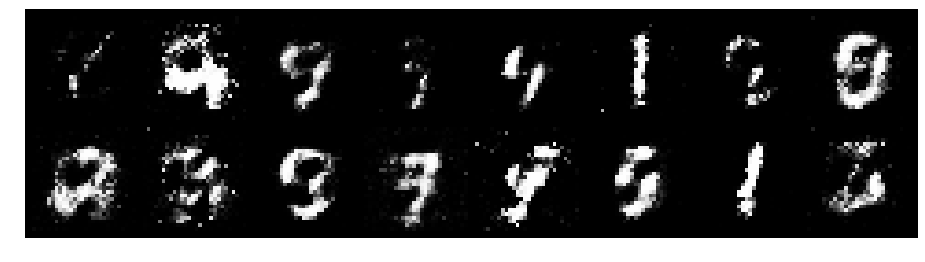

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.6404, Generator Loss: 2.0670
D(x): 0.7640, D(G(z)): 0.1998


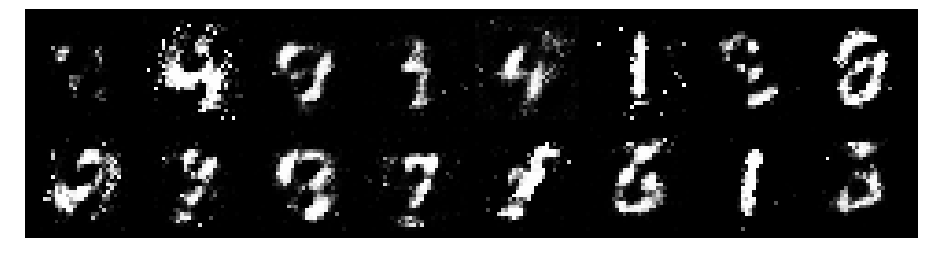

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.9238, Generator Loss: 1.1936
D(x): 0.7012, D(G(z)): 0.2831


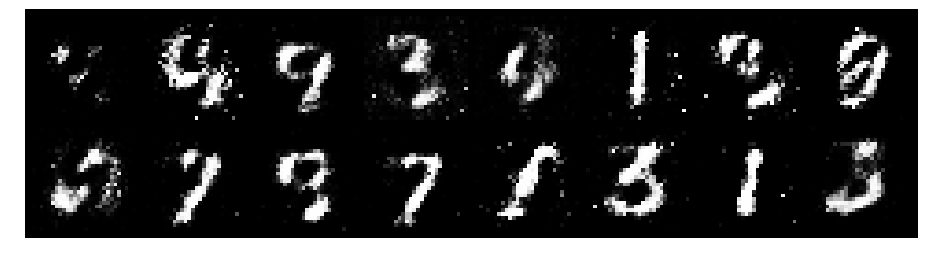

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 1.0194, Generator Loss: 1.9504
D(x): 0.7046, D(G(z)): 0.2949


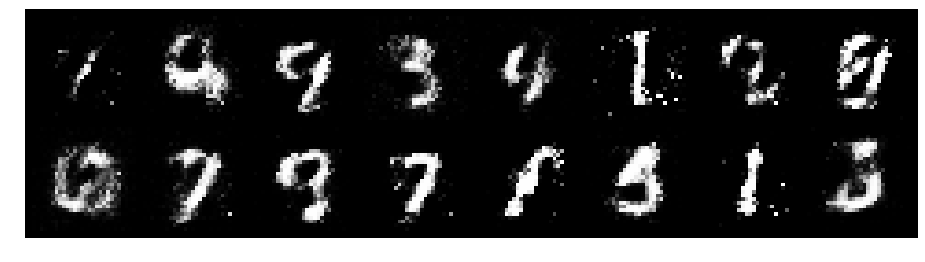

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.9604, Generator Loss: 1.5903
D(x): 0.6749, D(G(z)): 0.3081


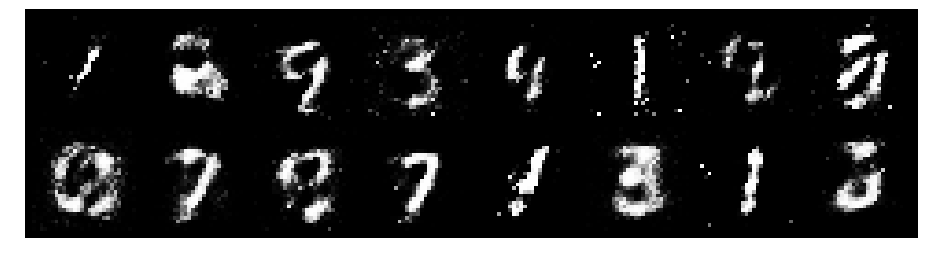

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 1.0076, Generator Loss: 1.2888
D(x): 0.7127, D(G(z)): 0.3621


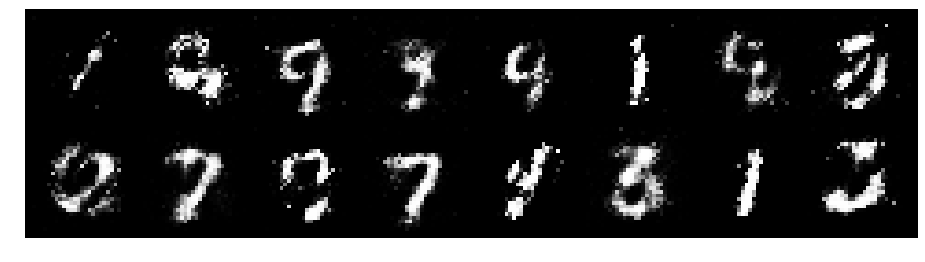

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.8096, Generator Loss: 2.3649
D(x): 0.7566, D(G(z)): 0.2653


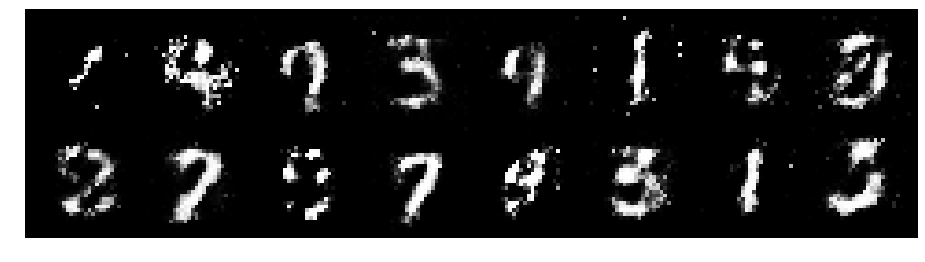

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 1.0562, Generator Loss: 1.3388
D(x): 0.7042, D(G(z)): 0.3675


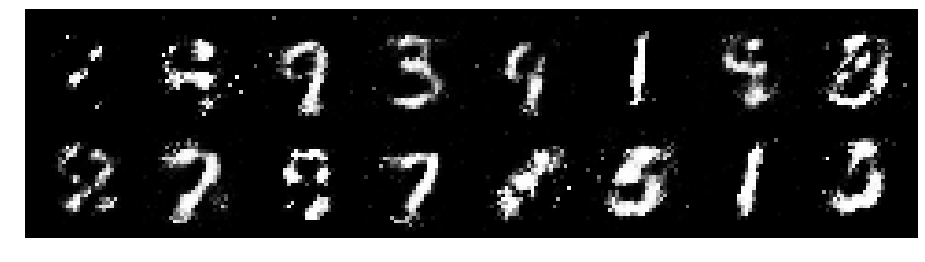

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.9252, Generator Loss: 2.0739
D(x): 0.6789, D(G(z)): 0.2747


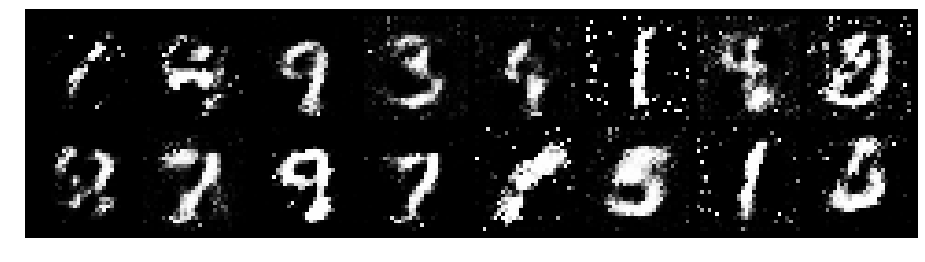

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 1.1068, Generator Loss: 1.5346
D(x): 0.6188, D(G(z)): 0.2928


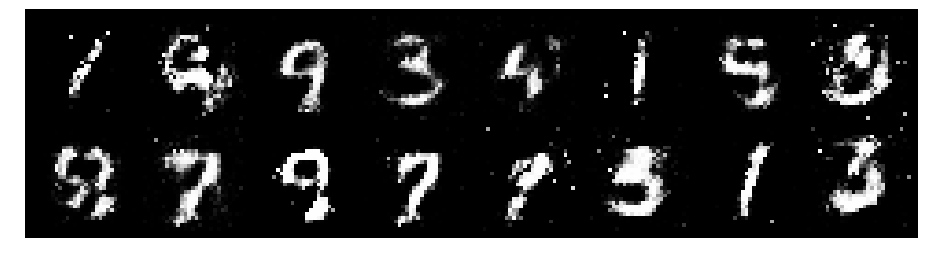

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.9822, Generator Loss: 1.4026
D(x): 0.7247, D(G(z)): 0.3625


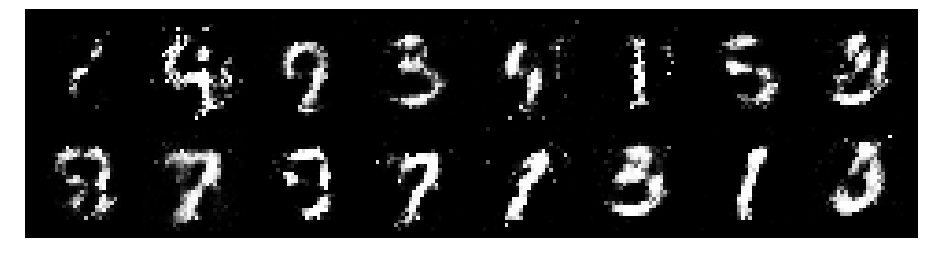

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.9402, Generator Loss: 1.4378
D(x): 0.6572, D(G(z)): 0.3052


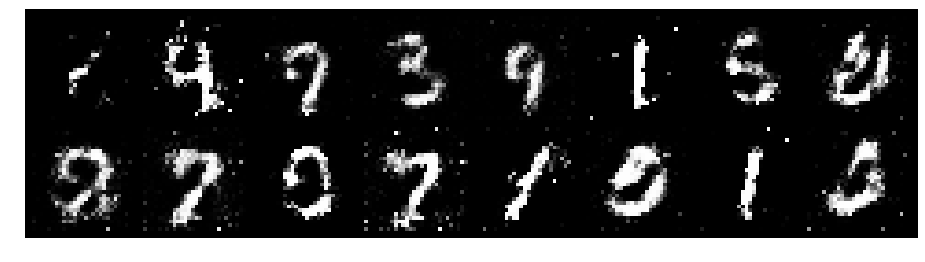

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.8660, Generator Loss: 1.8025
D(x): 0.6500, D(G(z)): 0.1996


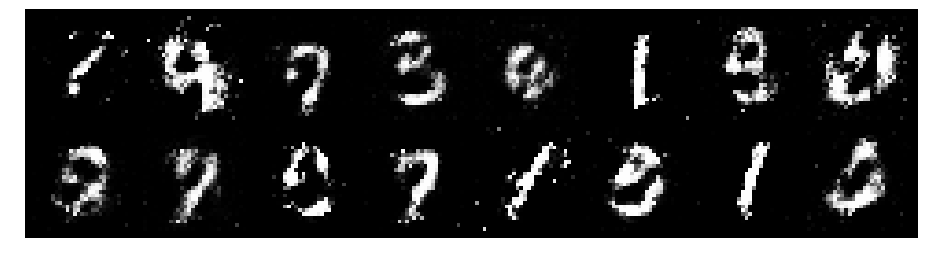

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.8046, Generator Loss: 1.4231
D(x): 0.7182, D(G(z)): 0.2754


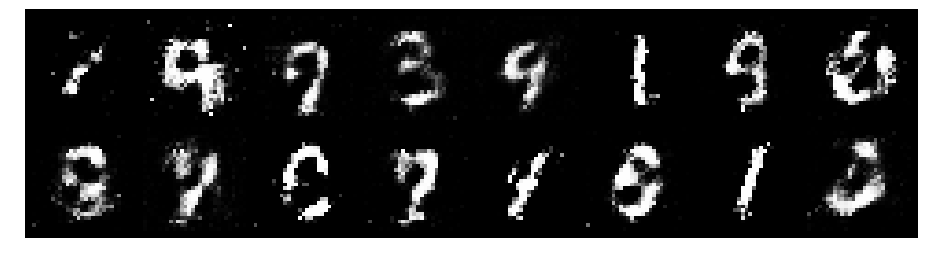

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.7493, Generator Loss: 2.1461
D(x): 0.7606, D(G(z)): 0.2208


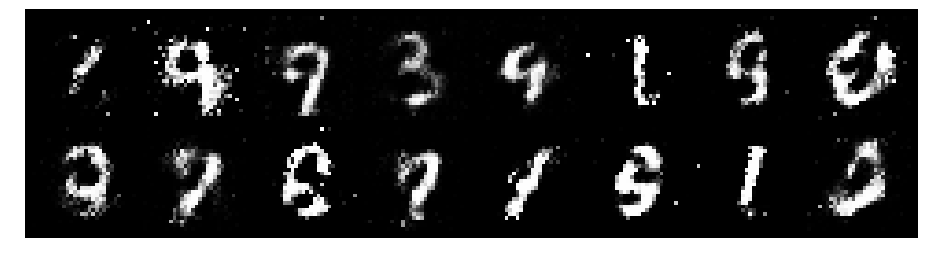

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.6780, Generator Loss: 1.6918
D(x): 0.7622, D(G(z)): 0.2298


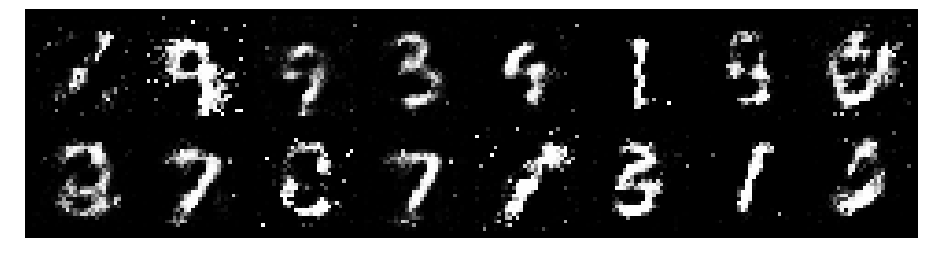

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9462, Generator Loss: 1.3304
D(x): 0.7254, D(G(z)): 0.3538


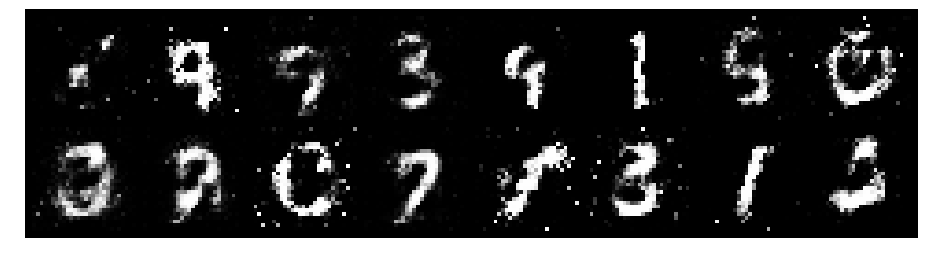

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.9626, Generator Loss: 1.1422
D(x): 0.7183, D(G(z)): 0.3642


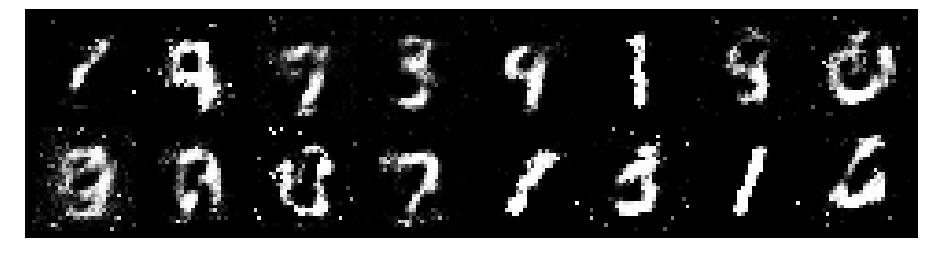

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.9400, Generator Loss: 1.7309
D(x): 0.6646, D(G(z)): 0.2641


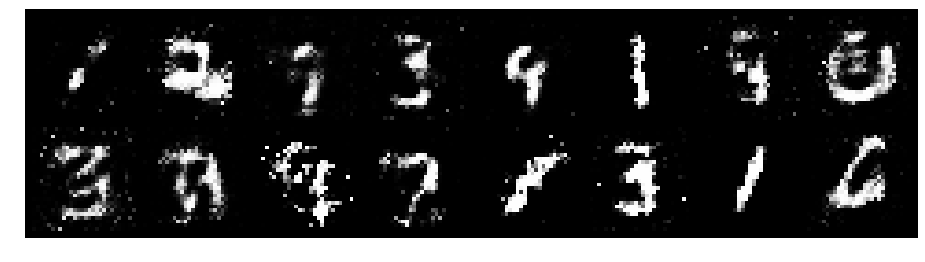

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.8851, Generator Loss: 1.5120
D(x): 0.6953, D(G(z)): 0.2948


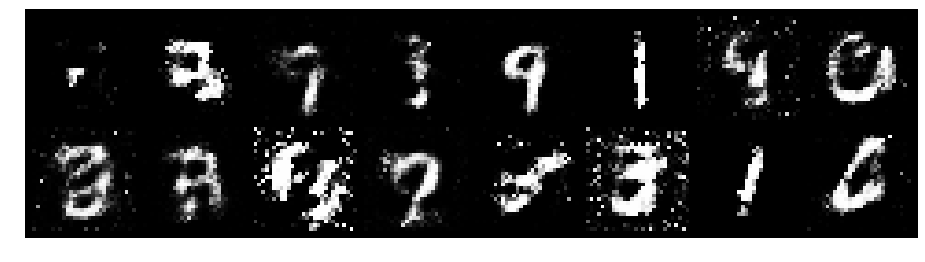

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.9650, Generator Loss: 1.6307
D(x): 0.6891, D(G(z)): 0.2819


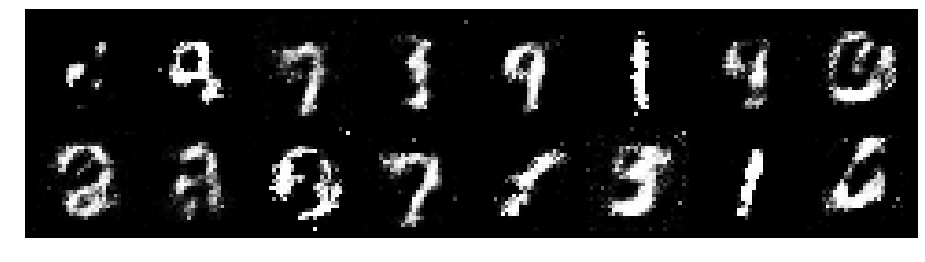

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 1.1407, Generator Loss: 1.0116
D(x): 0.6609, D(G(z)): 0.3945


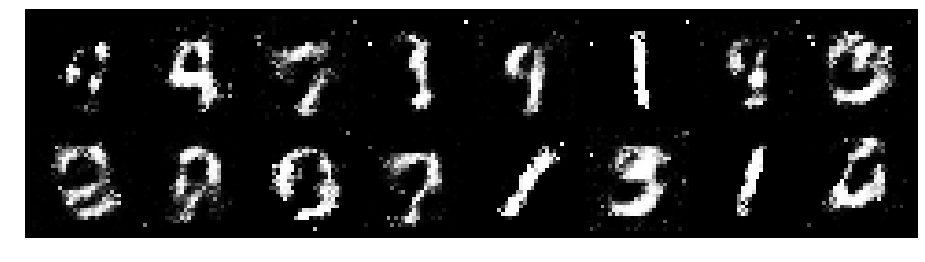

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.0115, Generator Loss: 1.3494
D(x): 0.6595, D(G(z)): 0.3288


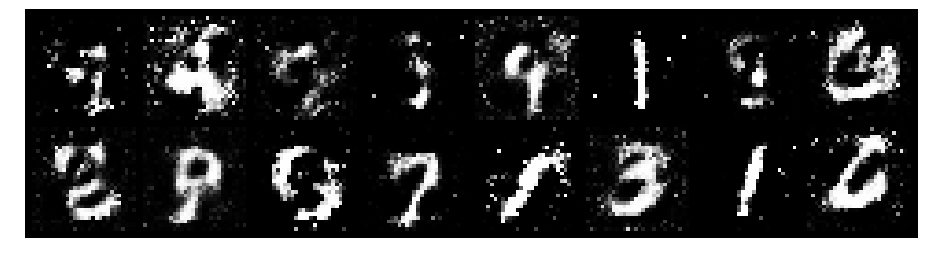

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.9230, Generator Loss: 1.2803
D(x): 0.6972, D(G(z)): 0.3261


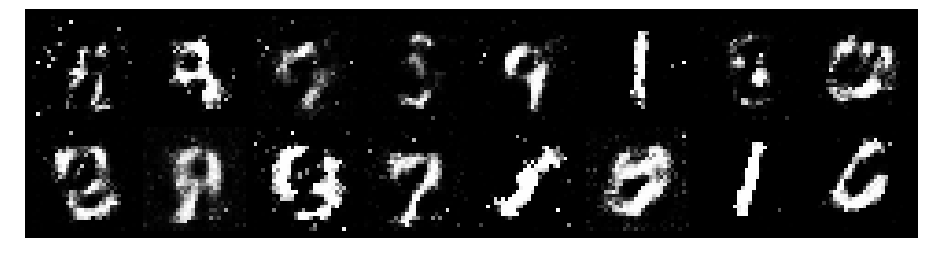

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.9210, Generator Loss: 1.4542
D(x): 0.6610, D(G(z)): 0.2800


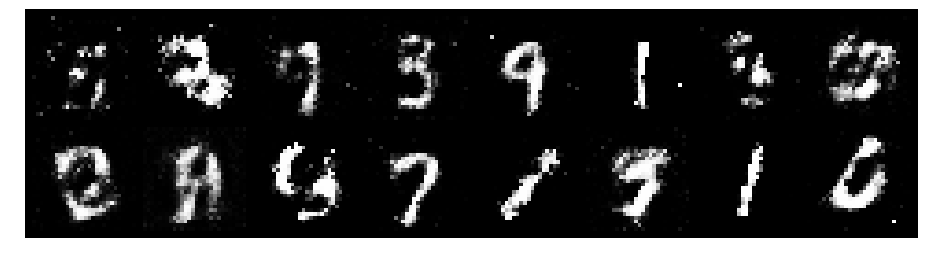

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 1.1768, Generator Loss: 1.3200
D(x): 0.6630, D(G(z)): 0.4075


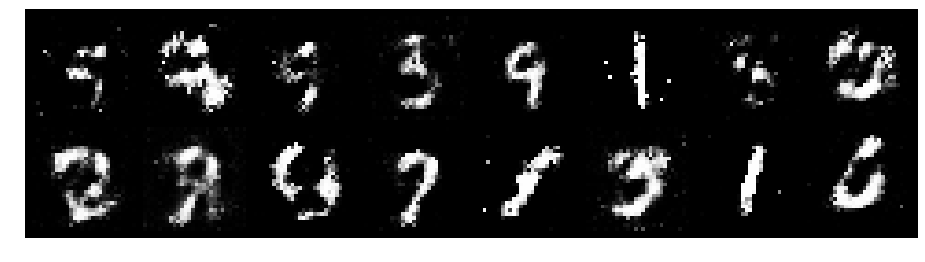

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 1.3186, Generator Loss: 1.3817
D(x): 0.5983, D(G(z)): 0.3807


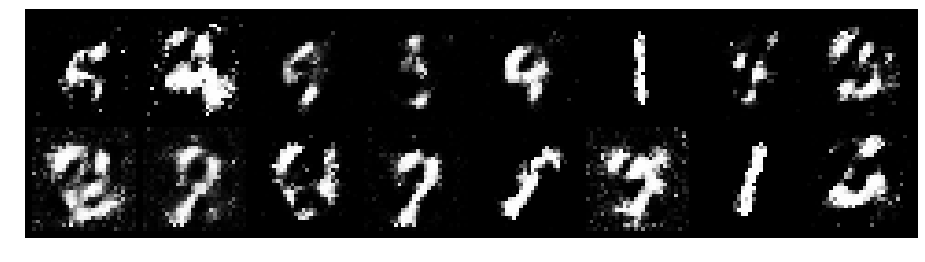

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.8442, Generator Loss: 1.5799
D(x): 0.7190, D(G(z)): 0.2761


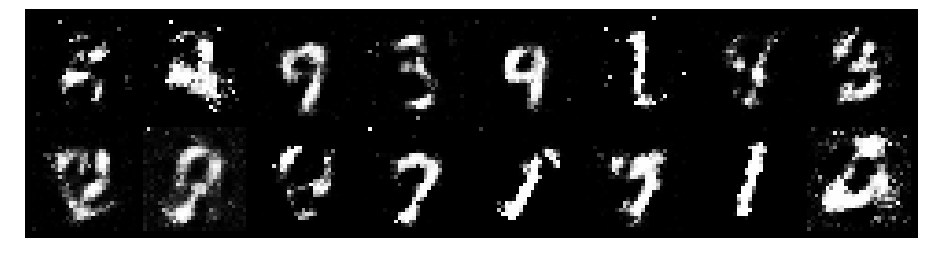

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.8638, Generator Loss: 1.6181
D(x): 0.7353, D(G(z)): 0.3143


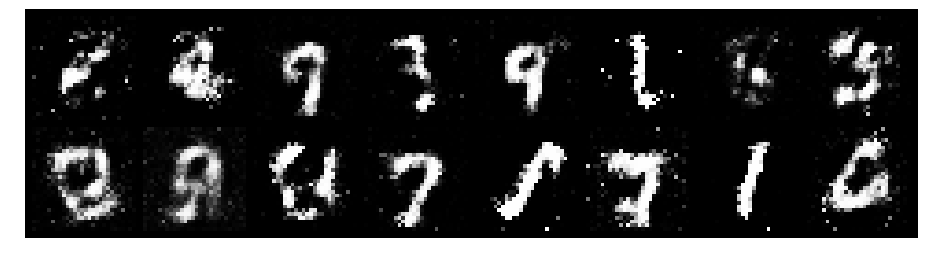

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 1.1530, Generator Loss: 1.5269
D(x): 0.6179, D(G(z)): 0.3068


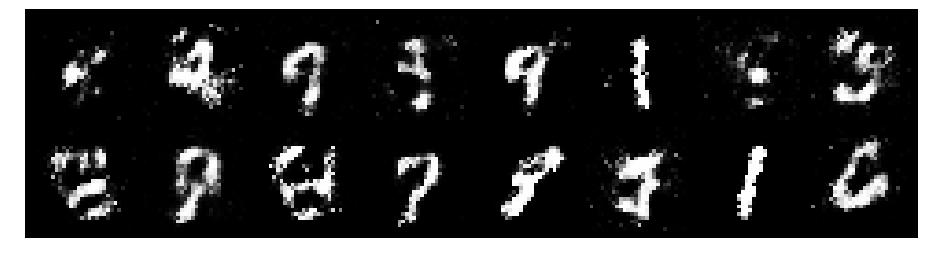

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 1.0176, Generator Loss: 1.4720
D(x): 0.6719, D(G(z)): 0.3370


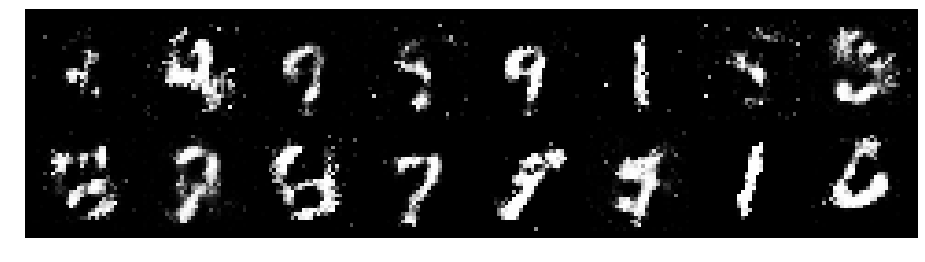

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9178, Generator Loss: 2.4183
D(x): 0.7259, D(G(z)): 0.2861


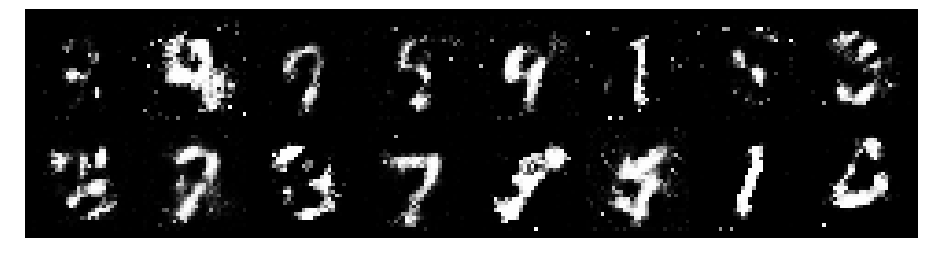

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.7740, Generator Loss: 1.5799
D(x): 0.7745, D(G(z)): 0.3025


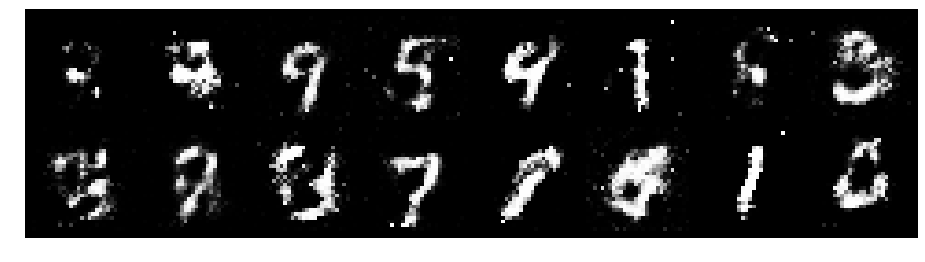

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 0.7890, Generator Loss: 1.8924
D(x): 0.7130, D(G(z)): 0.2434


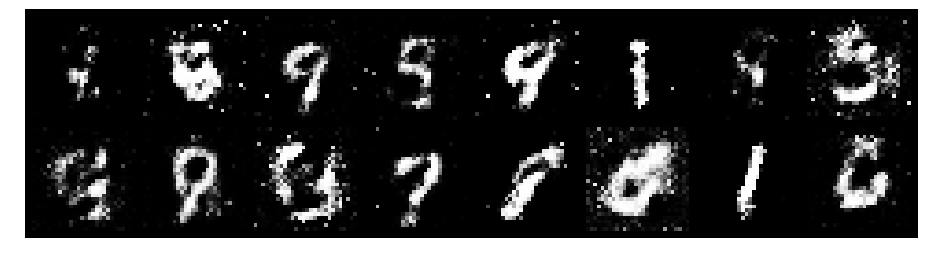

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.1253, Generator Loss: 1.6512
D(x): 0.7045, D(G(z)): 0.3702


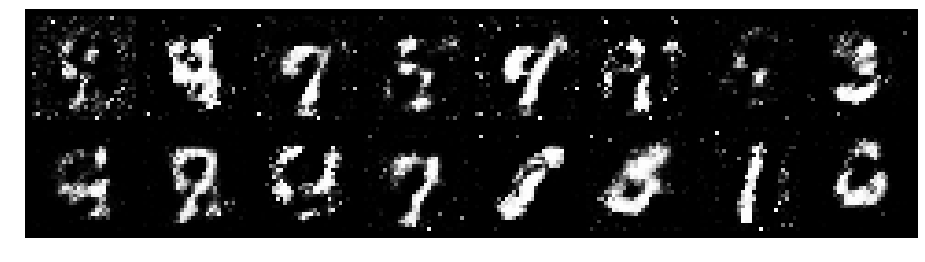

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.8131, Generator Loss: 1.5119
D(x): 0.7371, D(G(z)): 0.3052


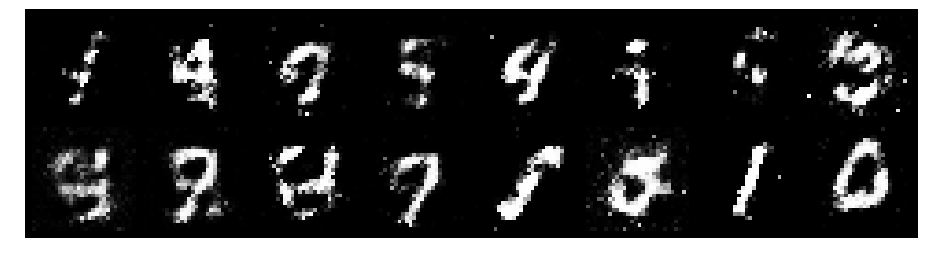

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.8559, Generator Loss: 1.4118
D(x): 0.7337, D(G(z)): 0.3375


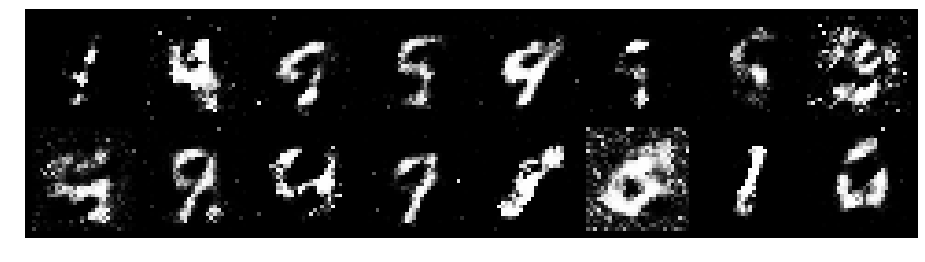

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.0435, Generator Loss: 1.3842
D(x): 0.6169, D(G(z)): 0.3404


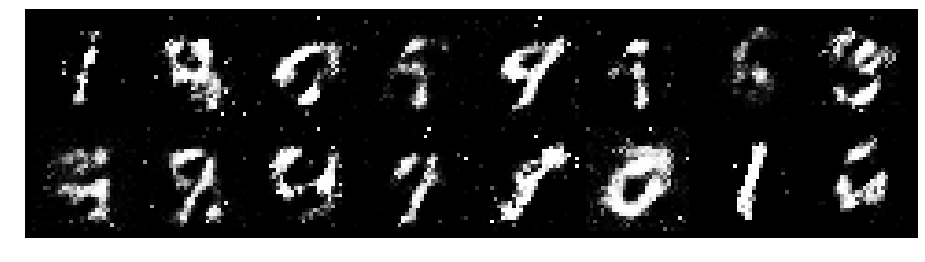

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.9899, Generator Loss: 1.4819
D(x): 0.6405, D(G(z)): 0.2970


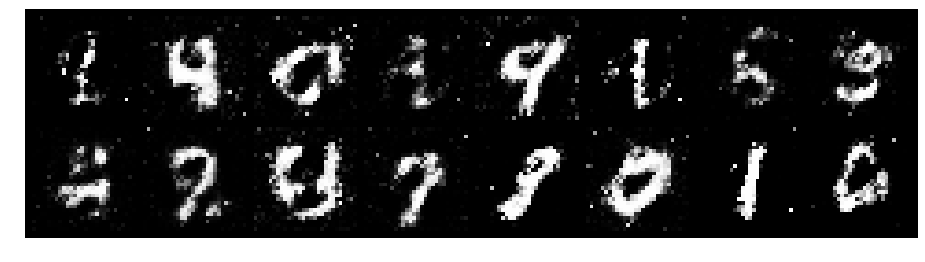

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 1.1075, Generator Loss: 1.3634
D(x): 0.6019, D(G(z)): 0.3333


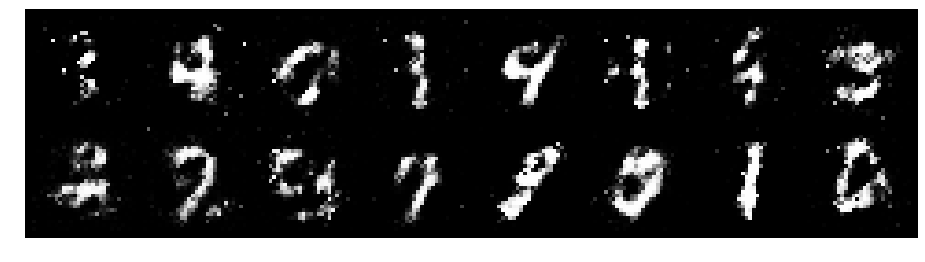

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0622, Generator Loss: 0.9923
D(x): 0.6404, D(G(z)): 0.3342


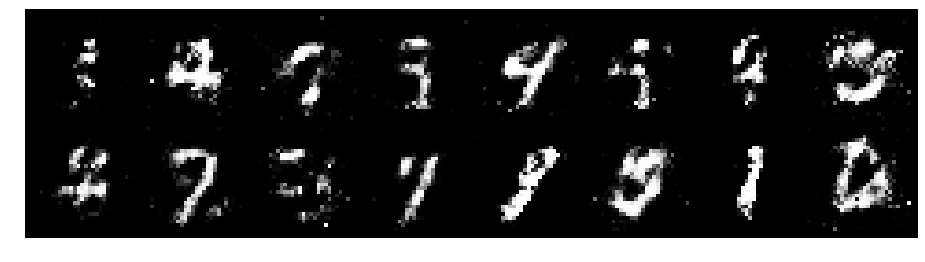

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.1200, Generator Loss: 1.2705
D(x): 0.6533, D(G(z)): 0.3889


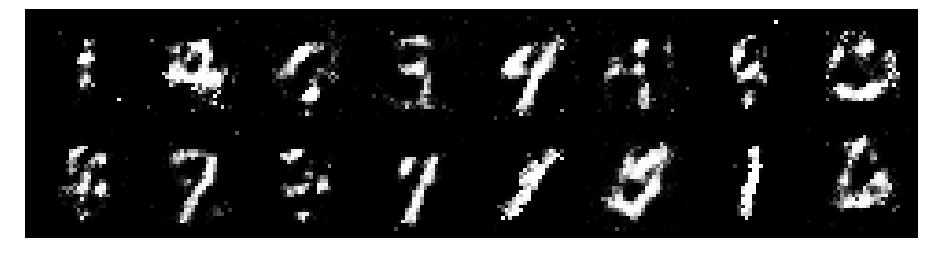

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 1.1884, Generator Loss: 1.0939
D(x): 0.6570, D(G(z)): 0.4139


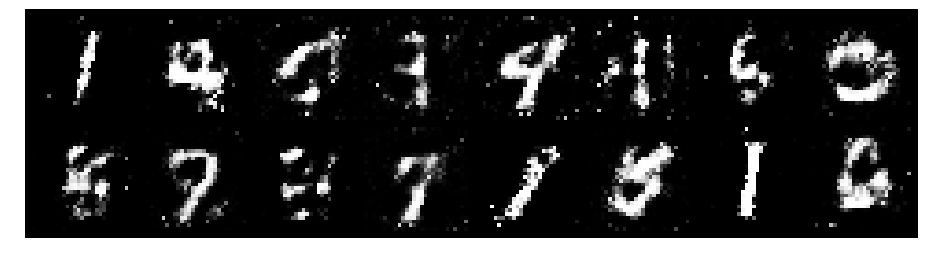

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.9646, Generator Loss: 1.5176
D(x): 0.6405, D(G(z)): 0.2870


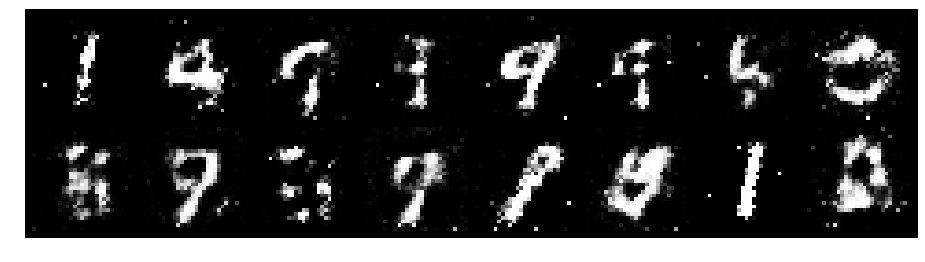

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 0.8240, Generator Loss: 1.6825
D(x): 0.7234, D(G(z)): 0.2774


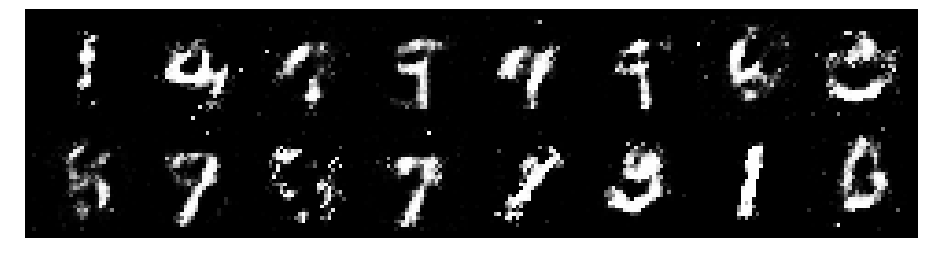

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 0.8240, Generator Loss: 1.3154
D(x): 0.7631, D(G(z)): 0.3464


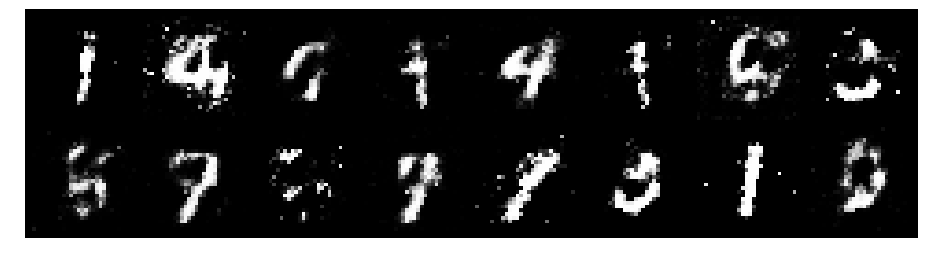

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.7829, Generator Loss: 1.7313
D(x): 0.7486, D(G(z)): 0.2828


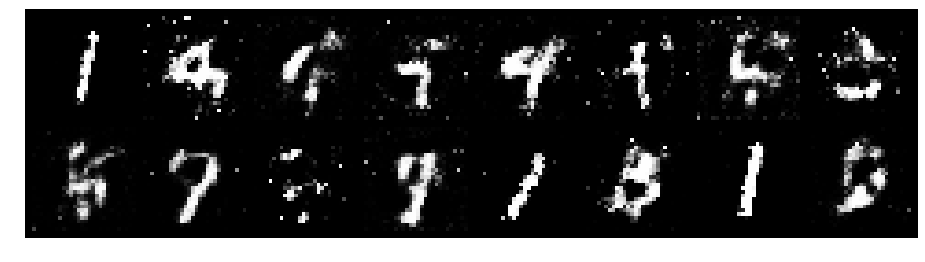

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 0.7510, Generator Loss: 1.5126
D(x): 0.7257, D(G(z)): 0.2283


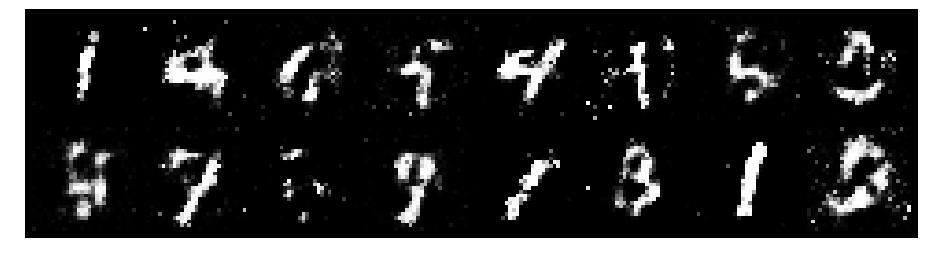

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.9636, Generator Loss: 1.3350
D(x): 0.6782, D(G(z)): 0.3425


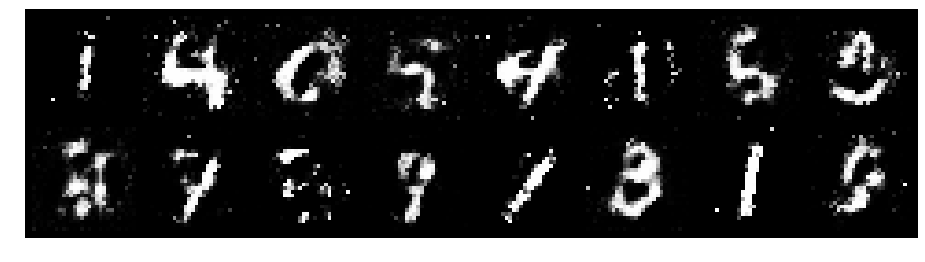

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0305, Generator Loss: 1.5847
D(x): 0.5860, D(G(z)): 0.2749


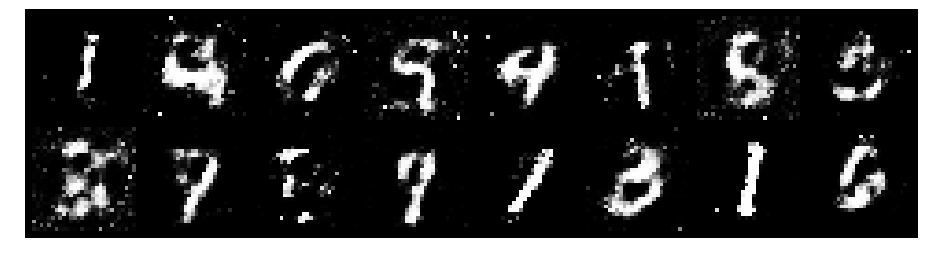

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.0041, Generator Loss: 1.6294
D(x): 0.6695, D(G(z)): 0.3301


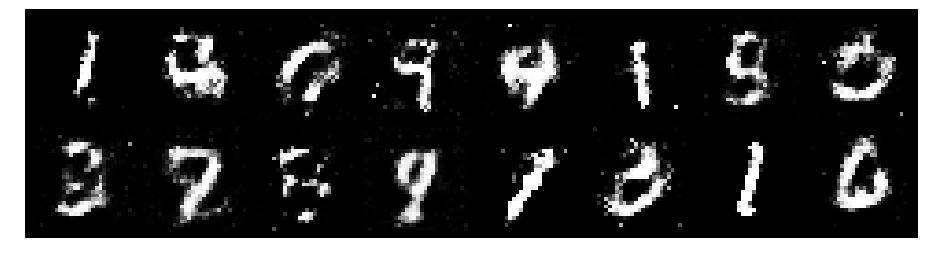

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9030, Generator Loss: 1.0898
D(x): 0.7321, D(G(z)): 0.3473


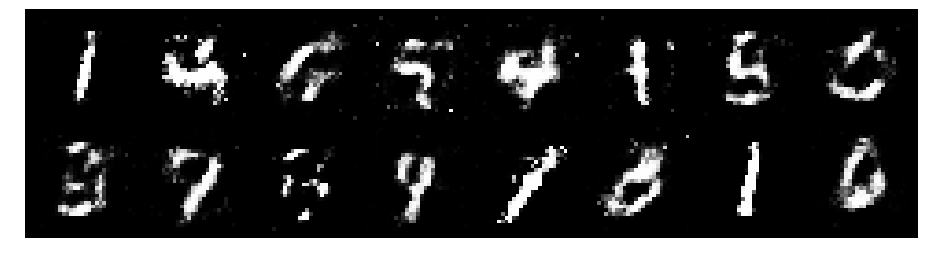

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 1.1676, Generator Loss: 1.2365
D(x): 0.5772, D(G(z)): 0.3471


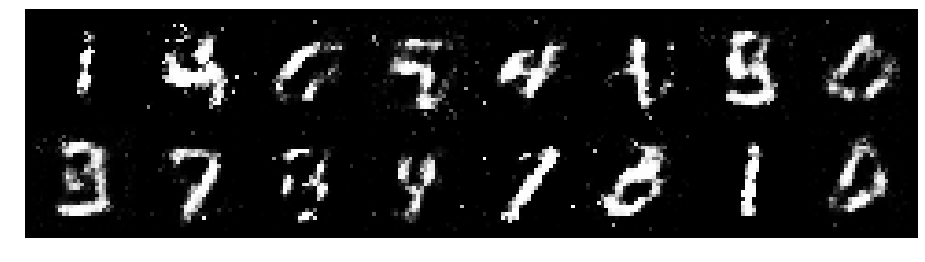

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 1.1787, Generator Loss: 1.5521
D(x): 0.6049, D(G(z)): 0.3175


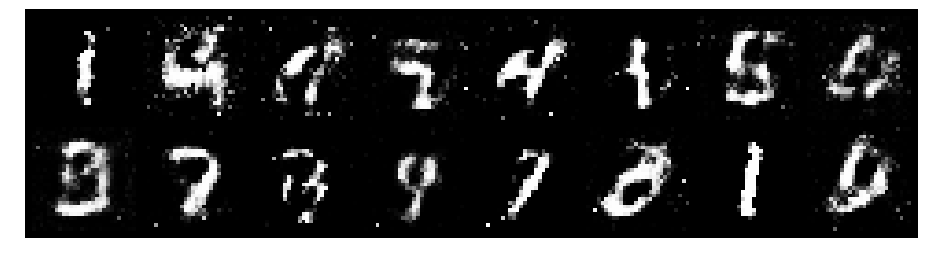

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.0306, Generator Loss: 1.1413
D(x): 0.6347, D(G(z)): 0.3232


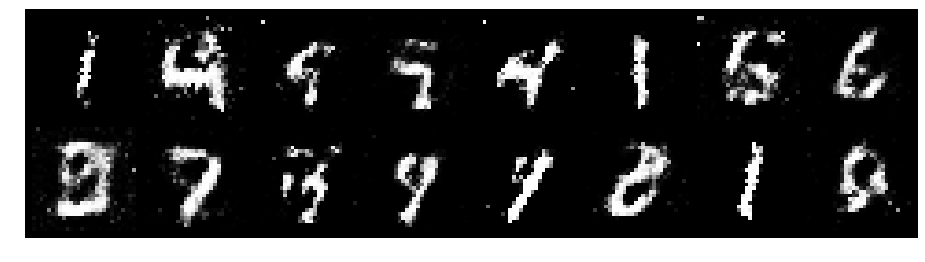

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 1.0546, Generator Loss: 1.3664
D(x): 0.6098, D(G(z)): 0.3193


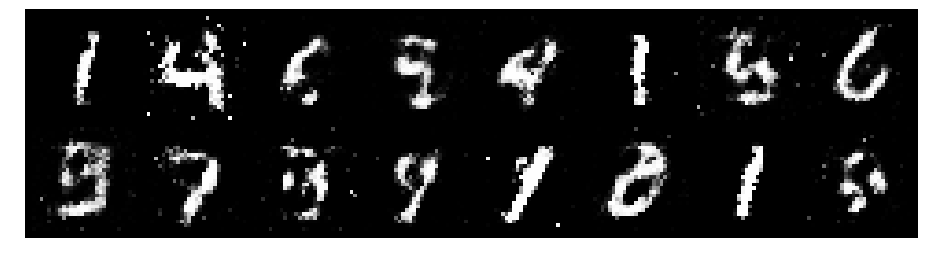

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.9062, Generator Loss: 1.5953
D(x): 0.7141, D(G(z)): 0.3339


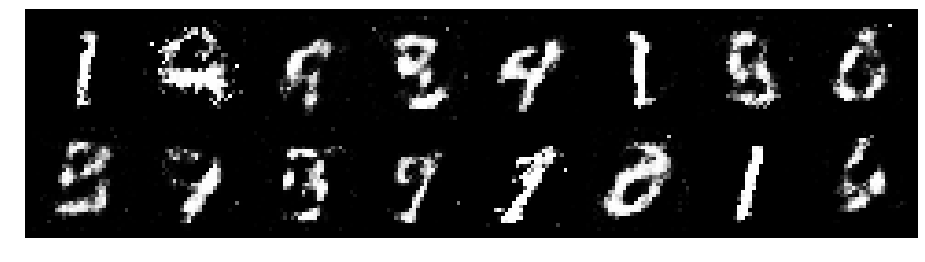

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 1.0509, Generator Loss: 1.2447
D(x): 0.6505, D(G(z)): 0.3695


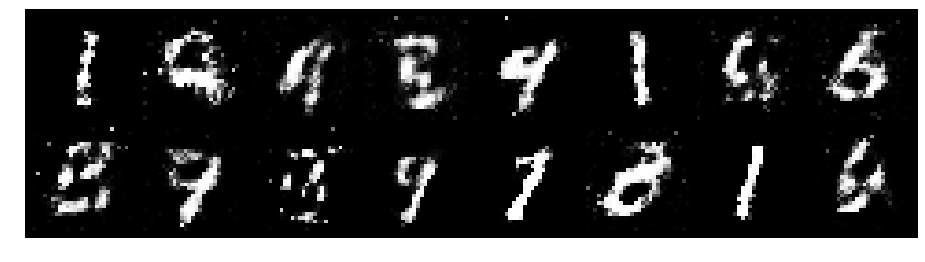

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 0.9633, Generator Loss: 1.4590
D(x): 0.6385, D(G(z)): 0.3154


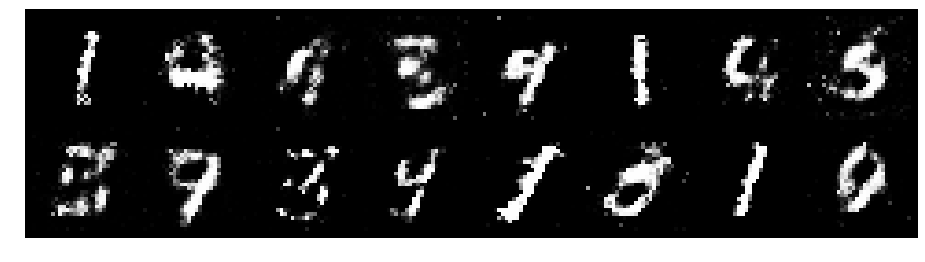

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.8543, Generator Loss: 1.3449
D(x): 0.6785, D(G(z)): 0.2880


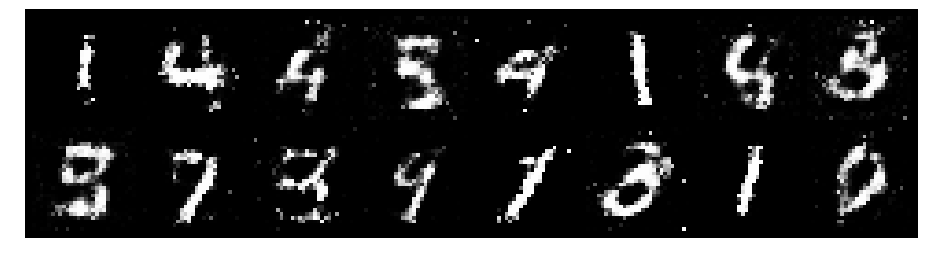

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.8116, Generator Loss: 1.3034
D(x): 0.7066, D(G(z)): 0.2740


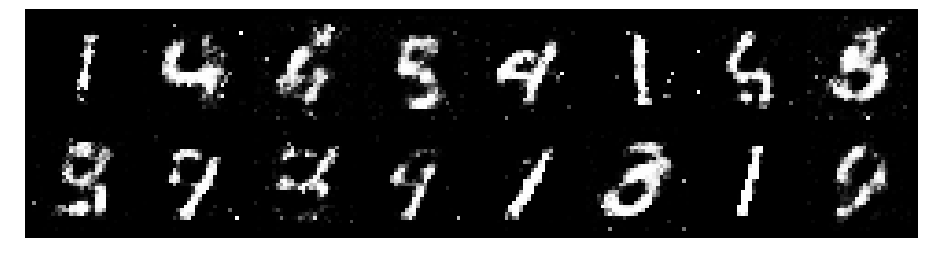

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 1.2834, Generator Loss: 1.5558
D(x): 0.5516, D(G(z)): 0.2908


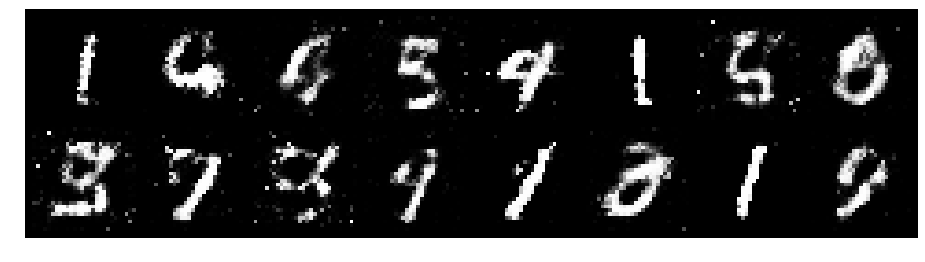

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 0.9734, Generator Loss: 1.4173
D(x): 0.6993, D(G(z)): 0.3479


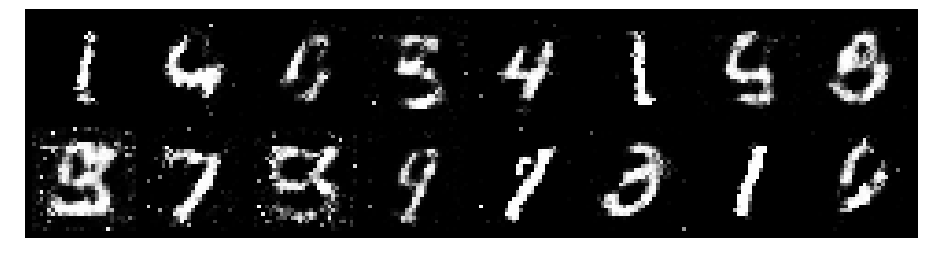

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 0.8692, Generator Loss: 1.2383
D(x): 0.7328, D(G(z)): 0.3547


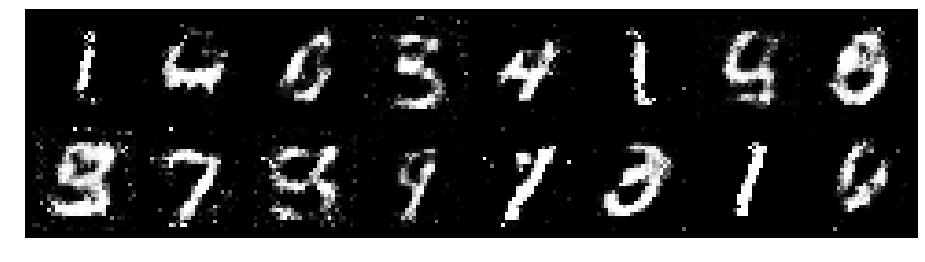

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.8712, Generator Loss: 1.2822
D(x): 0.6591, D(G(z)): 0.2801


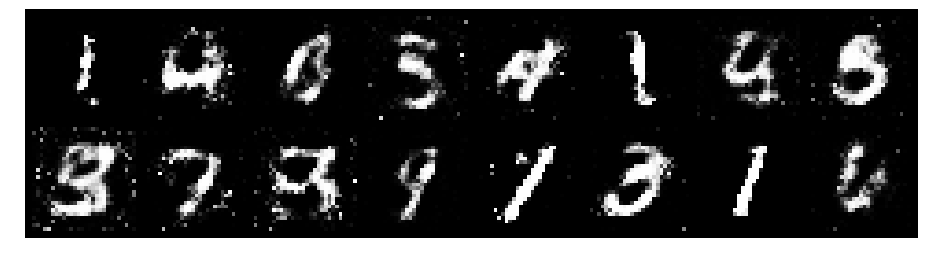

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.0797, Generator Loss: 1.3025
D(x): 0.6099, D(G(z)): 0.3403


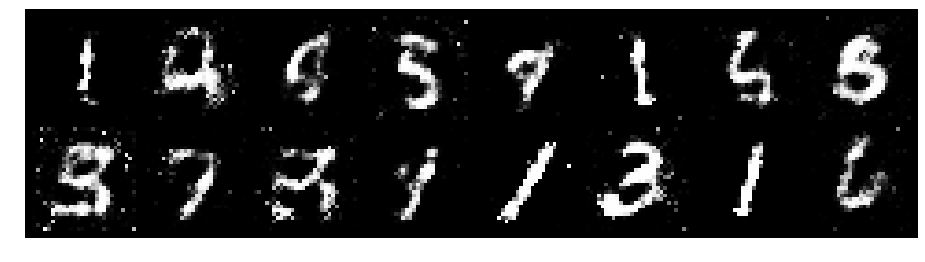

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.1154, Generator Loss: 1.0133
D(x): 0.6800, D(G(z)): 0.4201


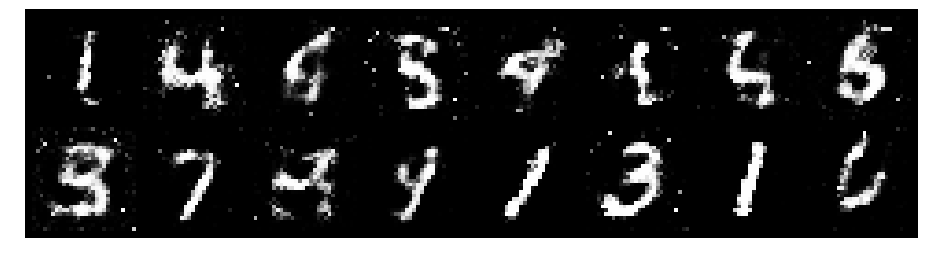

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.1097, Generator Loss: 1.1420
D(x): 0.6038, D(G(z)): 0.3162


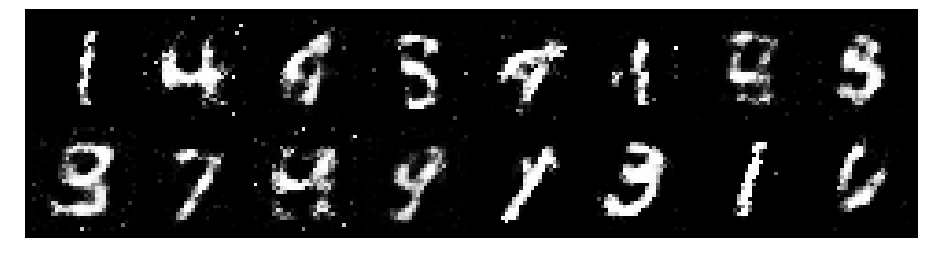

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 1.1522, Generator Loss: 1.1416
D(x): 0.6216, D(G(z)): 0.3735


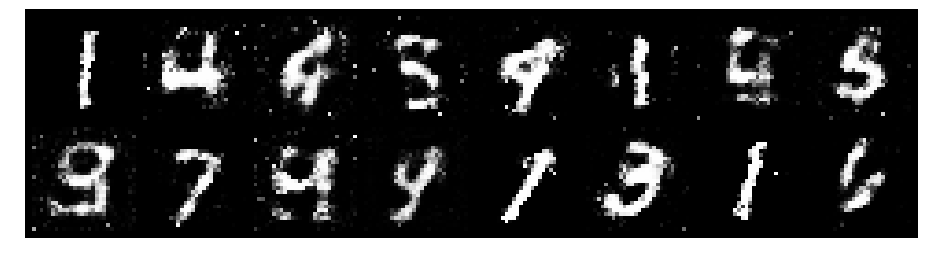

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.0792, Generator Loss: 1.4110
D(x): 0.6754, D(G(z)): 0.3738


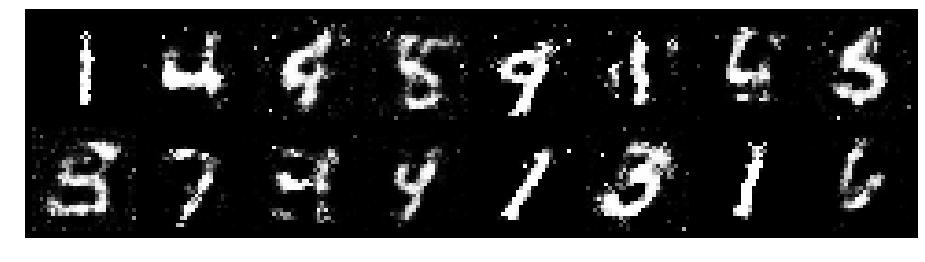

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 0.9927, Generator Loss: 1.3147
D(x): 0.7043, D(G(z)): 0.3705


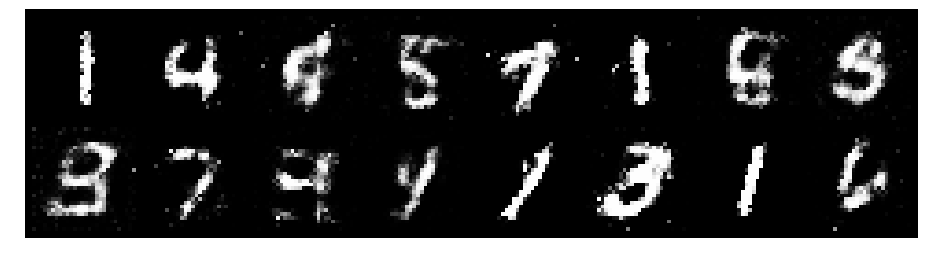

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.1373, Generator Loss: 1.0558
D(x): 0.6470, D(G(z)): 0.3534


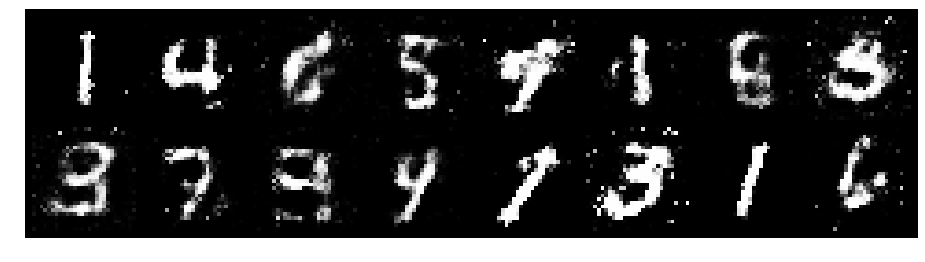

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0273, Generator Loss: 1.2908
D(x): 0.6739, D(G(z)): 0.3341


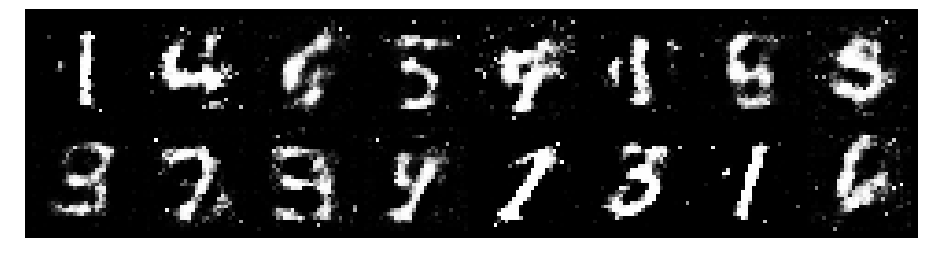

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.1018, Generator Loss: 1.2617
D(x): 0.6807, D(G(z)): 0.3967


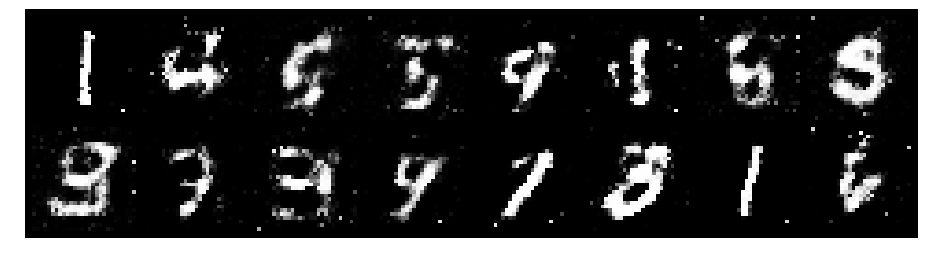

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.8538, Generator Loss: 1.6421
D(x): 0.6893, D(G(z)): 0.2786


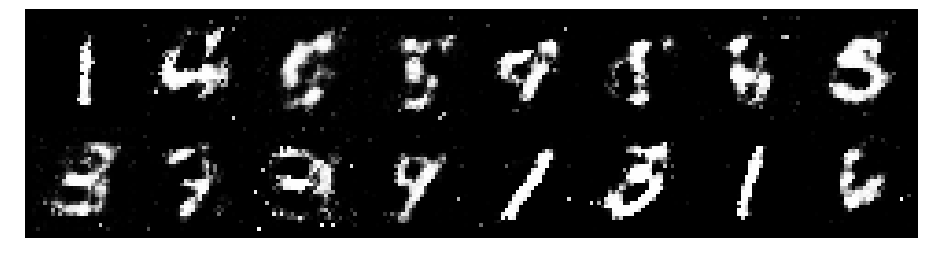

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.1165, Generator Loss: 1.1508
D(x): 0.6045, D(G(z)): 0.3269


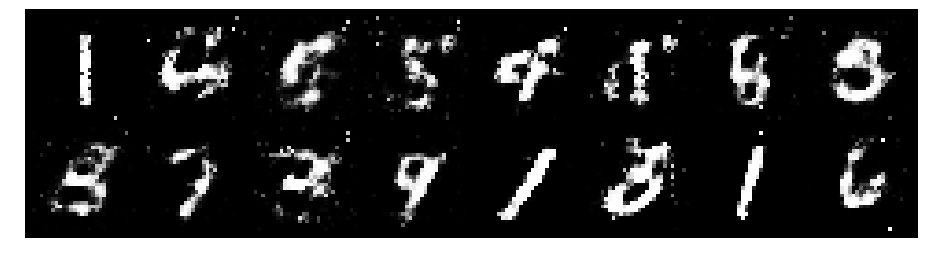

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.2538, Generator Loss: 1.3818
D(x): 0.5400, D(G(z)): 0.3134


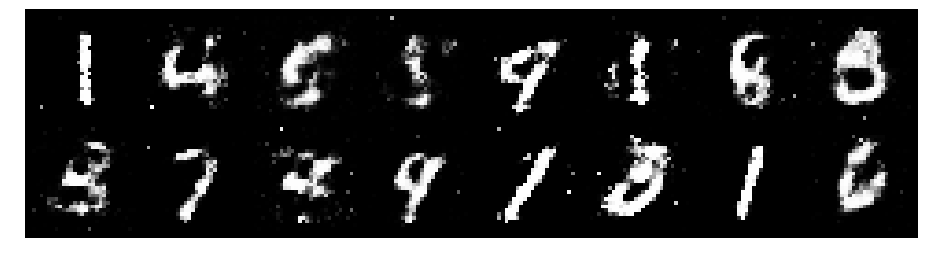

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 0.9574, Generator Loss: 1.7502
D(x): 0.6526, D(G(z)): 0.2647


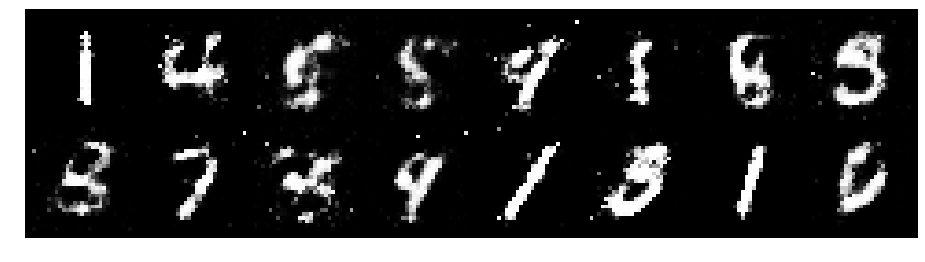

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 0.8815, Generator Loss: 1.5863
D(x): 0.7314, D(G(z)): 0.3114


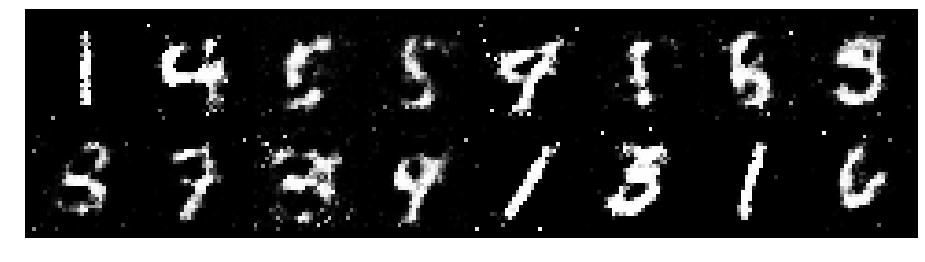

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.8643, Generator Loss: 1.4588
D(x): 0.6722, D(G(z)): 0.2964


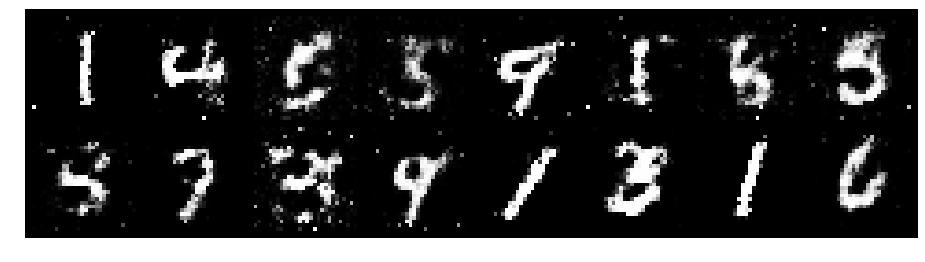

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 0.8615, Generator Loss: 1.4012
D(x): 0.6840, D(G(z)): 0.2928


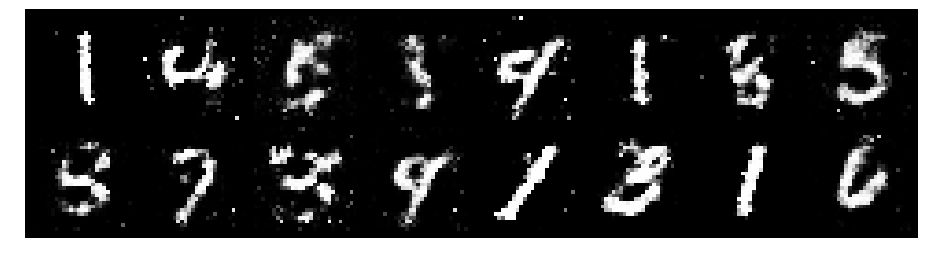

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 0.9667, Generator Loss: 1.3351
D(x): 0.6392, D(G(z)): 0.3274


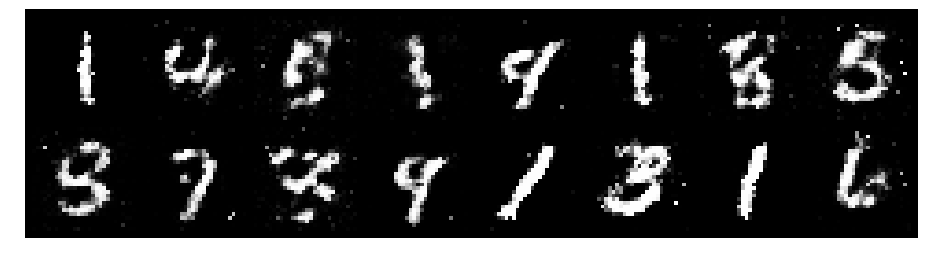

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 0.8865, Generator Loss: 1.5763
D(x): 0.6705, D(G(z)): 0.2603


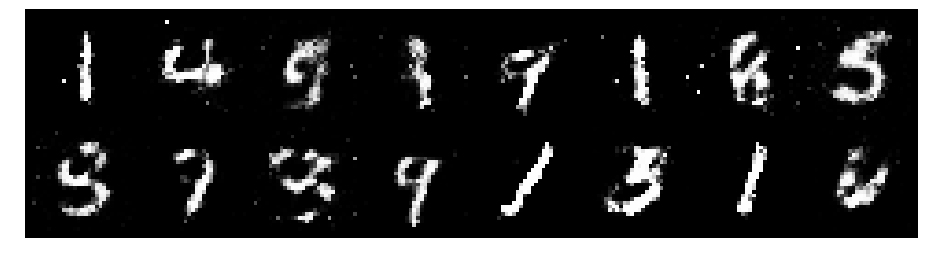

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.1586, Generator Loss: 1.1816
D(x): 0.5680, D(G(z)): 0.3287


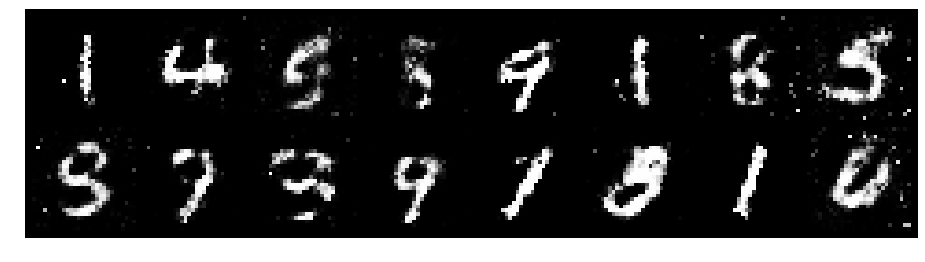

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.2209, Generator Loss: 0.9374
D(x): 0.6208, D(G(z)): 0.4476


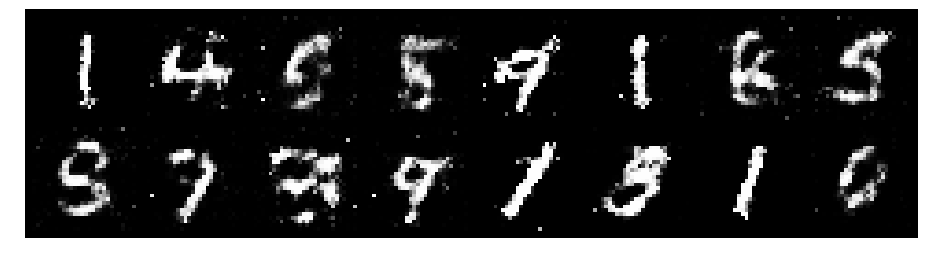

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.0663, Generator Loss: 1.2574
D(x): 0.6346, D(G(z)): 0.3772


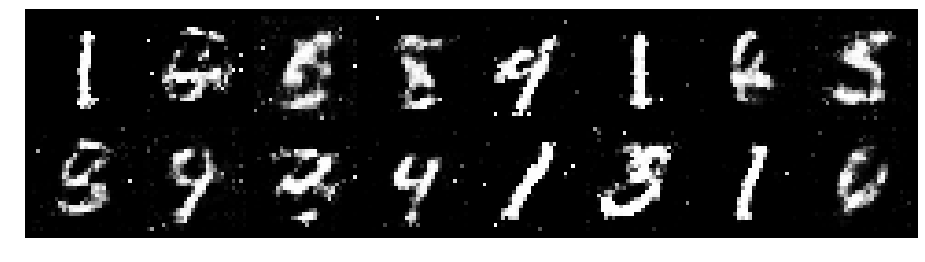

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 0.9128, Generator Loss: 1.1229
D(x): 0.7392, D(G(z)): 0.3526


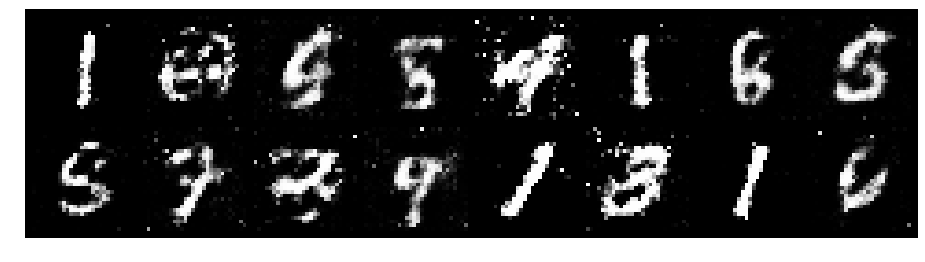

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.2116, Generator Loss: 1.2611
D(x): 0.6227, D(G(z)): 0.3982


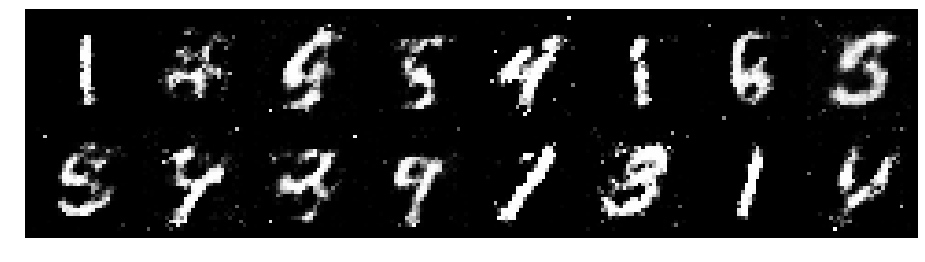

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.1298, Generator Loss: 1.0629
D(x): 0.6134, D(G(z)): 0.3885


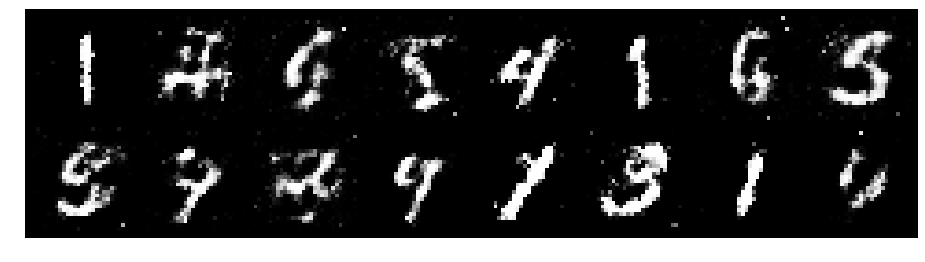

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.1133, Generator Loss: 1.1652
D(x): 0.5878, D(G(z)): 0.3473


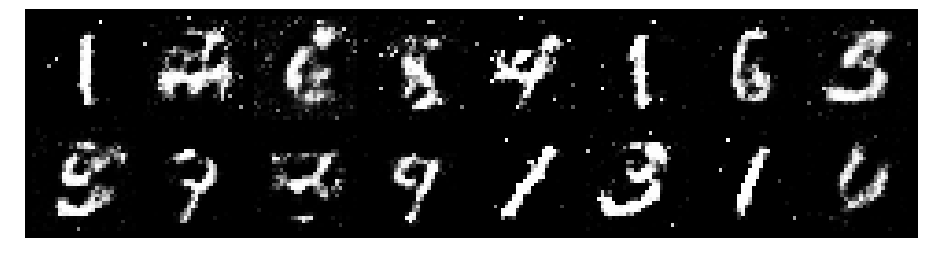

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.2266, Generator Loss: 0.9498
D(x): 0.5972, D(G(z)): 0.4399


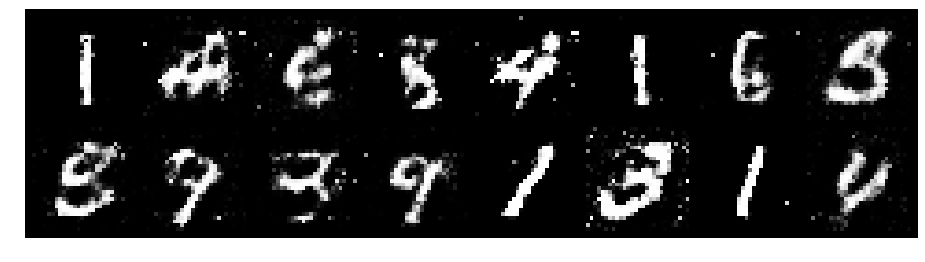

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 1.2888, Generator Loss: 1.3150
D(x): 0.5829, D(G(z)): 0.3664


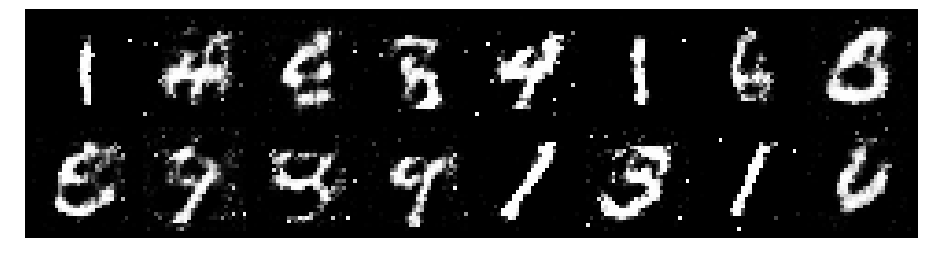

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.0395, Generator Loss: 1.3341
D(x): 0.5939, D(G(z)): 0.2790


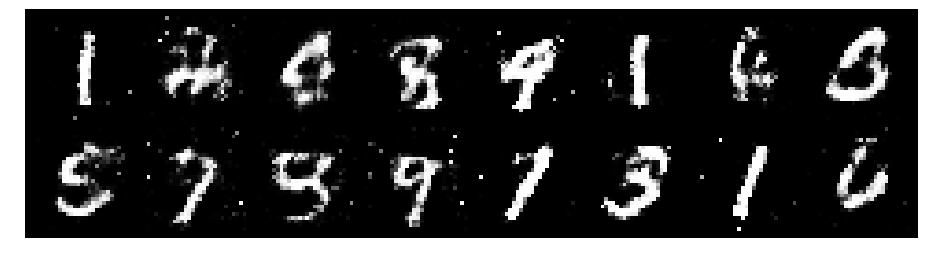

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.0322, Generator Loss: 1.4951
D(x): 0.7010, D(G(z)): 0.3646


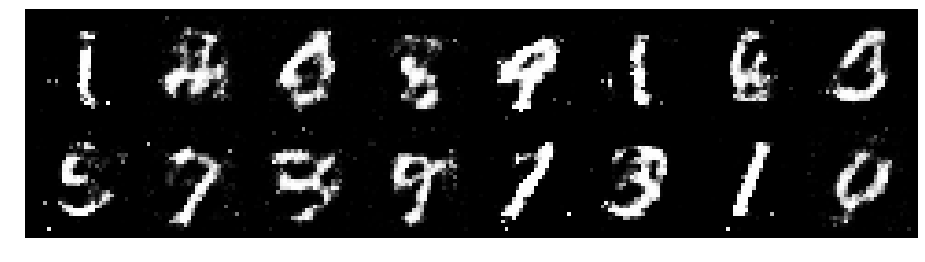

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.0017, Generator Loss: 1.2238
D(x): 0.6653, D(G(z)): 0.3770


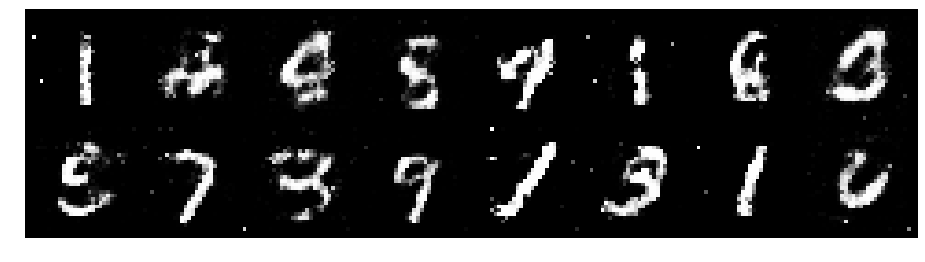

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.1156, Generator Loss: 1.3282
D(x): 0.6656, D(G(z)): 0.3917


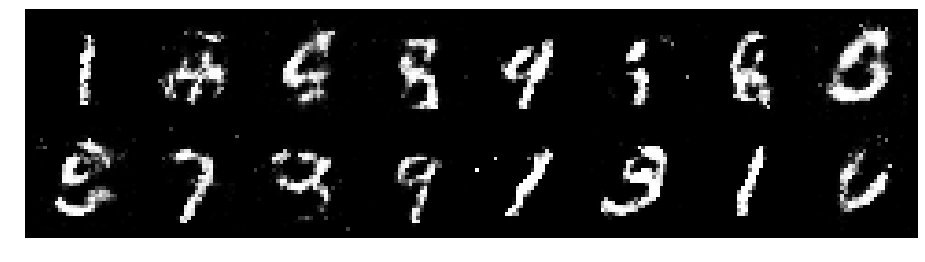

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.0947, Generator Loss: 1.1451
D(x): 0.6150, D(G(z)): 0.3743


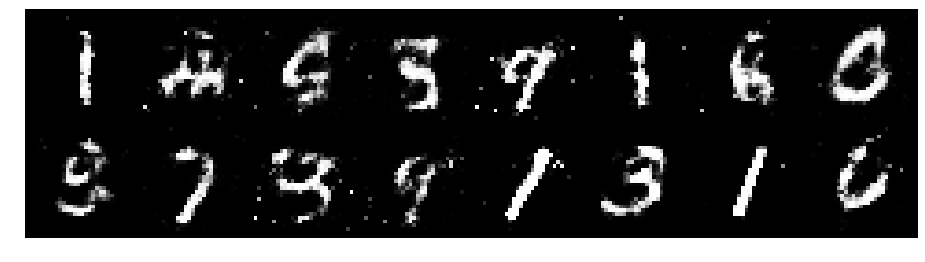

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.1883, Generator Loss: 0.9458
D(x): 0.6615, D(G(z)): 0.4329


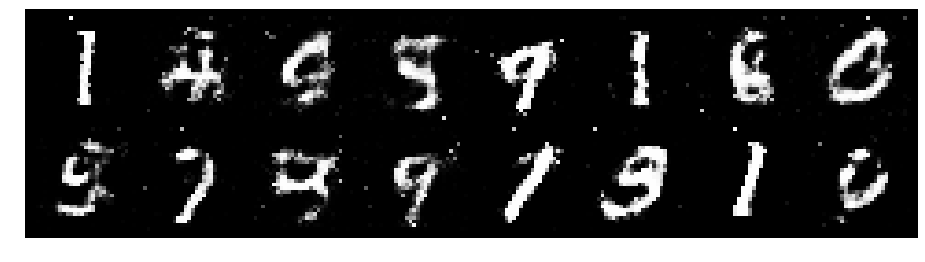

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.1604, Generator Loss: 1.2361
D(x): 0.5732, D(G(z)): 0.3360


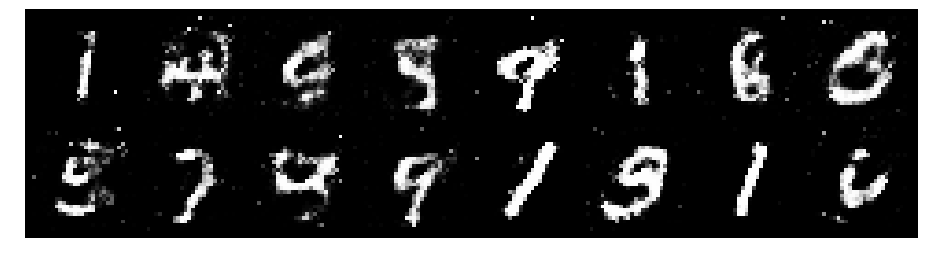

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 0.9657, Generator Loss: 1.2929
D(x): 0.6692, D(G(z)): 0.3569


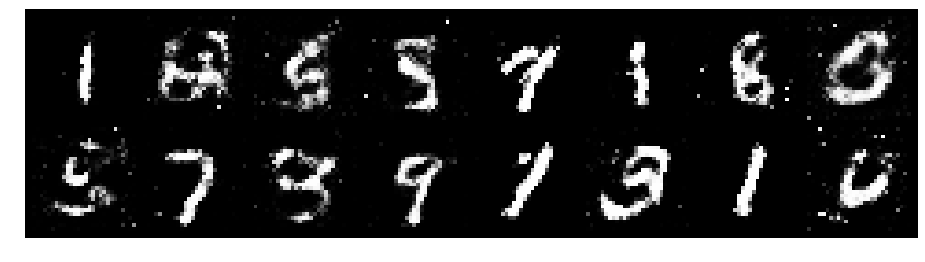

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 0.9725, Generator Loss: 1.2712
D(x): 0.6865, D(G(z)): 0.3691


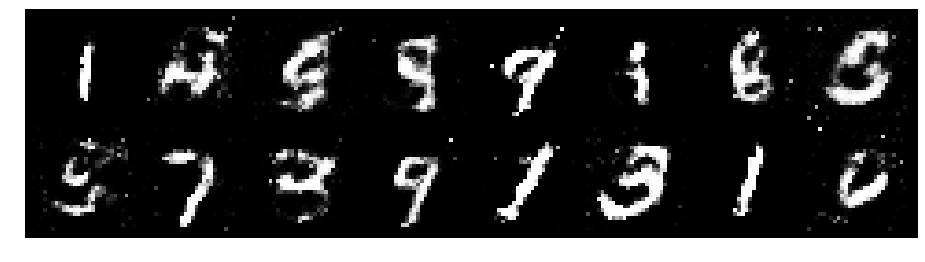

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.0506, Generator Loss: 1.2447
D(x): 0.6403, D(G(z)): 0.3625


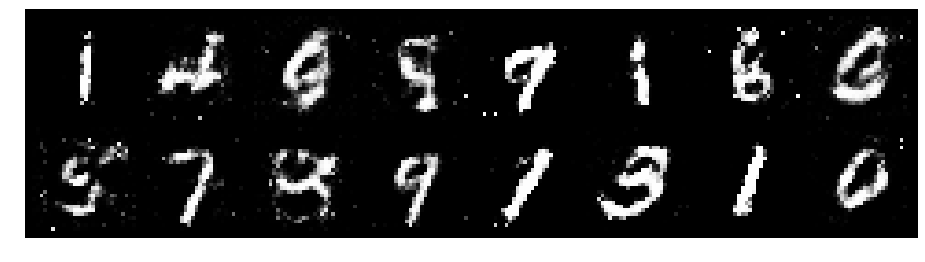

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.0825, Generator Loss: 1.0826
D(x): 0.6213, D(G(z)): 0.3521


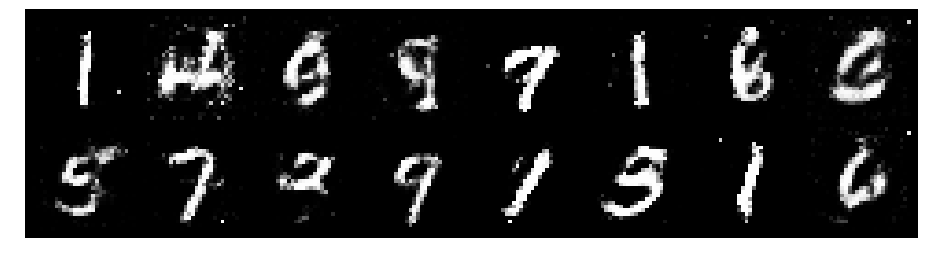

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0460, Generator Loss: 1.1378
D(x): 0.6464, D(G(z)): 0.3426


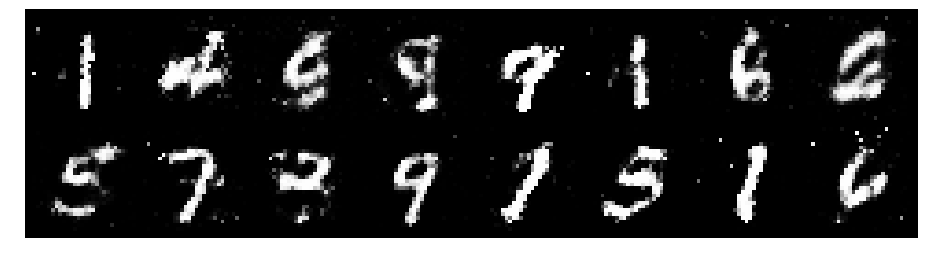

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.1359, Generator Loss: 1.0563
D(x): 0.6087, D(G(z)): 0.3831


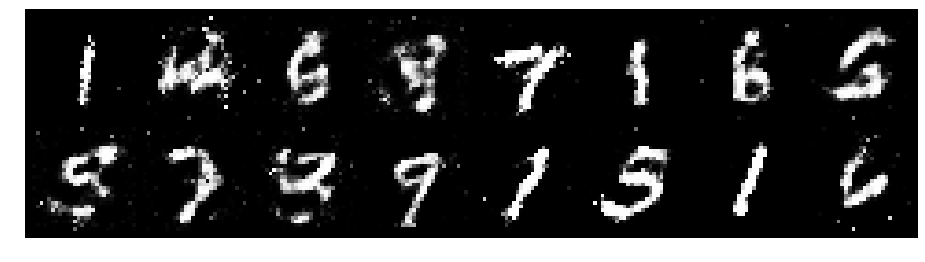

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.0288, Generator Loss: 1.2645
D(x): 0.6527, D(G(z)): 0.3601


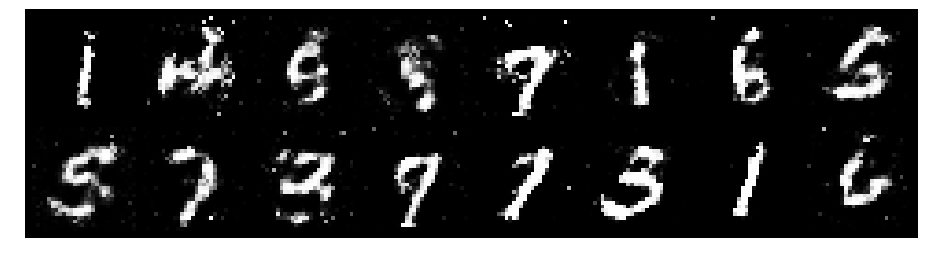

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.9402, Generator Loss: 1.6662
D(x): 0.7171, D(G(z)): 0.3465


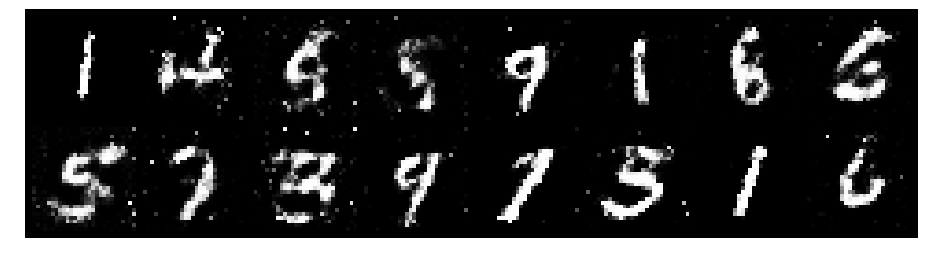

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.4281, Generator Loss: 1.0159
D(x): 0.4998, D(G(z)): 0.3702


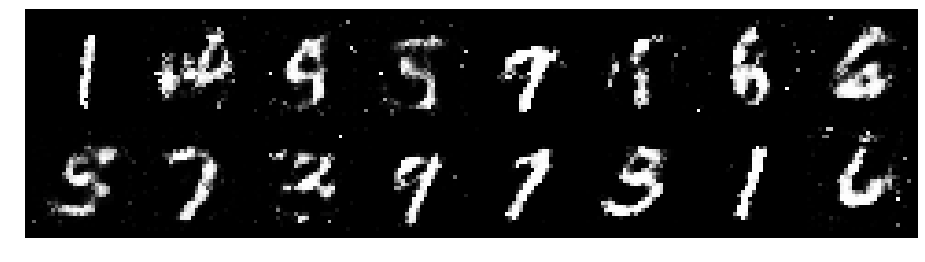

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.0361, Generator Loss: 1.4223
D(x): 0.6679, D(G(z)): 0.3823


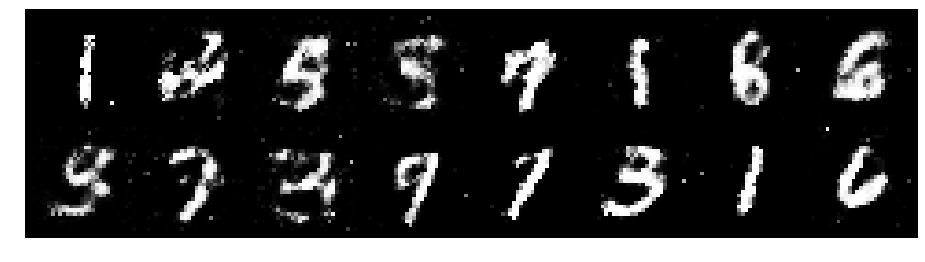

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.0094, Generator Loss: 1.0729
D(x): 0.6496, D(G(z)): 0.3579


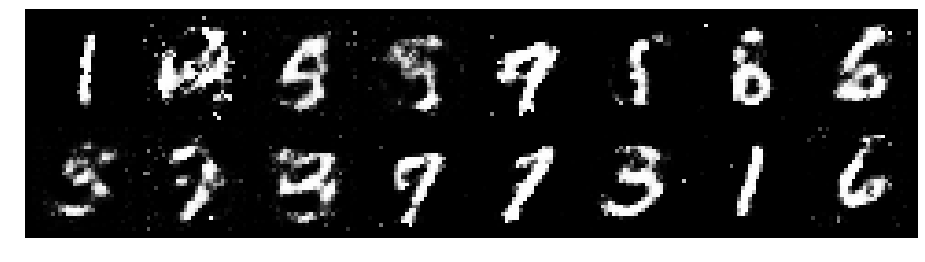

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 0.9879, Generator Loss: 1.3801
D(x): 0.6219, D(G(z)): 0.2924


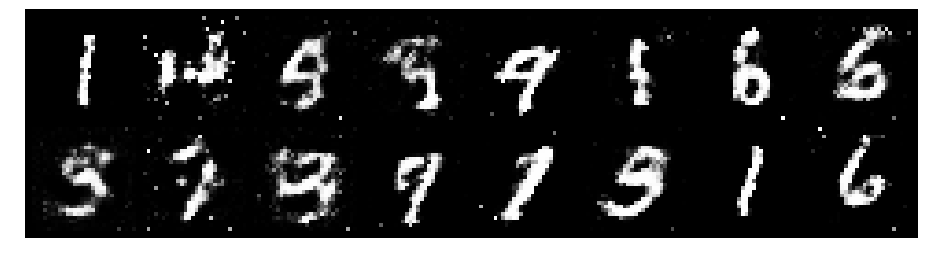

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.1209, Generator Loss: 1.1451
D(x): 0.5939, D(G(z)): 0.3836


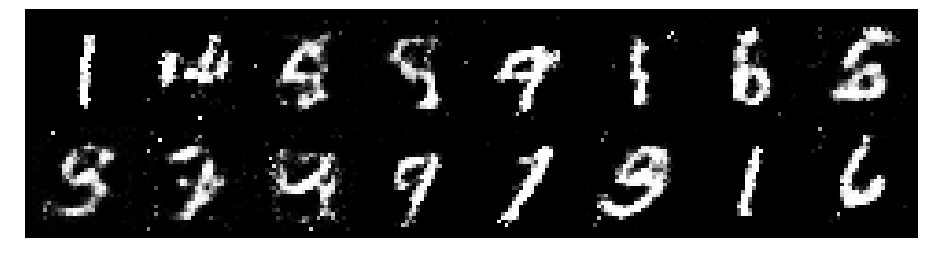

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.0554, Generator Loss: 1.0302
D(x): 0.6674, D(G(z)): 0.4183


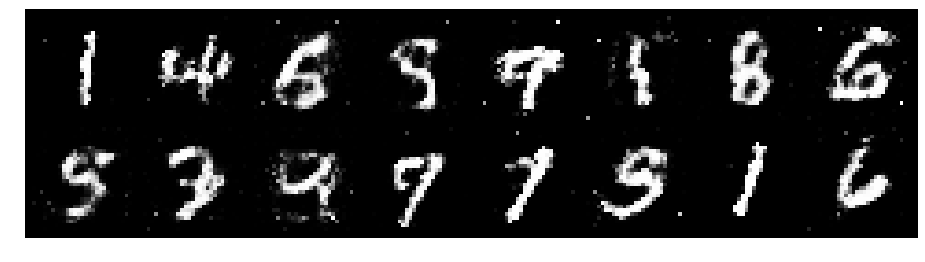

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 0.9538, Generator Loss: 1.3362
D(x): 0.6492, D(G(z)): 0.3224


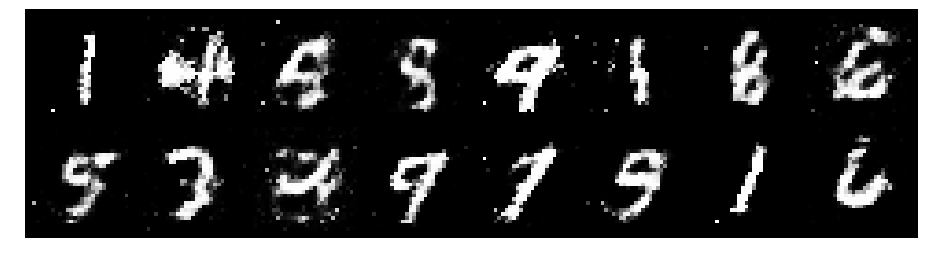

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1208, Generator Loss: 0.9577
D(x): 0.5867, D(G(z)): 0.3770


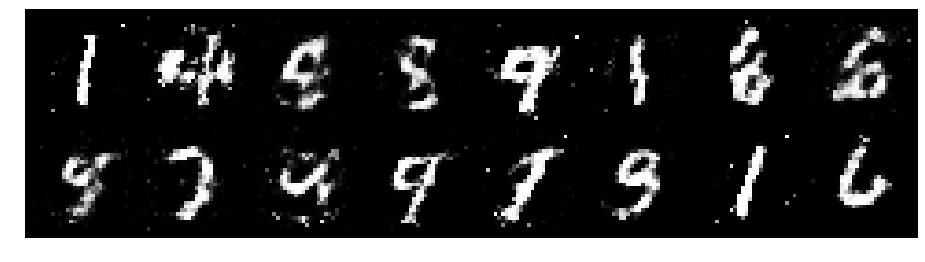

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.2677, Generator Loss: 1.2729
D(x): 0.5636, D(G(z)): 0.3494


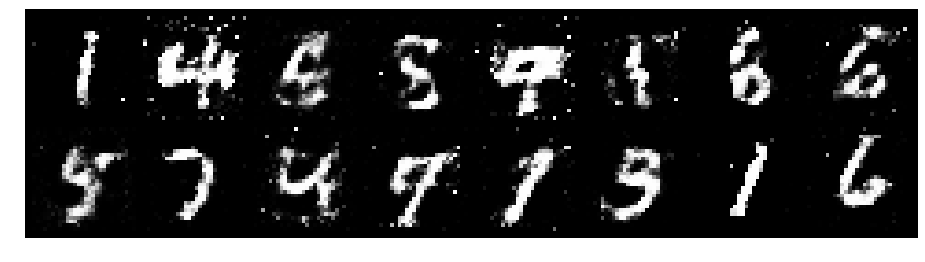

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.1449, Generator Loss: 1.1970
D(x): 0.6979, D(G(z)): 0.4468


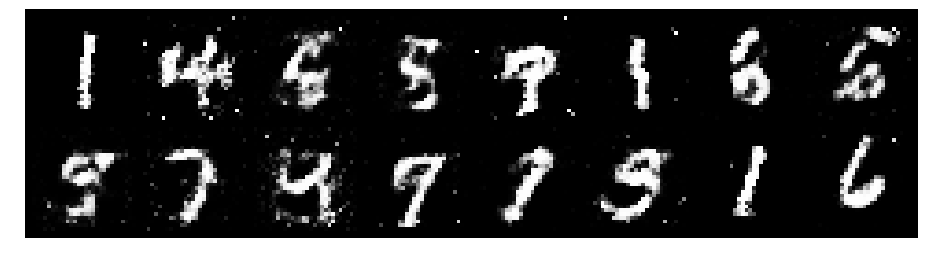

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.0853, Generator Loss: 1.5000
D(x): 0.7114, D(G(z)): 0.4017


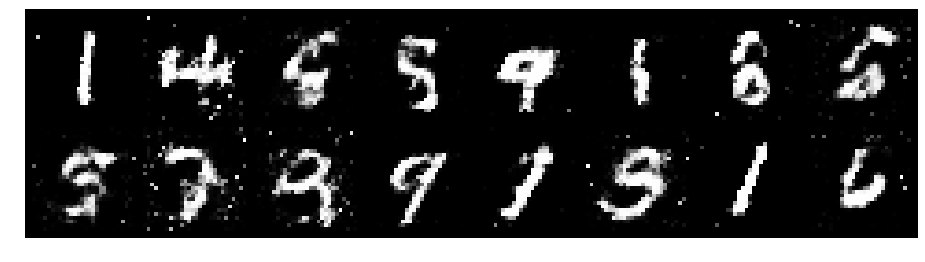

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 0.9921, Generator Loss: 1.4172
D(x): 0.6410, D(G(z)): 0.3059


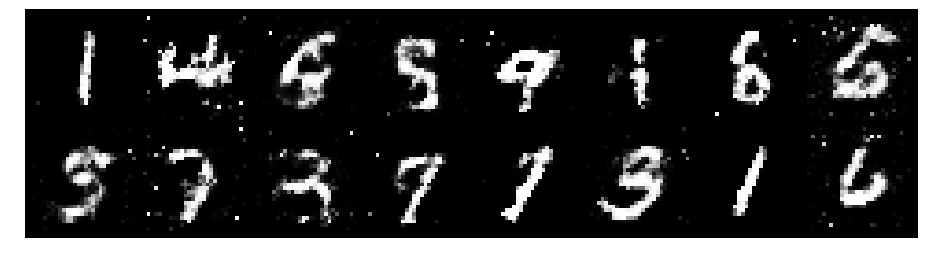

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.9595, Generator Loss: 1.3156
D(x): 0.6422, D(G(z)): 0.3044


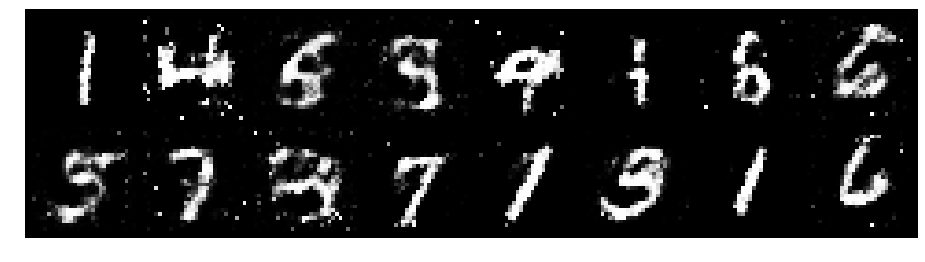

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.3131, Generator Loss: 0.9130
D(x): 0.5447, D(G(z)): 0.3913


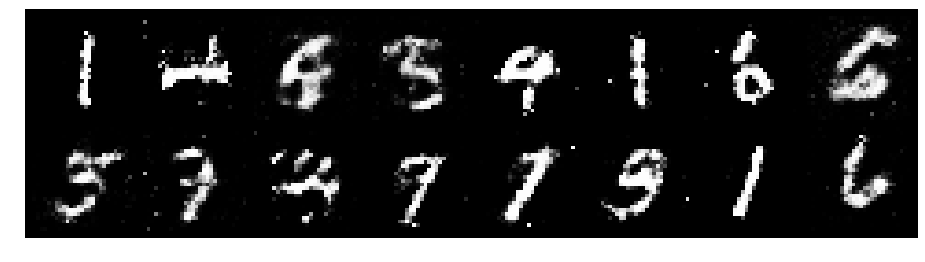

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0882, Generator Loss: 1.1945
D(x): 0.6244, D(G(z)): 0.3443


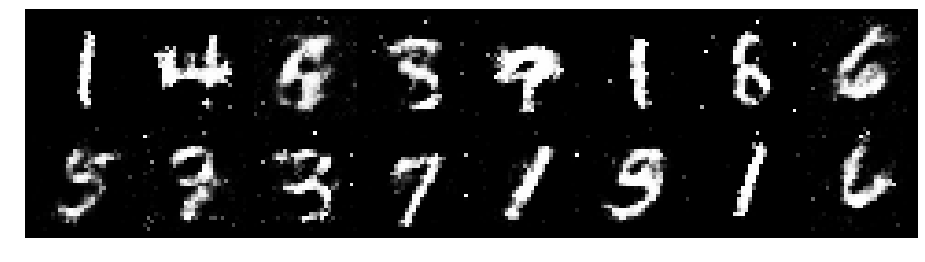

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.1163, Generator Loss: 1.5031
D(x): 0.5799, D(G(z)): 0.3102


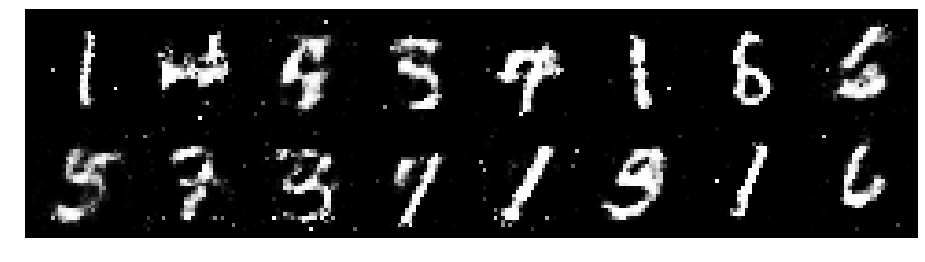

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.0302, Generator Loss: 1.2578
D(x): 0.6752, D(G(z)): 0.3626


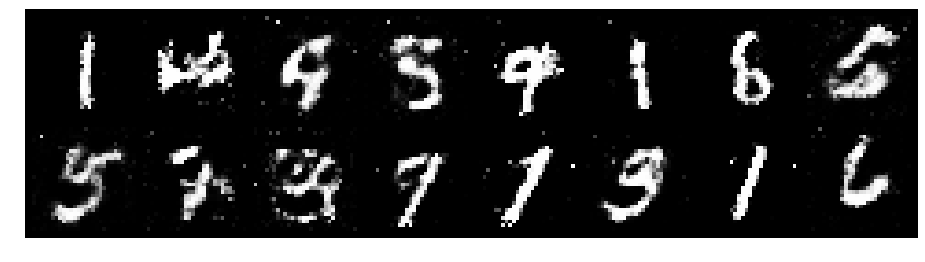

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.1296, Generator Loss: 1.2728
D(x): 0.5913, D(G(z)): 0.3225


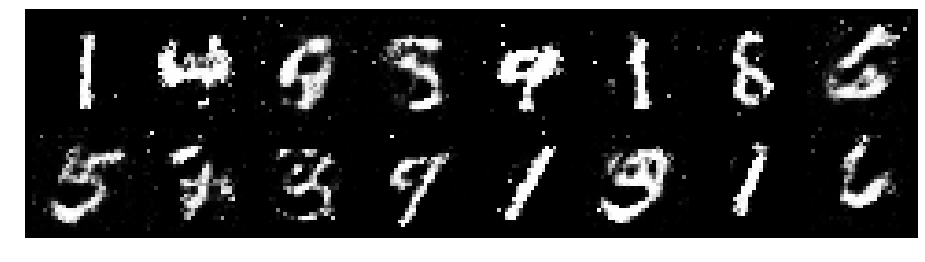

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.1924, Generator Loss: 1.1628
D(x): 0.5928, D(G(z)): 0.3837


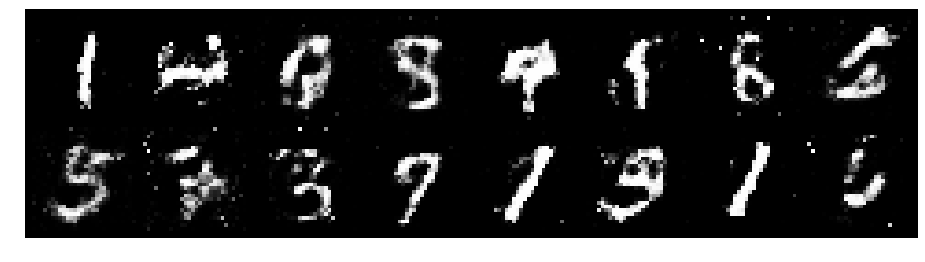

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 0.9770, Generator Loss: 1.0535
D(x): 0.6746, D(G(z)): 0.3726


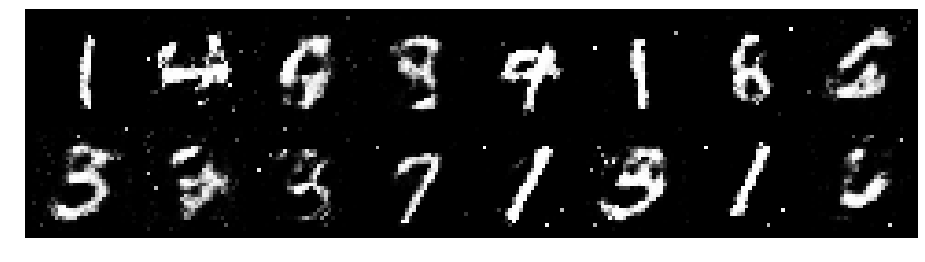

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.1037, Generator Loss: 0.8954
D(x): 0.6377, D(G(z)): 0.4301


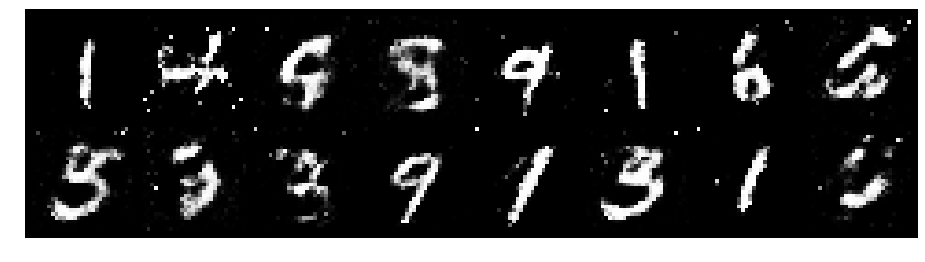

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.0432, Generator Loss: 1.1246
D(x): 0.6155, D(G(z)): 0.3651


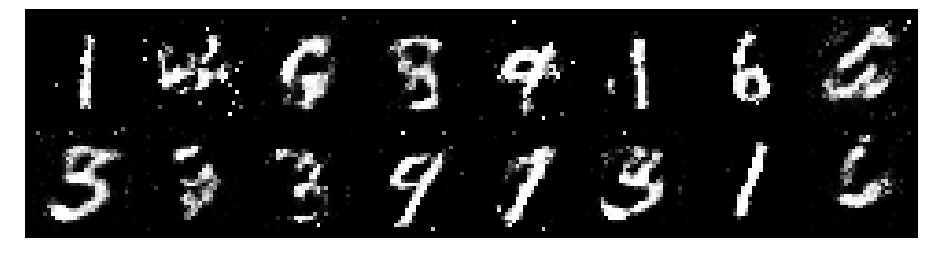

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.1105, Generator Loss: 1.2072
D(x): 0.6192, D(G(z)): 0.3764


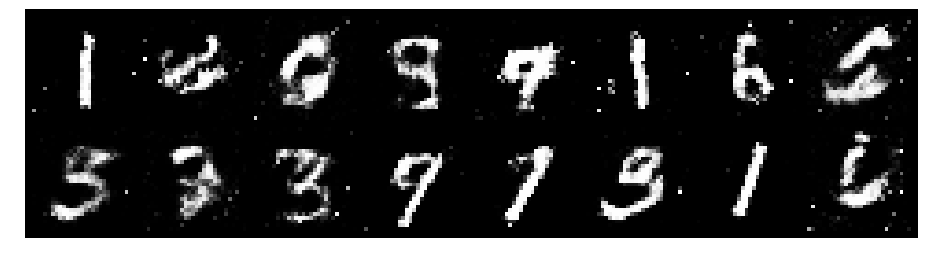

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.2173, Generator Loss: 1.4456
D(x): 0.6065, D(G(z)): 0.3820


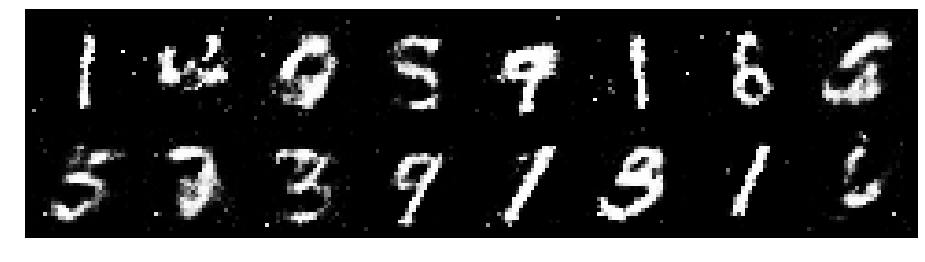

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.0280, Generator Loss: 1.1746
D(x): 0.6338, D(G(z)): 0.3390


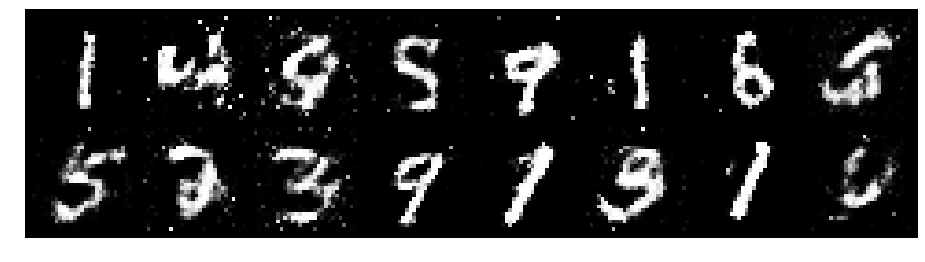

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.2728, Generator Loss: 1.7313
D(x): 0.5663, D(G(z)): 0.3383


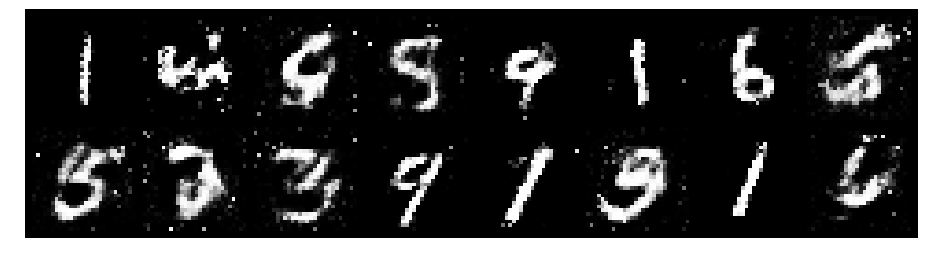

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.0649, Generator Loss: 1.0296
D(x): 0.6321, D(G(z)): 0.3764


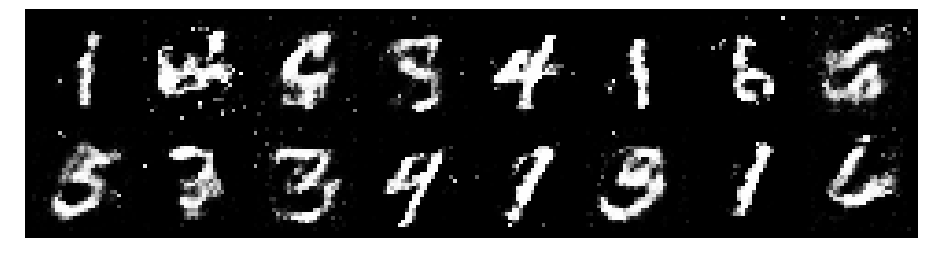

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 0.9679, Generator Loss: 1.2709
D(x): 0.6935, D(G(z)): 0.3317


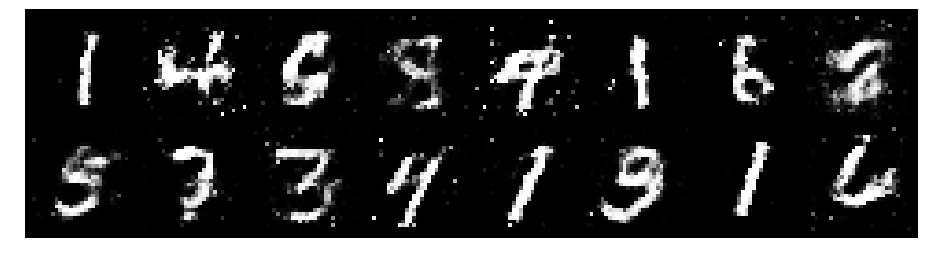

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1573, Generator Loss: 1.0052
D(x): 0.6733, D(G(z)): 0.4643


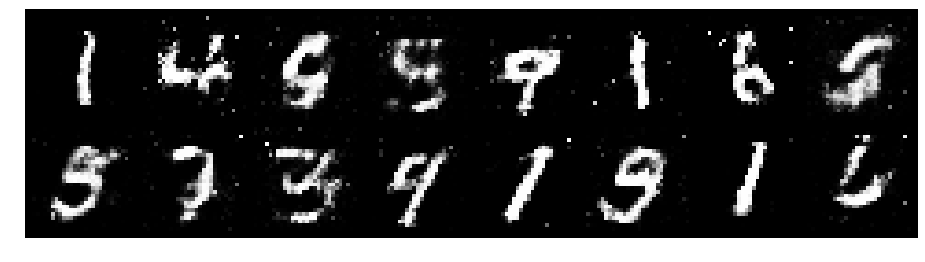

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.1538, Generator Loss: 1.0363
D(x): 0.6300, D(G(z)): 0.4134


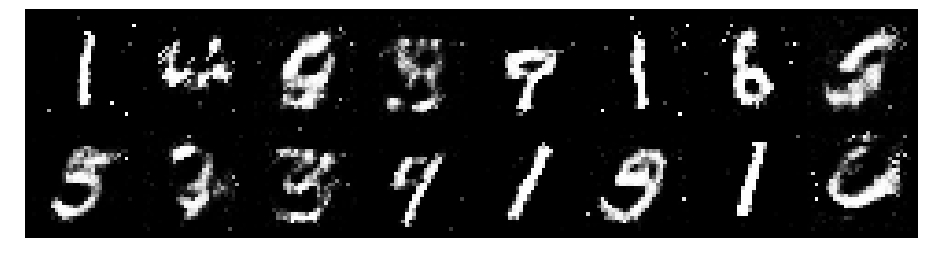

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.1063, Generator Loss: 0.8494
D(x): 0.6363, D(G(z)): 0.4228


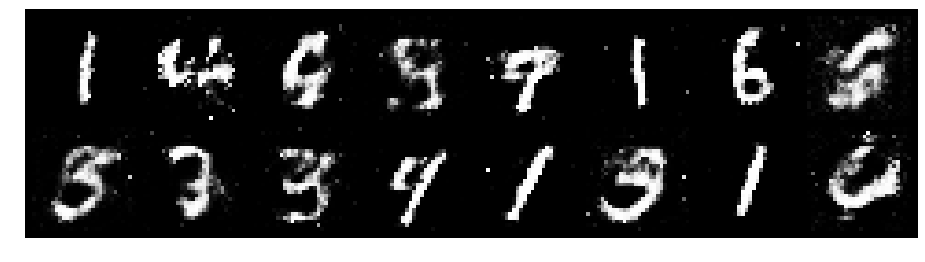

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1392, Generator Loss: 1.3274
D(x): 0.6415, D(G(z)): 0.3724


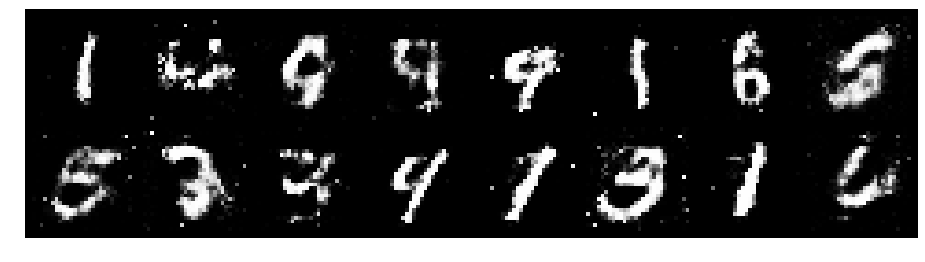

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.1369, Generator Loss: 1.1502
D(x): 0.6261, D(G(z)): 0.3881


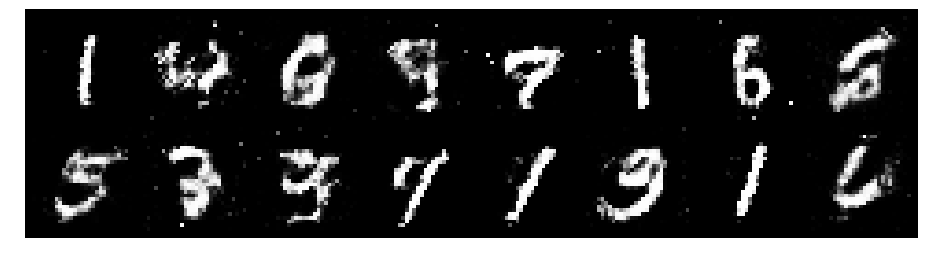

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1278, Generator Loss: 0.9993
D(x): 0.6000, D(G(z)): 0.3633


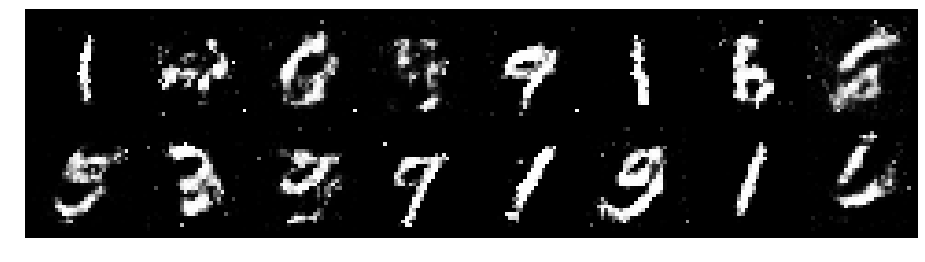

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 0.9782, Generator Loss: 1.2312
D(x): 0.7230, D(G(z)): 0.3961


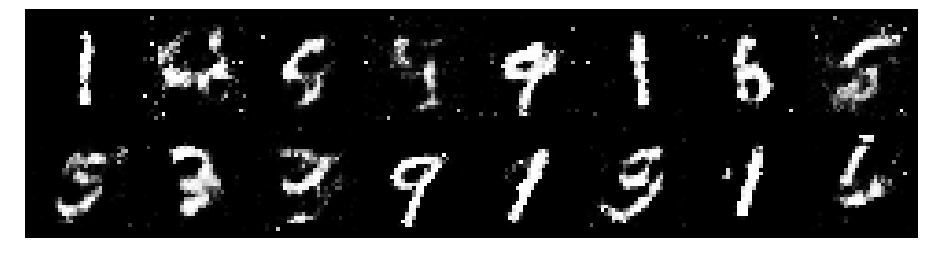

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 0.9933, Generator Loss: 1.1217
D(x): 0.6554, D(G(z)): 0.3503


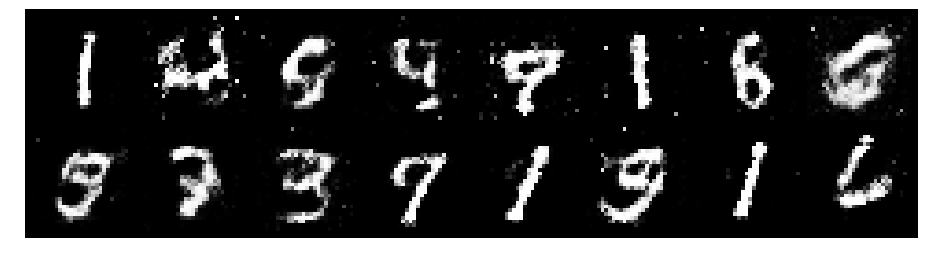

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 0.9819, Generator Loss: 1.3444
D(x): 0.6432, D(G(z)): 0.3198


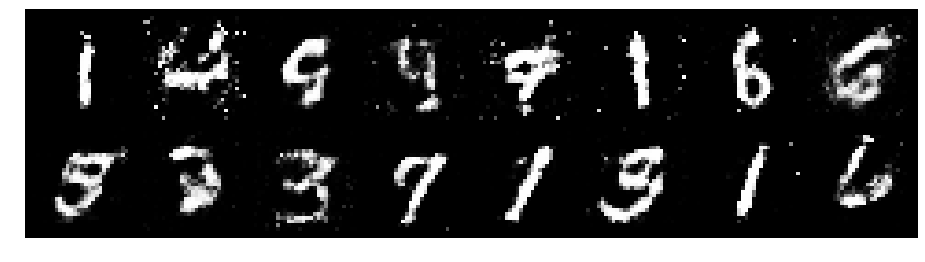

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.0842, Generator Loss: 1.2345
D(x): 0.5704, D(G(z)): 0.3407


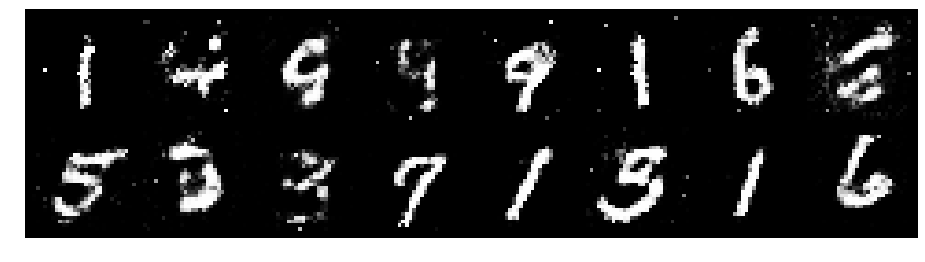

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 0.9661, Generator Loss: 1.2523
D(x): 0.6667, D(G(z)): 0.3294


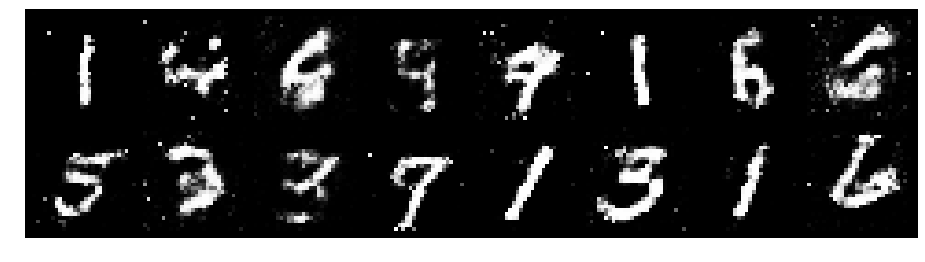

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.0760, Generator Loss: 1.3112
D(x): 0.6356, D(G(z)): 0.3545


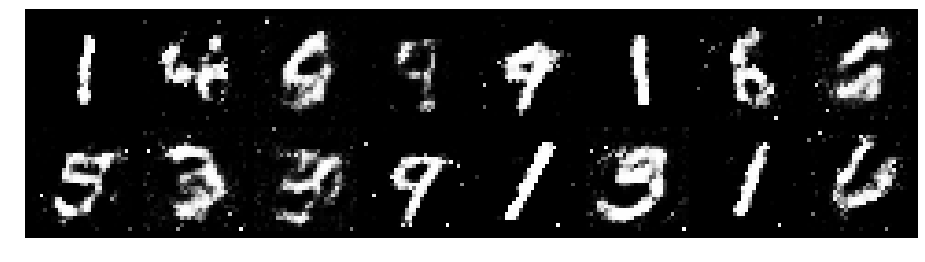

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.0705, Generator Loss: 1.1151
D(x): 0.6862, D(G(z)): 0.3918


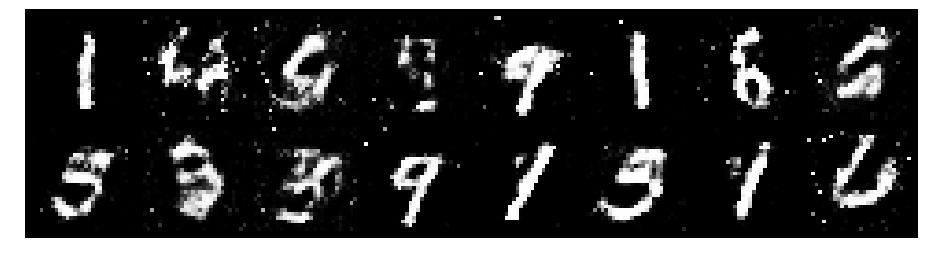

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 0.9335, Generator Loss: 1.1374
D(x): 0.6815, D(G(z)): 0.3563


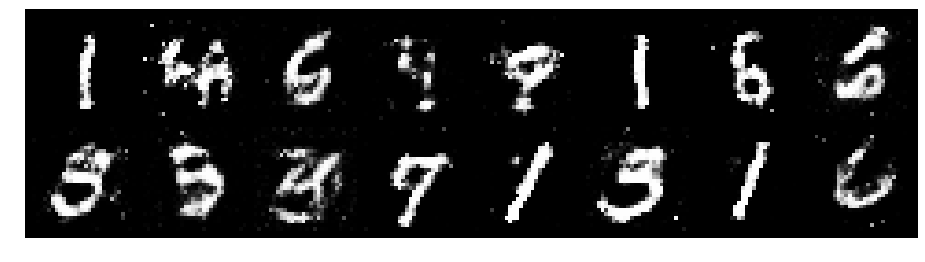

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.1720, Generator Loss: 1.2159
D(x): 0.6334, D(G(z)): 0.4039


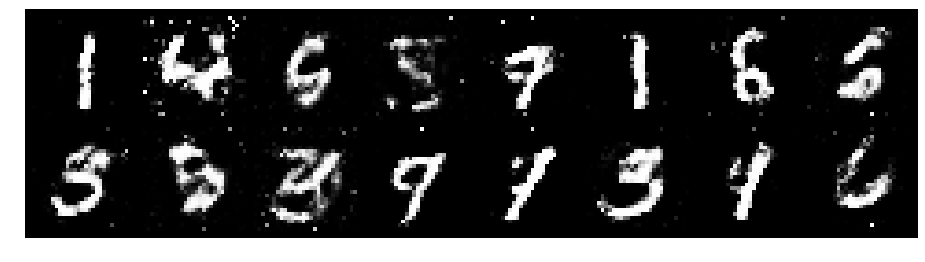

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.0957, Generator Loss: 1.0927
D(x): 0.6440, D(G(z)): 0.3822


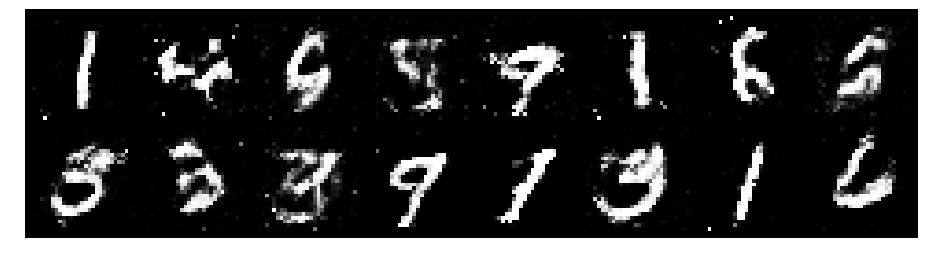

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1256, Generator Loss: 1.4945
D(x): 0.6749, D(G(z)): 0.3810


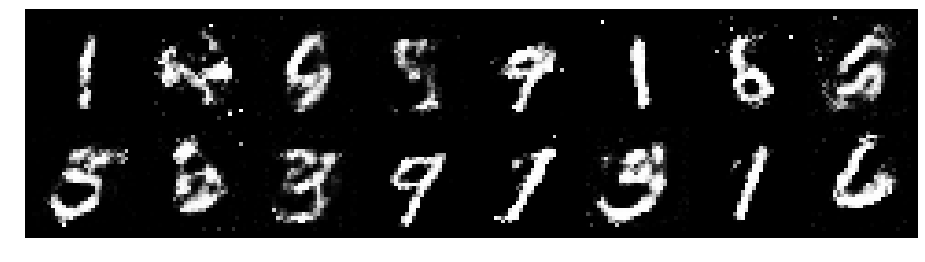

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 0.9572, Generator Loss: 1.6318
D(x): 0.6388, D(G(z)): 0.2937


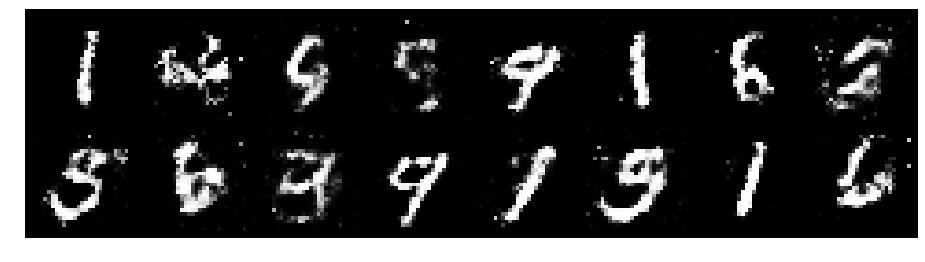

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.0512, Generator Loss: 1.2294
D(x): 0.6336, D(G(z)): 0.3832


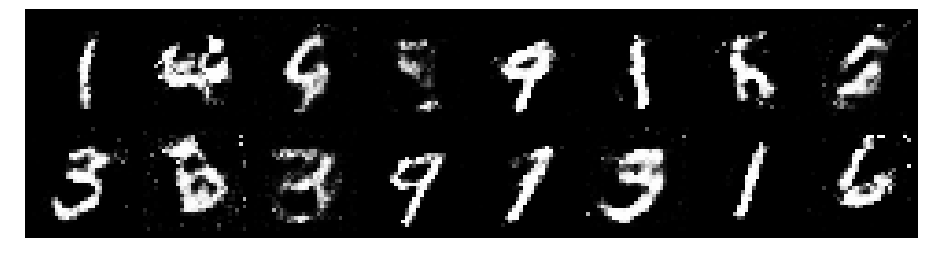

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 0.9794, Generator Loss: 1.1602
D(x): 0.6502, D(G(z)): 0.3385


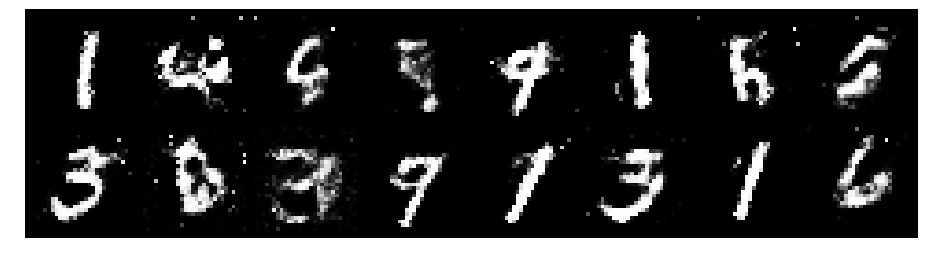

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 0.9704, Generator Loss: 1.3363
D(x): 0.6392, D(G(z)): 0.3391


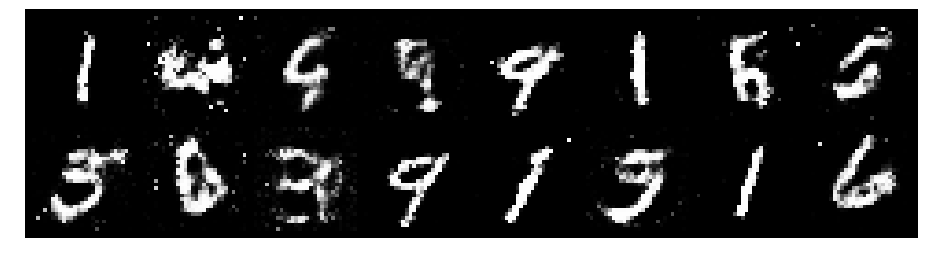

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 0.9731, Generator Loss: 1.1518
D(x): 0.7313, D(G(z)): 0.4076


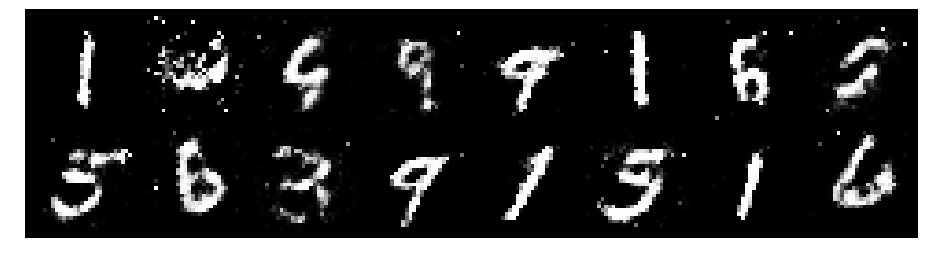

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.1035, Generator Loss: 1.3026
D(x): 0.6482, D(G(z)): 0.4039


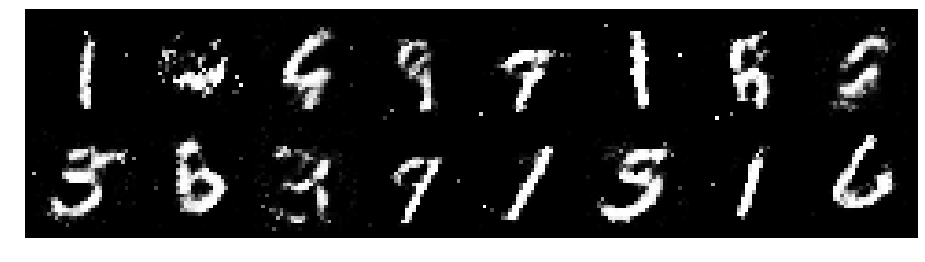

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.0729, Generator Loss: 1.1799
D(x): 0.5971, D(G(z)): 0.3363


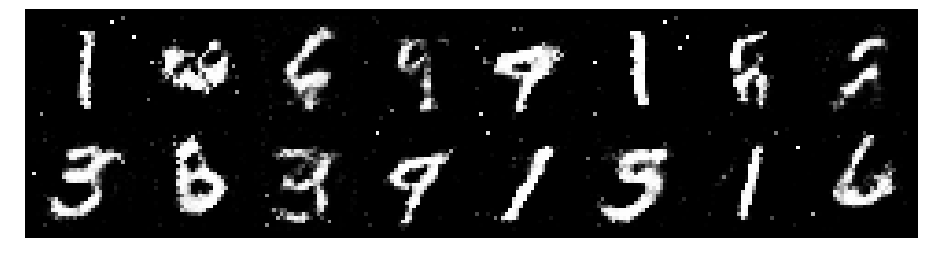

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.1002, Generator Loss: 1.0507
D(x): 0.6370, D(G(z)): 0.3975


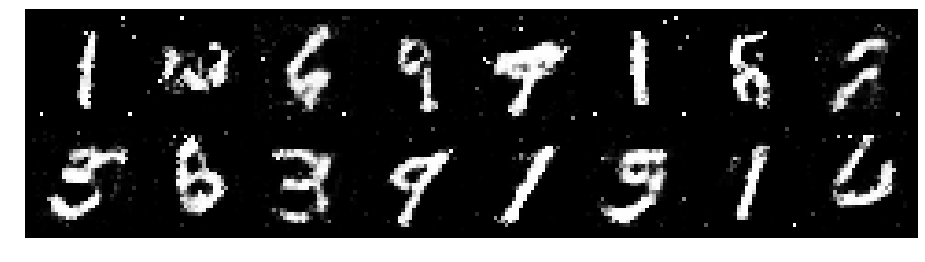

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 0.8917, Generator Loss: 1.2887
D(x): 0.6584, D(G(z)): 0.3077


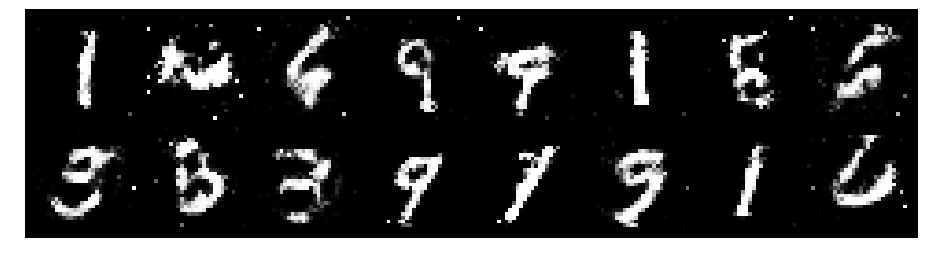

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.0951, Generator Loss: 1.1573
D(x): 0.6070, D(G(z)): 0.3684


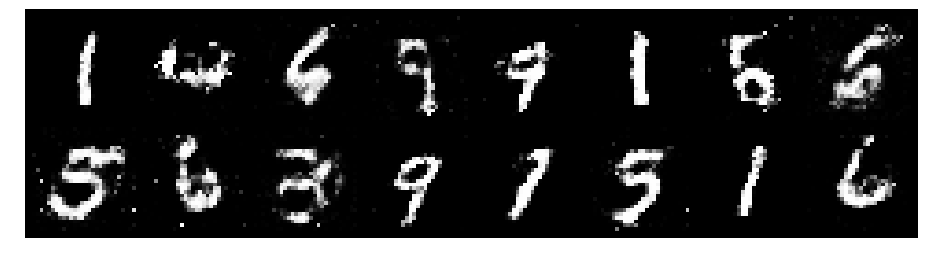

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1221, Generator Loss: 1.0719
D(x): 0.6472, D(G(z)): 0.4110


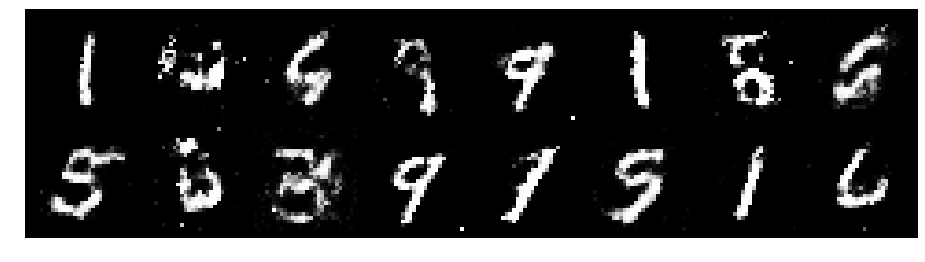

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.2907, Generator Loss: 0.9324
D(x): 0.6177, D(G(z)): 0.4591


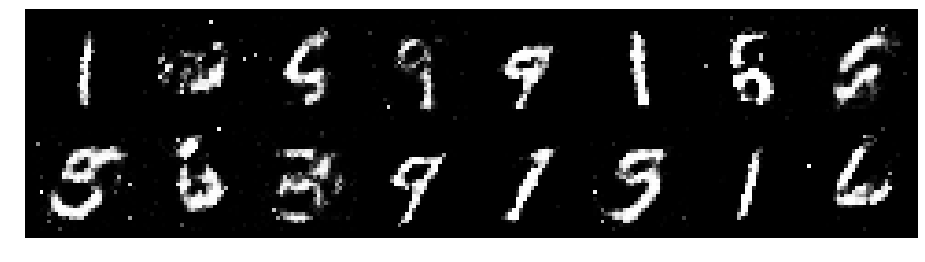

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.0538, Generator Loss: 1.1996
D(x): 0.6156, D(G(z)): 0.3463


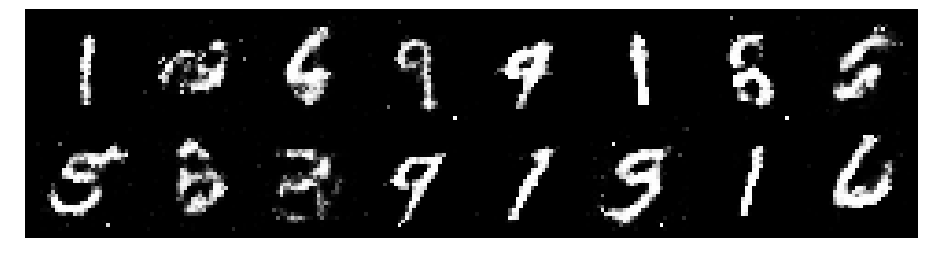

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1439, Generator Loss: 1.0702
D(x): 0.6459, D(G(z)): 0.4214


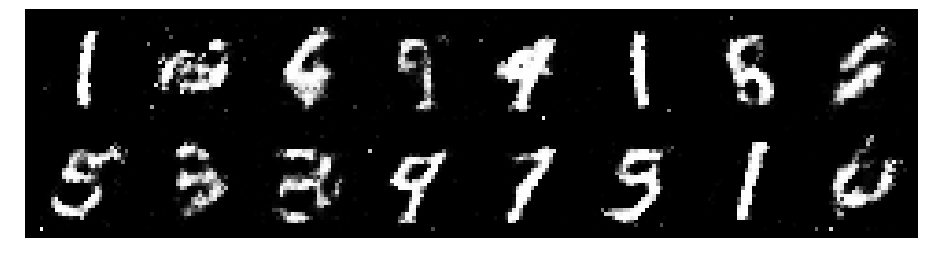

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1321, Generator Loss: 1.0229
D(x): 0.6522, D(G(z)): 0.4298


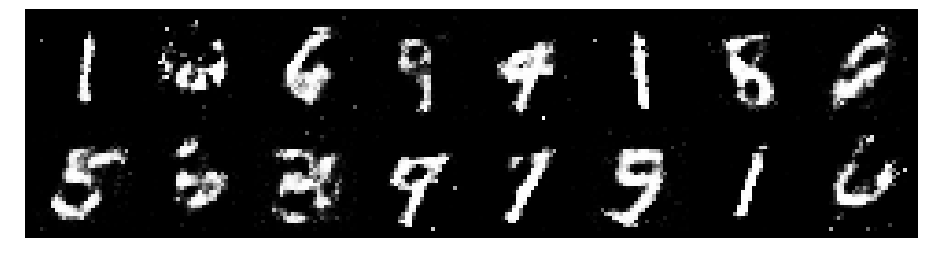

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1726, Generator Loss: 1.0388
D(x): 0.5770, D(G(z)): 0.3613


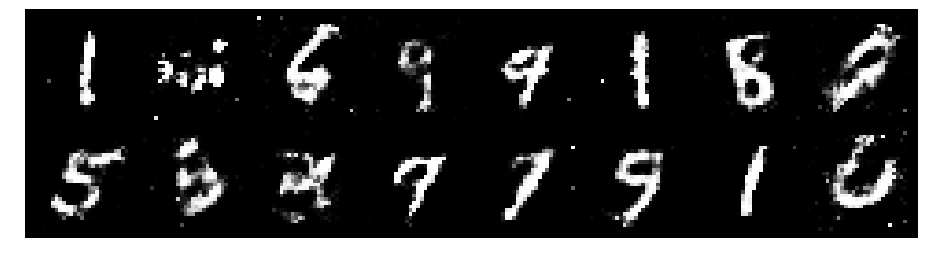

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.3242, Generator Loss: 1.1293
D(x): 0.6086, D(G(z)): 0.4365


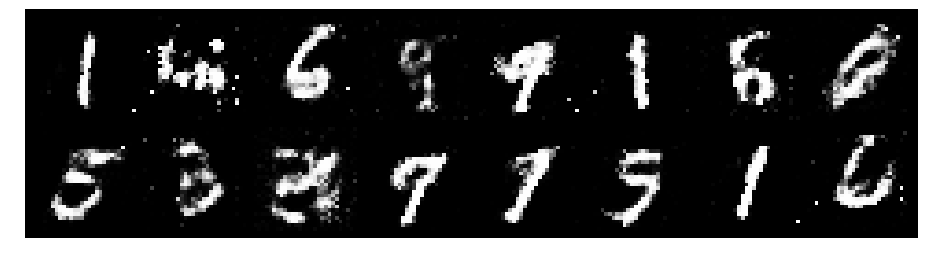

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0466, Generator Loss: 1.2670
D(x): 0.6092, D(G(z)): 0.3264


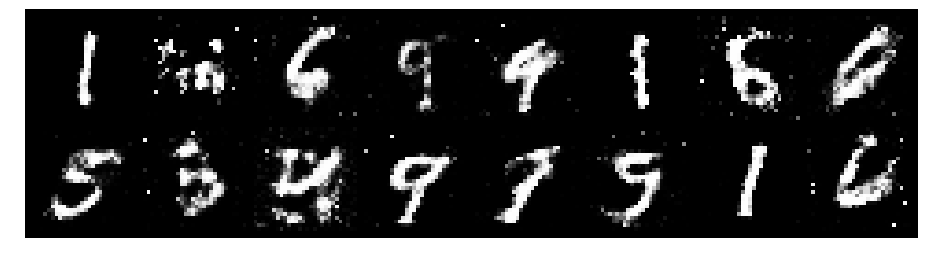

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.1375, Generator Loss: 1.3718
D(x): 0.6125, D(G(z)): 0.3536


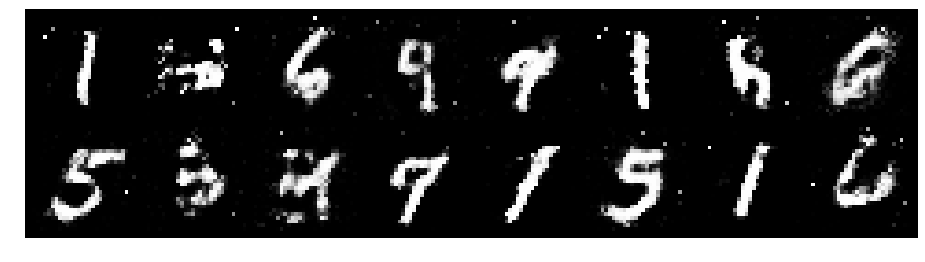

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.1994, Generator Loss: 0.9935
D(x): 0.6674, D(G(z)): 0.4405


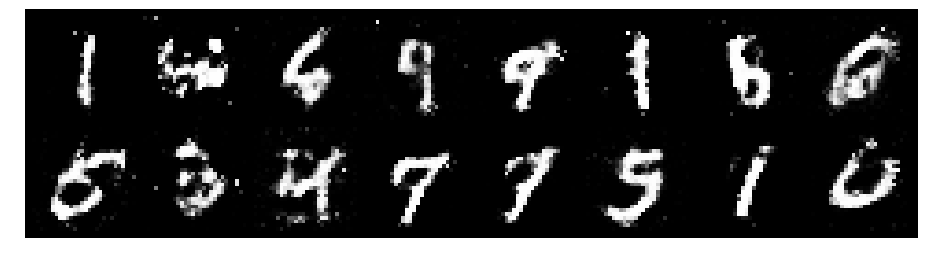

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.2354, Generator Loss: 1.1283
D(x): 0.6864, D(G(z)): 0.4797


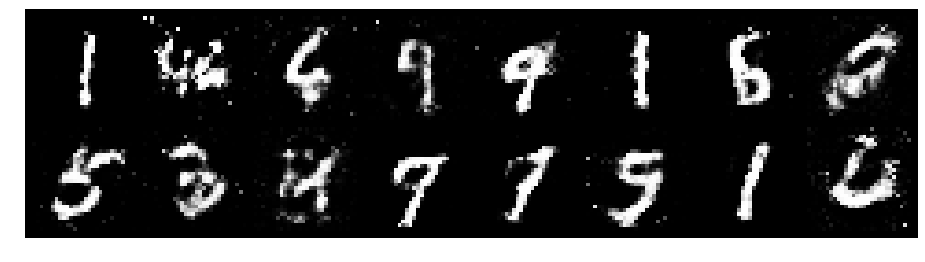

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1995, Generator Loss: 1.2001
D(x): 0.5913, D(G(z)): 0.3804


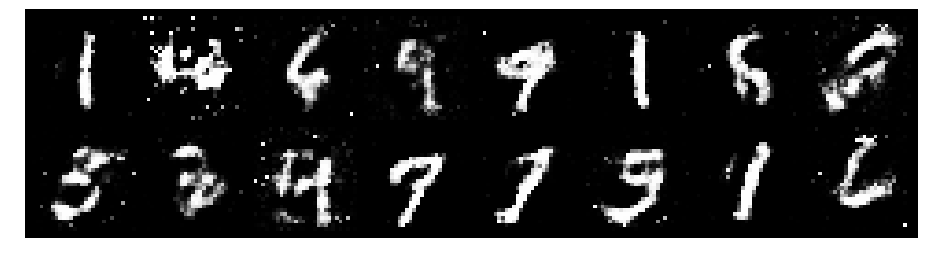

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1561, Generator Loss: 0.9741
D(x): 0.6142, D(G(z)): 0.4045


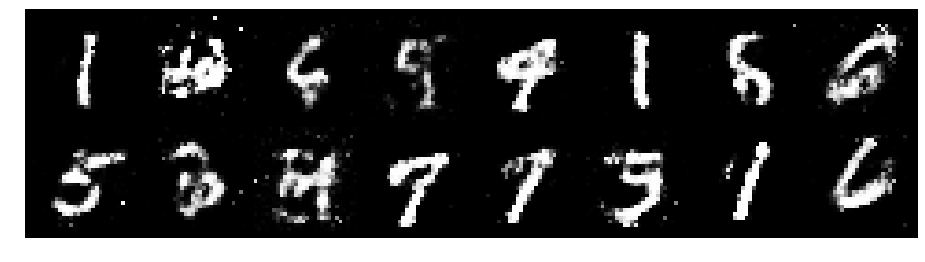

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.1065, Generator Loss: 1.2147
D(x): 0.5897, D(G(z)): 0.3600


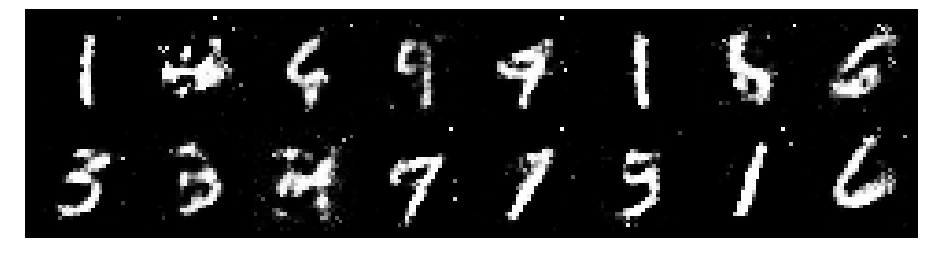

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1435, Generator Loss: 1.2702
D(x): 0.6187, D(G(z)): 0.3828


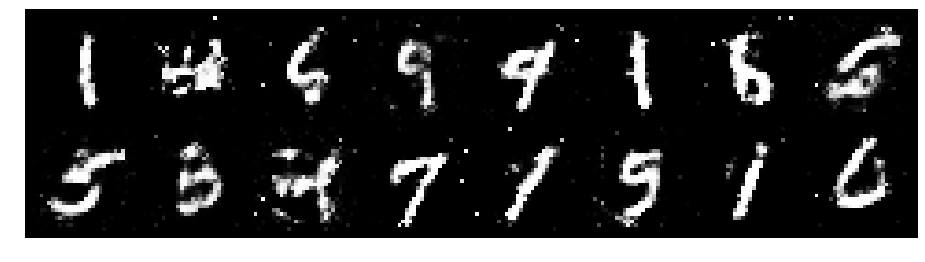

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1564, Generator Loss: 1.2211
D(x): 0.5682, D(G(z)): 0.3350


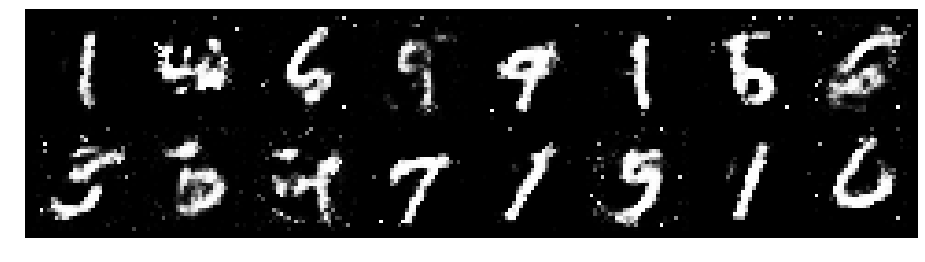

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.0843, Generator Loss: 1.2339
D(x): 0.6063, D(G(z)): 0.3559


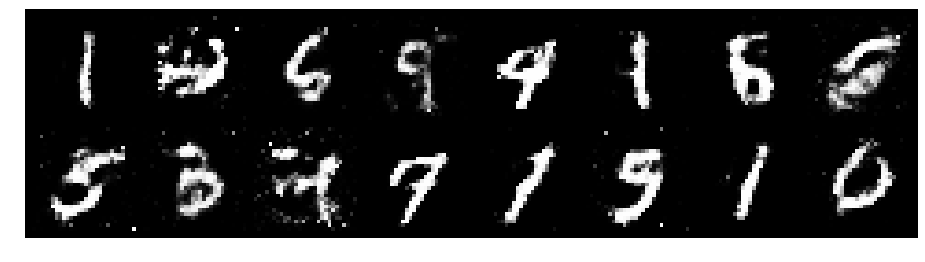

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.1226, Generator Loss: 1.2128
D(x): 0.6349, D(G(z)): 0.3921


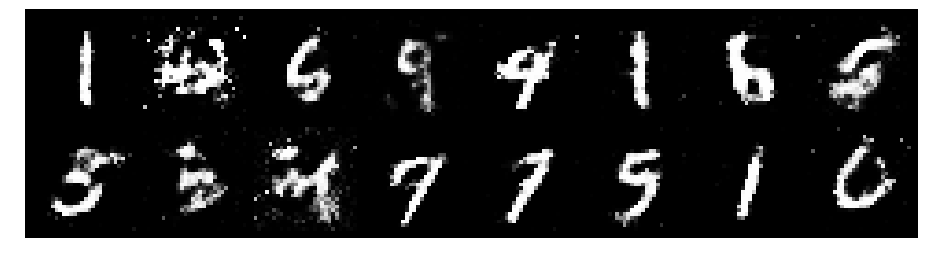

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1540, Generator Loss: 1.0282
D(x): 0.5823, D(G(z)): 0.3821


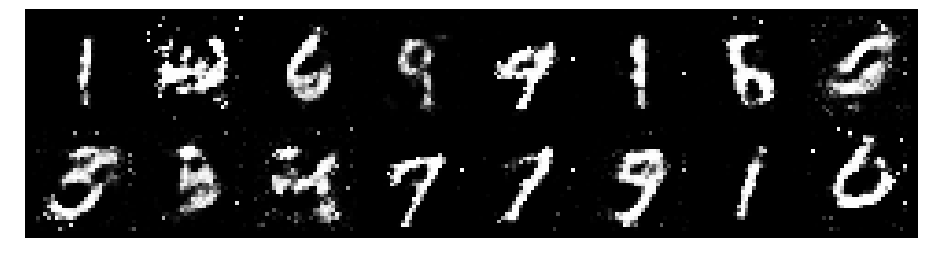

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.2676, Generator Loss: 1.0077
D(x): 0.5947, D(G(z)): 0.4527


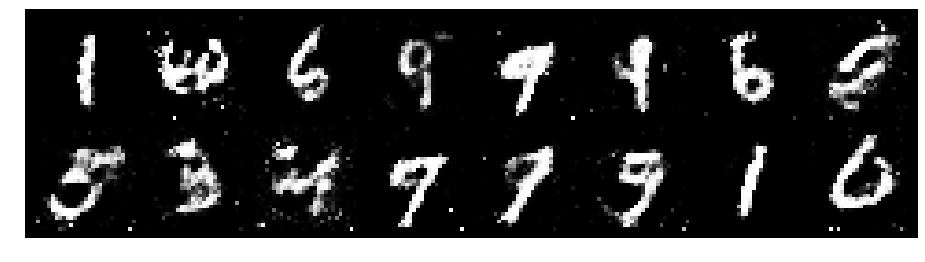

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.2366, Generator Loss: 1.0204
D(x): 0.5694, D(G(z)): 0.4349


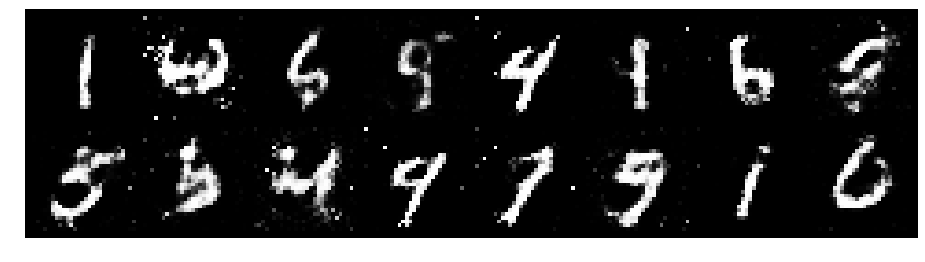

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.1194, Generator Loss: 1.0765
D(x): 0.6492, D(G(z)): 0.4124


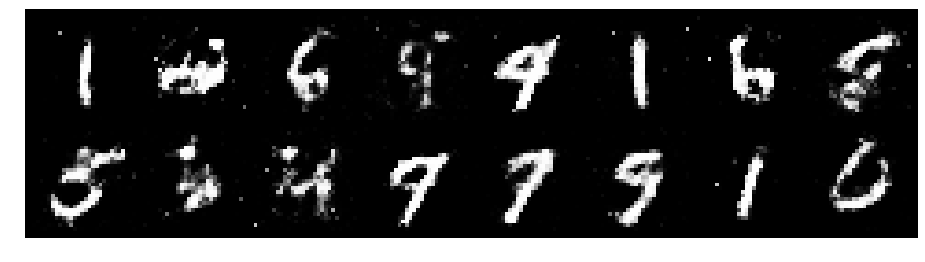

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1683, Generator Loss: 1.1822
D(x): 0.5903, D(G(z)): 0.3806


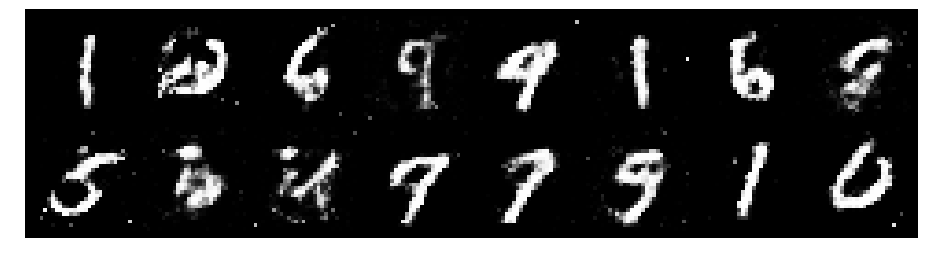

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.0887, Generator Loss: 1.0478
D(x): 0.6321, D(G(z)): 0.3910


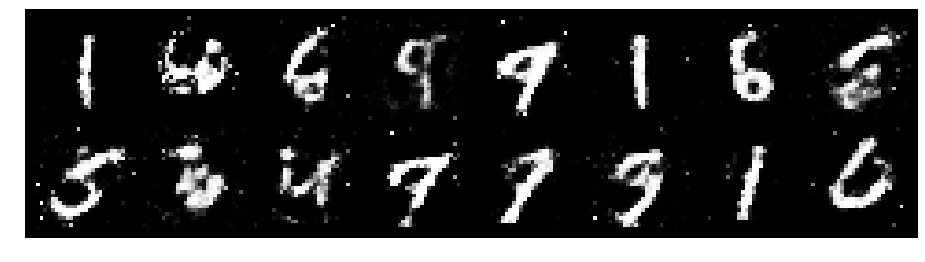

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.2970, Generator Loss: 0.9488
D(x): 0.5200, D(G(z)): 0.4077


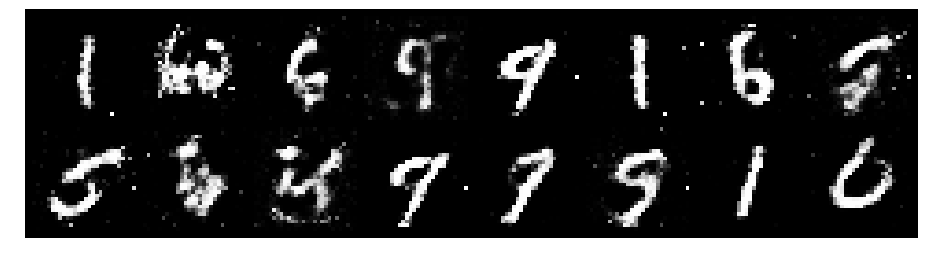

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1042, Generator Loss: 1.2256
D(x): 0.5836, D(G(z)): 0.3587


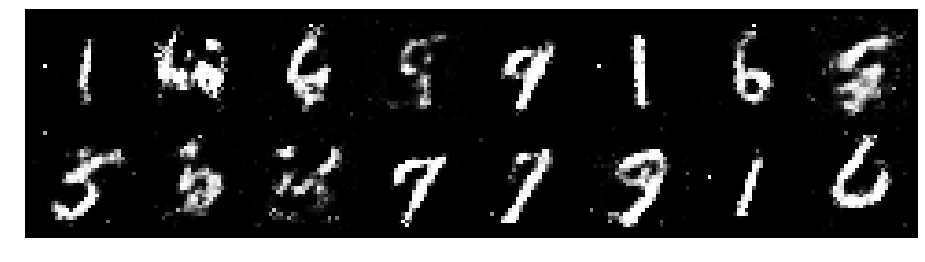

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1817, Generator Loss: 0.9435
D(x): 0.6316, D(G(z)): 0.4141


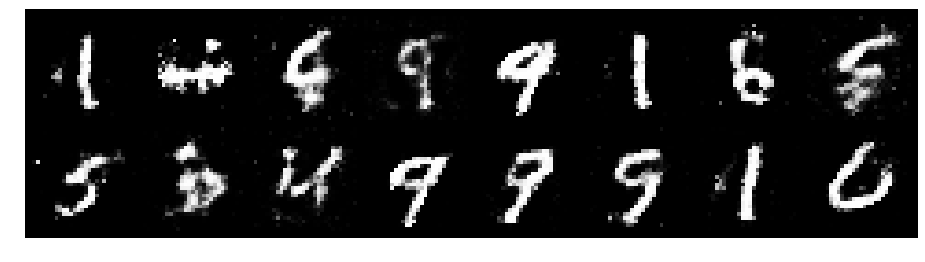

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.1515, Generator Loss: 0.9307
D(x): 0.6420, D(G(z)): 0.4133


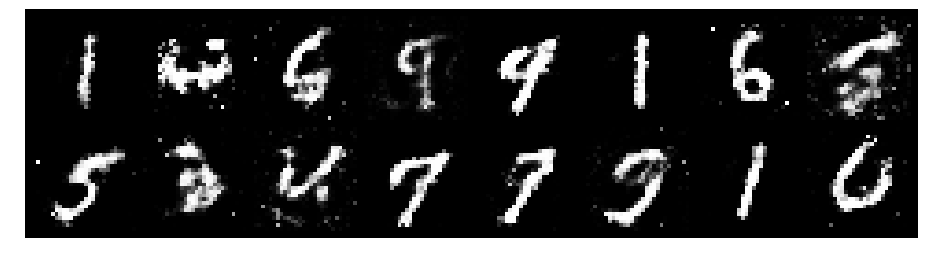

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1832, Generator Loss: 1.0796
D(x): 0.5857, D(G(z)): 0.4072


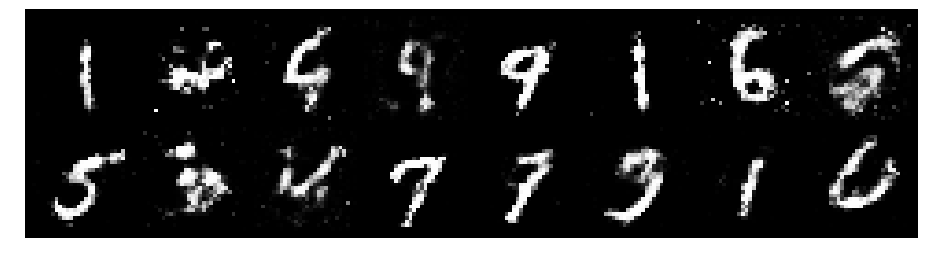

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.0795, Generator Loss: 1.1353
D(x): 0.6235, D(G(z)): 0.3852


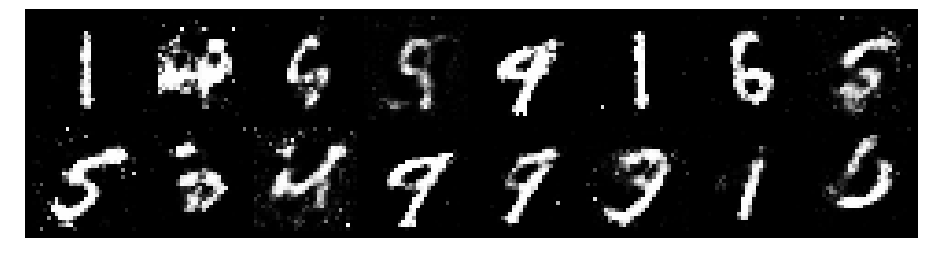

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.0927, Generator Loss: 0.9660
D(x): 0.6490, D(G(z)): 0.4313


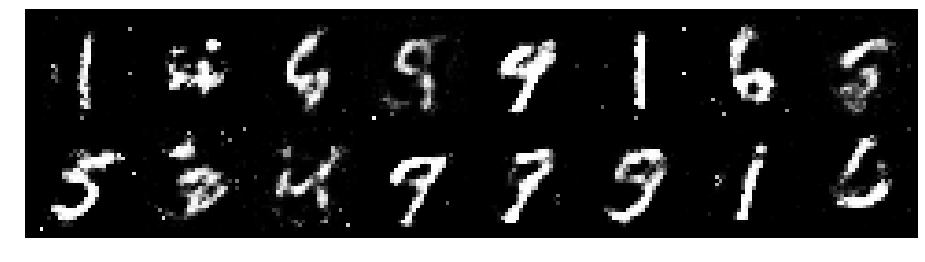

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1826, Generator Loss: 0.8776
D(x): 0.5726, D(G(z)): 0.4001


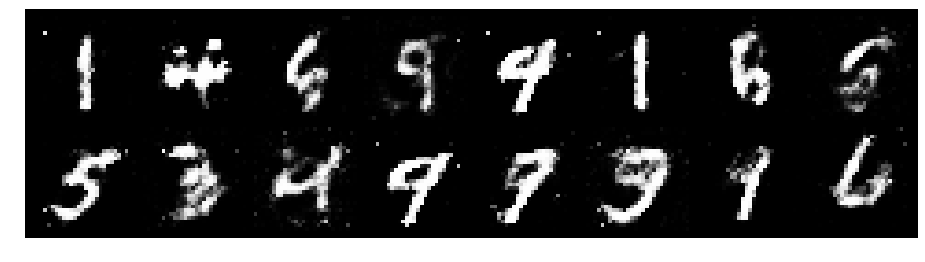

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.0942, Generator Loss: 1.0424
D(x): 0.6318, D(G(z)): 0.4084


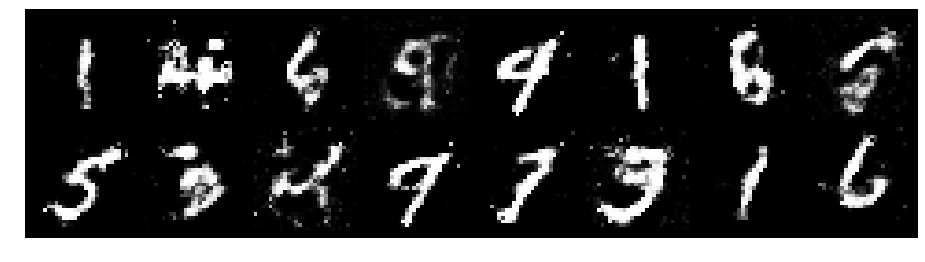

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.0271, Generator Loss: 1.0970
D(x): 0.6022, D(G(z)): 0.3296


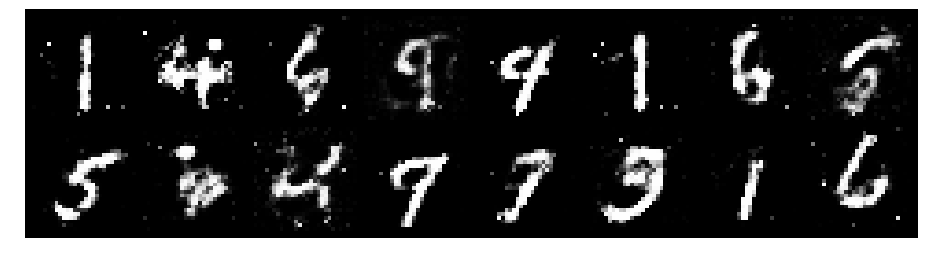

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2086, Generator Loss: 1.1863
D(x): 0.5497, D(G(z)): 0.3481


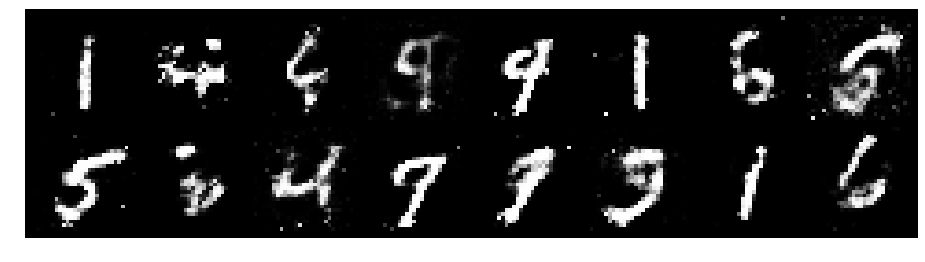

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.2109, Generator Loss: 0.9737
D(x): 0.6689, D(G(z)): 0.4376


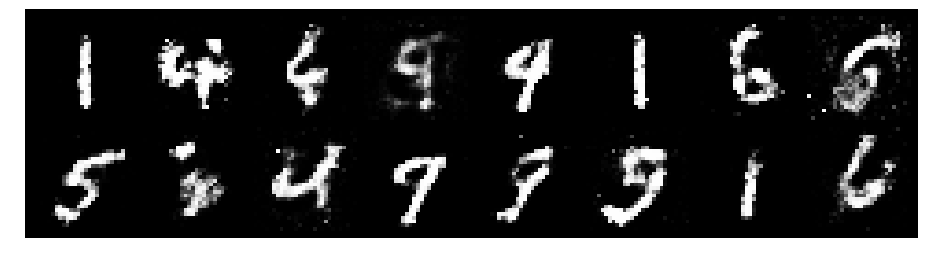

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.1308, Generator Loss: 0.9802
D(x): 0.6274, D(G(z)): 0.4034


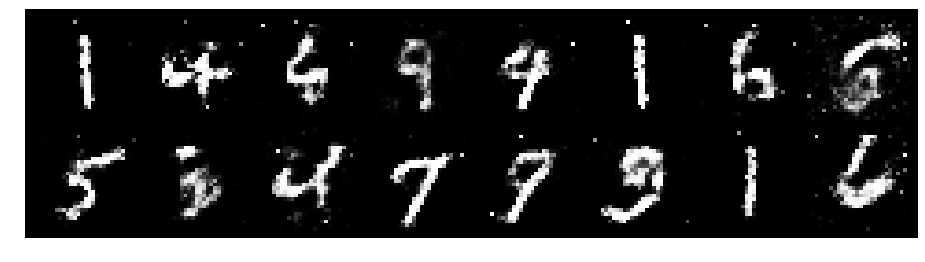

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.0283, Generator Loss: 1.2779
D(x): 0.6308, D(G(z)): 0.3331


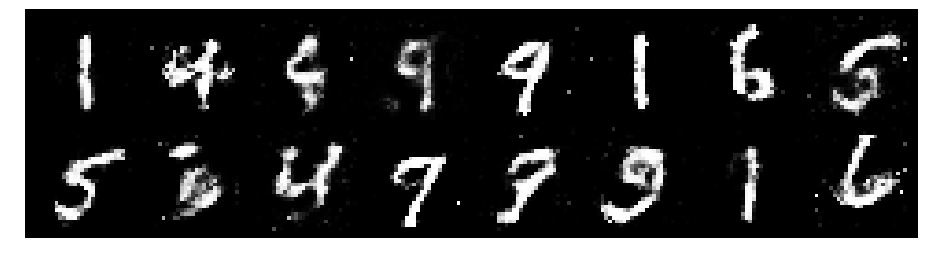

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1838, Generator Loss: 1.0084
D(x): 0.5863, D(G(z)): 0.4125


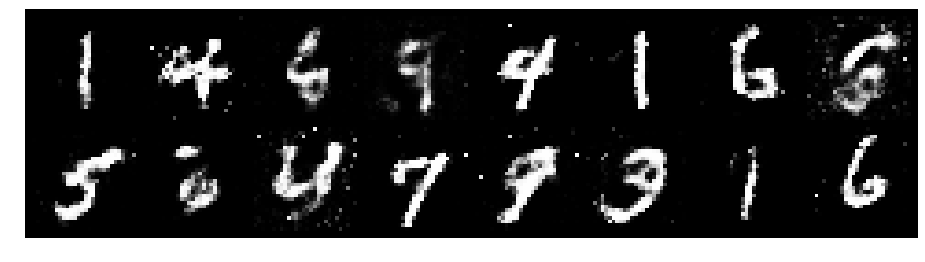

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.0692, Generator Loss: 1.3147
D(x): 0.6257, D(G(z)): 0.3703


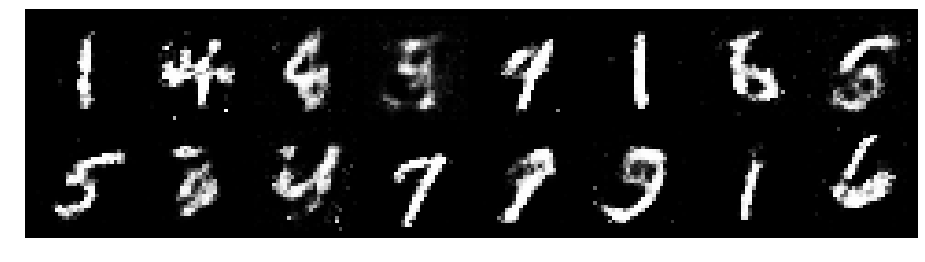

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 0.9578, Generator Loss: 1.3300
D(x): 0.6556, D(G(z)): 0.3277


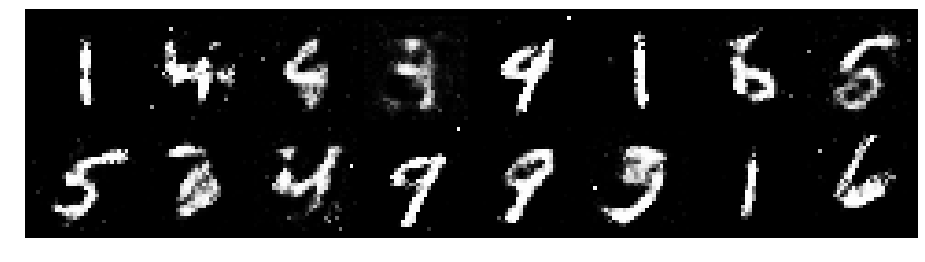

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.2912, Generator Loss: 1.0167
D(x): 0.6090, D(G(z)): 0.4618


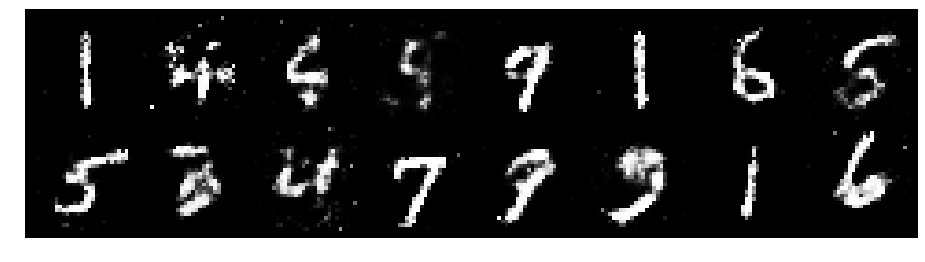

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.4435, Generator Loss: 0.9599
D(x): 0.6291, D(G(z)): 0.5276


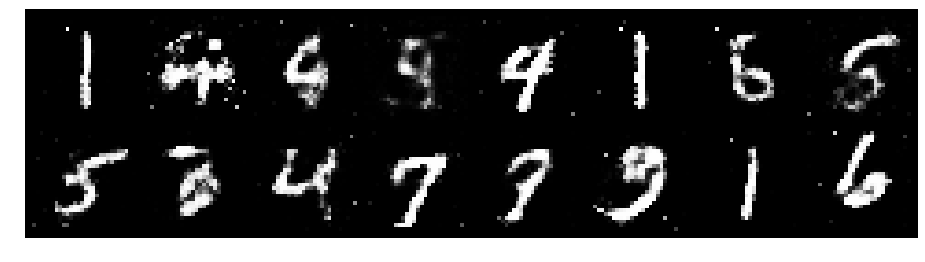

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.2629, Generator Loss: 1.1415
D(x): 0.5401, D(G(z)): 0.3588


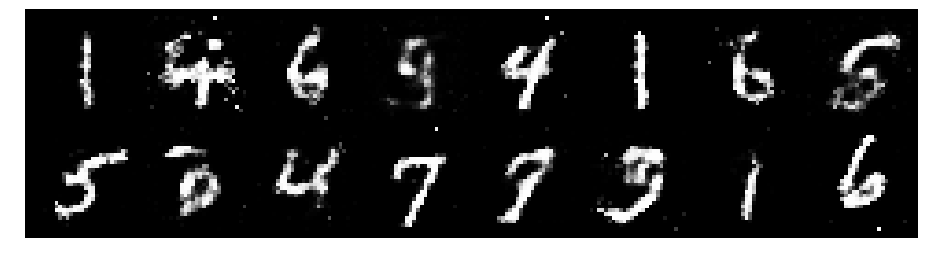

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2641, Generator Loss: 0.8276
D(x): 0.6000, D(G(z)): 0.4470


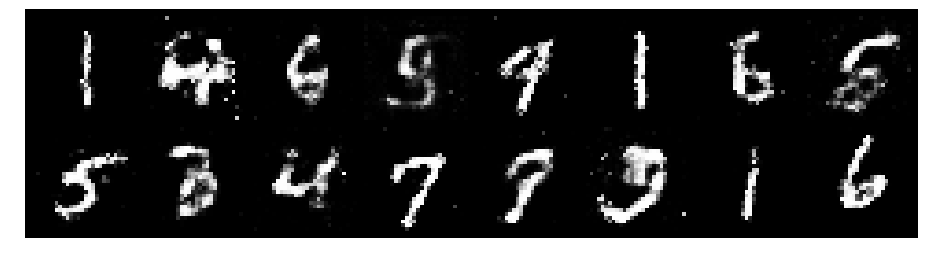

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.0903, Generator Loss: 1.1287
D(x): 0.6193, D(G(z)): 0.3698


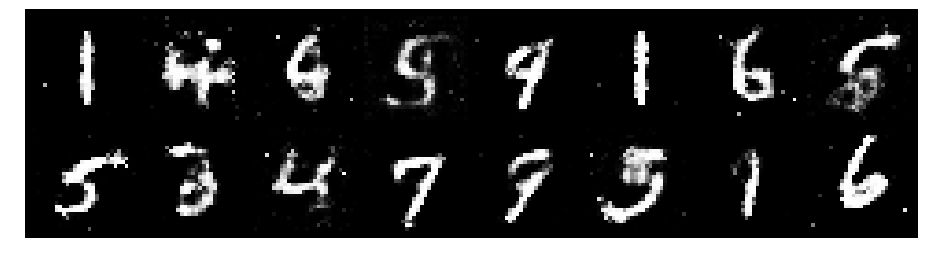

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.0792, Generator Loss: 1.4593
D(x): 0.6143, D(G(z)): 0.3330


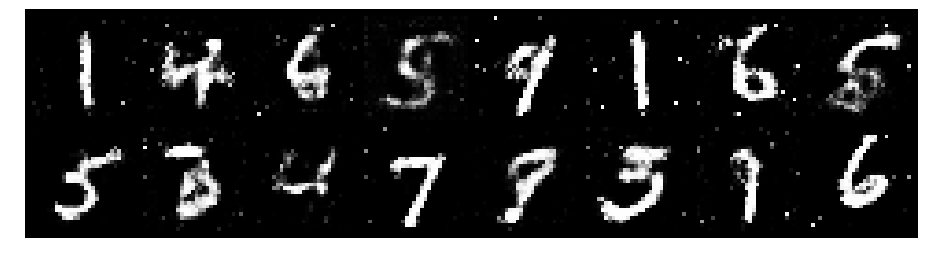

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1579, Generator Loss: 0.9072
D(x): 0.5757, D(G(z)): 0.4162


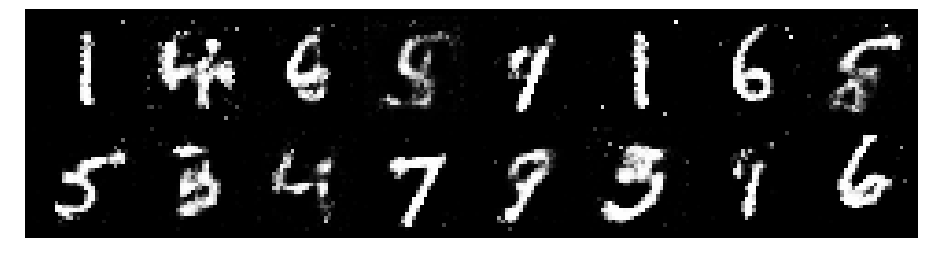

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.3513, Generator Loss: 1.0209
D(x): 0.5393, D(G(z)): 0.4642


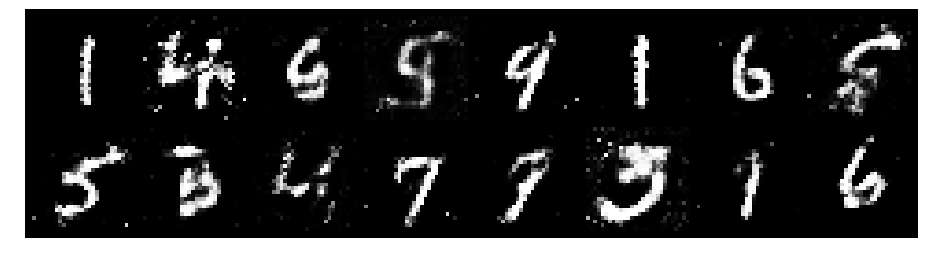

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.1368, Generator Loss: 0.8891
D(x): 0.6079, D(G(z)): 0.3944


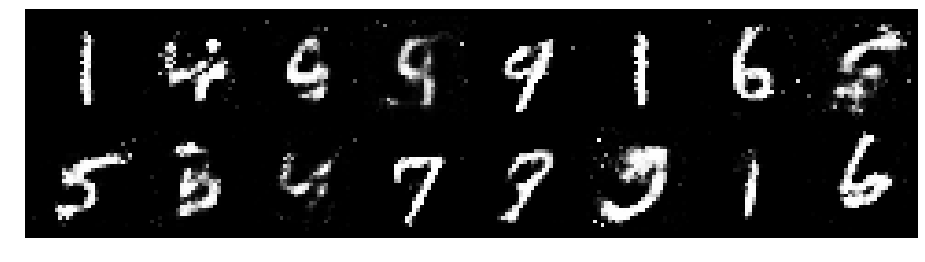

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2363, Generator Loss: 1.0065
D(x): 0.6020, D(G(z)): 0.4406


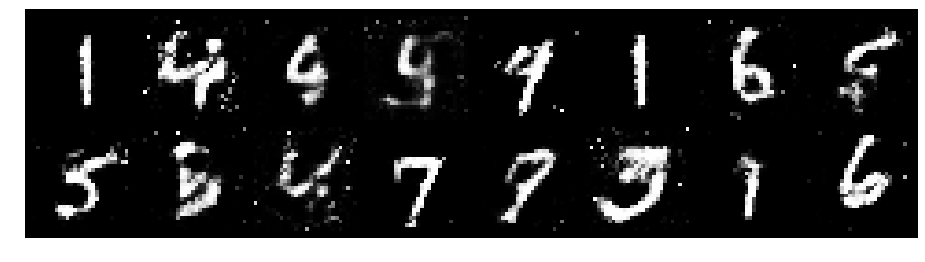

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.2005, Generator Loss: 0.9849
D(x): 0.6027, D(G(z)): 0.4174


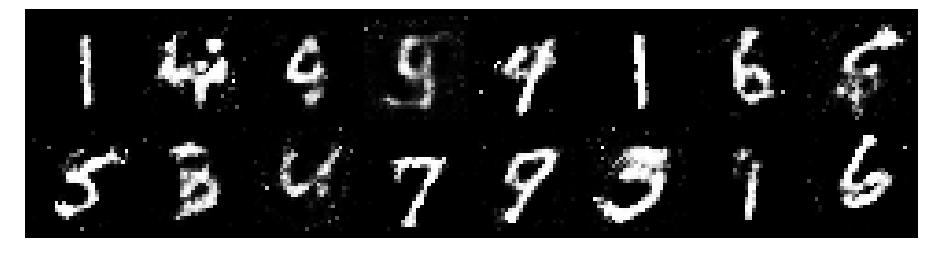

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.2669, Generator Loss: 0.9140
D(x): 0.6029, D(G(z)): 0.4421


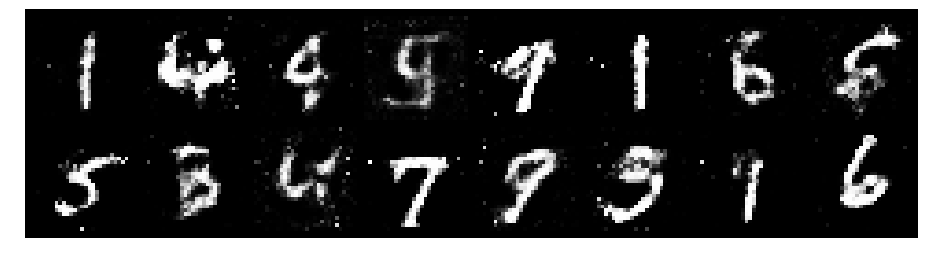

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.0783, Generator Loss: 1.0723
D(x): 0.5956, D(G(z)): 0.3428


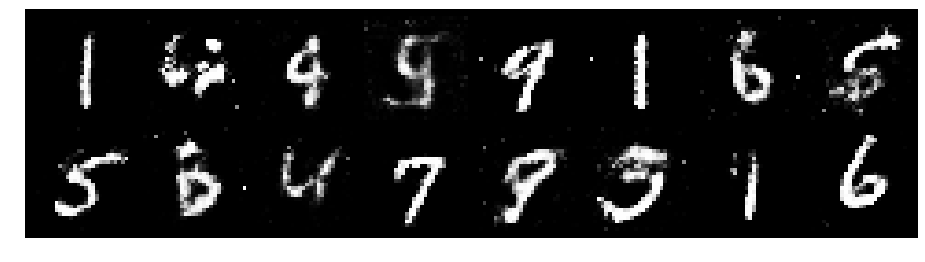

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 0.9899, Generator Loss: 1.0017
D(x): 0.6687, D(G(z)): 0.3797


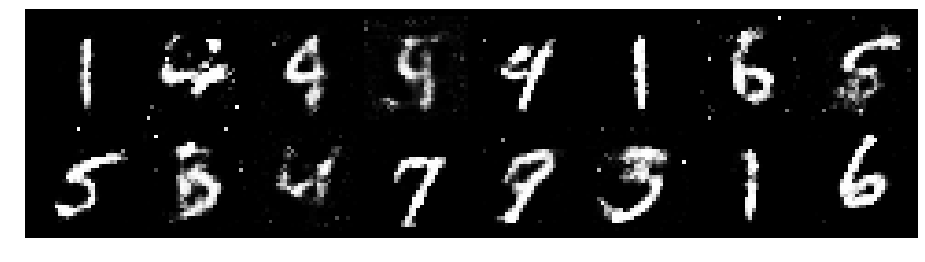

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.2604, Generator Loss: 1.1889
D(x): 0.5098, D(G(z)): 0.3469


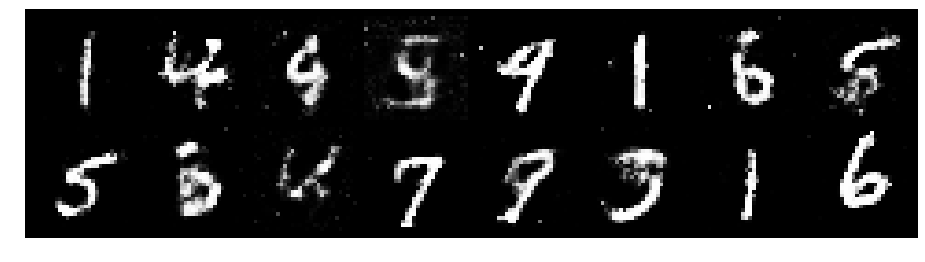

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.2488, Generator Loss: 1.3143
D(x): 0.5701, D(G(z)): 0.3792


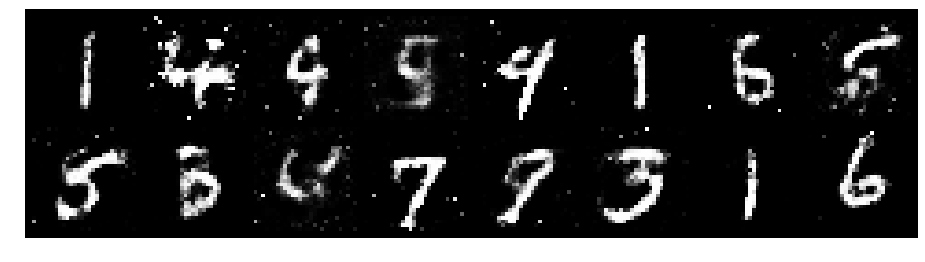

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1487, Generator Loss: 1.1060
D(x): 0.5847, D(G(z)): 0.3716


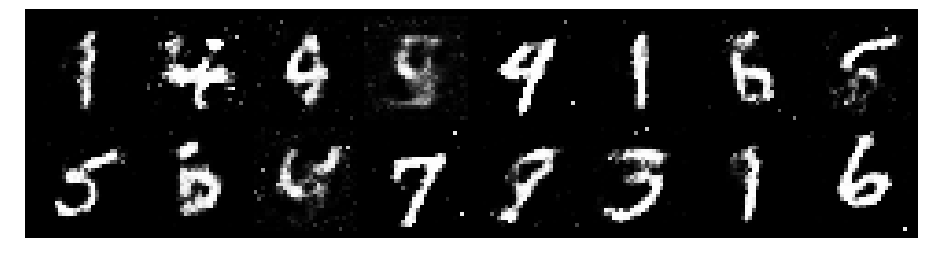

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.0899, Generator Loss: 0.8992
D(x): 0.6559, D(G(z)): 0.4206


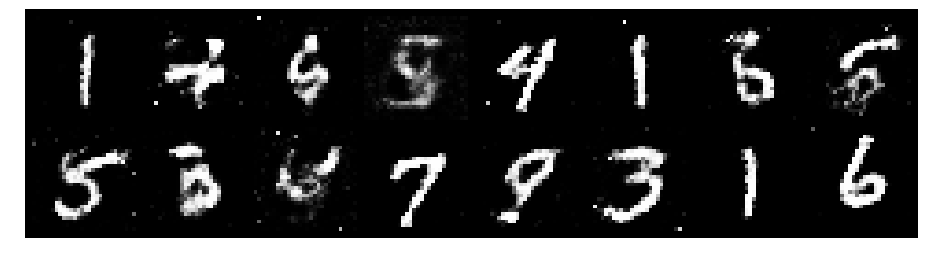

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1210, Generator Loss: 1.1056
D(x): 0.5808, D(G(z)): 0.3801


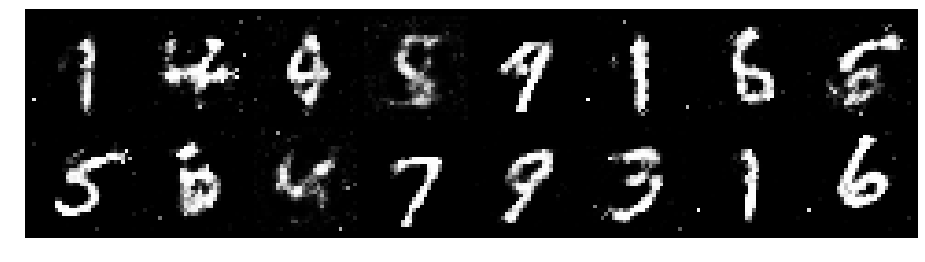

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.1228, Generator Loss: 1.0771
D(x): 0.6008, D(G(z)): 0.3901


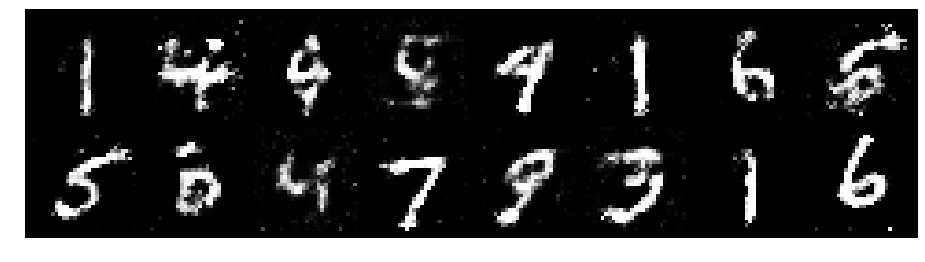

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.0640, Generator Loss: 1.0624
D(x): 0.6339, D(G(z)): 0.3932


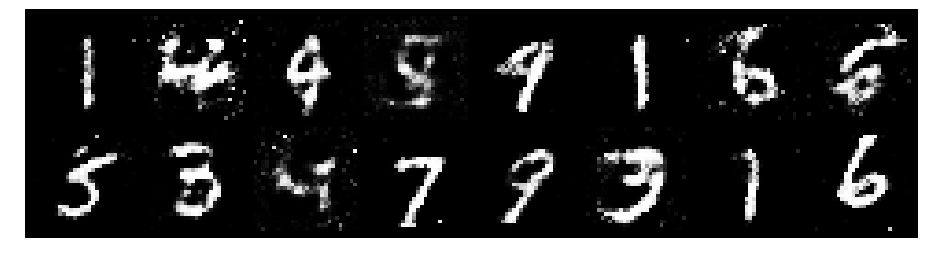

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2674, Generator Loss: 0.9131
D(x): 0.5332, D(G(z)): 0.3996


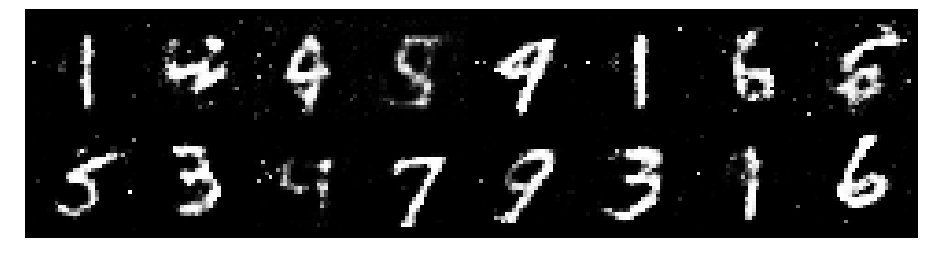

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1671, Generator Loss: 1.0362
D(x): 0.5892, D(G(z)): 0.3646


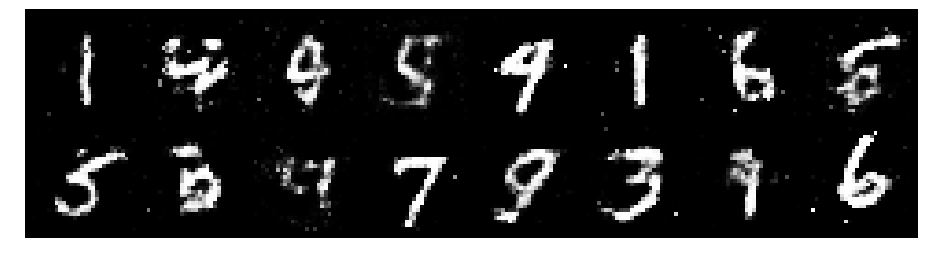

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.2073, Generator Loss: 1.0262
D(x): 0.6092, D(G(z)): 0.4371


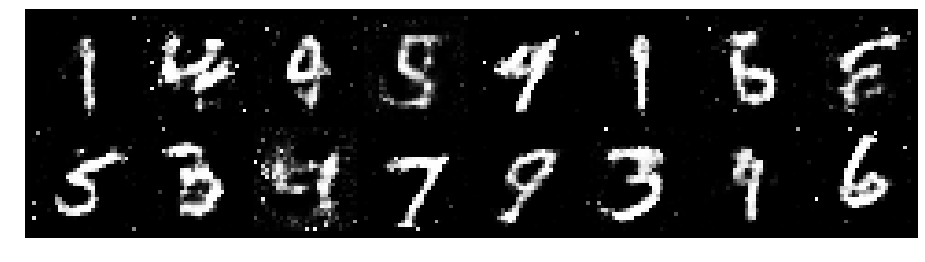

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.2846, Generator Loss: 1.0215
D(x): 0.5893, D(G(z)): 0.4580


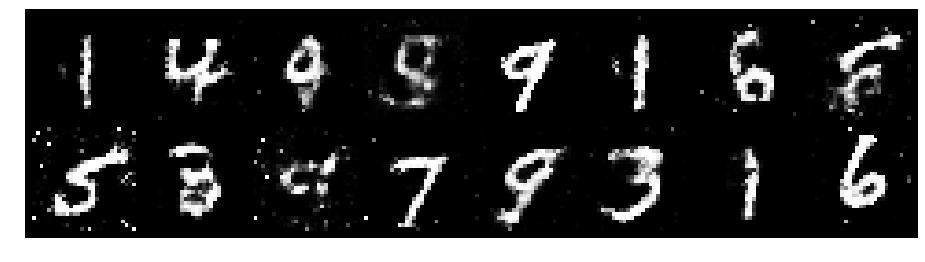

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.2170, Generator Loss: 1.1405
D(x): 0.5787, D(G(z)): 0.3996


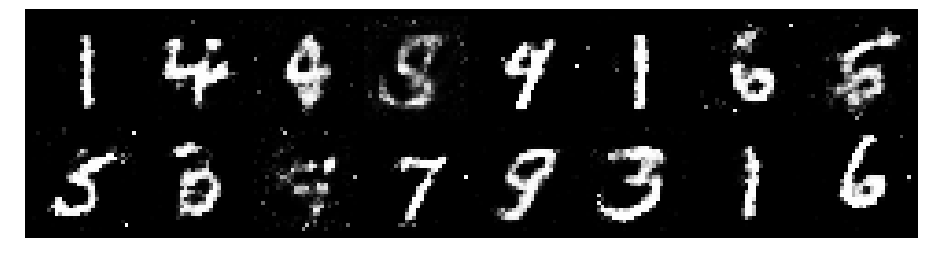

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1875, Generator Loss: 0.9337
D(x): 0.6384, D(G(z)): 0.4267


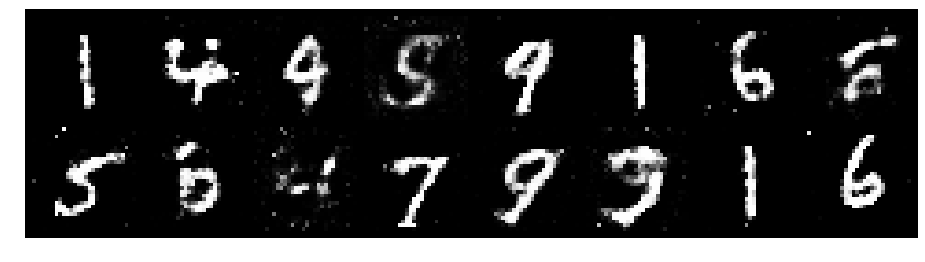

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1500, Generator Loss: 1.1134
D(x): 0.6215, D(G(z)): 0.4068


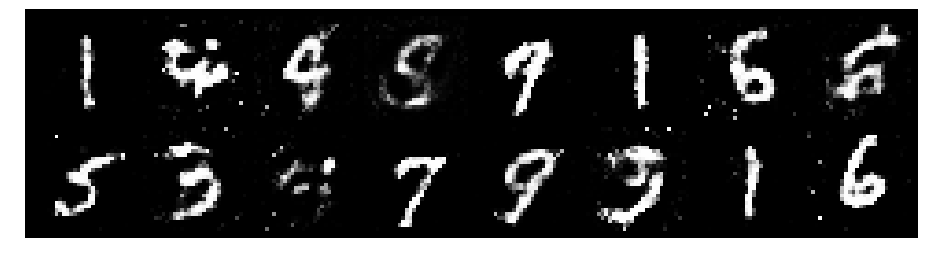

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.1549, Generator Loss: 1.0407
D(x): 0.6288, D(G(z)): 0.4321


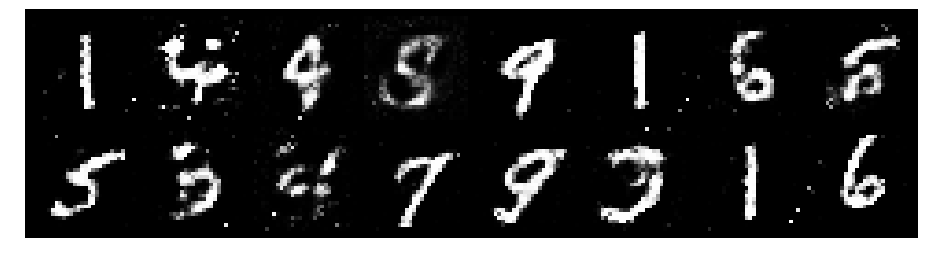

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.1262, Generator Loss: 1.0340
D(x): 0.6178, D(G(z)): 0.3899


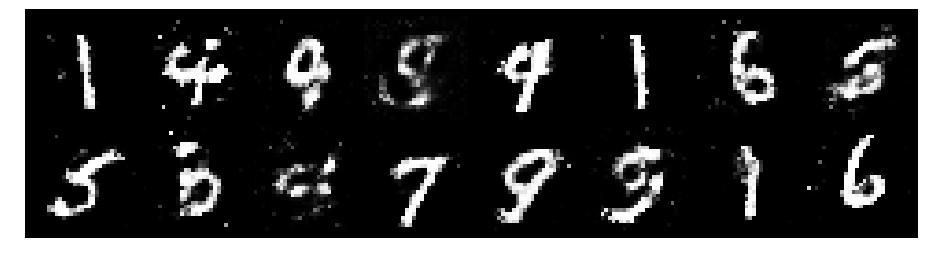

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2370, Generator Loss: 0.9115
D(x): 0.5911, D(G(z)): 0.4611


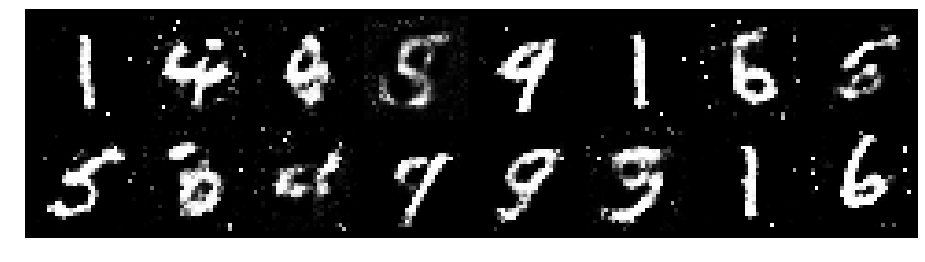

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.2304, Generator Loss: 1.0552
D(x): 0.5869, D(G(z)): 0.4461


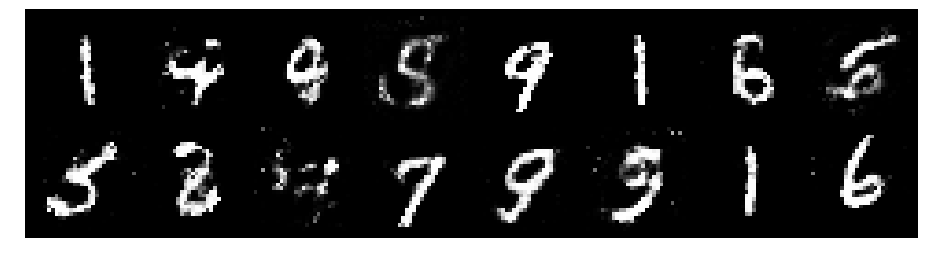

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.0540, Generator Loss: 1.1121
D(x): 0.6538, D(G(z)): 0.3945


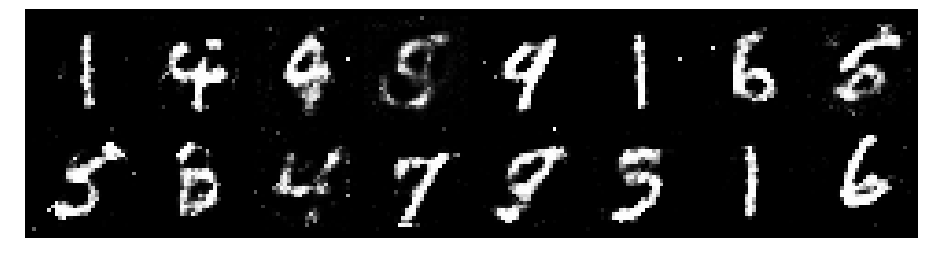

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.4150, Generator Loss: 0.8831
D(x): 0.6042, D(G(z)): 0.4965


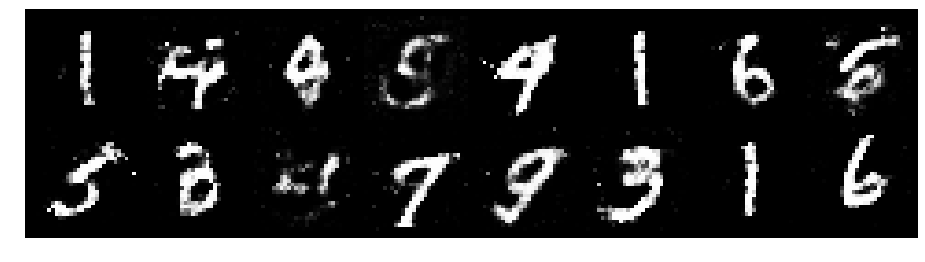

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2100, Generator Loss: 1.0299
D(x): 0.5827, D(G(z)): 0.4077


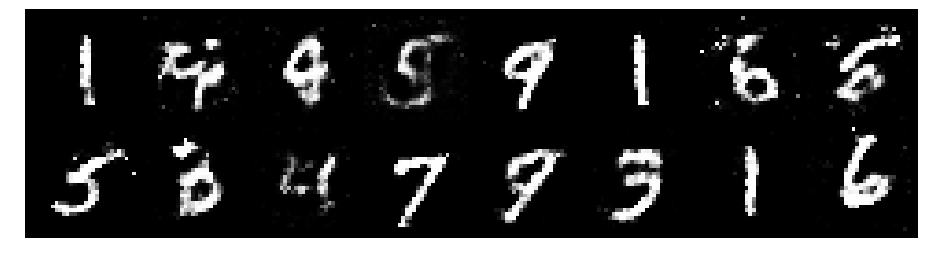

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.0125, Generator Loss: 1.1834
D(x): 0.6778, D(G(z)): 0.3735


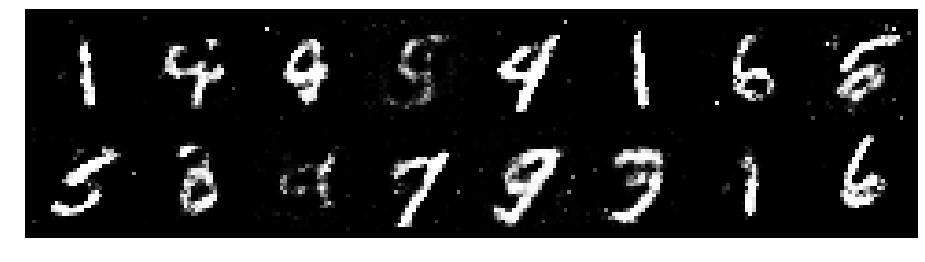

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 0.9662, Generator Loss: 1.1719
D(x): 0.6654, D(G(z)): 0.3662


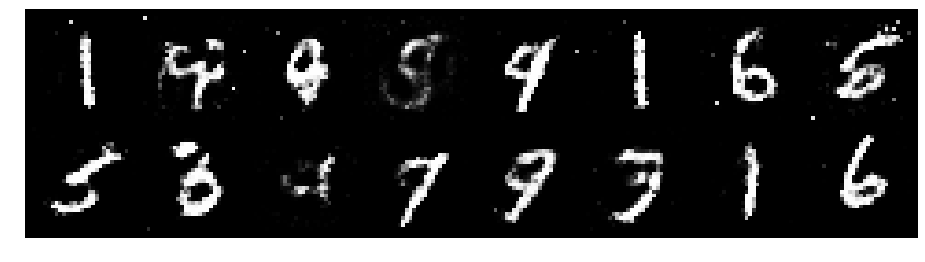

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.1659, Generator Loss: 0.9500
D(x): 0.6162, D(G(z)): 0.4270


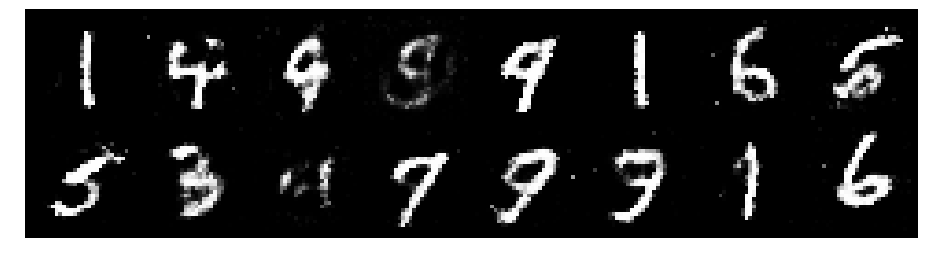

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1018, Generator Loss: 1.0726
D(x): 0.6401, D(G(z)): 0.4019


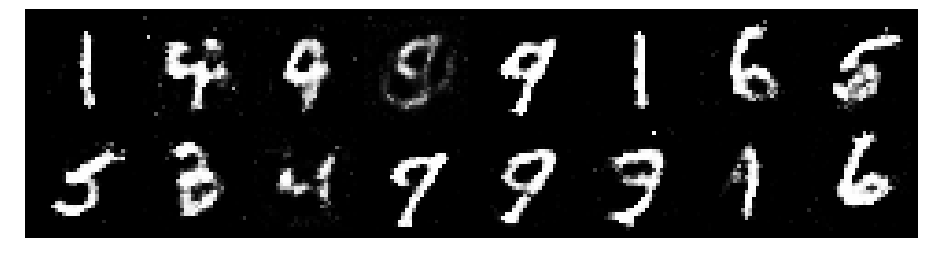

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.1268, Generator Loss: 0.8659
D(x): 0.6214, D(G(z)): 0.4416


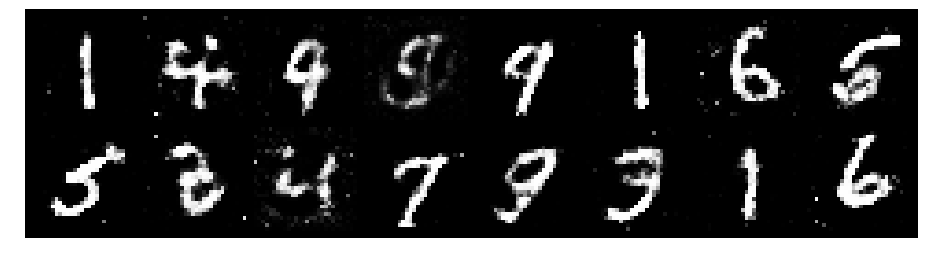

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.1992, Generator Loss: 0.9964
D(x): 0.5559, D(G(z)): 0.3948


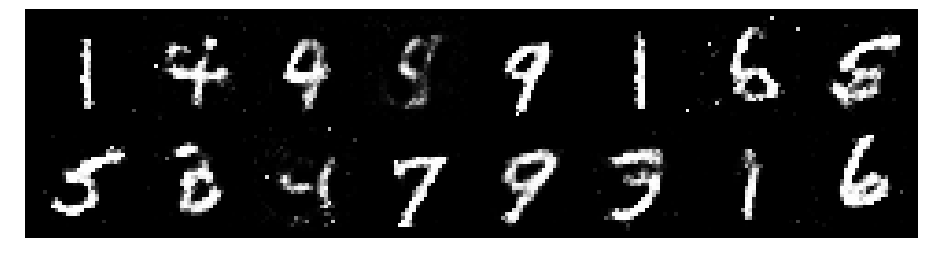

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.0360, Generator Loss: 1.1967
D(x): 0.6496, D(G(z)): 0.3723


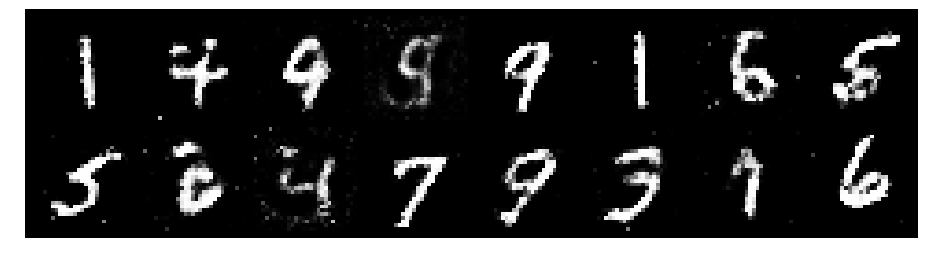

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.2284, Generator Loss: 1.0071
D(x): 0.5553, D(G(z)): 0.3968


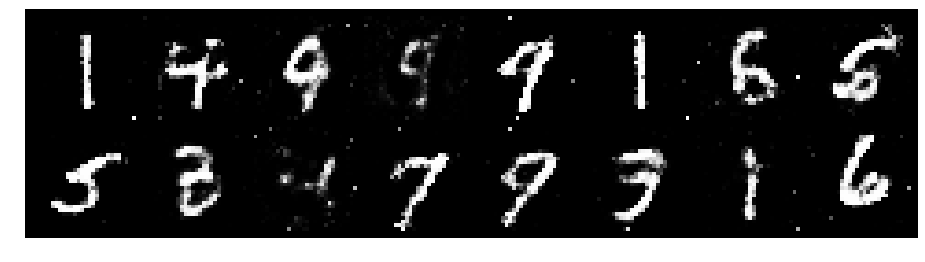

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.1578, Generator Loss: 1.0130
D(x): 0.6088, D(G(z)): 0.4155


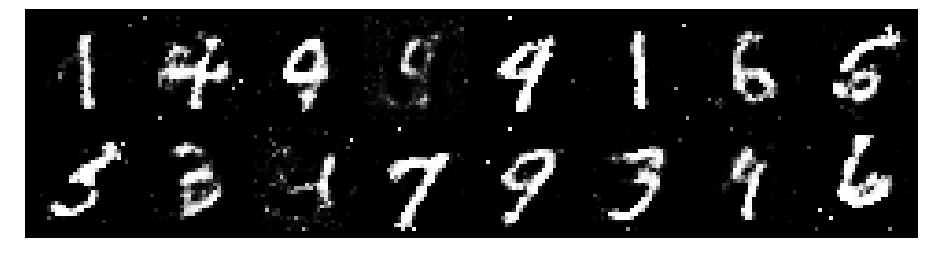

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.2534, Generator Loss: 1.0288
D(x): 0.5616, D(G(z)): 0.4161


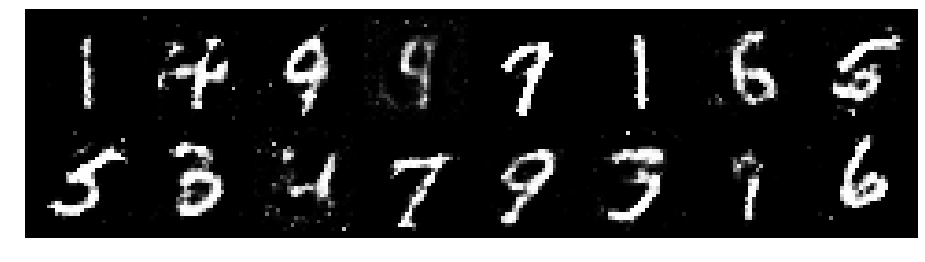

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.2727, Generator Loss: 1.0095
D(x): 0.6735, D(G(z)): 0.4903


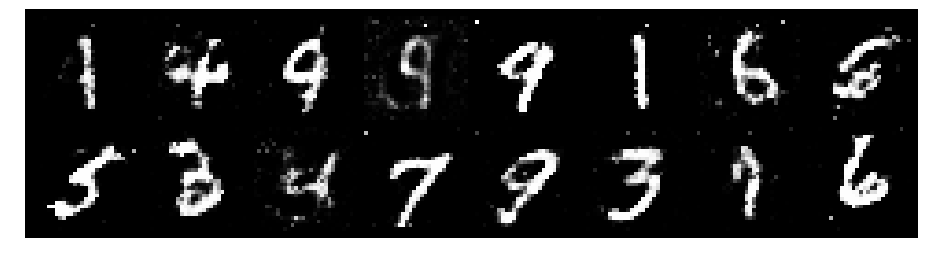

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2747, Generator Loss: 1.0999
D(x): 0.6027, D(G(z)): 0.4405


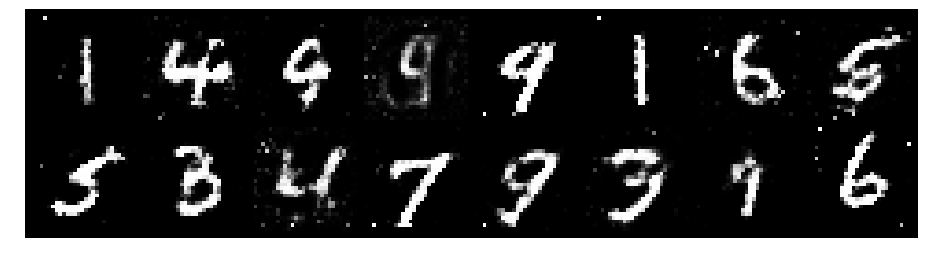

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.1351, Generator Loss: 1.0440
D(x): 0.5976, D(G(z)): 0.3931


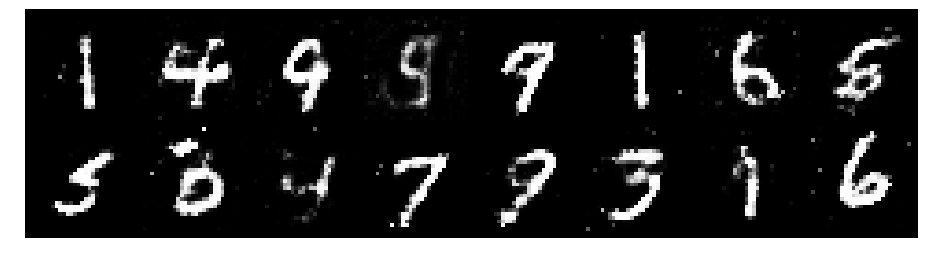

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.1299, Generator Loss: 1.1513
D(x): 0.6459, D(G(z)): 0.4050


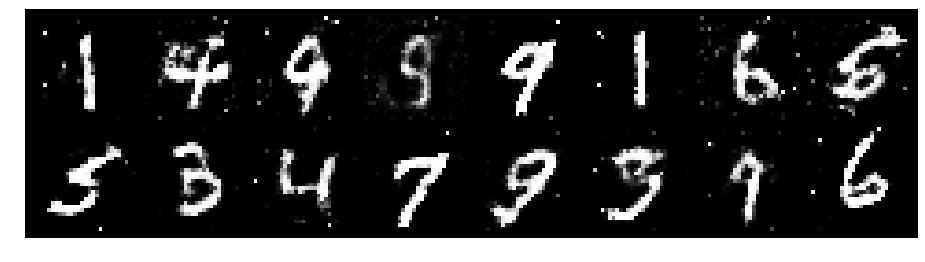

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1492, Generator Loss: 1.2171
D(x): 0.5989, D(G(z)): 0.3485


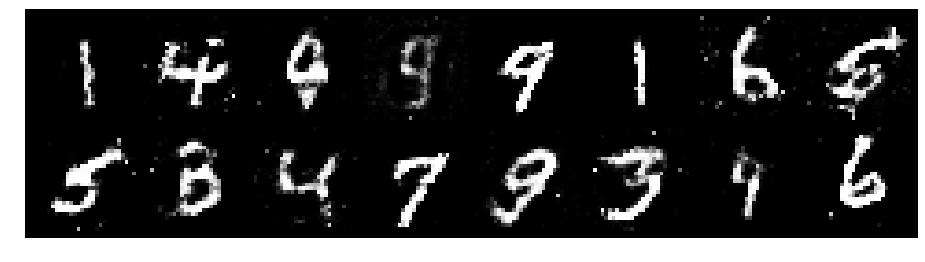

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1327, Generator Loss: 0.9672
D(x): 0.6079, D(G(z)): 0.4093


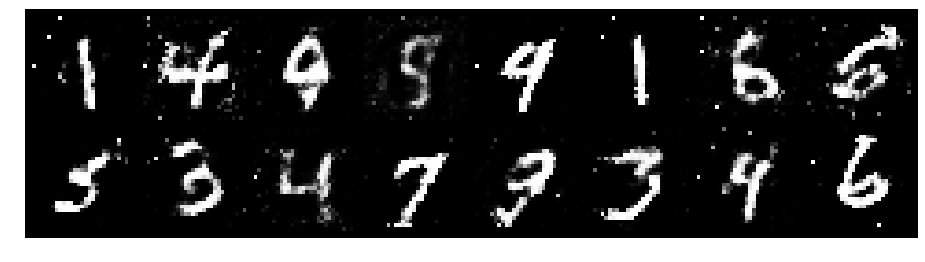

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.3497, Generator Loss: 0.8568
D(x): 0.5699, D(G(z)): 0.4751


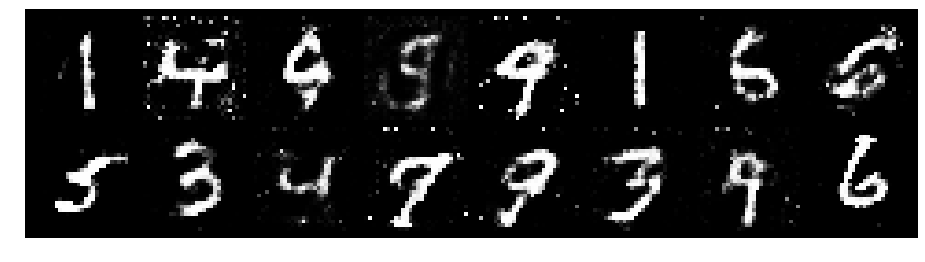

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.3559, Generator Loss: 0.9009
D(x): 0.5324, D(G(z)): 0.4343


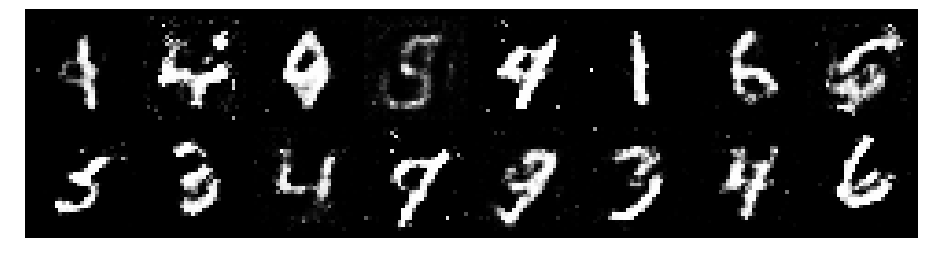

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.2550, Generator Loss: 0.9044
D(x): 0.5433, D(G(z)): 0.4124


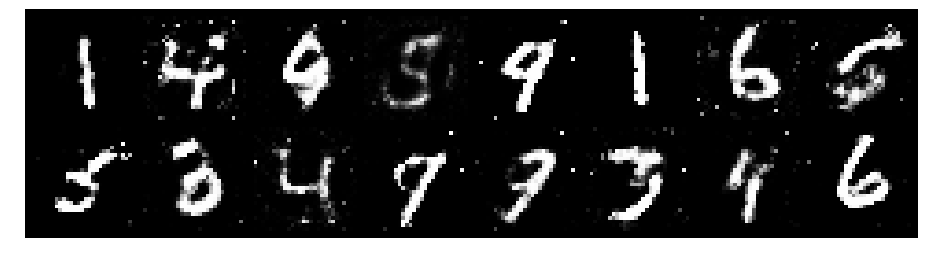

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2032, Generator Loss: 0.9730
D(x): 0.5854, D(G(z)): 0.4083


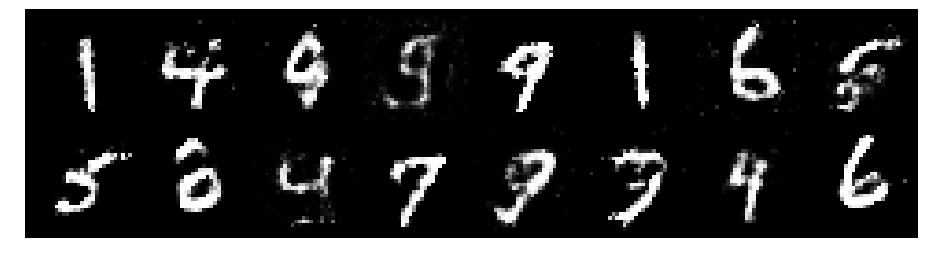

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.0756, Generator Loss: 1.0789
D(x): 0.6750, D(G(z)): 0.4028


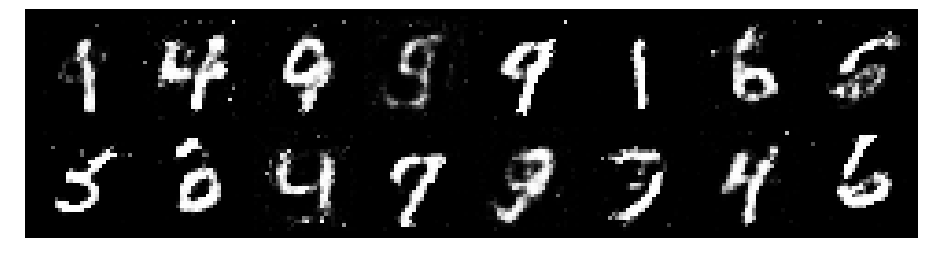

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.1644, Generator Loss: 0.9465
D(x): 0.6003, D(G(z)): 0.4113


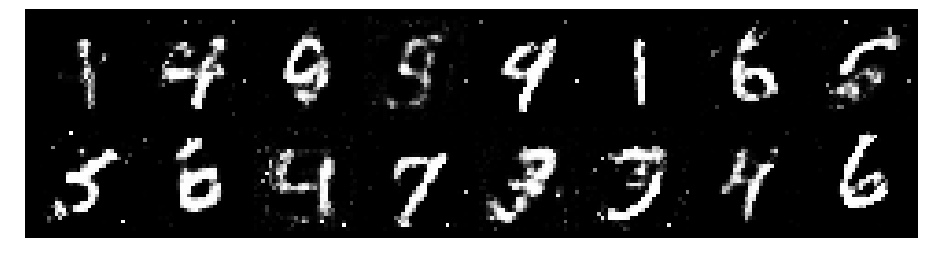

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.1243, Generator Loss: 0.9237
D(x): 0.5982, D(G(z)): 0.3987


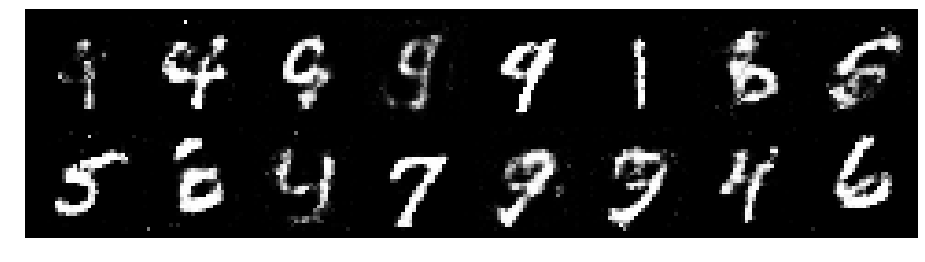

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.3299, Generator Loss: 1.0253
D(x): 0.5472, D(G(z)): 0.4356


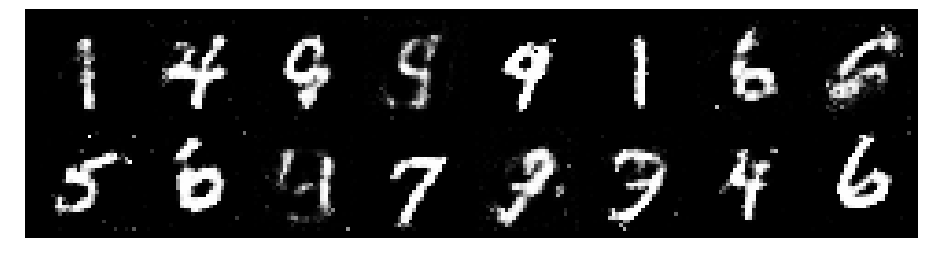

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.4376, Generator Loss: 1.0040
D(x): 0.5228, D(G(z)): 0.3961


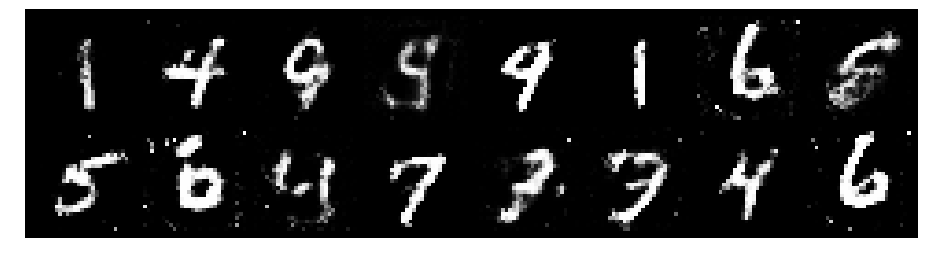

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.3013, Generator Loss: 0.9392
D(x): 0.5726, D(G(z)): 0.4556


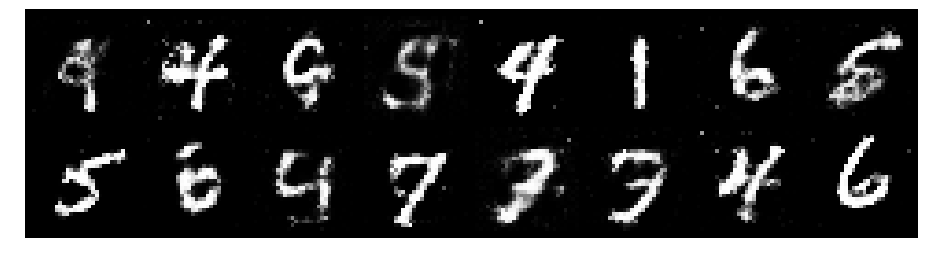

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.3398, Generator Loss: 0.8472
D(x): 0.5767, D(G(z)): 0.4757


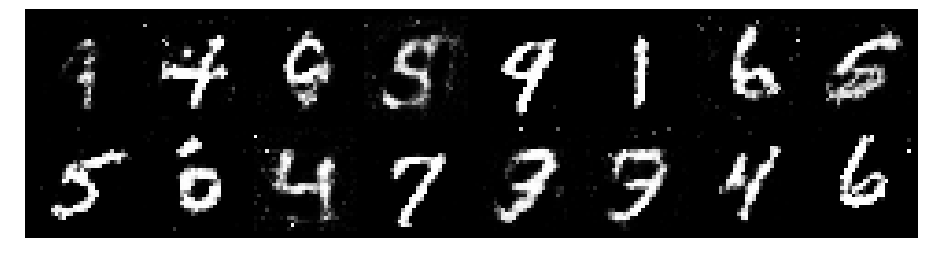

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.2724, Generator Loss: 1.2594
D(x): 0.6052, D(G(z)): 0.4249


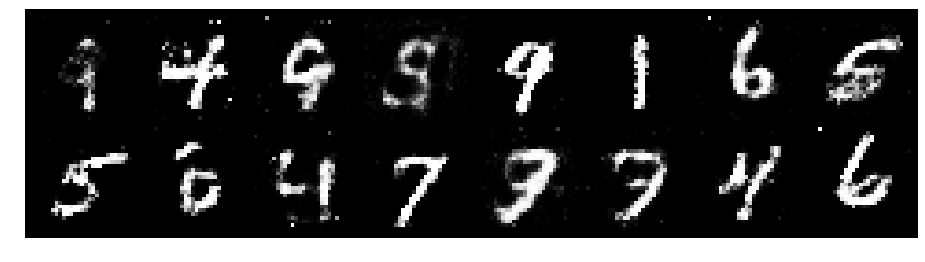

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.1046, Generator Loss: 1.2492
D(x): 0.6016, D(G(z)): 0.3789


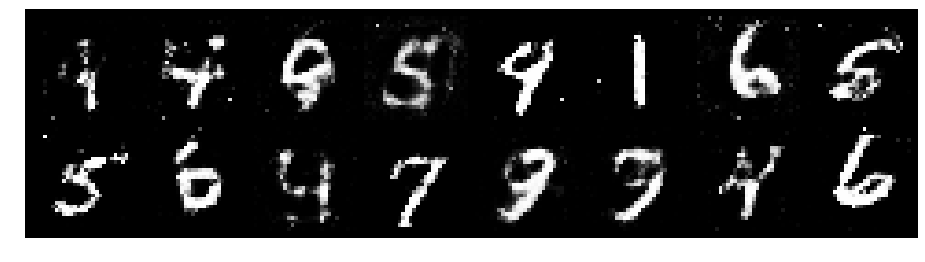

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.1444, Generator Loss: 1.1053
D(x): 0.5794, D(G(z)): 0.3898


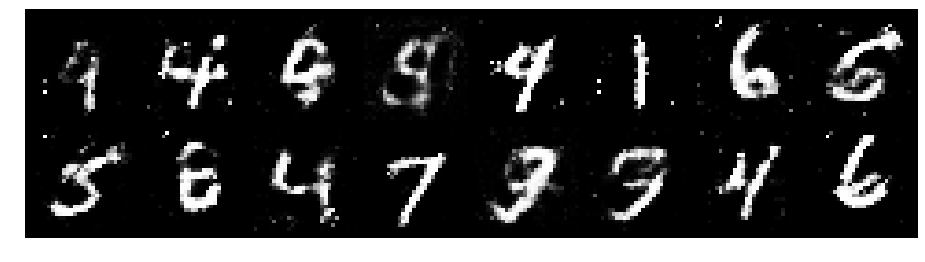

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.1803, Generator Loss: 0.9040
D(x): 0.5570, D(G(z)): 0.3858


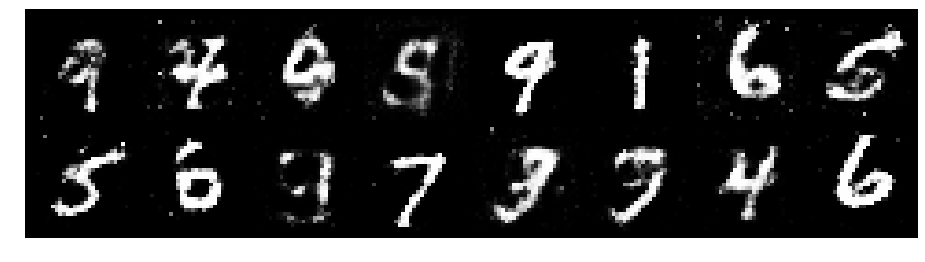

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.1401, Generator Loss: 0.9881
D(x): 0.6235, D(G(z)): 0.4155


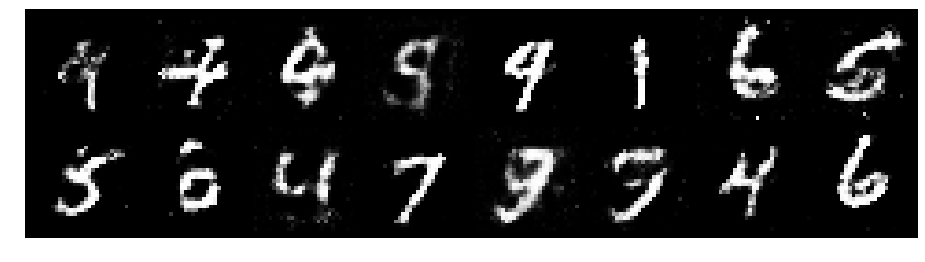

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.3166, Generator Loss: 1.1012
D(x): 0.5247, D(G(z)): 0.4204


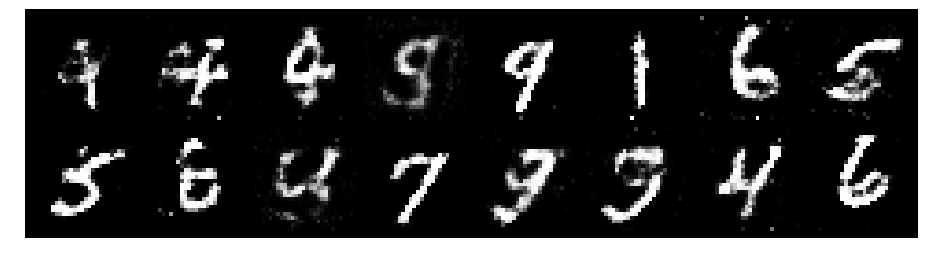

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.1614, Generator Loss: 0.9070
D(x): 0.6043, D(G(z)): 0.4341


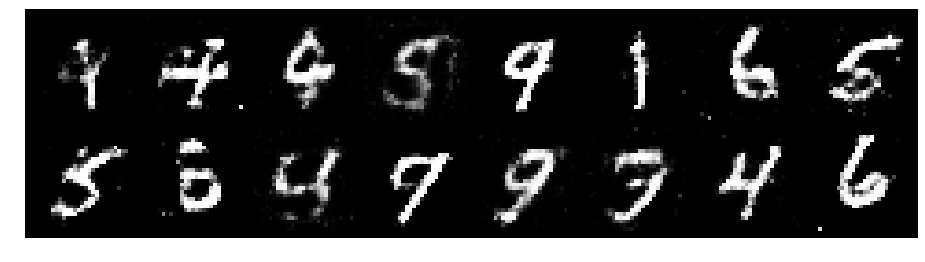

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2206, Generator Loss: 0.9182
D(x): 0.6144, D(G(z)): 0.4655


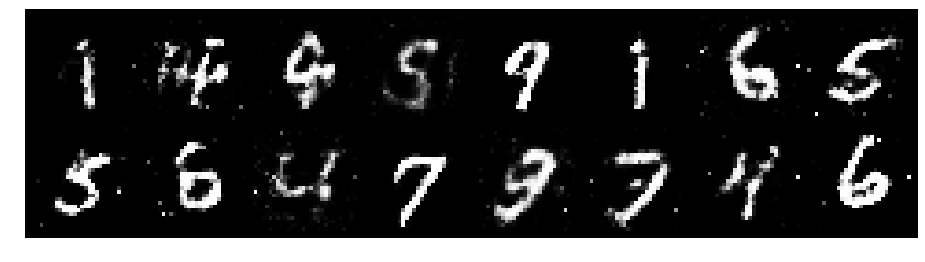

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.0823, Generator Loss: 1.2569
D(x): 0.6192, D(G(z)): 0.3727


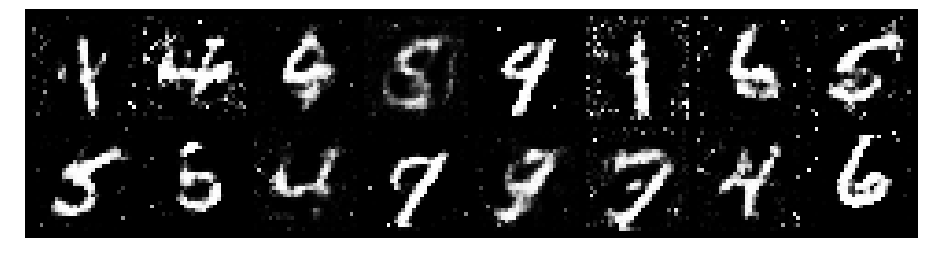

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.1994, Generator Loss: 1.0123
D(x): 0.5497, D(G(z)): 0.3964


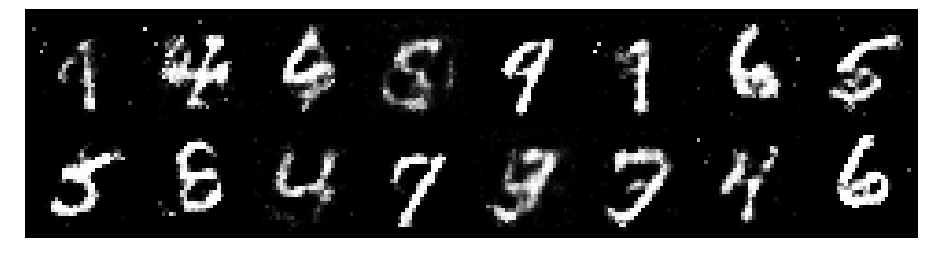

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.1265, Generator Loss: 0.8950
D(x): 0.6195, D(G(z)): 0.4310


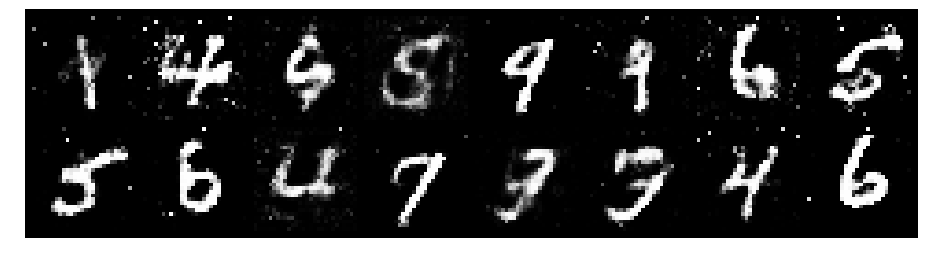

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.3224, Generator Loss: 0.9612
D(x): 0.5288, D(G(z)): 0.4096


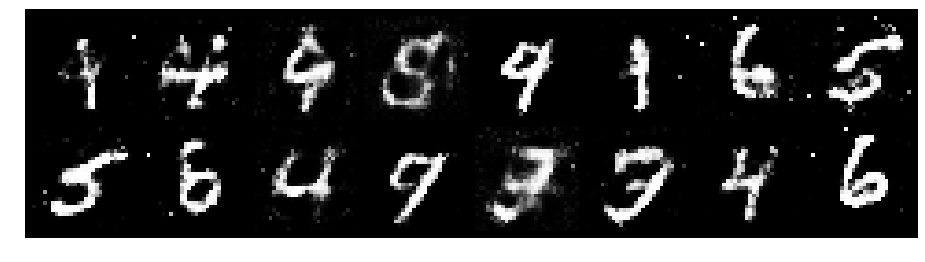

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.3409, Generator Loss: 1.0184
D(x): 0.5350, D(G(z)): 0.4334


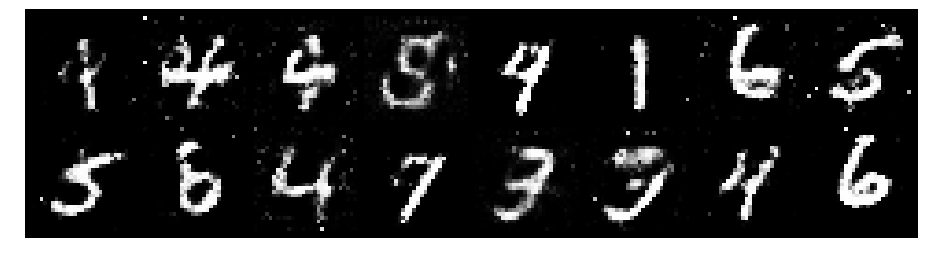

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1455, Generator Loss: 1.2671
D(x): 0.5880, D(G(z)): 0.3742


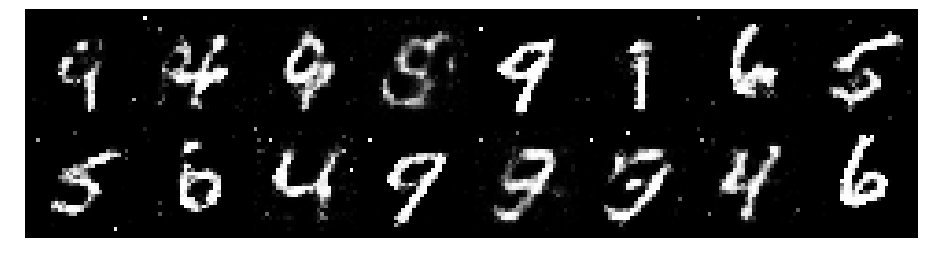

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.1655, Generator Loss: 0.9058
D(x): 0.6124, D(G(z)): 0.4377


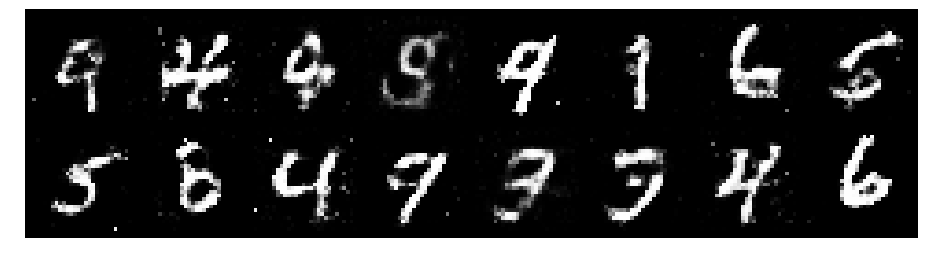

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2253, Generator Loss: 0.9561
D(x): 0.5340, D(G(z)): 0.3985


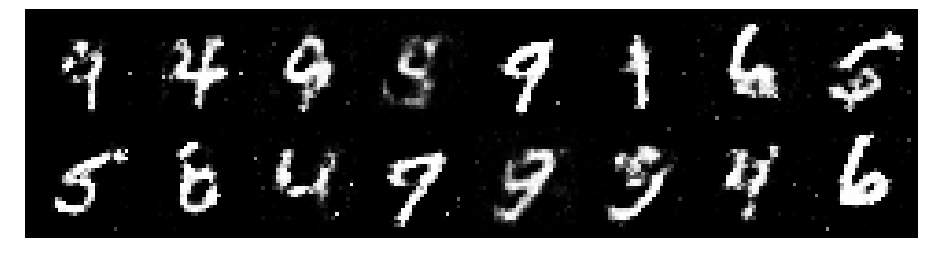

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.2193, Generator Loss: 0.8272
D(x): 0.5934, D(G(z)): 0.4399


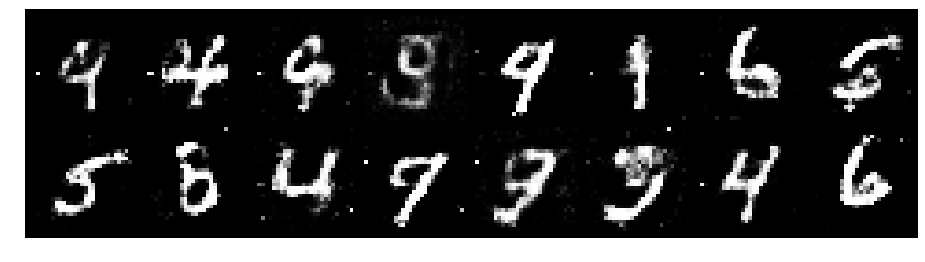

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.3853, Generator Loss: 0.8771
D(x): 0.5358, D(G(z)): 0.4643


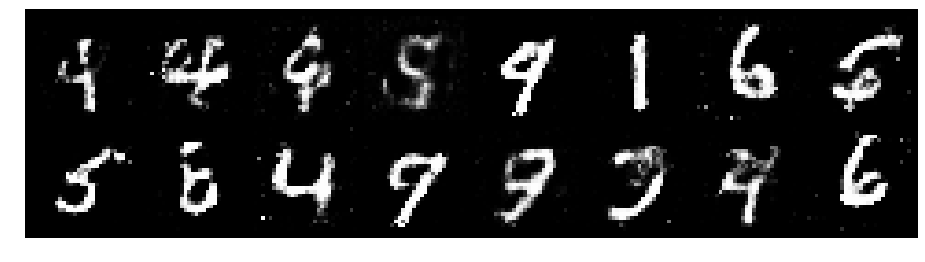

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.1847, Generator Loss: 0.9974
D(x): 0.6361, D(G(z)): 0.4465


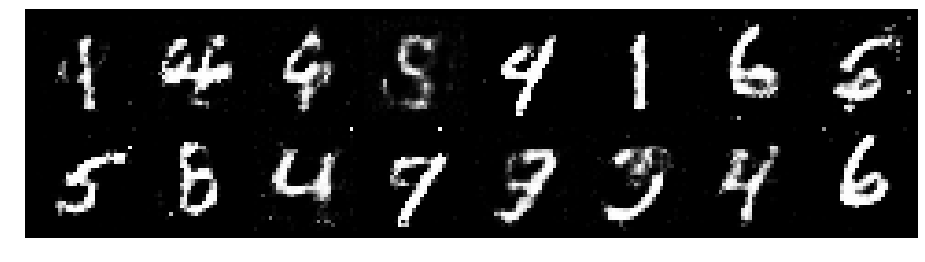

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1982, Generator Loss: 0.9919
D(x): 0.6157, D(G(z)): 0.4277


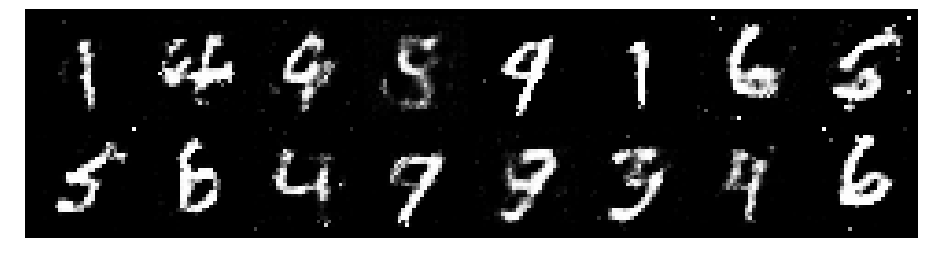

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1499, Generator Loss: 1.0804
D(x): 0.6338, D(G(z)): 0.4306


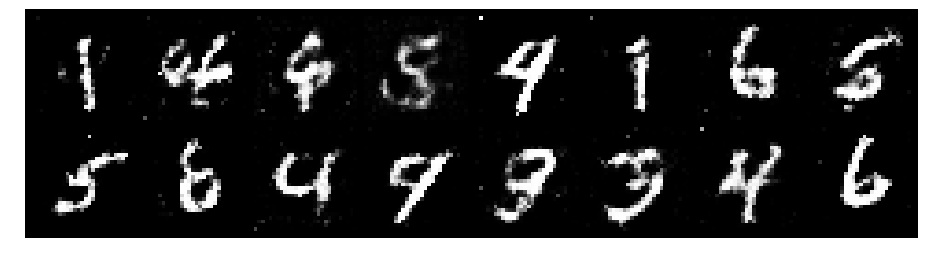

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.2589, Generator Loss: 1.0558
D(x): 0.5563, D(G(z)): 0.4231


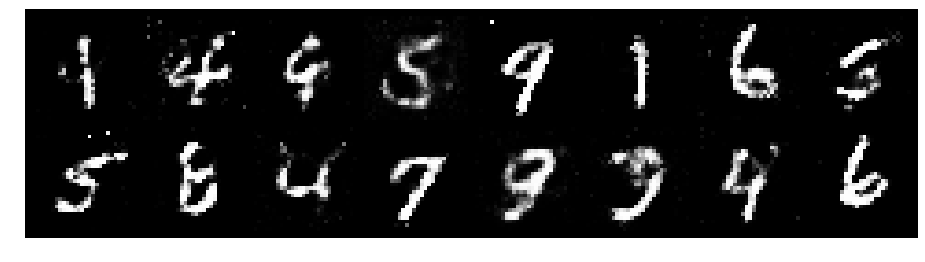

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.2375, Generator Loss: 1.0095
D(x): 0.5507, D(G(z)): 0.4114


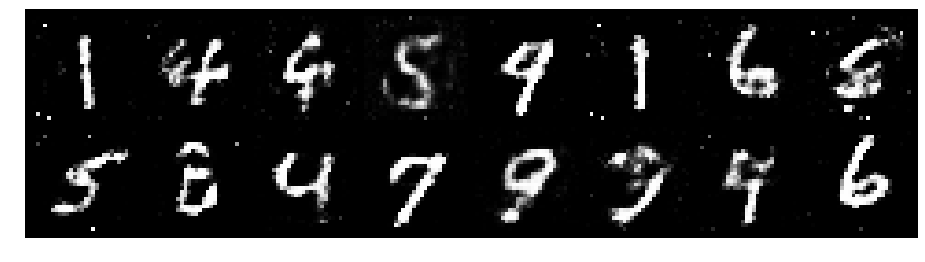

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.3479, Generator Loss: 0.9760
D(x): 0.6266, D(G(z)): 0.4751


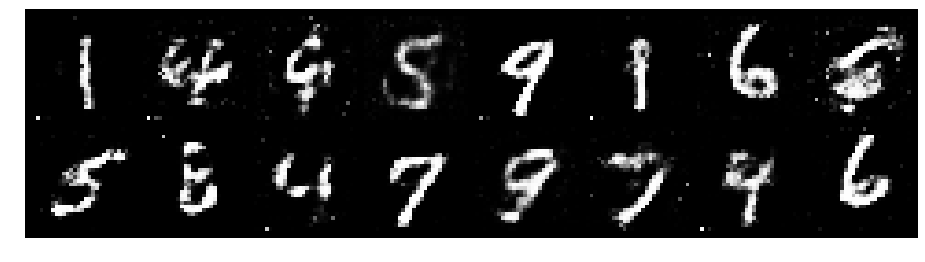

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.3229, Generator Loss: 0.9081
D(x): 0.5755, D(G(z)): 0.4400


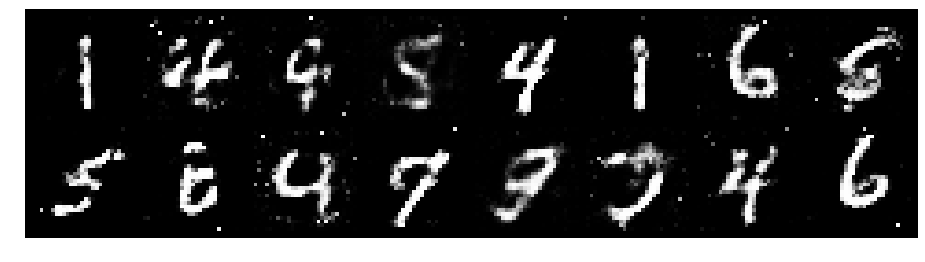

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2263, Generator Loss: 0.9932
D(x): 0.5828, D(G(z)): 0.4336


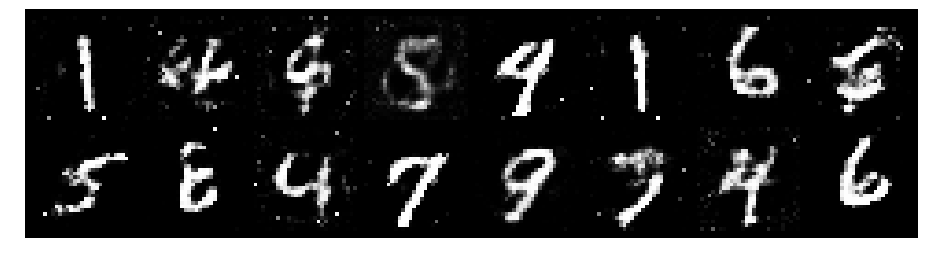

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.2358, Generator Loss: 1.1286
D(x): 0.5511, D(G(z)): 0.3546


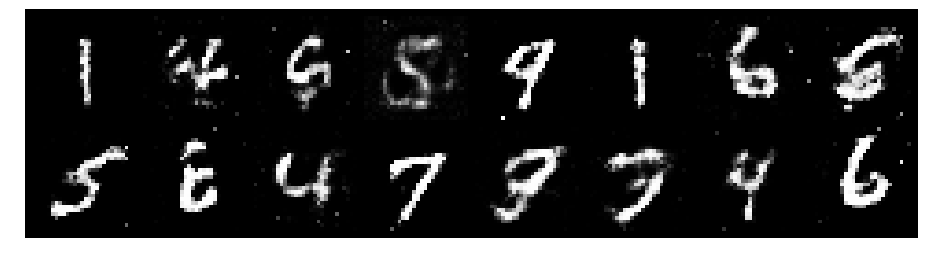

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.1443, Generator Loss: 1.0584
D(x): 0.6185, D(G(z)): 0.3770


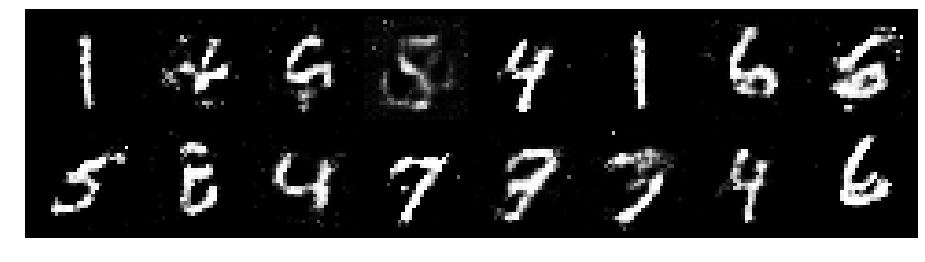

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2191, Generator Loss: 0.9089
D(x): 0.5524, D(G(z)): 0.4110


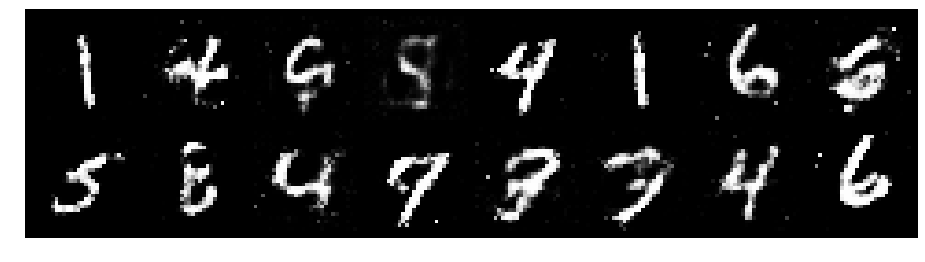

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.3136, Generator Loss: 0.8976
D(x): 0.5953, D(G(z)): 0.4803


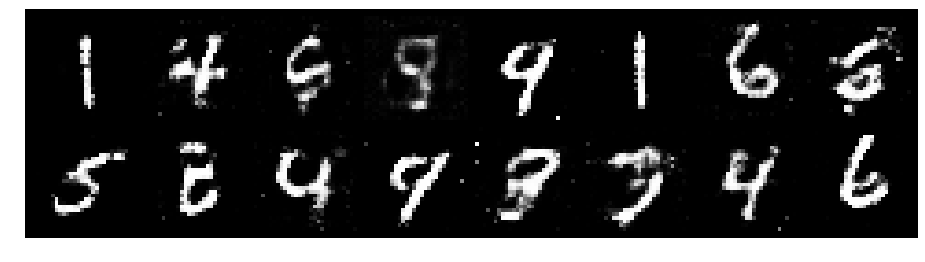

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.2735, Generator Loss: 0.9710
D(x): 0.6172, D(G(z)): 0.4669


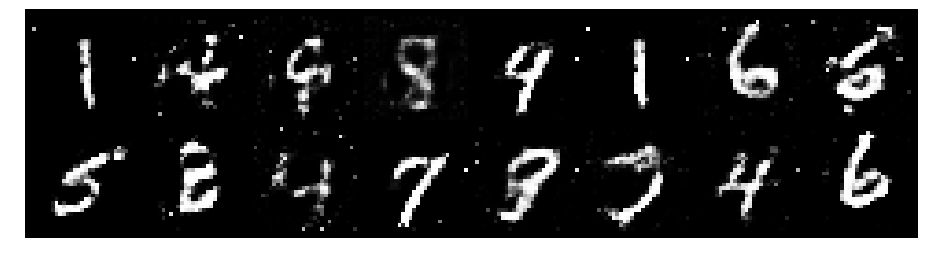

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.1753, Generator Loss: 1.0347
D(x): 0.5824, D(G(z)): 0.4086


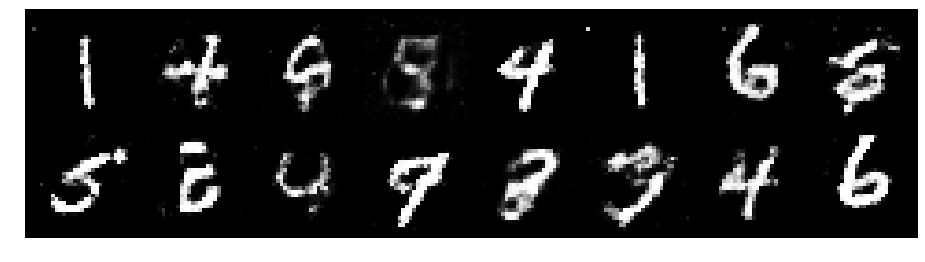

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.1529, Generator Loss: 0.9870
D(x): 0.5900, D(G(z)): 0.3788


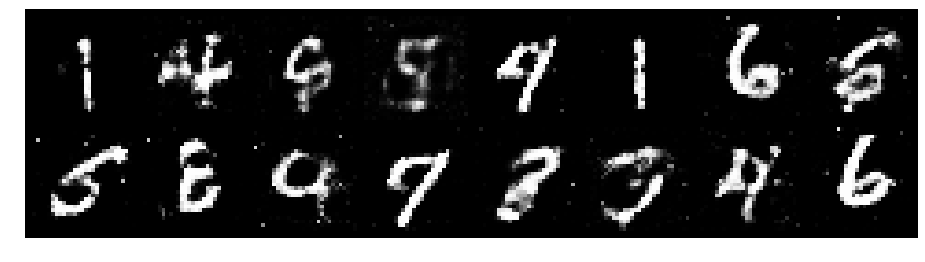

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.1798, Generator Loss: 0.9897
D(x): 0.5835, D(G(z)): 0.4152


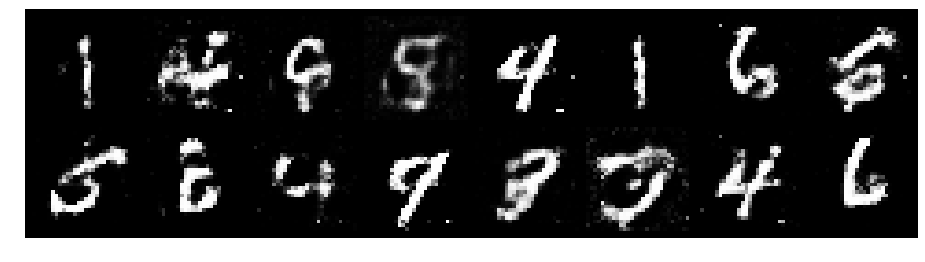

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.1775, Generator Loss: 0.9287
D(x): 0.5713, D(G(z)): 0.4111


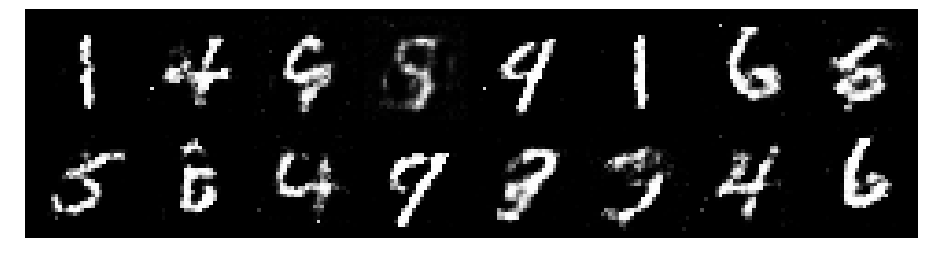

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.2856, Generator Loss: 0.8483
D(x): 0.5740, D(G(z)): 0.4461


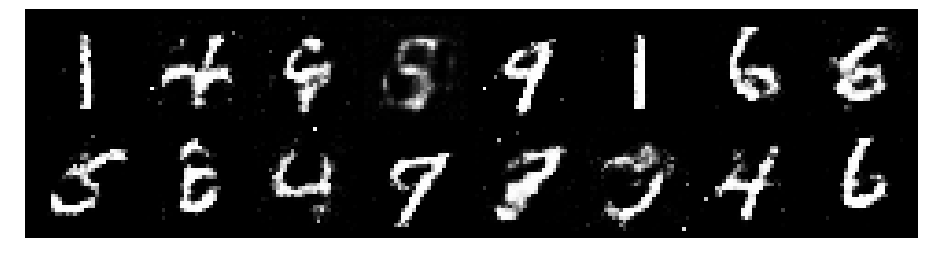

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.1706, Generator Loss: 0.9620
D(x): 0.6343, D(G(z)): 0.4283


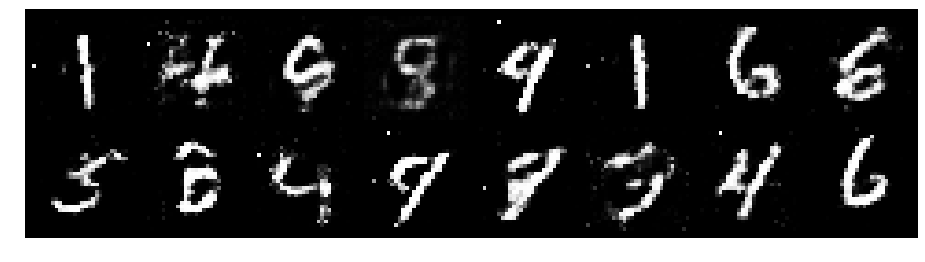

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1477, Generator Loss: 1.1948
D(x): 0.5806, D(G(z)): 0.3738


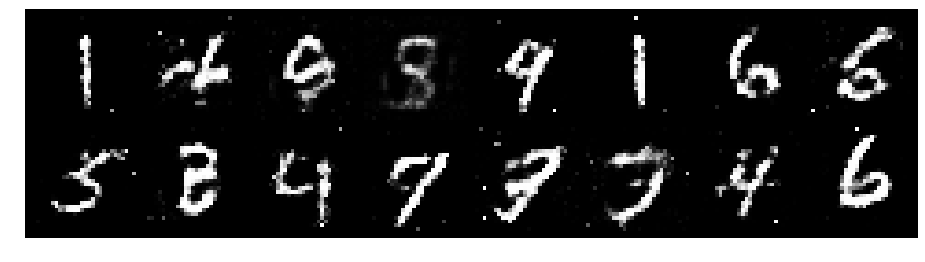

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.1448, Generator Loss: 0.8924
D(x): 0.6070, D(G(z)): 0.4394


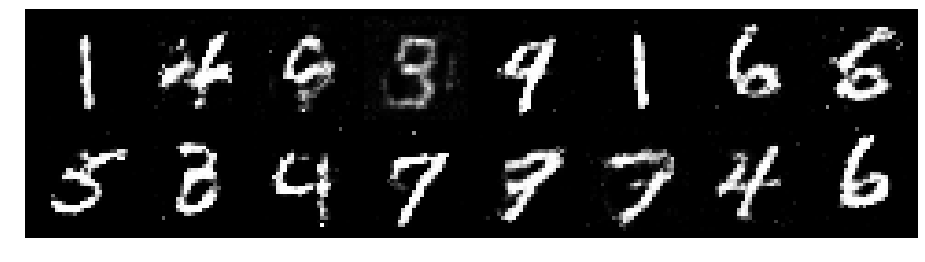

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.2640, Generator Loss: 0.7383
D(x): 0.5939, D(G(z)): 0.4888


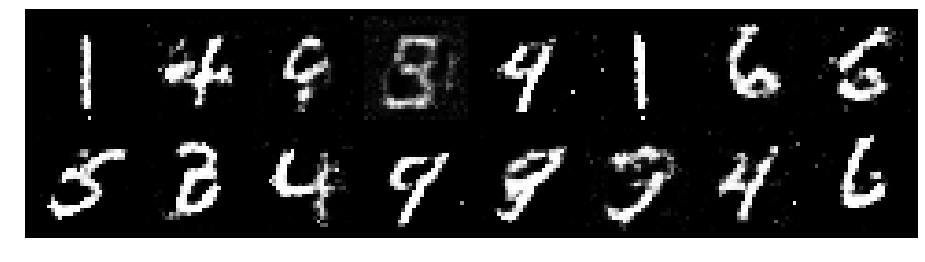

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.4133, Generator Loss: 0.8074
D(x): 0.5936, D(G(z)): 0.5015


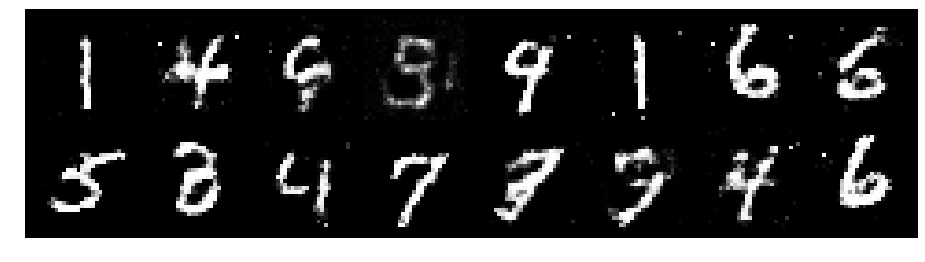

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.2111, Generator Loss: 1.1079
D(x): 0.5963, D(G(z)): 0.4095


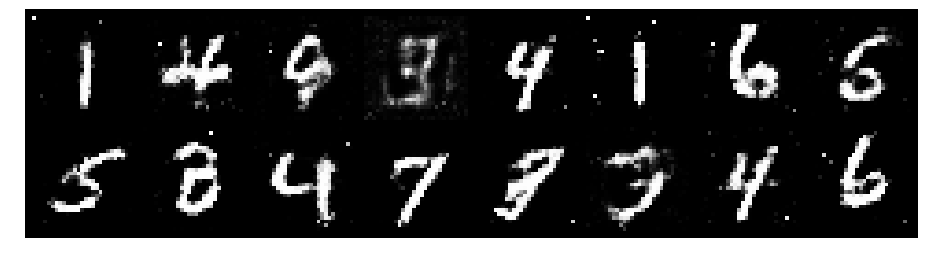

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.1773, Generator Loss: 0.9544
D(x): 0.5882, D(G(z)): 0.4187


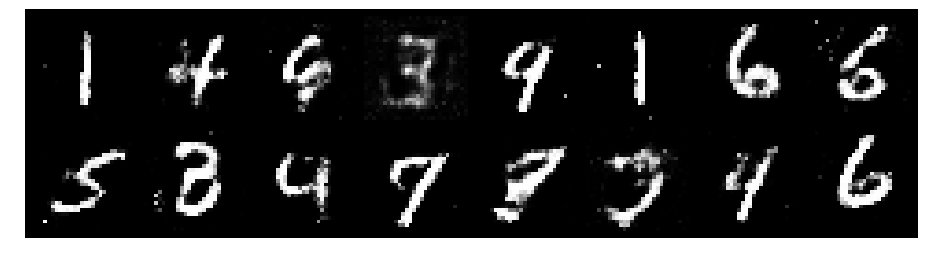

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.2514, Generator Loss: 1.0112
D(x): 0.5472, D(G(z)): 0.4008


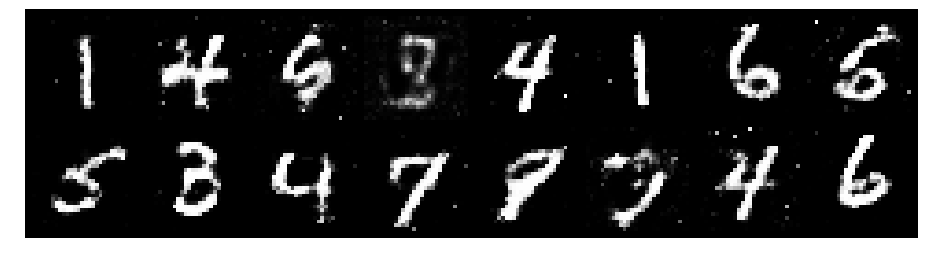

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.1588, Generator Loss: 0.9647
D(x): 0.6171, D(G(z)): 0.4195


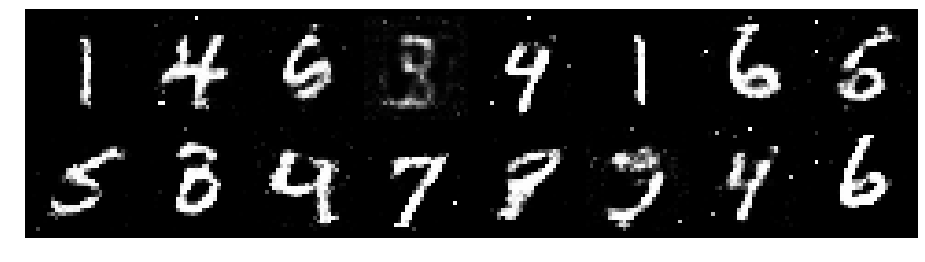

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.1513, Generator Loss: 0.9391
D(x): 0.5609, D(G(z)): 0.3788


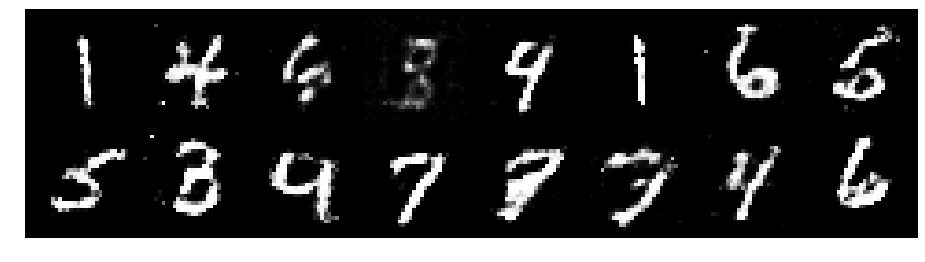

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2829, Generator Loss: 1.0288
D(x): 0.6347, D(G(z)): 0.4805


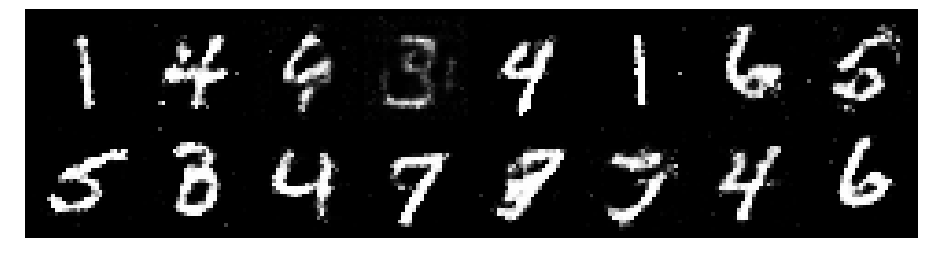

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.2030, Generator Loss: 0.9096
D(x): 0.5876, D(G(z)): 0.4334


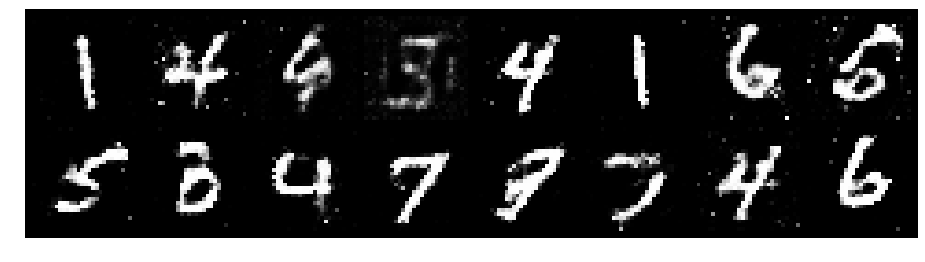

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.1942, Generator Loss: 1.1604
D(x): 0.6135, D(G(z)): 0.4143


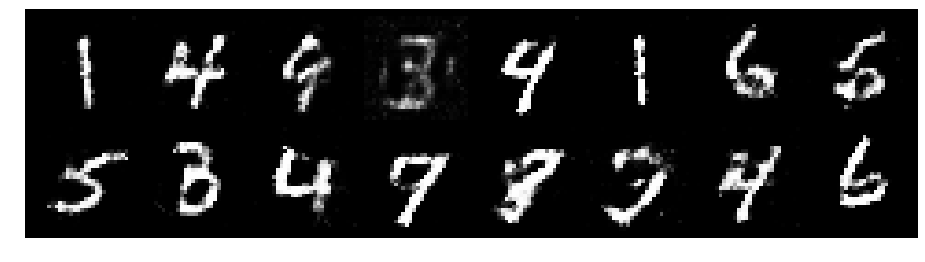

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1165, Generator Loss: 1.0673
D(x): 0.5662, D(G(z)): 0.3679


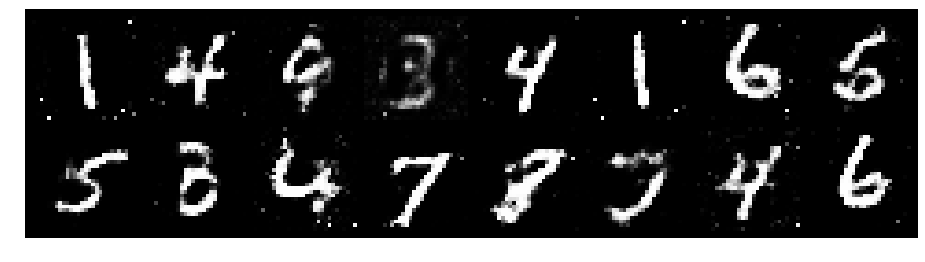

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2380, Generator Loss: 0.9348
D(x): 0.5696, D(G(z)): 0.4252


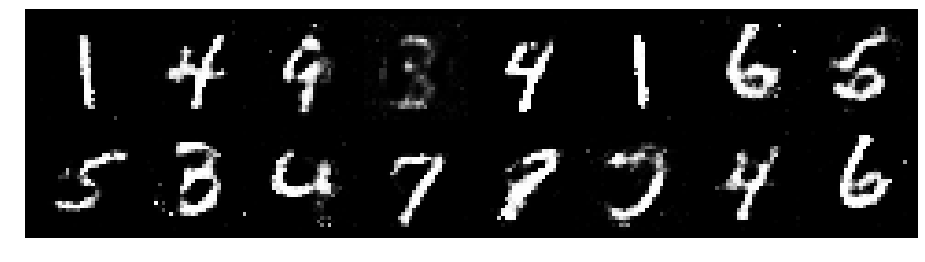

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2074, Generator Loss: 0.9851
D(x): 0.5735, D(G(z)): 0.4379


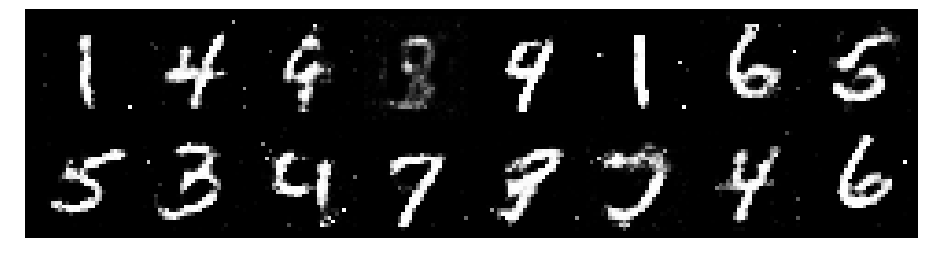

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1236, Generator Loss: 0.9266
D(x): 0.6694, D(G(z)): 0.4670


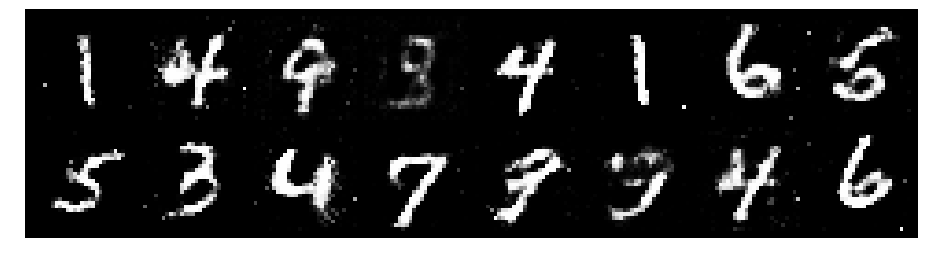

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.2822, Generator Loss: 0.8255
D(x): 0.5354, D(G(z)): 0.4408


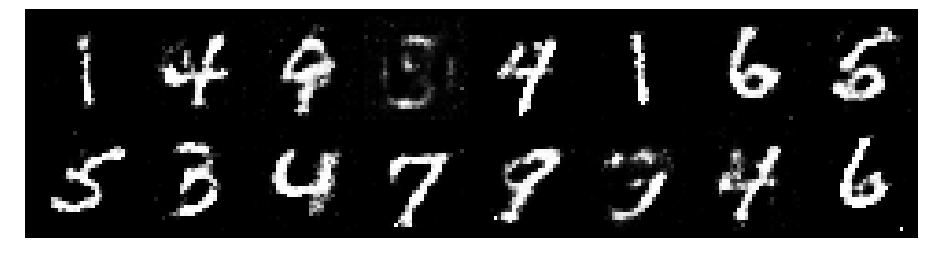

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.3709, Generator Loss: 0.9088
D(x): 0.5626, D(G(z)): 0.4433


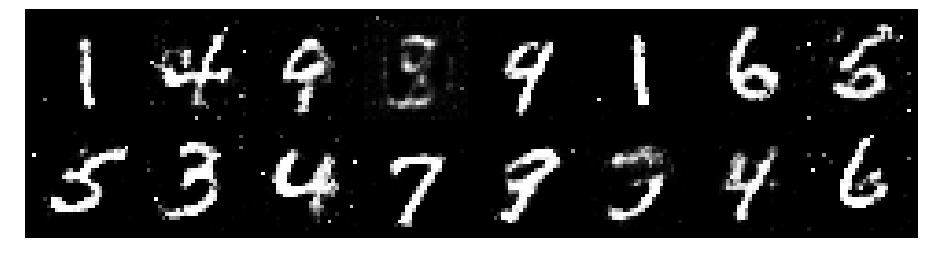

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 0.9750, Generator Loss: 1.1633
D(x): 0.6567, D(G(z)): 0.3527


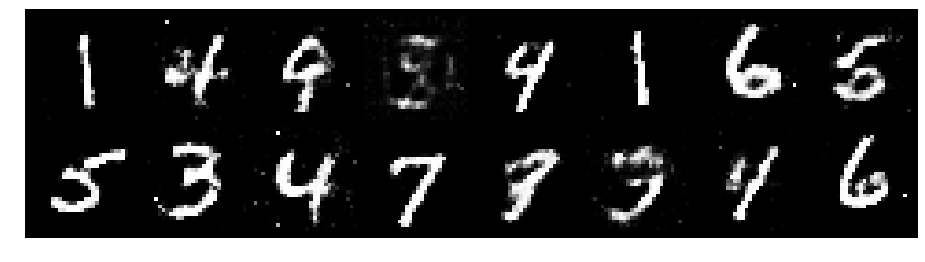

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.1421, Generator Loss: 0.9565
D(x): 0.6608, D(G(z)): 0.4270


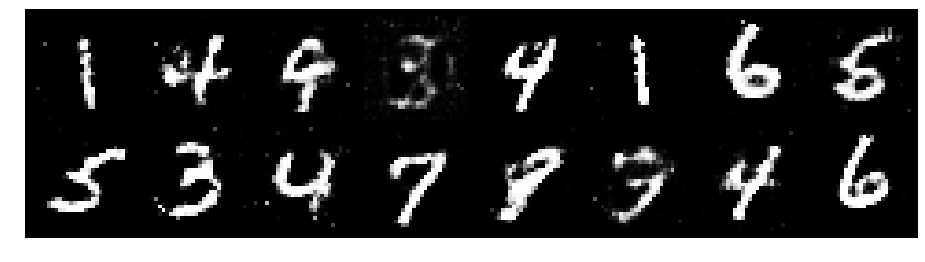

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.1767, Generator Loss: 1.0124
D(x): 0.6258, D(G(z)): 0.4275


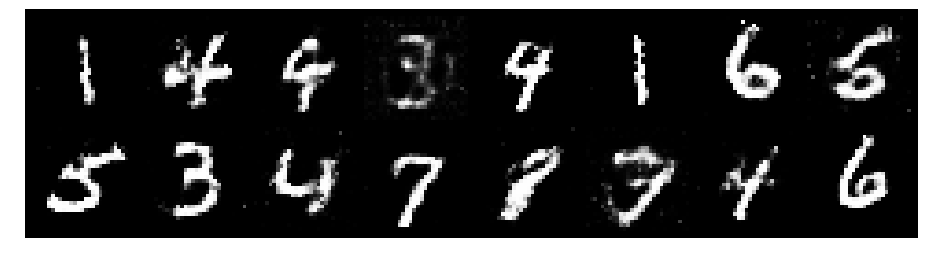

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.2158, Generator Loss: 0.9773
D(x): 0.6140, D(G(z)): 0.4470


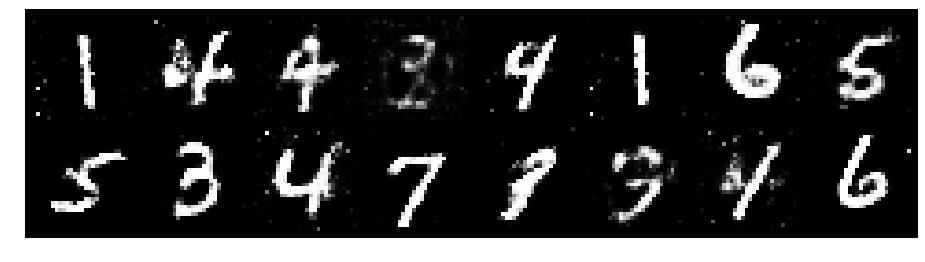

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.1304, Generator Loss: 1.1532
D(x): 0.6556, D(G(z)): 0.4233


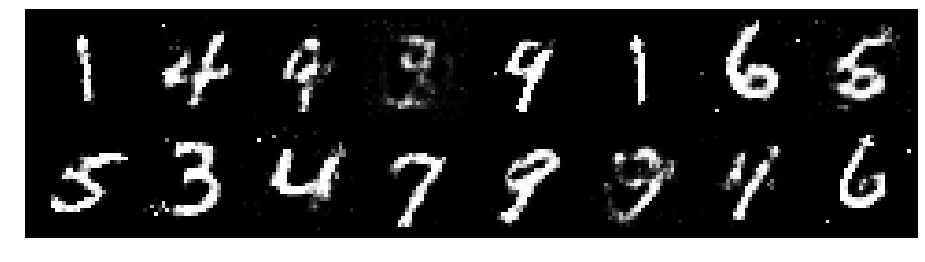

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1256, Generator Loss: 1.1176
D(x): 0.5699, D(G(z)): 0.3632


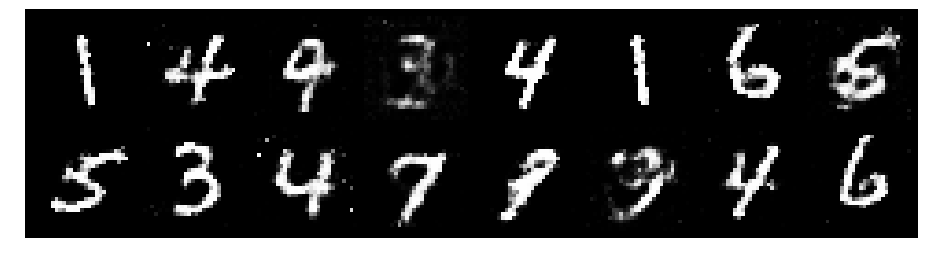

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2595, Generator Loss: 0.8392
D(x): 0.6154, D(G(z)): 0.4923


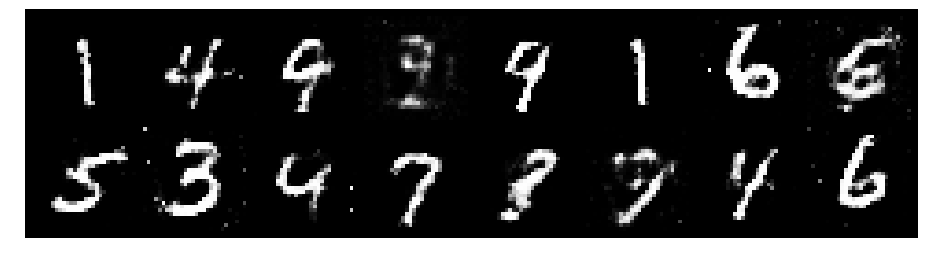

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.1038, Generator Loss: 0.9381
D(x): 0.6002, D(G(z)): 0.3968


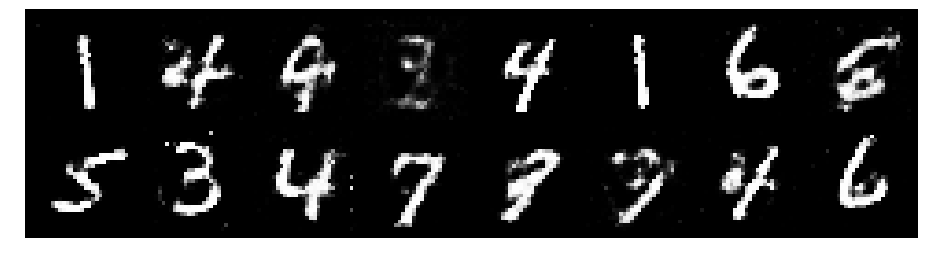

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.2273, Generator Loss: 0.8284
D(x): 0.5619, D(G(z)): 0.4370


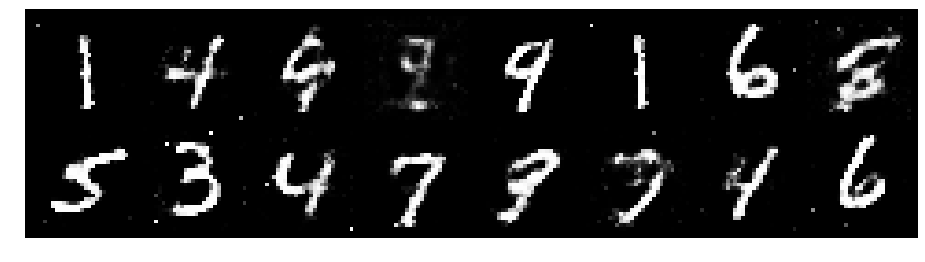

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.1443, Generator Loss: 1.1407
D(x): 0.5899, D(G(z)): 0.3823


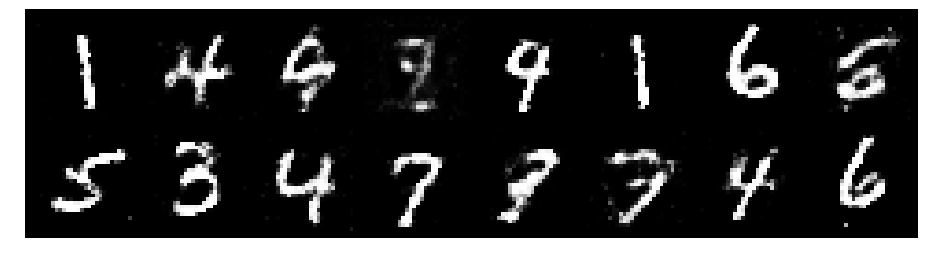

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.1252, Generator Loss: 1.1104
D(x): 0.5920, D(G(z)): 0.3698


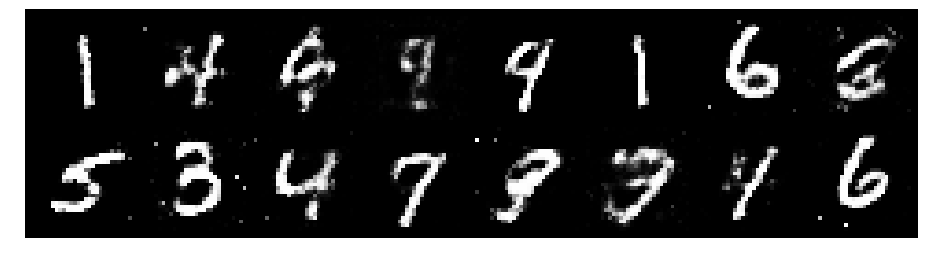

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1321, Generator Loss: 0.9472
D(x): 0.6116, D(G(z)): 0.3993


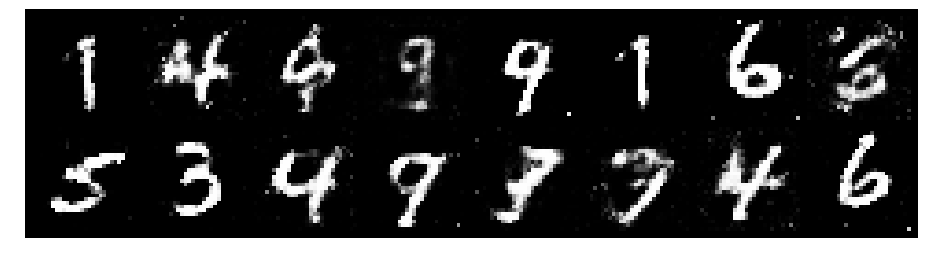

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2137, Generator Loss: 0.9850
D(x): 0.5921, D(G(z)): 0.4176


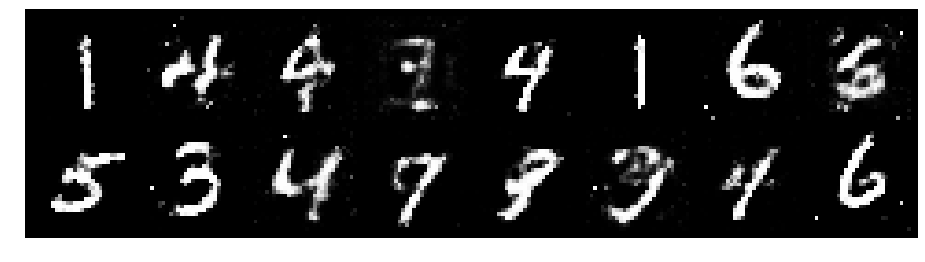

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.2004, Generator Loss: 0.8834
D(x): 0.5669, D(G(z)): 0.4177


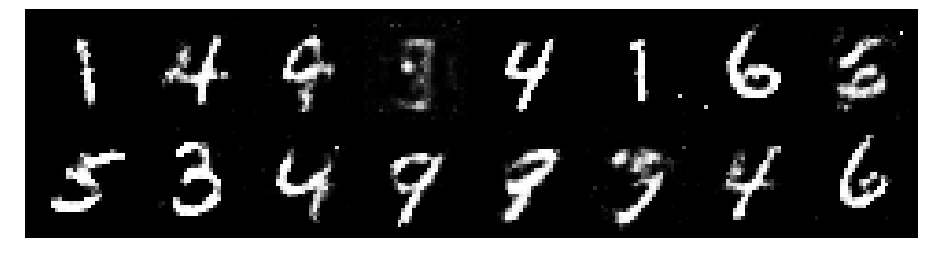

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.1962, Generator Loss: 0.8800
D(x): 0.6020, D(G(z)): 0.4565


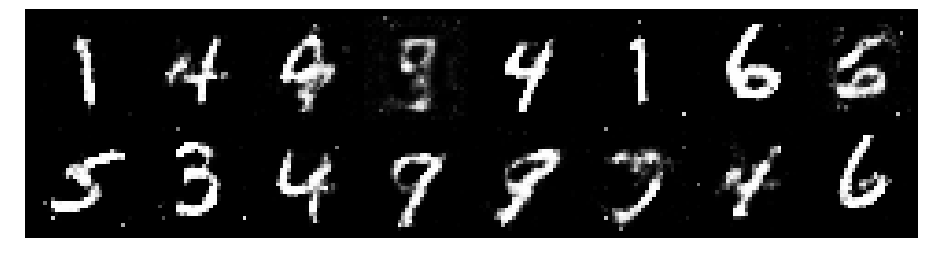

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2289, Generator Loss: 1.0718
D(x): 0.5643, D(G(z)): 0.4275


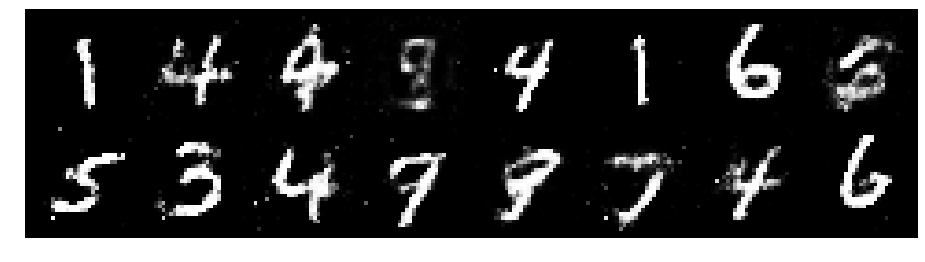

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.1093, Generator Loss: 1.1209
D(x): 0.6146, D(G(z)): 0.3818


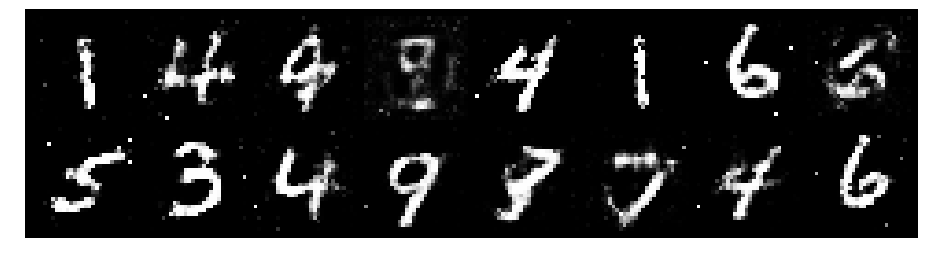

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.1928, Generator Loss: 1.0072
D(x): 0.5709, D(G(z)): 0.4079


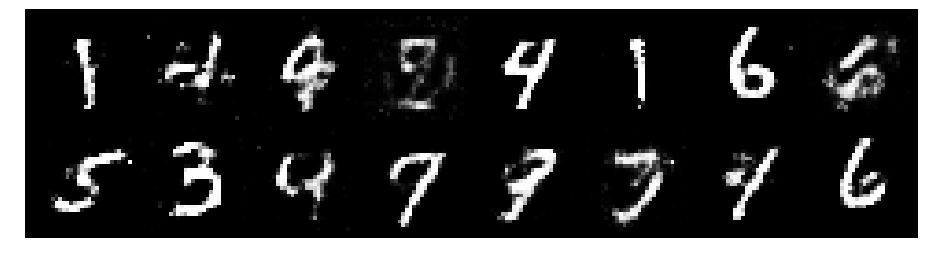

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.1205, Generator Loss: 0.9360
D(x): 0.6027, D(G(z)): 0.4048


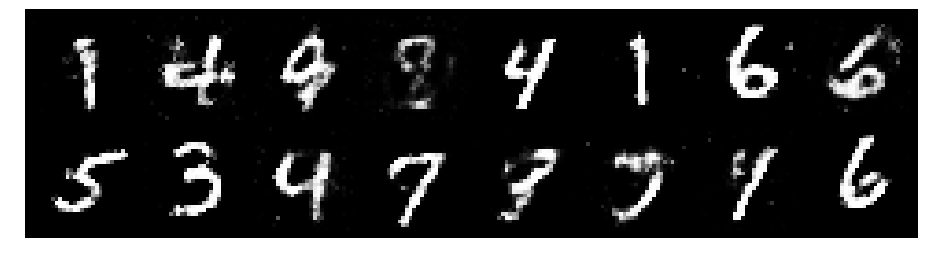

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.2147, Generator Loss: 1.0850
D(x): 0.5356, D(G(z)): 0.3731


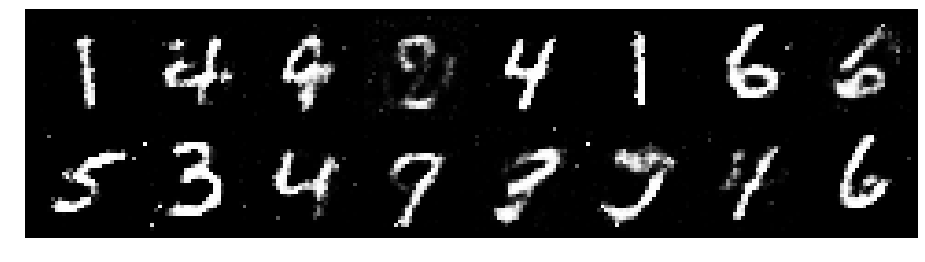

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2548, Generator Loss: 1.1938
D(x): 0.5484, D(G(z)): 0.4108


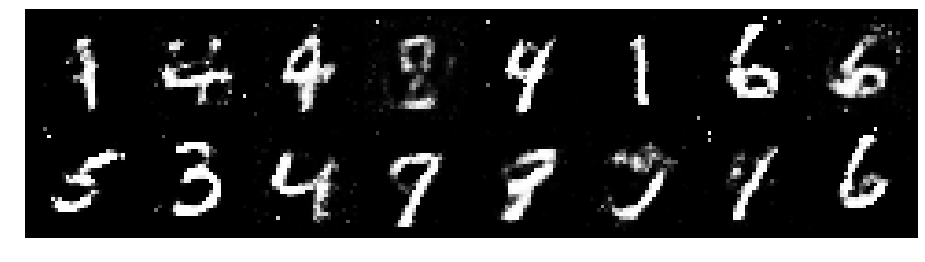

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2034, Generator Loss: 0.8754
D(x): 0.5740, D(G(z)): 0.4195


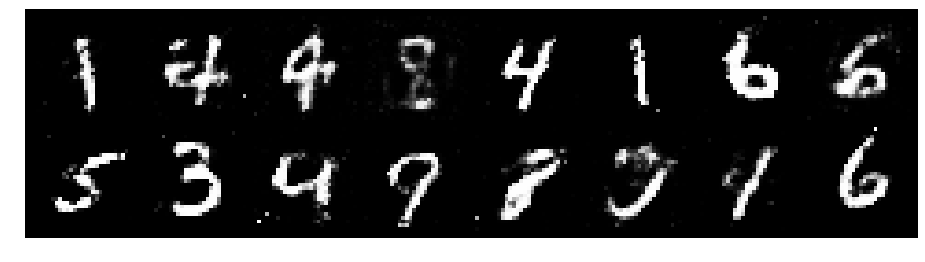

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.3085, Generator Loss: 0.9645
D(x): 0.5379, D(G(z)): 0.4320


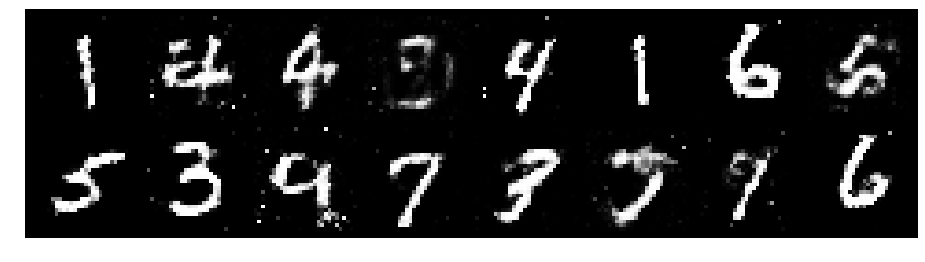

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.1166, Generator Loss: 1.1147
D(x): 0.6029, D(G(z)): 0.3797


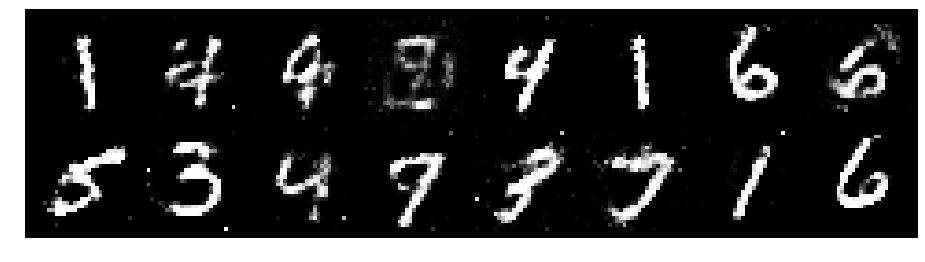

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.1966, Generator Loss: 1.0314
D(x): 0.5247, D(G(z)): 0.3480


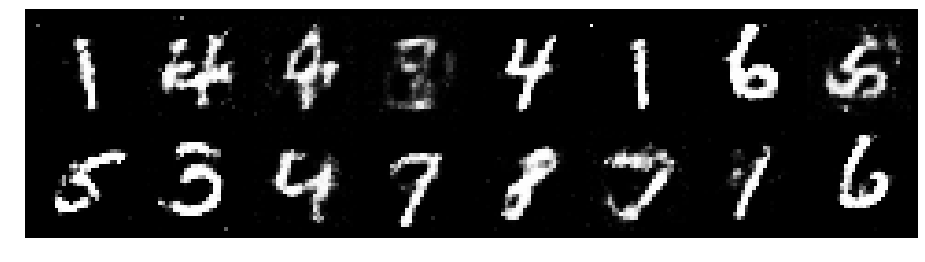

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.2023, Generator Loss: 0.8588
D(x): 0.5888, D(G(z)): 0.4455


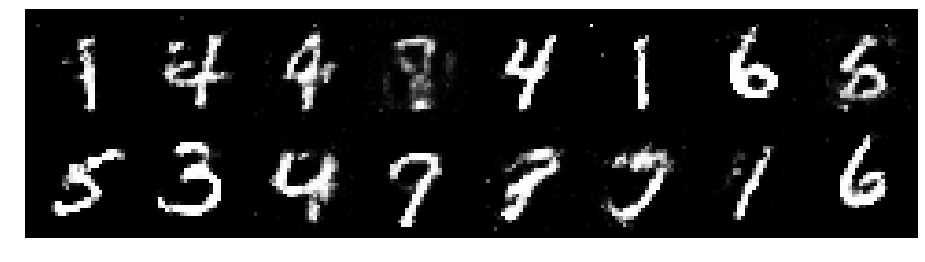

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.1362, Generator Loss: 1.0089
D(x): 0.6099, D(G(z)): 0.4182


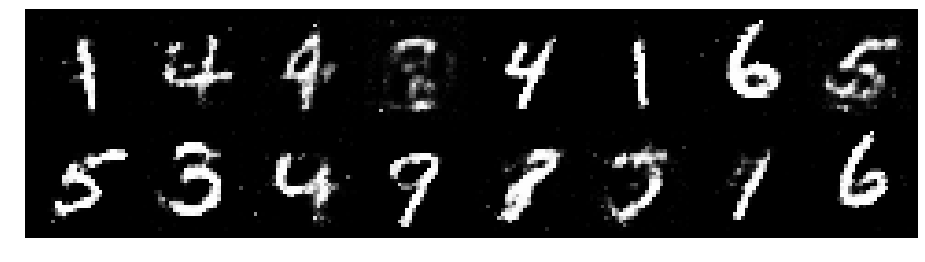

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.1593, Generator Loss: 0.8541
D(x): 0.5897, D(G(z)): 0.4286


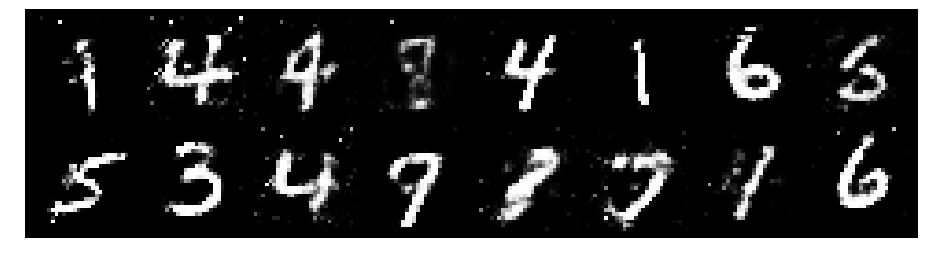

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.1751, Generator Loss: 1.1199
D(x): 0.5789, D(G(z)): 0.4023


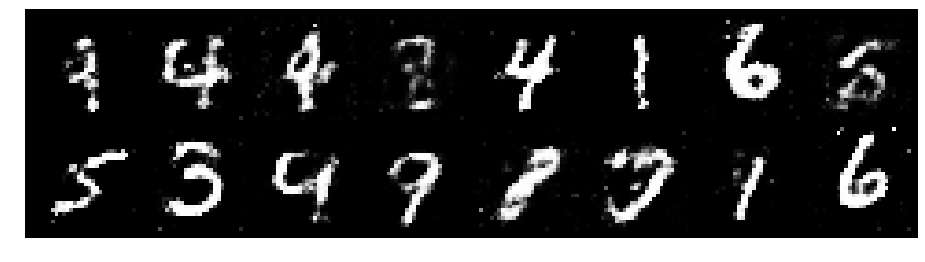

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.0991, Generator Loss: 1.0353
D(x): 0.6306, D(G(z)): 0.4007


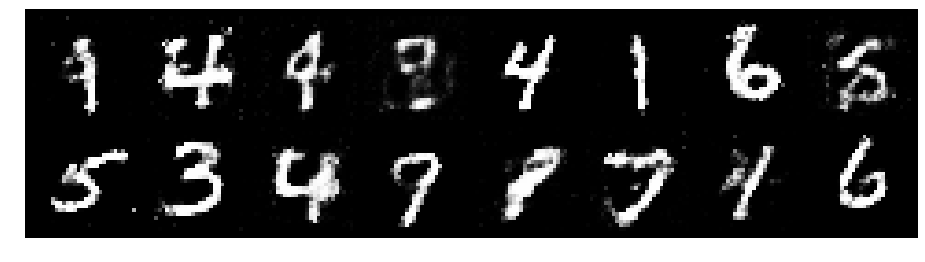

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.2355, Generator Loss: 0.9339
D(x): 0.6028, D(G(z)): 0.4638


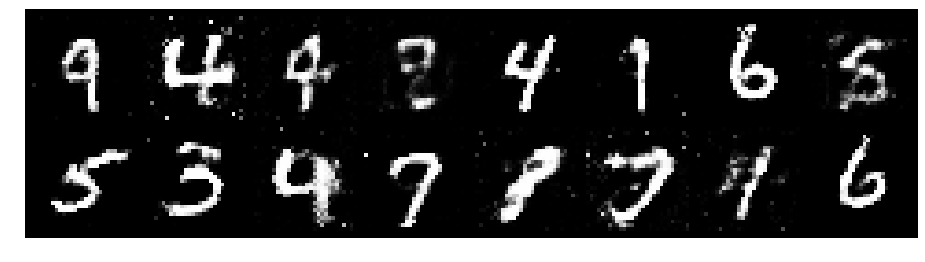

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.2198, Generator Loss: 0.9779
D(x): 0.5487, D(G(z)): 0.3978


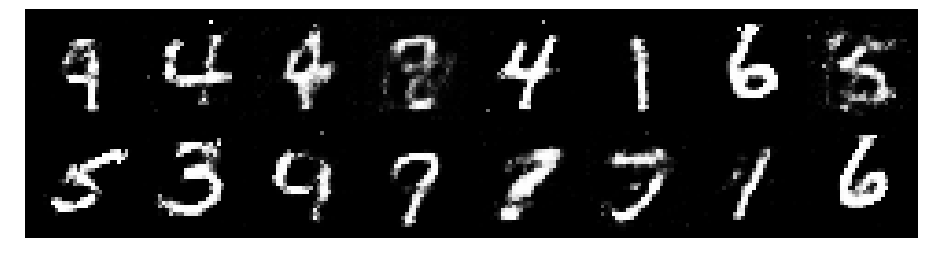

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.1166, Generator Loss: 0.8522
D(x): 0.6286, D(G(z)): 0.4283


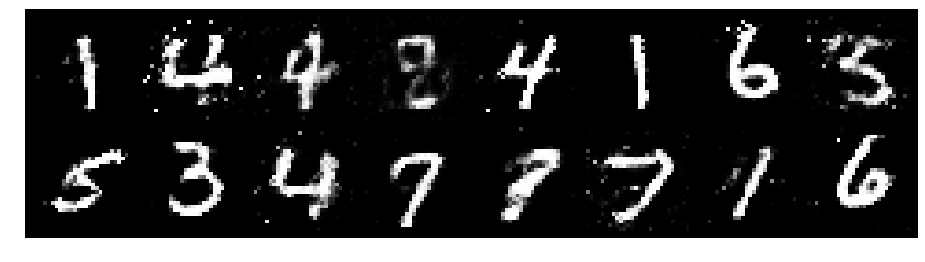

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.1826, Generator Loss: 1.0881
D(x): 0.5877, D(G(z)): 0.4114


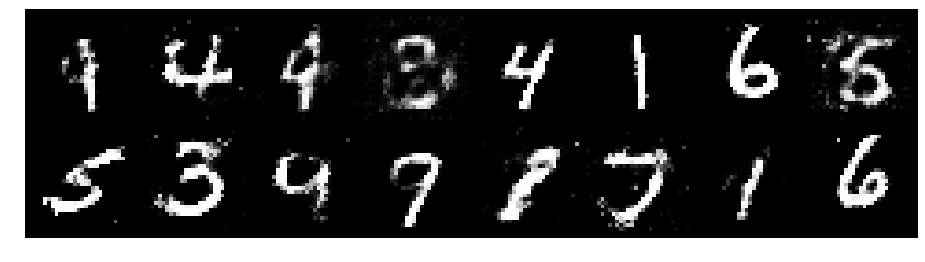

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.1874, Generator Loss: 0.9951
D(x): 0.5663, D(G(z)): 0.4097


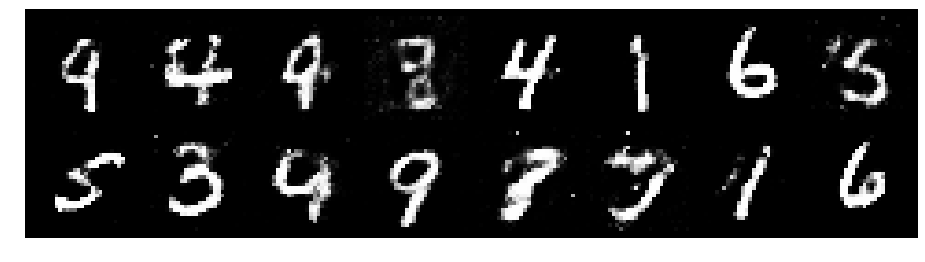

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.3217, Generator Loss: 1.0165
D(x): 0.5308, D(G(z)): 0.4160


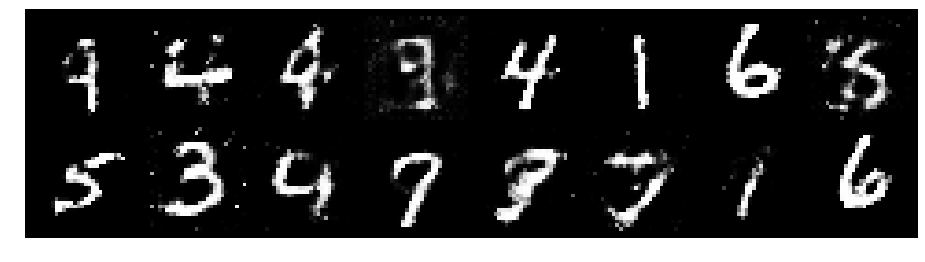

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2760, Generator Loss: 1.0745
D(x): 0.5356, D(G(z)): 0.3869


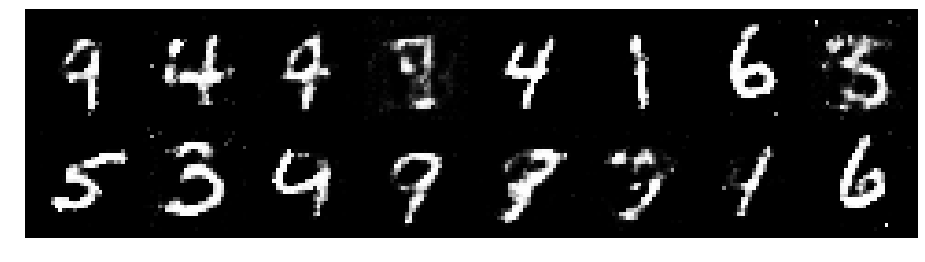

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2513, Generator Loss: 1.0945
D(x): 0.5355, D(G(z)): 0.3993


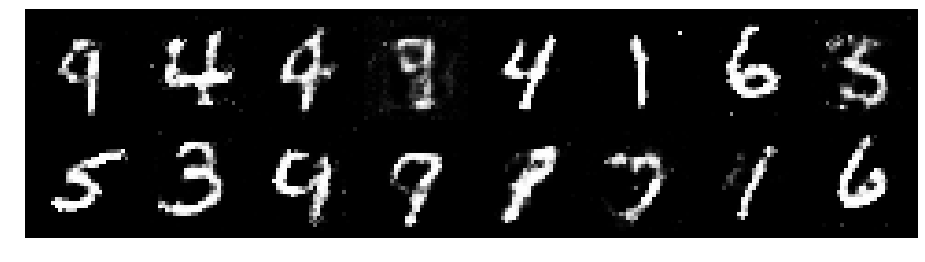

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2333, Generator Loss: 1.0612
D(x): 0.5820, D(G(z)): 0.4225


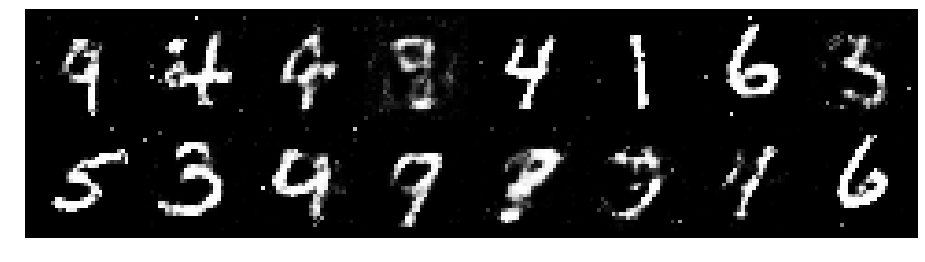

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.3339, Generator Loss: 0.9609
D(x): 0.5198, D(G(z)): 0.4059


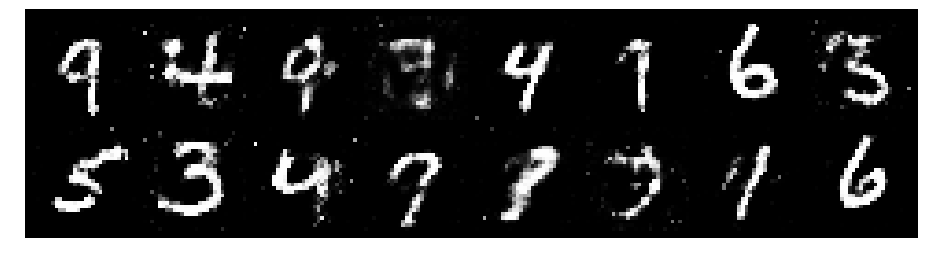

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.1575, Generator Loss: 0.9201
D(x): 0.5391, D(G(z)): 0.3681


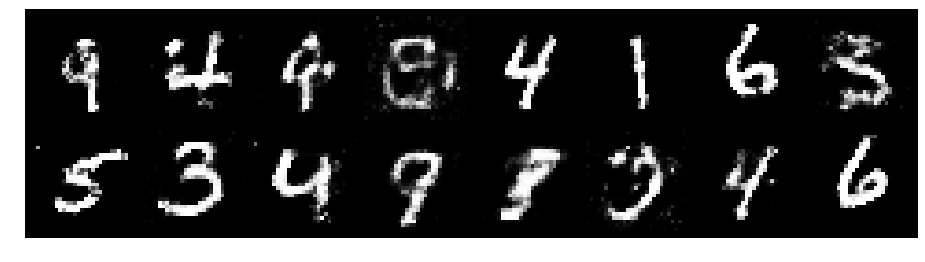

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.3144, Generator Loss: 0.8478
D(x): 0.5408, D(G(z)): 0.4598


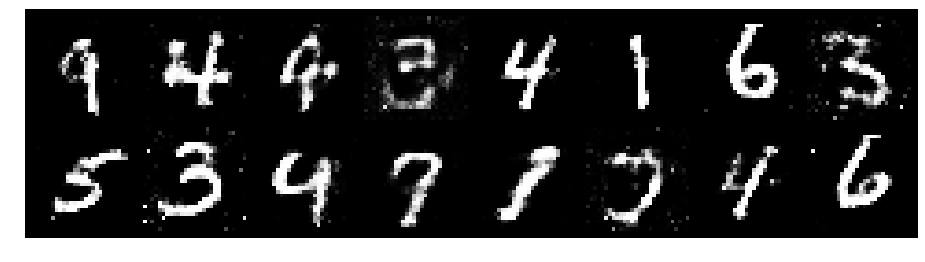

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.1801, Generator Loss: 0.8745
D(x): 0.6412, D(G(z)): 0.4520


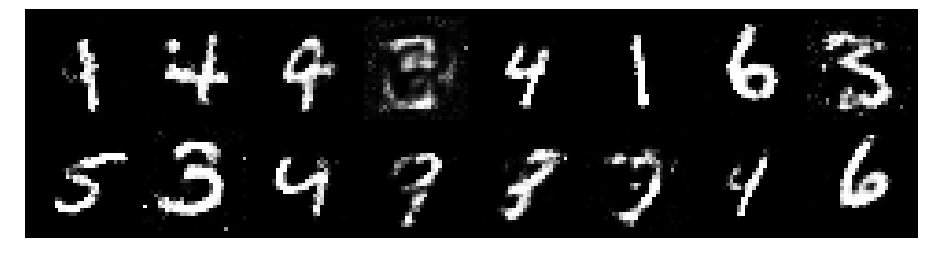

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.1322, Generator Loss: 1.0697
D(x): 0.6127, D(G(z)): 0.3994


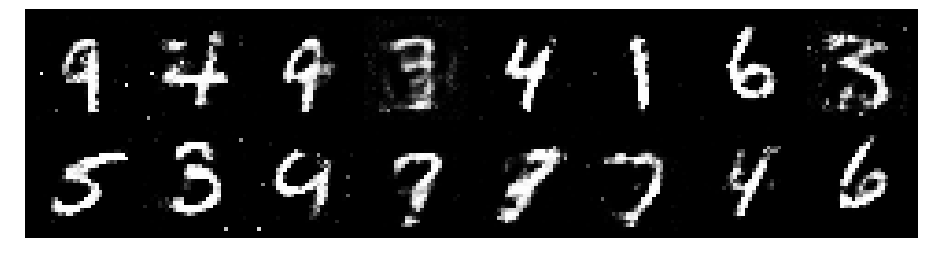

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2643, Generator Loss: 0.8360
D(x): 0.5768, D(G(z)): 0.4563


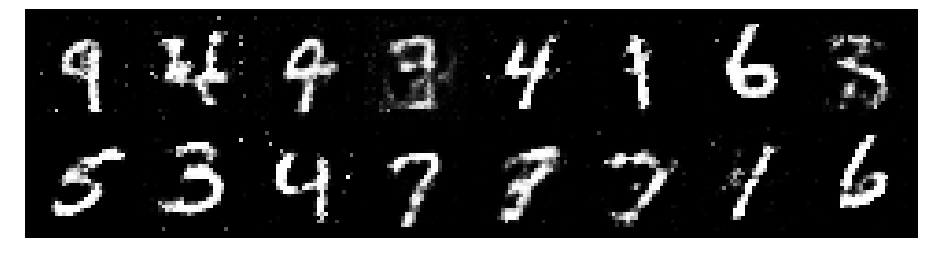

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2002, Generator Loss: 0.8332
D(x): 0.6033, D(G(z)): 0.4527


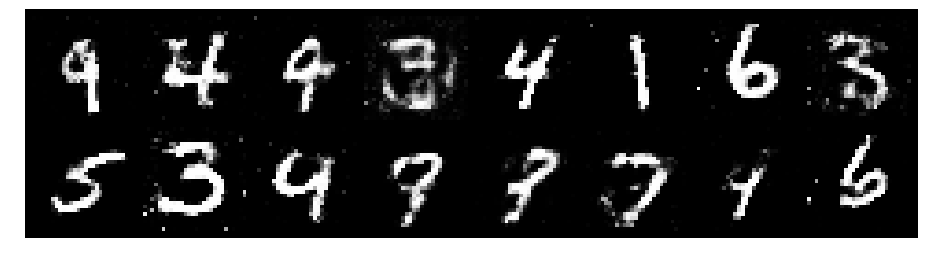

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.3040, Generator Loss: 1.0253
D(x): 0.5352, D(G(z)): 0.4115


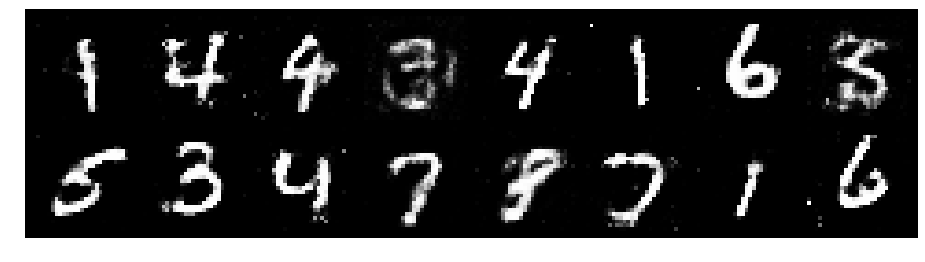

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1181, Generator Loss: 1.0543
D(x): 0.6031, D(G(z)): 0.3739


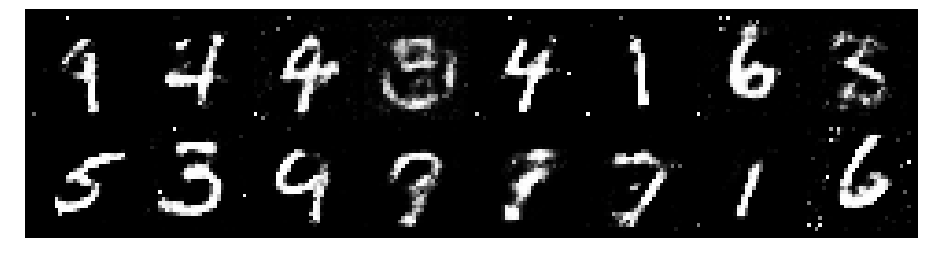

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.1353, Generator Loss: 1.0548
D(x): 0.5804, D(G(z)): 0.3883


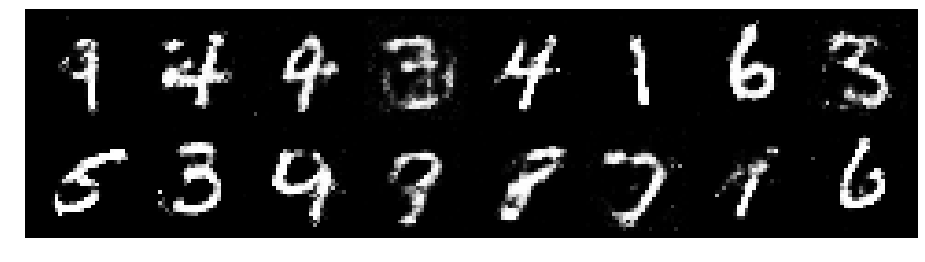

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2528, Generator Loss: 0.9530
D(x): 0.5649, D(G(z)): 0.4428


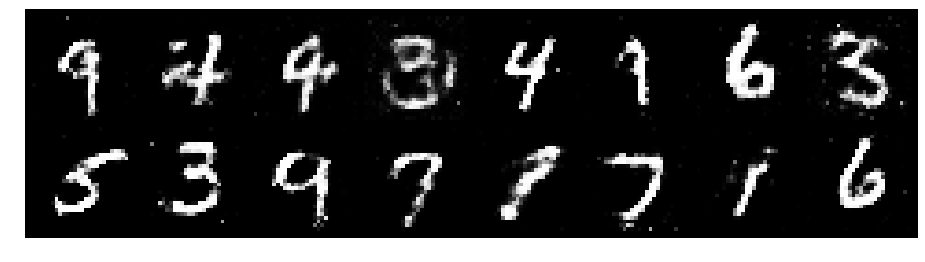

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2254, Generator Loss: 0.9880
D(x): 0.5643, D(G(z)): 0.4367


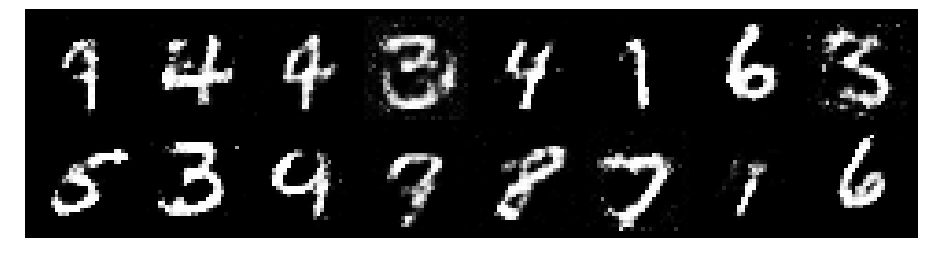

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2417, Generator Loss: 0.8986
D(x): 0.5597, D(G(z)): 0.4126


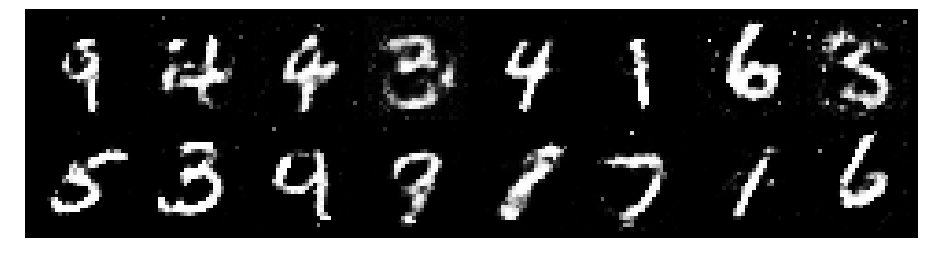

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.3259, Generator Loss: 0.8346
D(x): 0.5889, D(G(z)): 0.4959


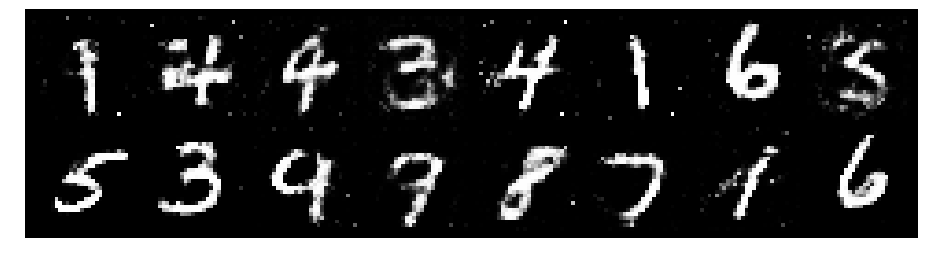

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2363, Generator Loss: 0.9908
D(x): 0.5877, D(G(z)): 0.4291


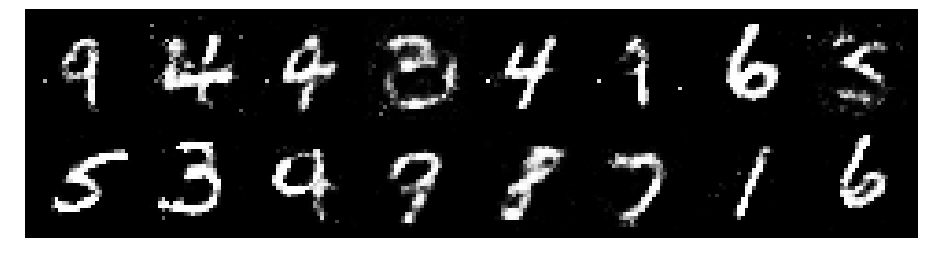

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.1926, Generator Loss: 0.9919
D(x): 0.6117, D(G(z)): 0.4129


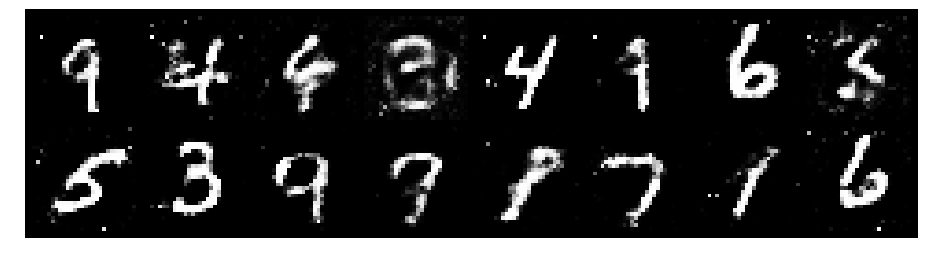

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2005, Generator Loss: 0.9274
D(x): 0.5860, D(G(z)): 0.4380


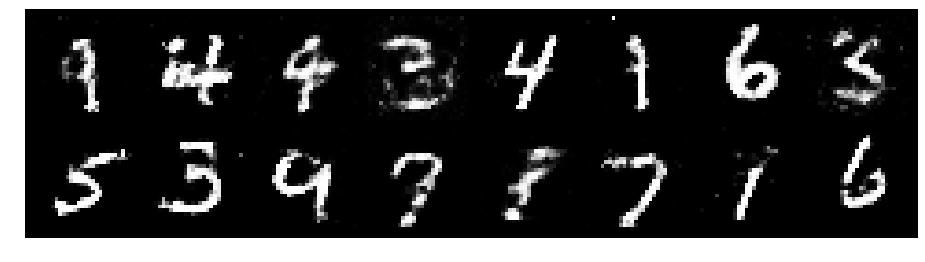

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.2038, Generator Loss: 0.9695
D(x): 0.5836, D(G(z)): 0.4284


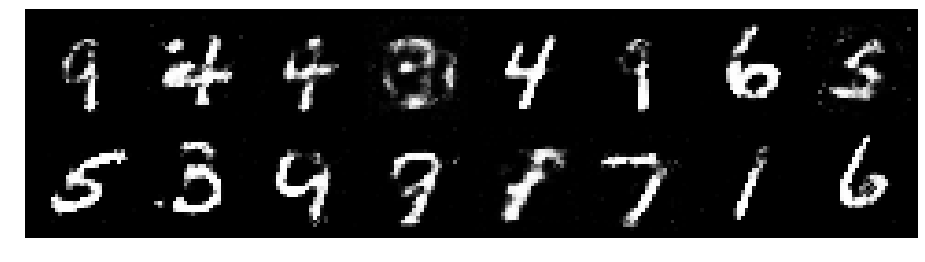

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.3020, Generator Loss: 0.9839
D(x): 0.4943, D(G(z)): 0.3903


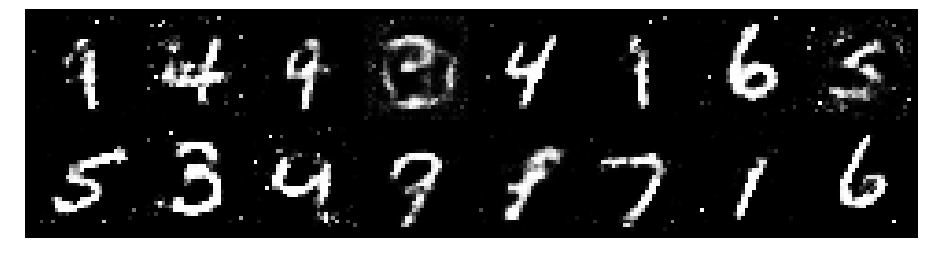

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.2996, Generator Loss: 0.7803
D(x): 0.5810, D(G(z)): 0.4754


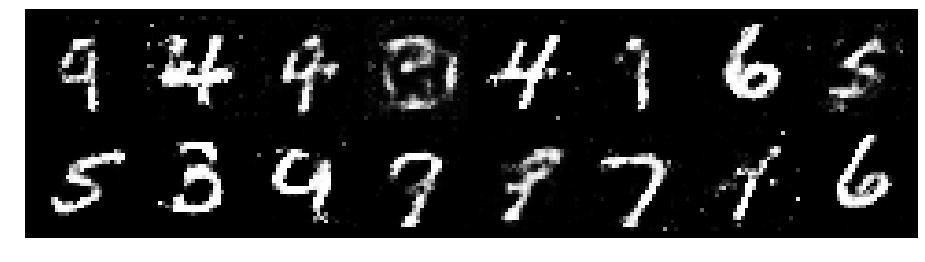

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2209, Generator Loss: 0.9669
D(x): 0.5846, D(G(z)): 0.4295


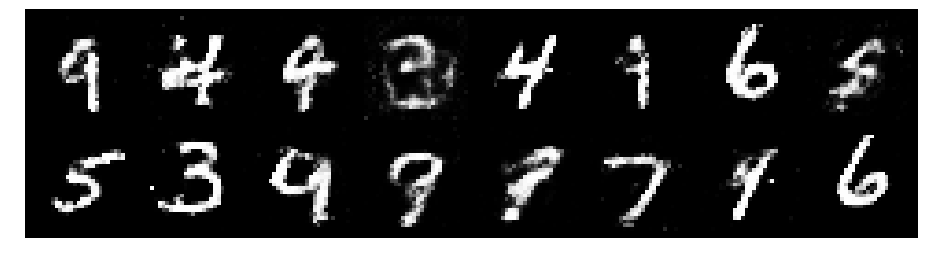

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.1967, Generator Loss: 0.9912
D(x): 0.5624, D(G(z)): 0.3972


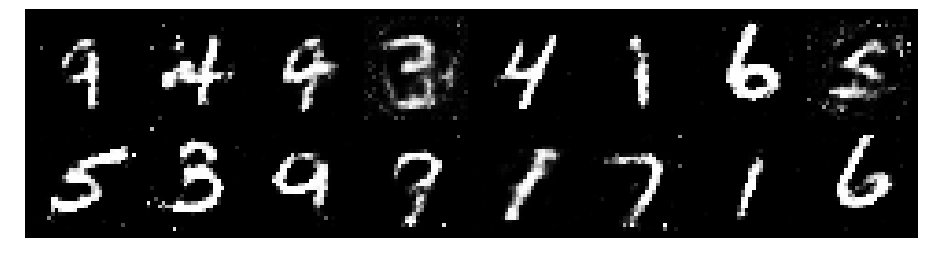

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.3219, Generator Loss: 0.9377
D(x): 0.5544, D(G(z)): 0.4441


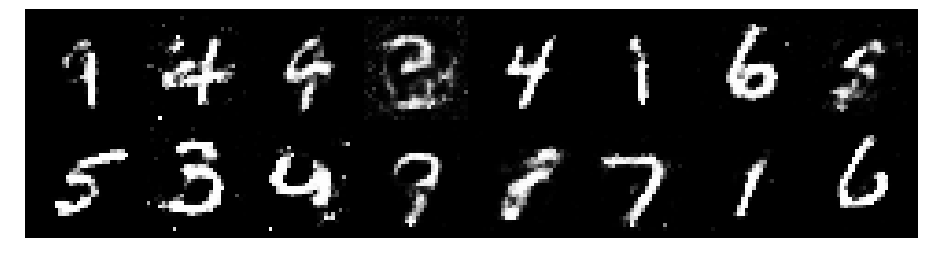

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.4054, Generator Loss: 0.9436
D(x): 0.5137, D(G(z)): 0.4347


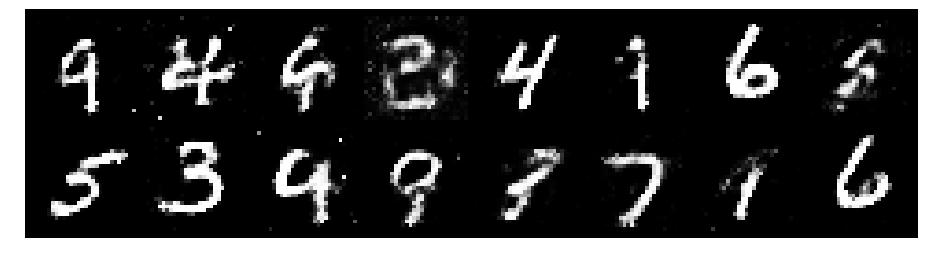

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2191, Generator Loss: 0.9506
D(x): 0.5765, D(G(z)): 0.4265


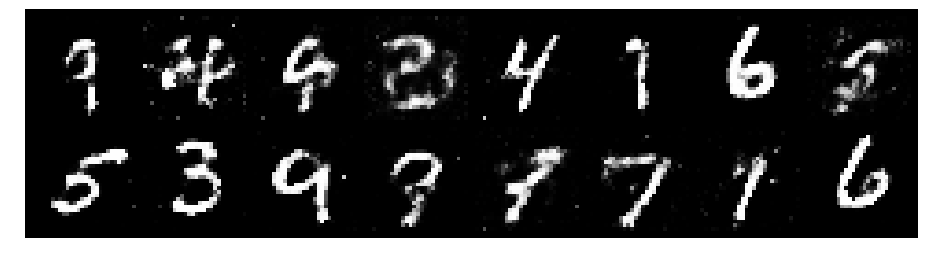

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.1575, Generator Loss: 1.0408
D(x): 0.5905, D(G(z)): 0.4086


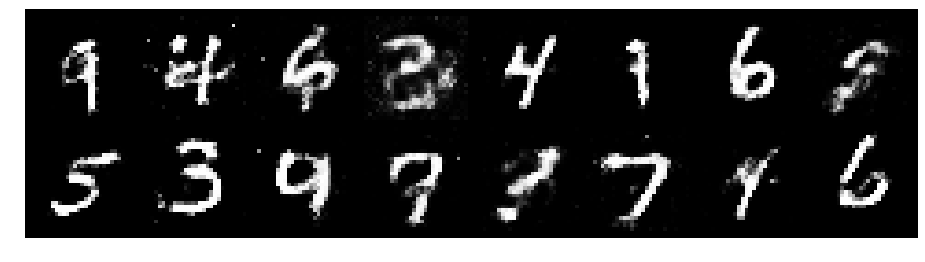

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.1866, Generator Loss: 0.9450
D(x): 0.5517, D(G(z)): 0.3989


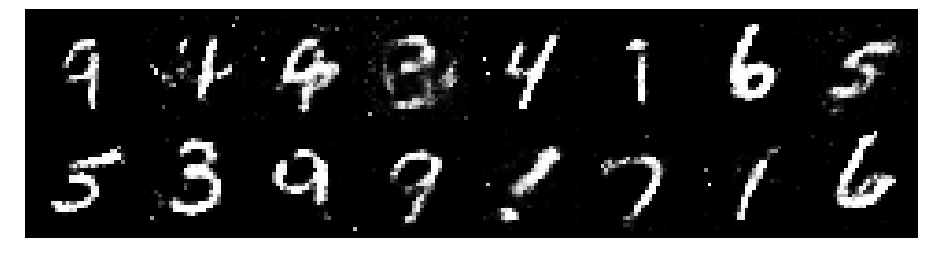

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9030
D(x): 0.5420, D(G(z)): 0.4424


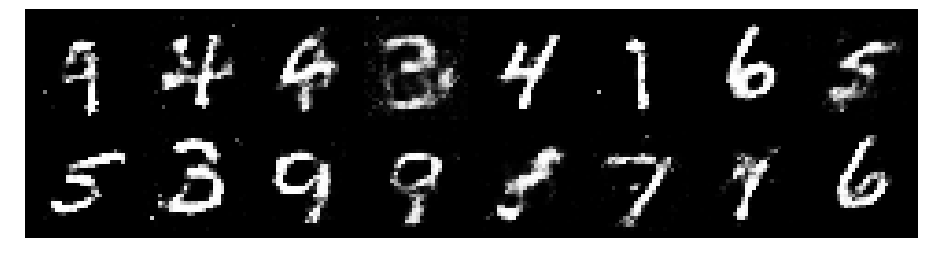

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2416, Generator Loss: 1.0669
D(x): 0.5655, D(G(z)): 0.4076


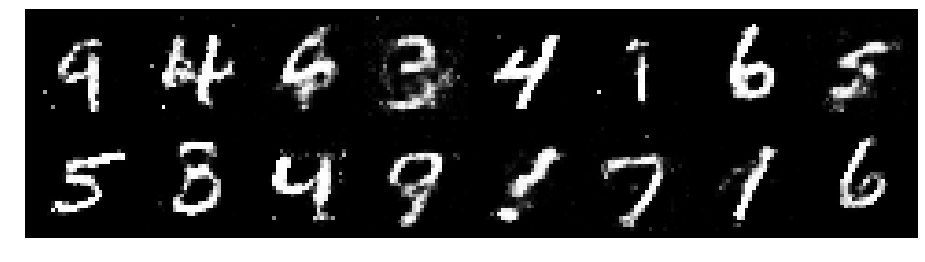

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.1267, Generator Loss: 1.0588
D(x): 0.6020, D(G(z)): 0.3993


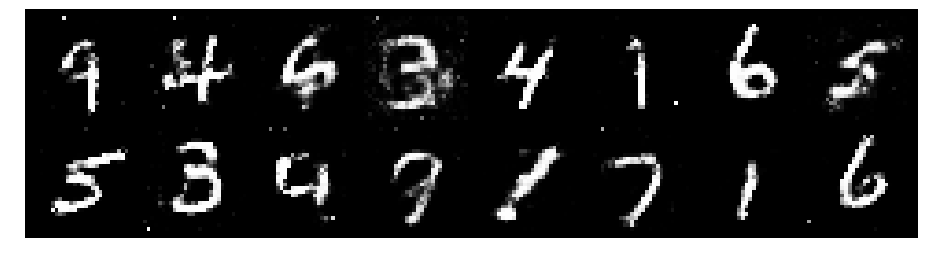

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.3457, Generator Loss: 0.8579
D(x): 0.5379, D(G(z)): 0.4660


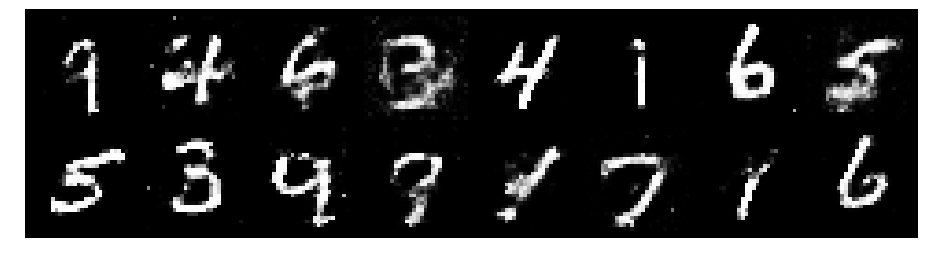

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.2871, Generator Loss: 0.8980
D(x): 0.5278, D(G(z)): 0.4062


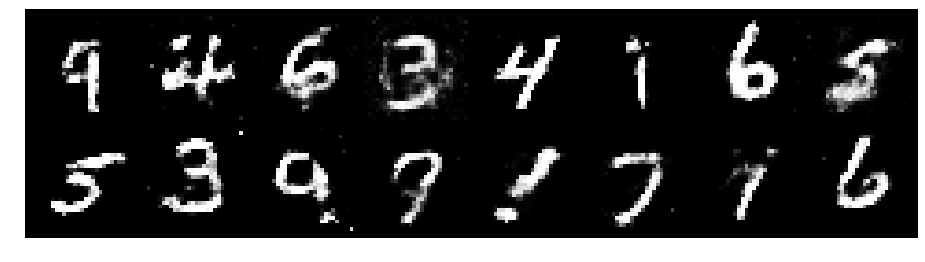

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2604, Generator Loss: 0.7866
D(x): 0.5841, D(G(z)): 0.4546


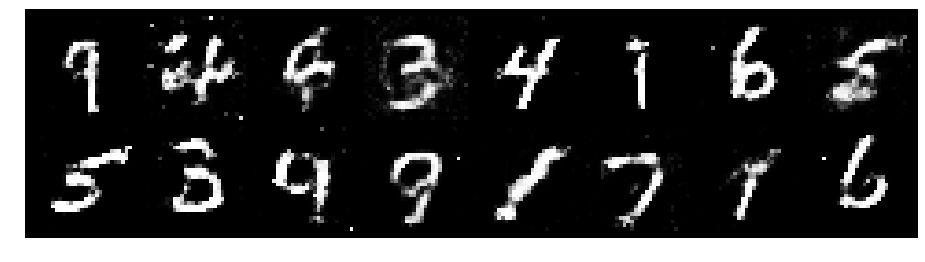

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.2170, Generator Loss: 0.9209
D(x): 0.5713, D(G(z)): 0.4147


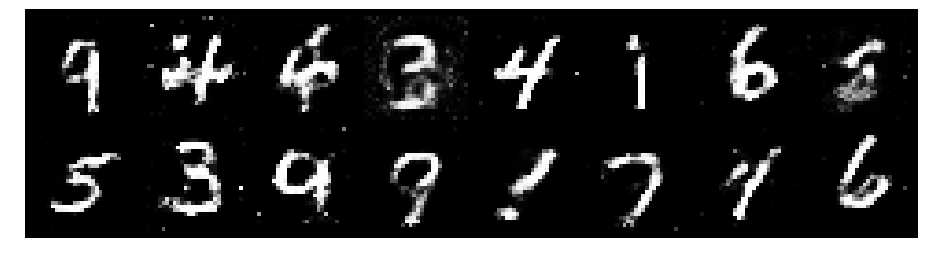

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2862, Generator Loss: 1.0639
D(x): 0.5387, D(G(z)): 0.4108


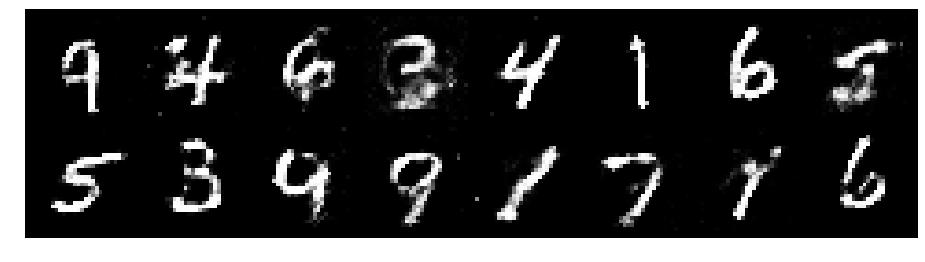

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.2186, Generator Loss: 0.9487
D(x): 0.5350, D(G(z)): 0.4093


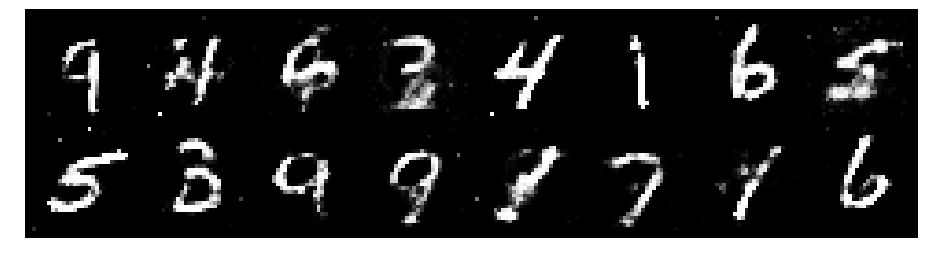

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.2774, Generator Loss: 0.7429
D(x): 0.6259, D(G(z)): 0.4878


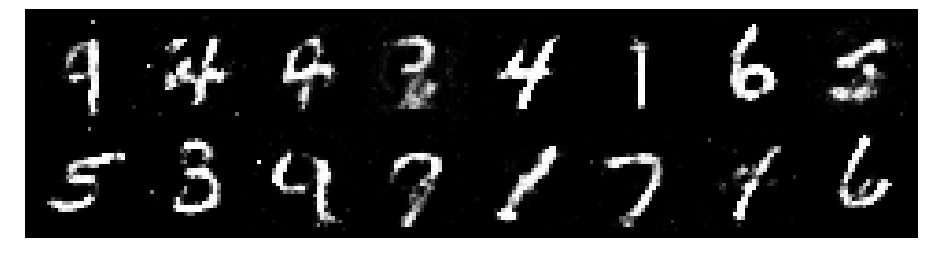

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2353, Generator Loss: 0.9967
D(x): 0.5894, D(G(z)): 0.4356


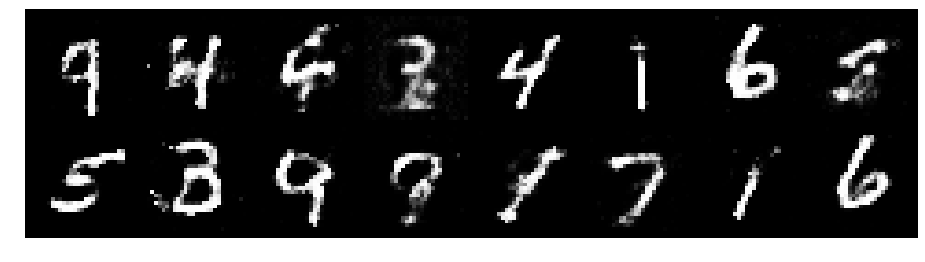

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2092, Generator Loss: 0.8818
D(x): 0.6182, D(G(z)): 0.4558


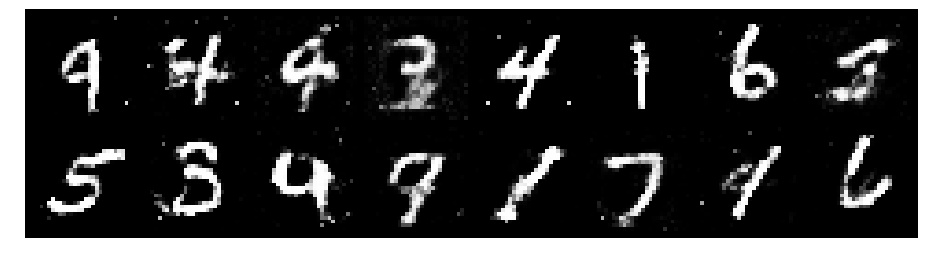

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2874, Generator Loss: 0.9607
D(x): 0.5542, D(G(z)): 0.4449


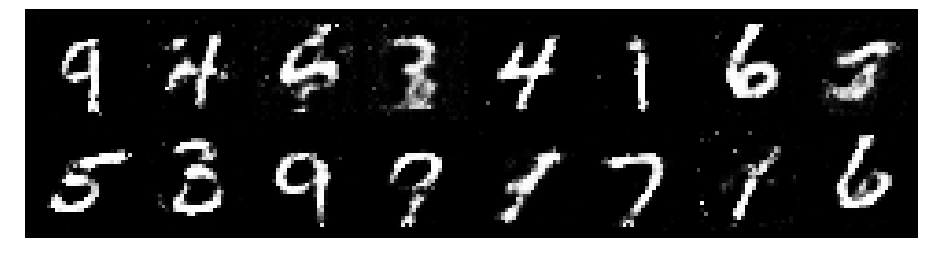

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2164, Generator Loss: 0.9469
D(x): 0.6108, D(G(z)): 0.4237


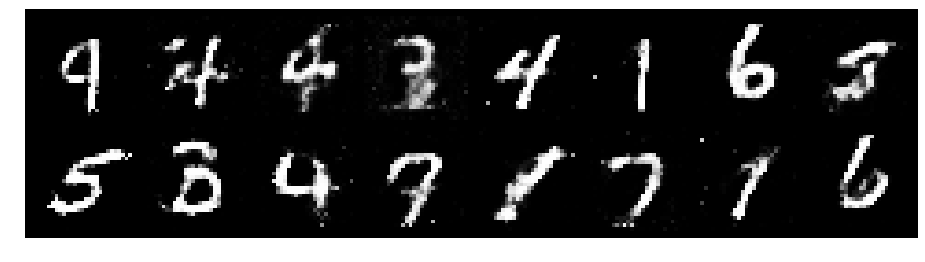

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2767, Generator Loss: 1.0292
D(x): 0.5920, D(G(z)): 0.4428


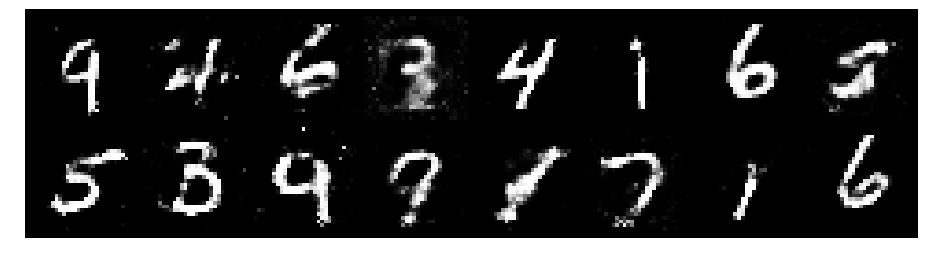

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.2289, Generator Loss: 1.1090
D(x): 0.5847, D(G(z)): 0.4284


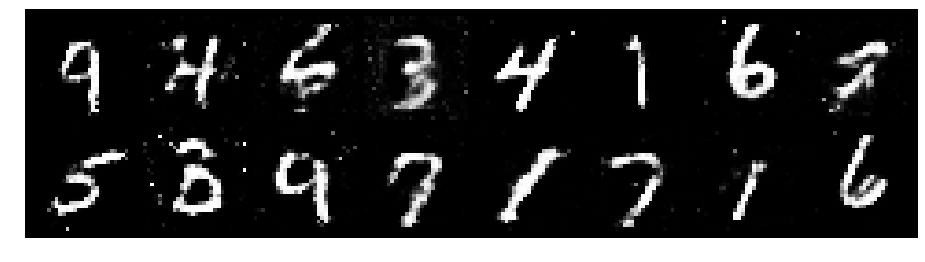

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.2312, Generator Loss: 0.9679
D(x): 0.5856, D(G(z)): 0.4444


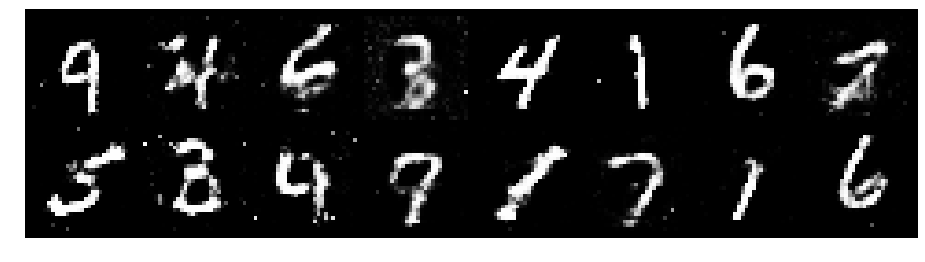

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2670, Generator Loss: 0.9521
D(x): 0.5399, D(G(z)): 0.4164


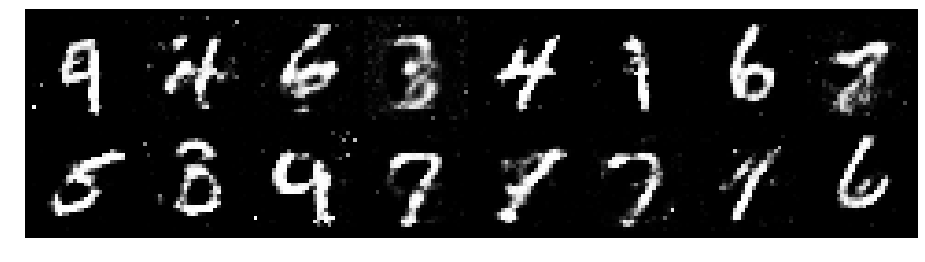

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2134, Generator Loss: 1.0176
D(x): 0.5968, D(G(z)): 0.4385


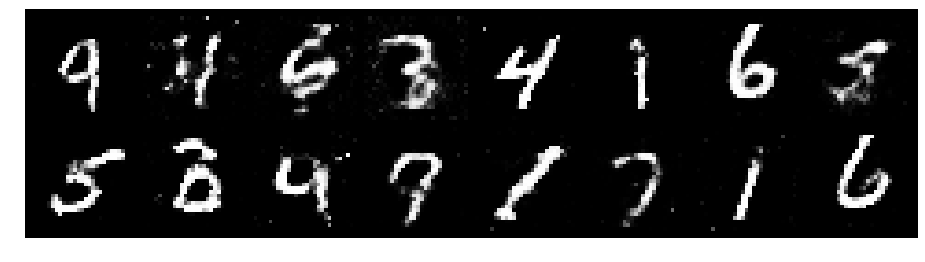

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.1875, Generator Loss: 1.1060
D(x): 0.5640, D(G(z)): 0.3930


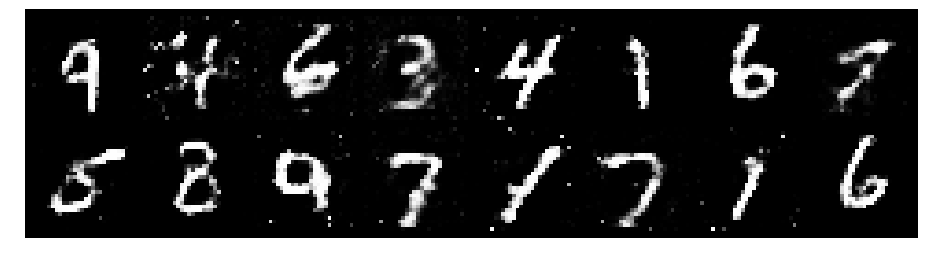

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1723, Generator Loss: 1.0300
D(x): 0.5742, D(G(z)): 0.3979


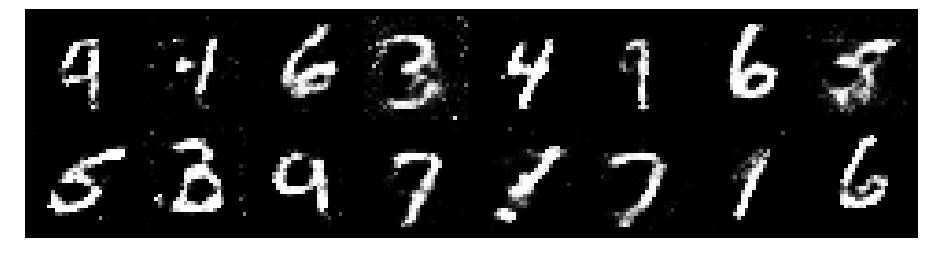

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.3372, Generator Loss: 0.9110
D(x): 0.5756, D(G(z)): 0.4658


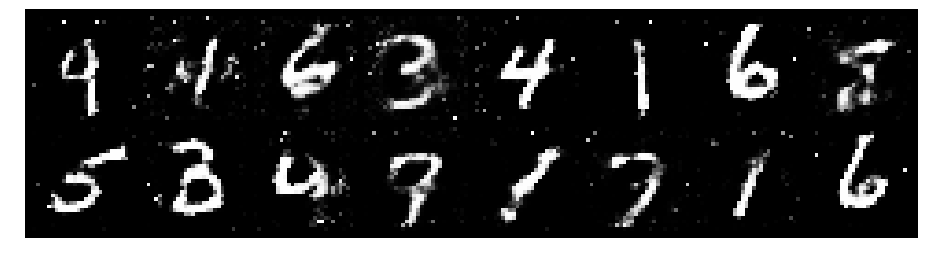

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2215, Generator Loss: 1.0572
D(x): 0.5166, D(G(z)): 0.3711


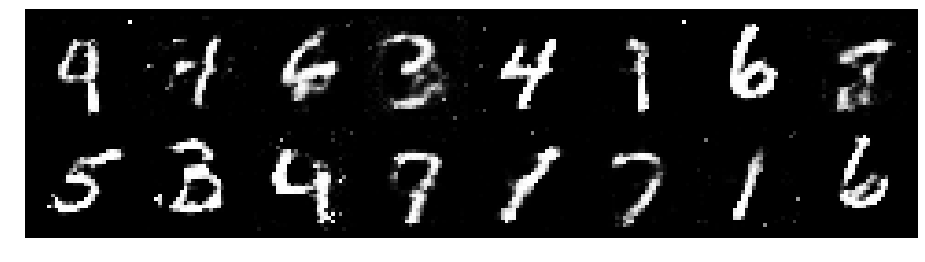

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2267, Generator Loss: 1.0871
D(x): 0.5675, D(G(z)): 0.4149


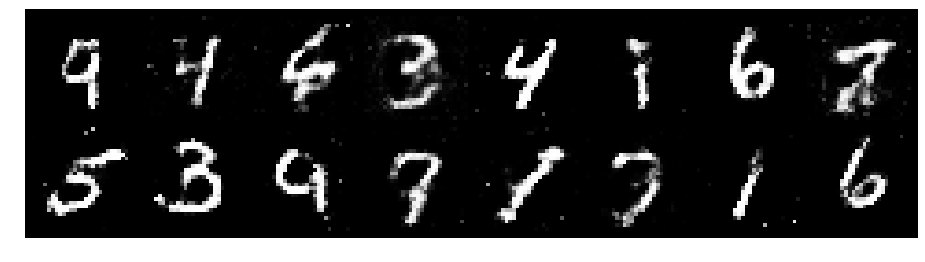

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.2469, Generator Loss: 1.0228
D(x): 0.5818, D(G(z)): 0.4410


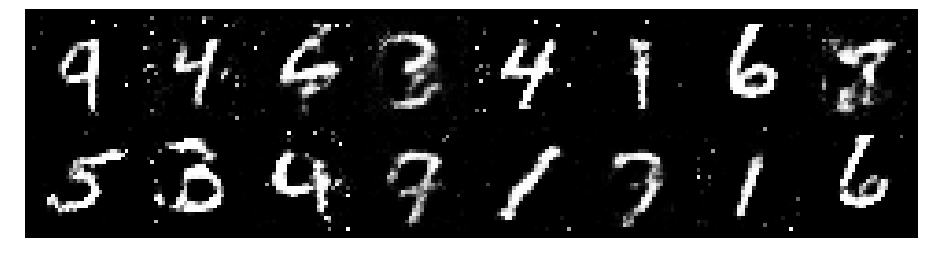

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.2193, Generator Loss: 0.8536
D(x): 0.5860, D(G(z)): 0.4562


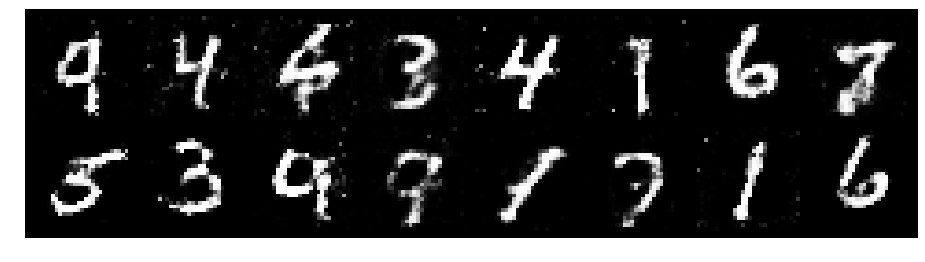

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.2383, Generator Loss: 0.9677
D(x): 0.5910, D(G(z)): 0.4278


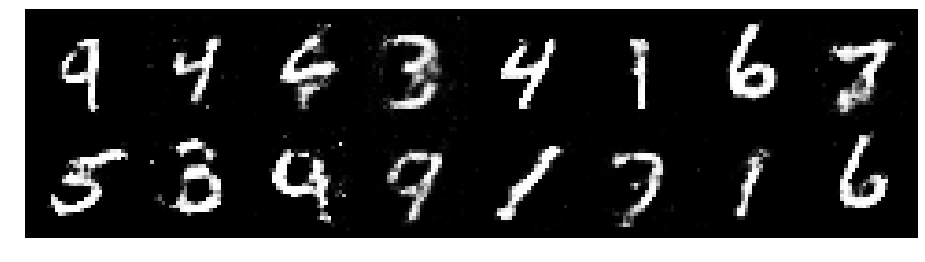

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.1516, Generator Loss: 0.8839
D(x): 0.5961, D(G(z)): 0.4139


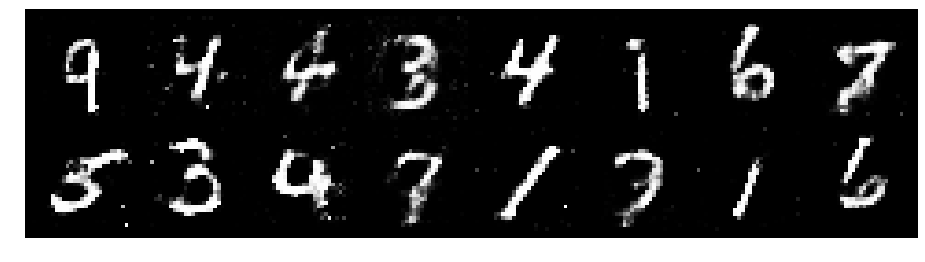

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.2344, Generator Loss: 0.9411
D(x): 0.5634, D(G(z)): 0.4128


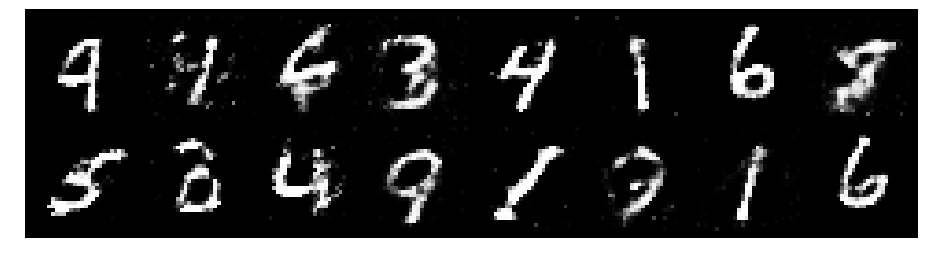

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.1822, Generator Loss: 0.8274
D(x): 0.5967, D(G(z)): 0.4434


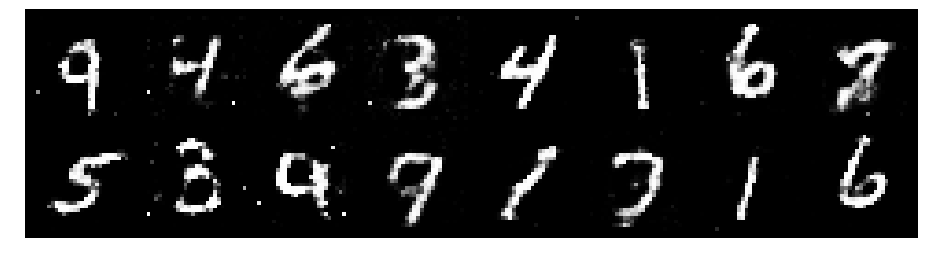

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.3867, Generator Loss: 0.9399
D(x): 0.5459, D(G(z)): 0.4378


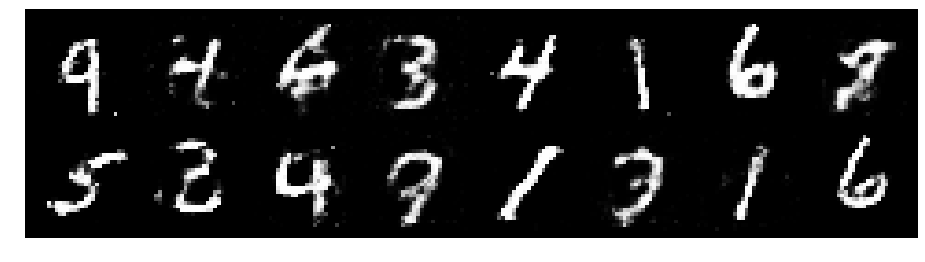

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2943, Generator Loss: 0.9786
D(x): 0.5388, D(G(z)): 0.4078


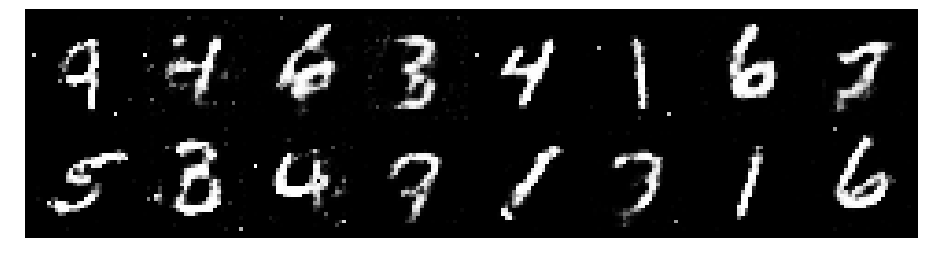

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.1761, Generator Loss: 1.0099
D(x): 0.6009, D(G(z)): 0.4258


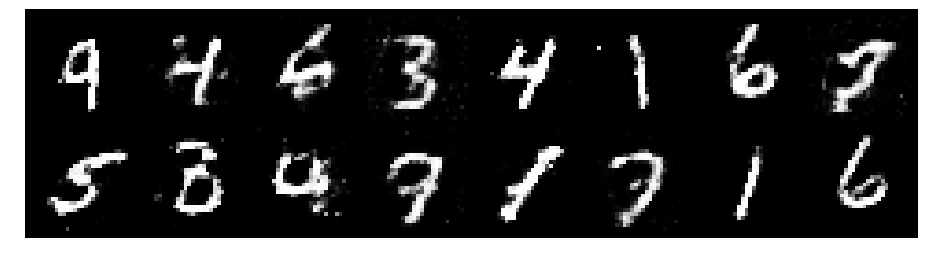

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1689, Generator Loss: 0.8840
D(x): 0.6260, D(G(z)): 0.4421


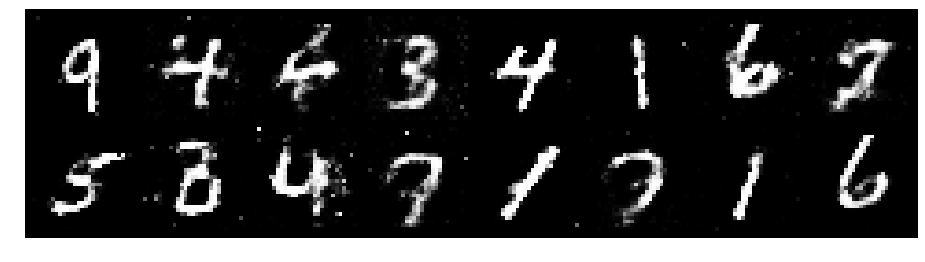

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2846, Generator Loss: 1.0486
D(x): 0.5858, D(G(z)): 0.4580


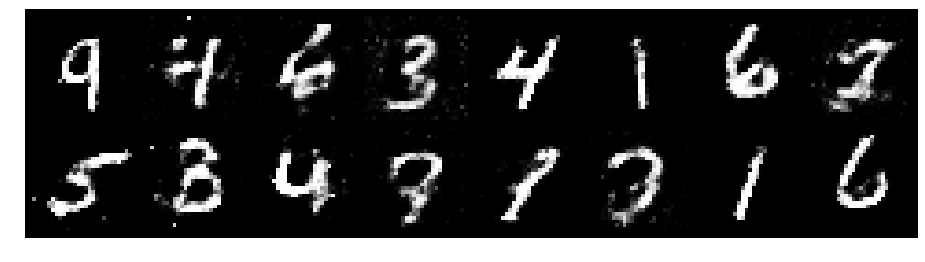

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.3121, Generator Loss: 0.8886
D(x): 0.5994, D(G(z)): 0.4697


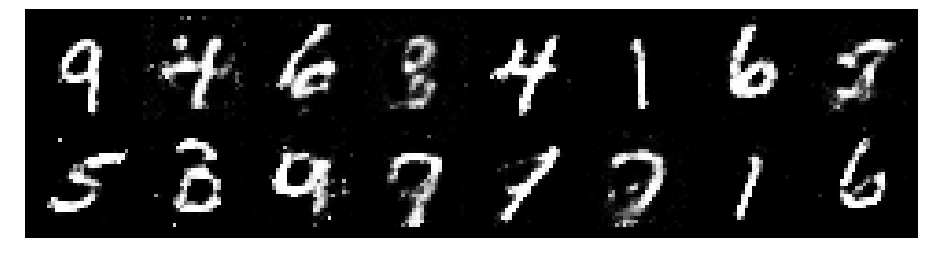

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.4421, Generator Loss: 0.8362
D(x): 0.5764, D(G(z)): 0.5190


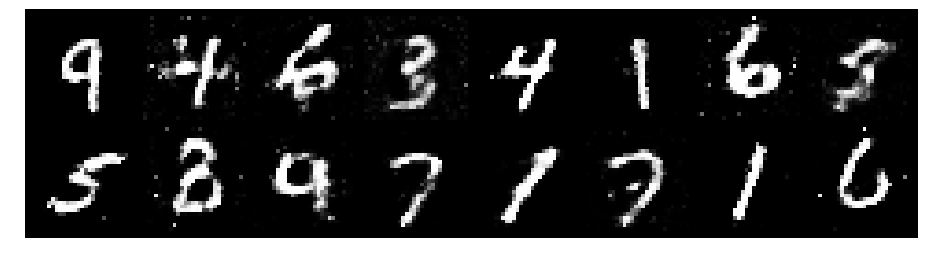

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.2311, Generator Loss: 0.9858
D(x): 0.5493, D(G(z)): 0.4078


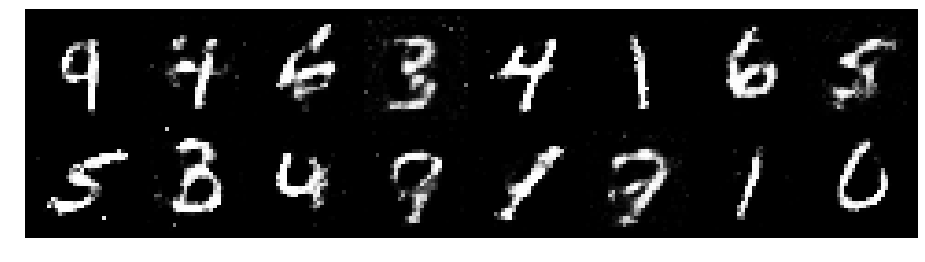

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.3537, Generator Loss: 1.0765
D(x): 0.4970, D(G(z)): 0.4128


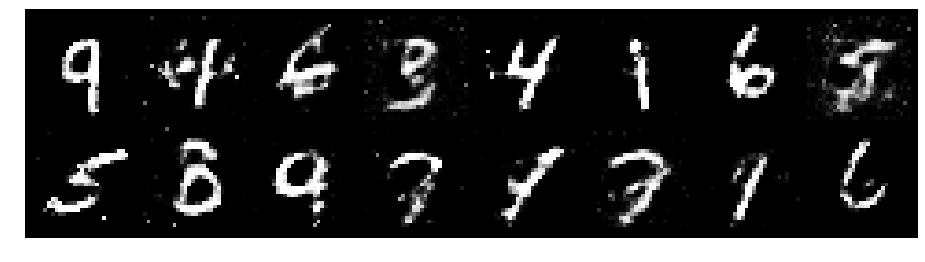

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2144, Generator Loss: 0.8832
D(x): 0.5980, D(G(z)): 0.4293


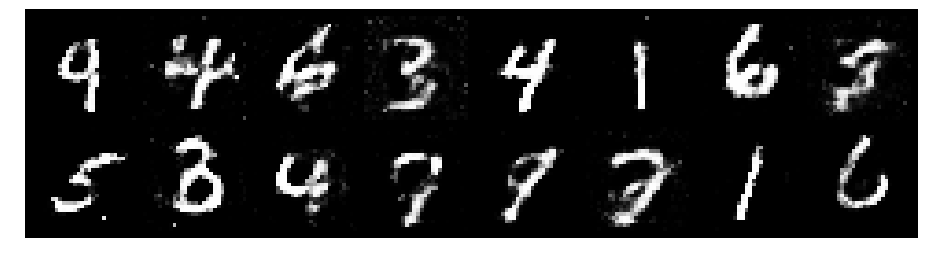

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.0849, Generator Loss: 1.0172
D(x): 0.6068, D(G(z)): 0.3907


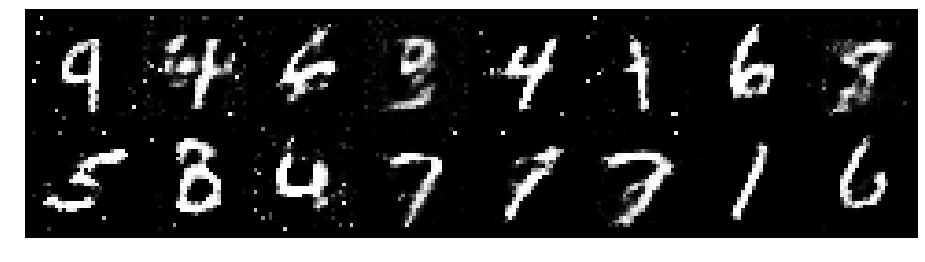

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.1265, Generator Loss: 0.9903
D(x): 0.6132, D(G(z)): 0.4195


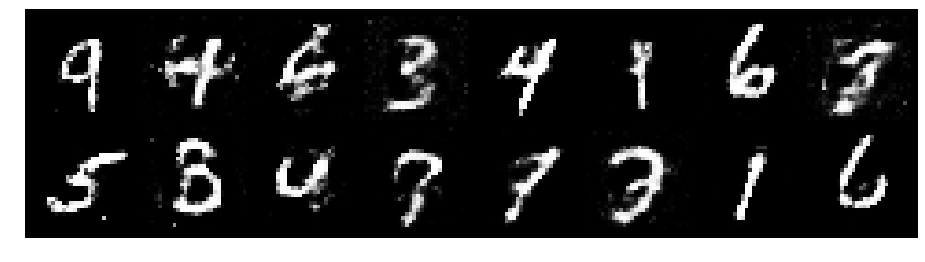

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.2670, Generator Loss: 0.9267
D(x): 0.5328, D(G(z)): 0.4291


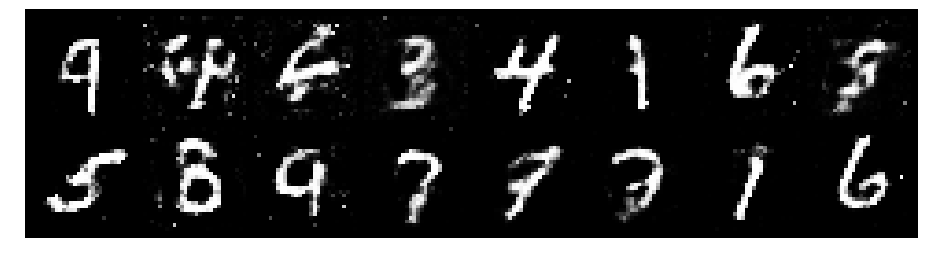

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.1747, Generator Loss: 0.9435
D(x): 0.5637, D(G(z)): 0.3864


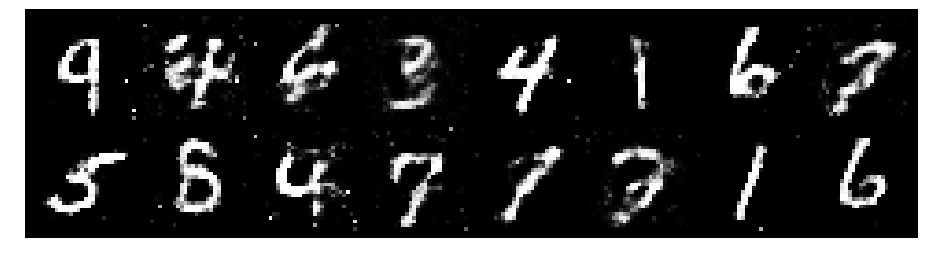

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2318, Generator Loss: 1.1547
D(x): 0.5251, D(G(z)): 0.3783


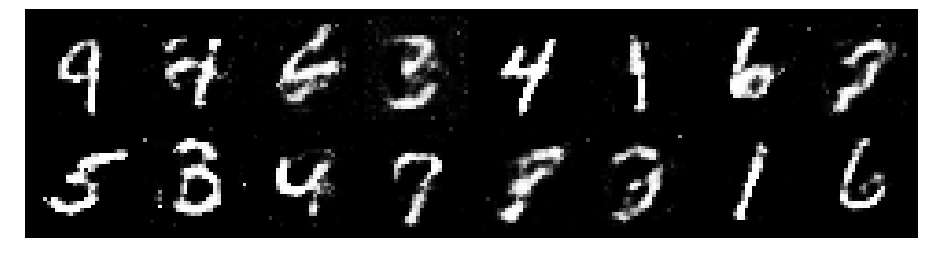

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.1973, Generator Loss: 0.9115
D(x): 0.5772, D(G(z)): 0.4244


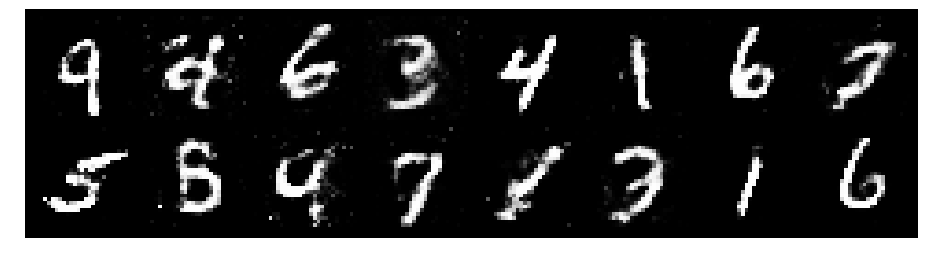

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.3230, Generator Loss: 0.8577
D(x): 0.5840, D(G(z)): 0.4775


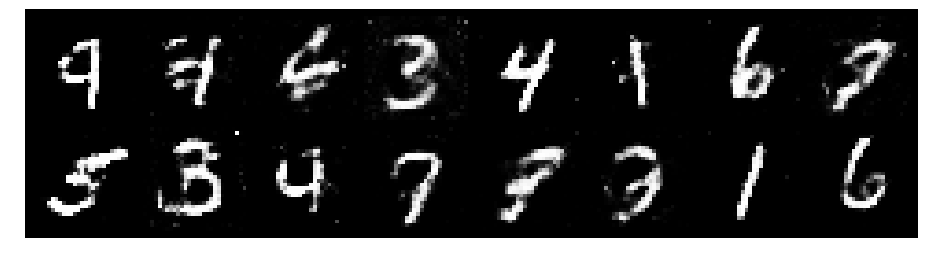

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.3039, Generator Loss: 0.9400
D(x): 0.5319, D(G(z)): 0.4275


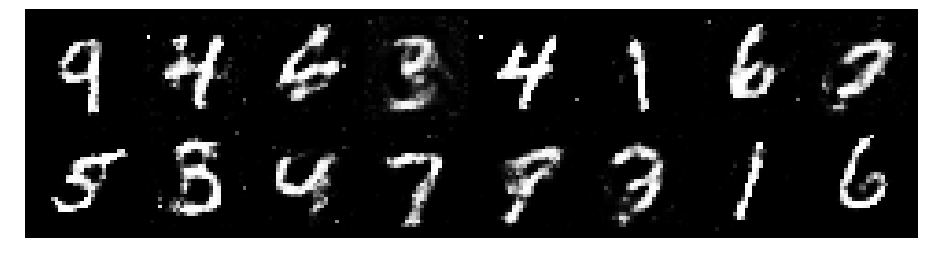

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.1444, Generator Loss: 1.0206
D(x): 0.5523, D(G(z)): 0.3643


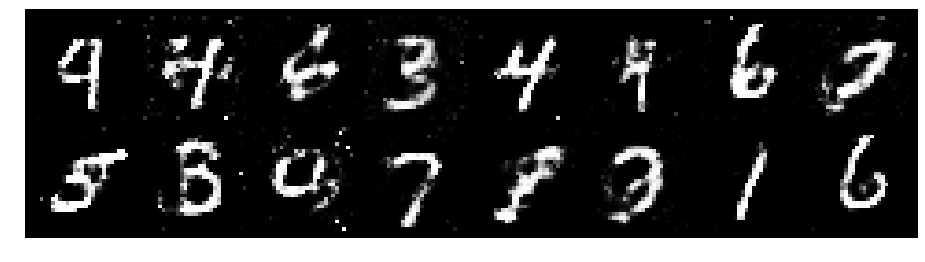

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.2984, Generator Loss: 0.8345
D(x): 0.5504, D(G(z)): 0.4290


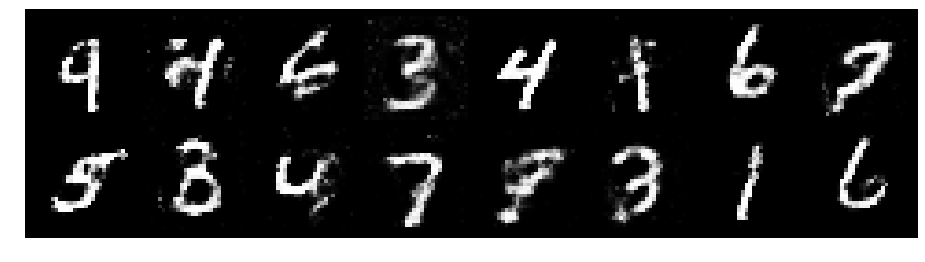

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.1663, Generator Loss: 0.9396
D(x): 0.5664, D(G(z)): 0.4082


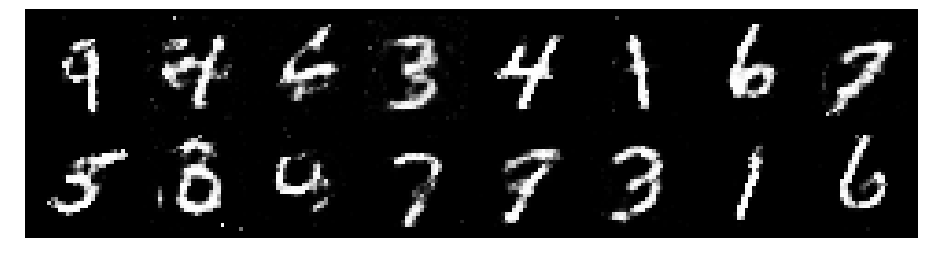

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.1551, Generator Loss: 0.8887
D(x): 0.5737, D(G(z)): 0.4075


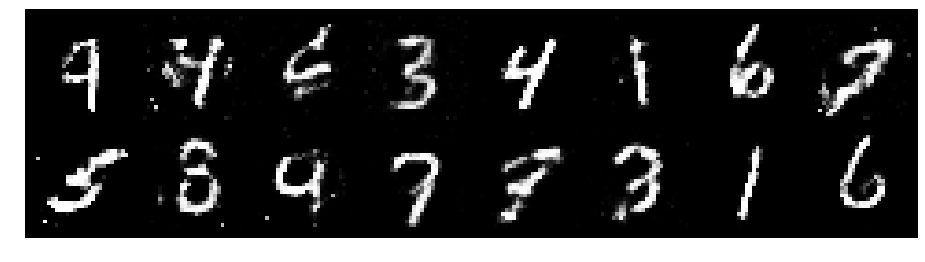

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.1956, Generator Loss: 0.9633
D(x): 0.5818, D(G(z)): 0.4248


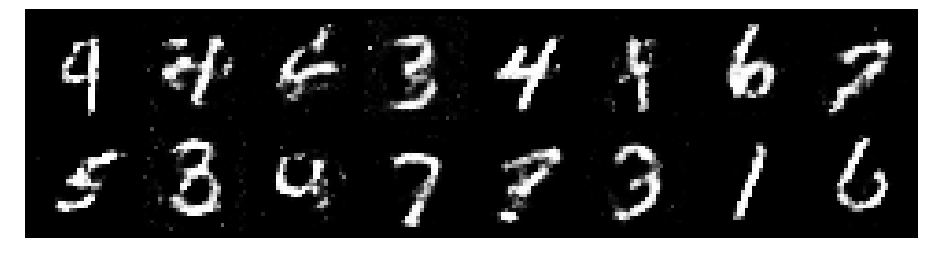

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.3299, Generator Loss: 0.7832
D(x): 0.5523, D(G(z)): 0.4685


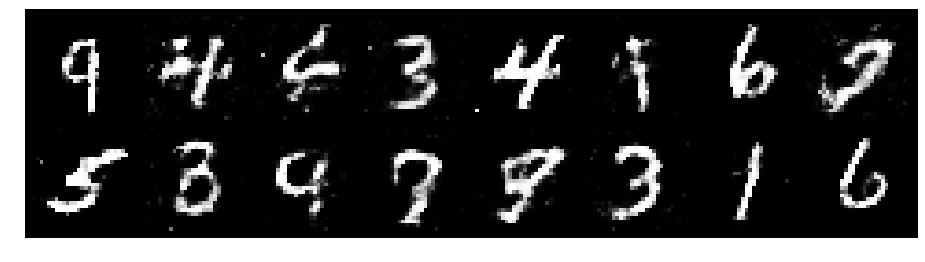

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2703, Generator Loss: 0.9644
D(x): 0.5596, D(G(z)): 0.4412


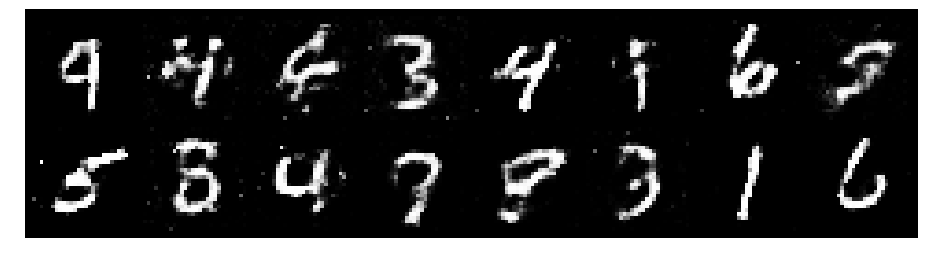

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.1953, Generator Loss: 1.0406
D(x): 0.5604, D(G(z)): 0.3991


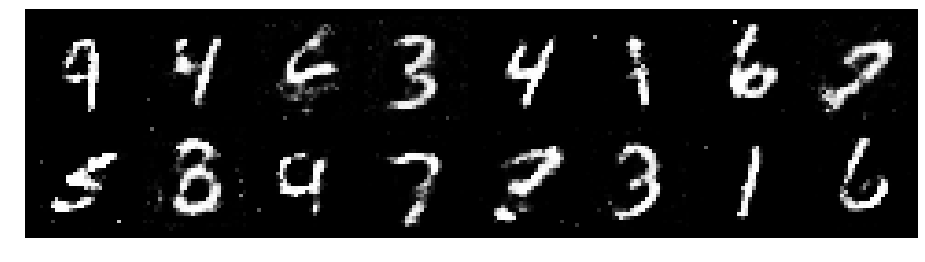

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2107, Generator Loss: 0.9930
D(x): 0.5547, D(G(z)): 0.4140


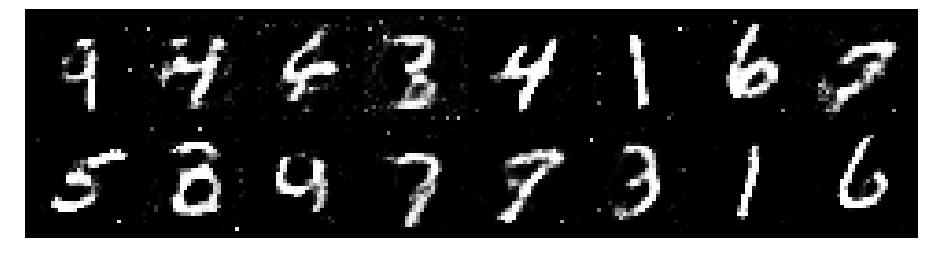

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.3659, Generator Loss: 0.9038
D(x): 0.5022, D(G(z)): 0.4494


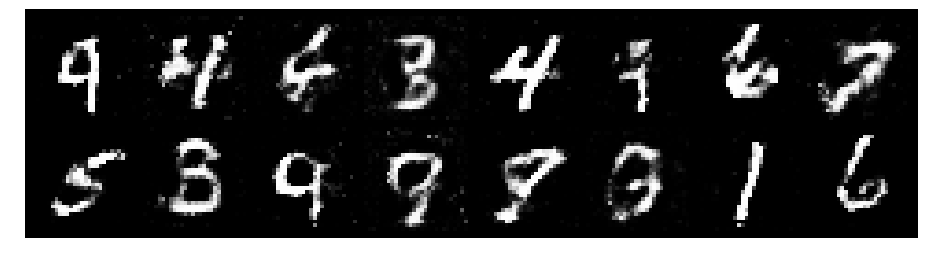

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.3938, Generator Loss: 0.8742
D(x): 0.5214, D(G(z)): 0.4572


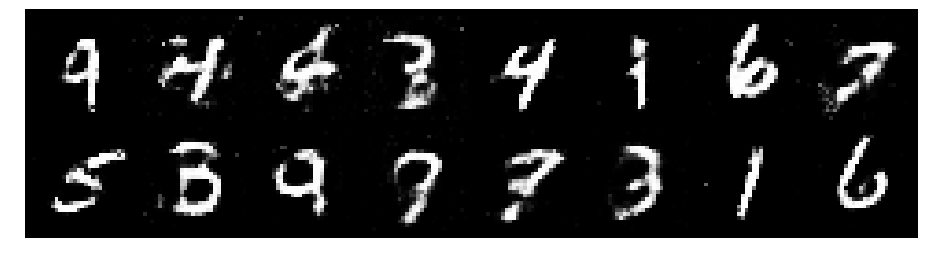

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2958, Generator Loss: 1.0654
D(x): 0.5629, D(G(z)): 0.4192


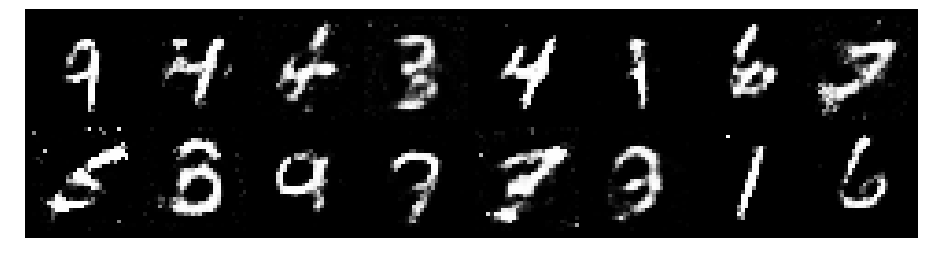

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.2339, Generator Loss: 1.0017
D(x): 0.5896, D(G(z)): 0.4344


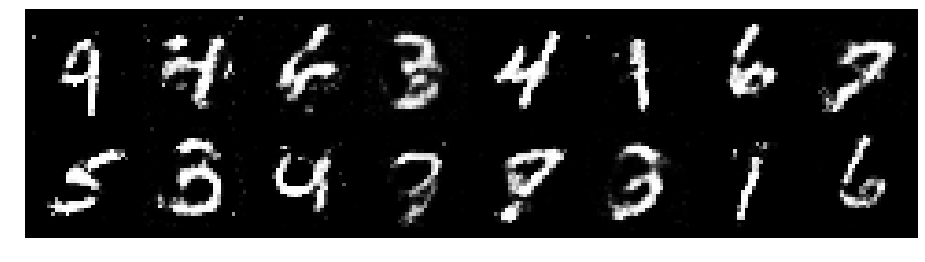

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.3483, Generator Loss: 0.9222
D(x): 0.5161, D(G(z)): 0.4299


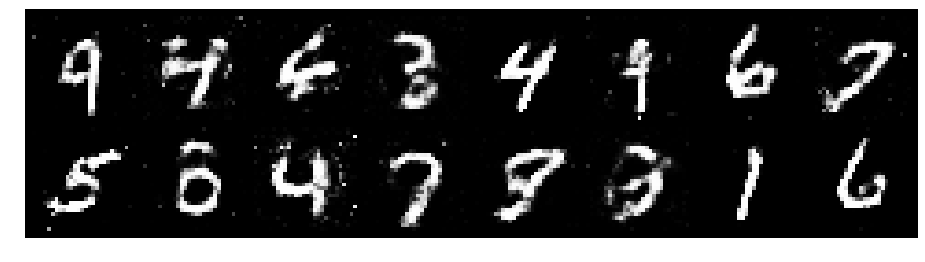

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.3253, Generator Loss: 0.9088
D(x): 0.5373, D(G(z)): 0.4398


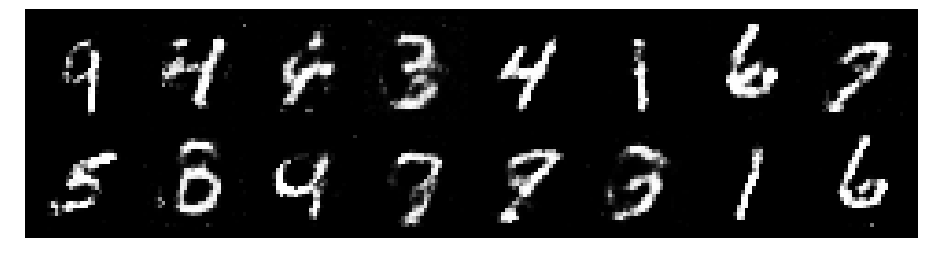

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.1513, Generator Loss: 1.1608
D(x): 0.5840, D(G(z)): 0.3814


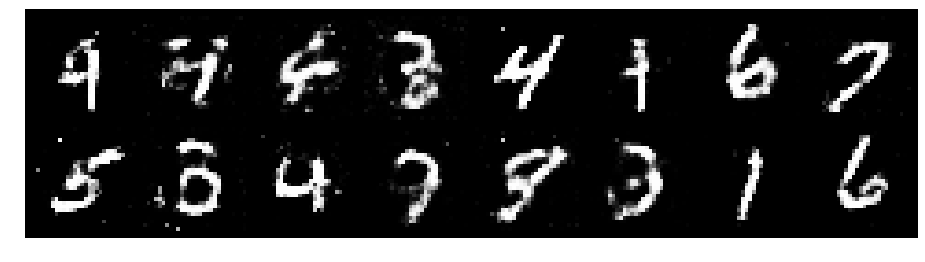

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.2357, Generator Loss: 1.0762
D(x): 0.5858, D(G(z)): 0.4278


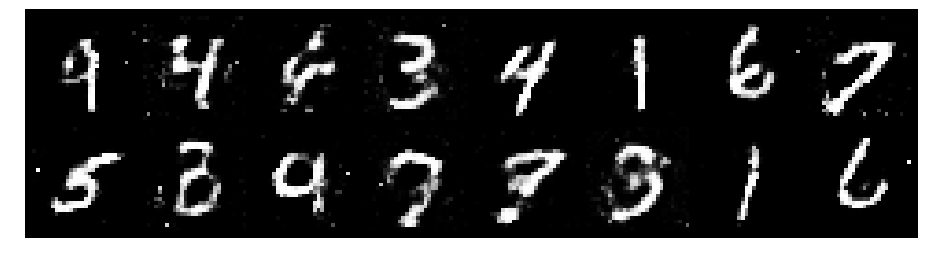

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.1692, Generator Loss: 0.8589
D(x): 0.6056, D(G(z)): 0.4511


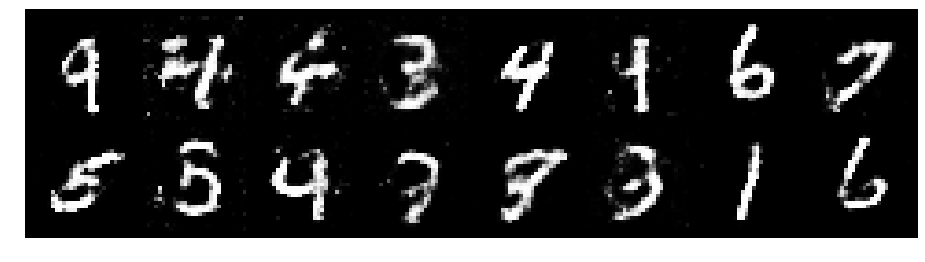

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2264, Generator Loss: 0.8989
D(x): 0.6014, D(G(z)): 0.4549


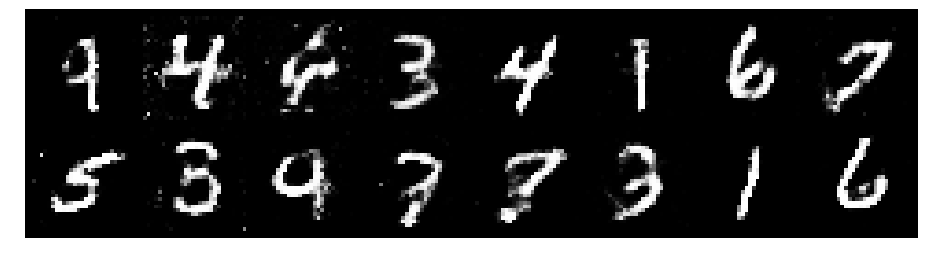

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2911, Generator Loss: 1.0074
D(x): 0.5579, D(G(z)): 0.4343


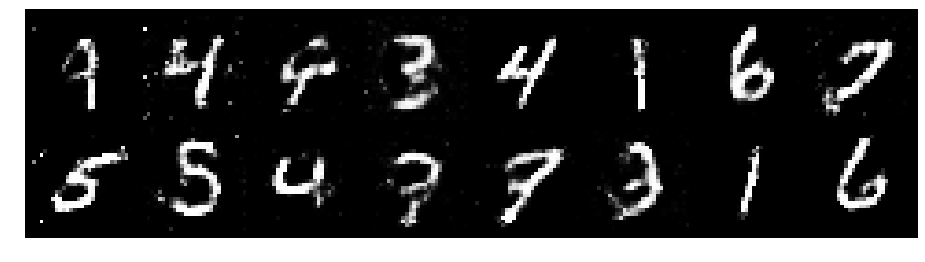

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2945, Generator Loss: 0.9889
D(x): 0.5524, D(G(z)): 0.4335


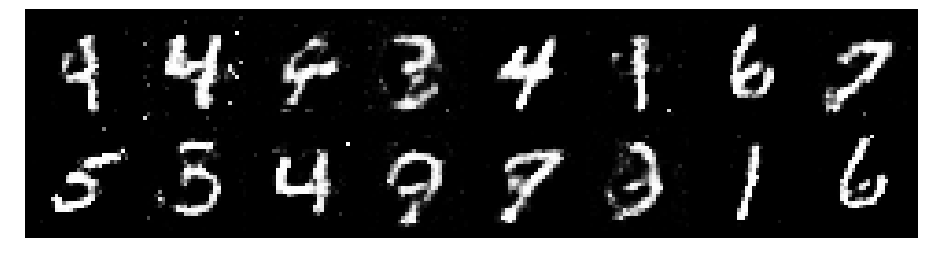

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.3044, Generator Loss: 0.7763
D(x): 0.5959, D(G(z)): 0.4765


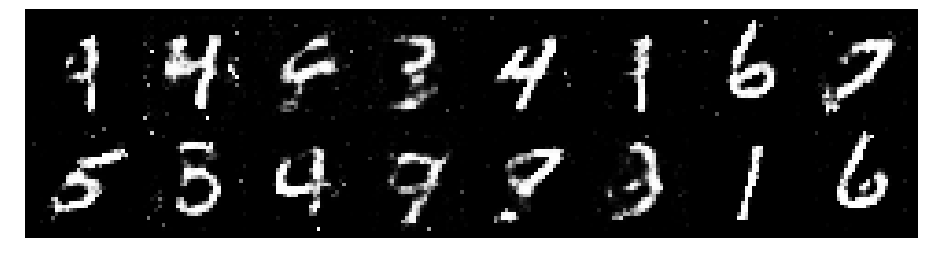

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.1809, Generator Loss: 0.8465
D(x): 0.6264, D(G(z)): 0.4439


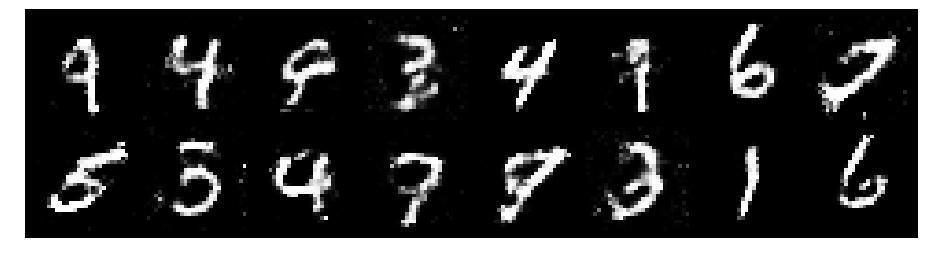

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.4473, Generator Loss: 1.0217
D(x): 0.5252, D(G(z)): 0.4556


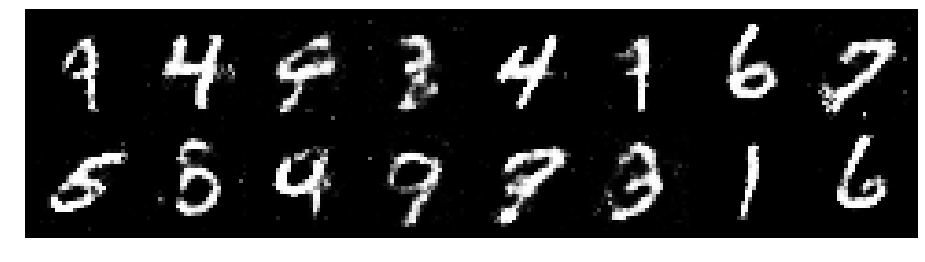

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.3363, Generator Loss: 0.7990
D(x): 0.6006, D(G(z)): 0.4931


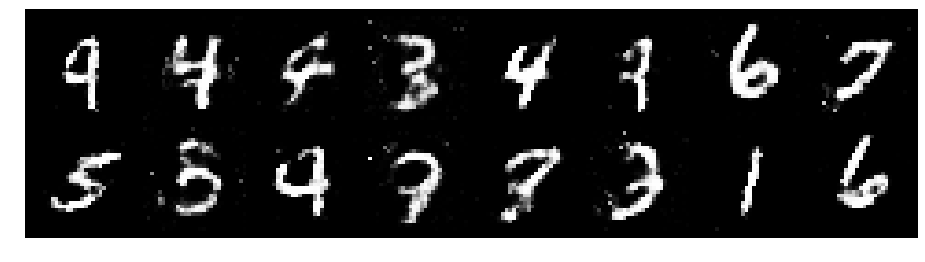

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2773, Generator Loss: 1.1079
D(x): 0.5597, D(G(z)): 0.4054


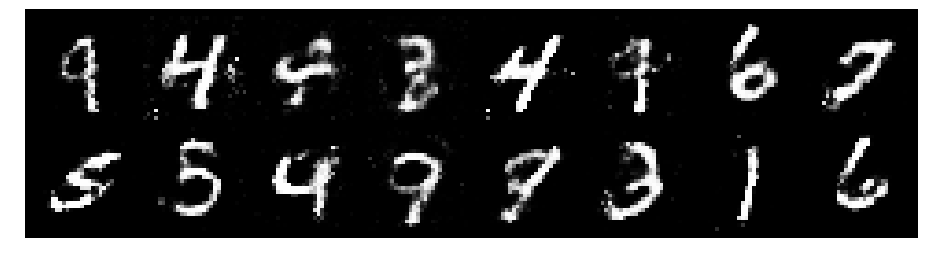

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.3084, Generator Loss: 0.9090
D(x): 0.5917, D(G(z)): 0.4633


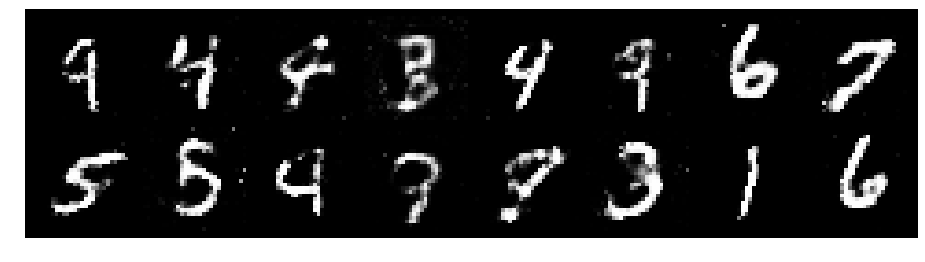

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.3287, Generator Loss: 0.9718
D(x): 0.5347, D(G(z)): 0.4493


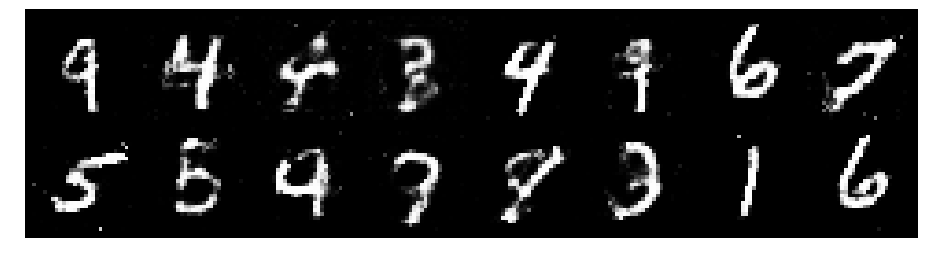

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2054, Generator Loss: 0.9771
D(x): 0.5554, D(G(z)): 0.3959


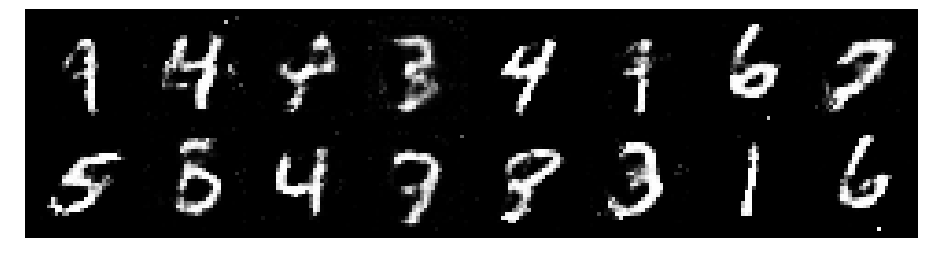

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2270, Generator Loss: 1.2110
D(x): 0.5787, D(G(z)): 0.4066


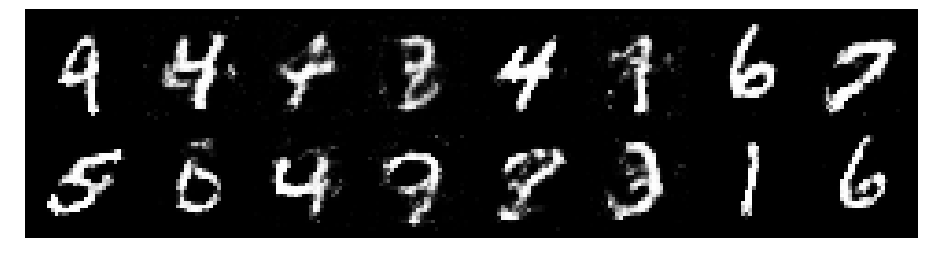

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2175, Generator Loss: 0.9371
D(x): 0.5745, D(G(z)): 0.4264


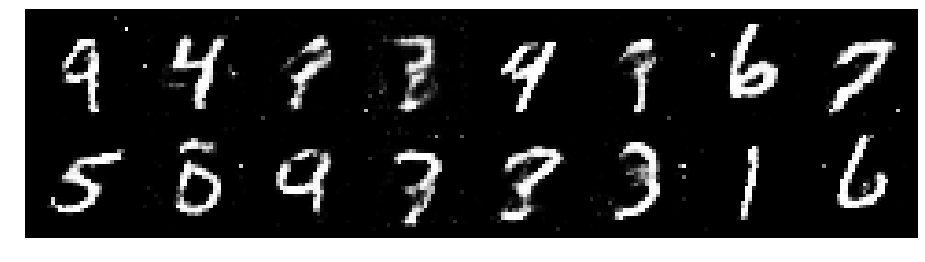

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.3366, Generator Loss: 0.8061
D(x): 0.5710, D(G(z)): 0.4879


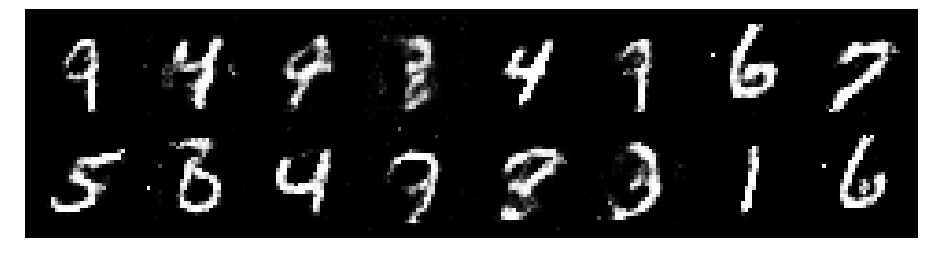

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2371, Generator Loss: 0.8791
D(x): 0.5569, D(G(z)): 0.4308


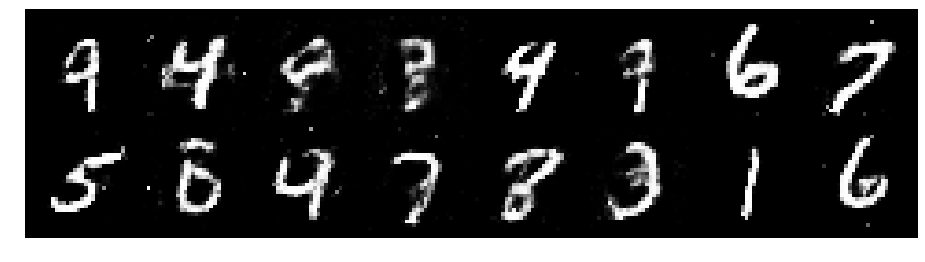

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2535, Generator Loss: 1.0514
D(x): 0.5267, D(G(z)): 0.4173


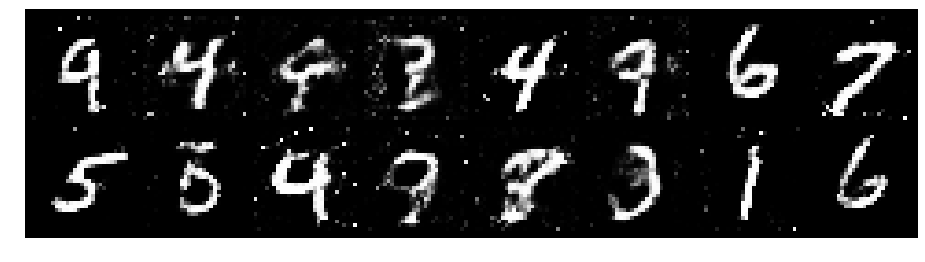

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.3439, Generator Loss: 0.9124
D(x): 0.4879, D(G(z)): 0.4172


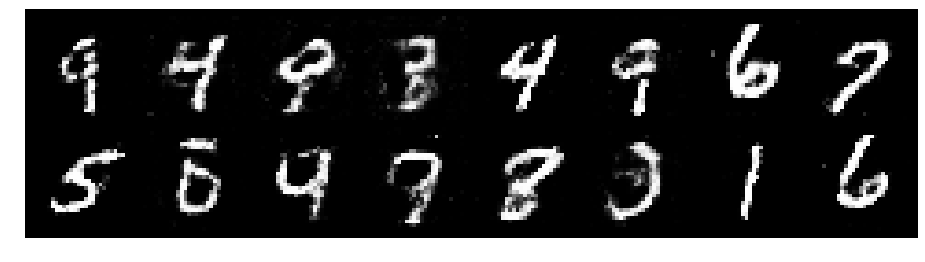

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.0873, Generator Loss: 1.2685
D(x): 0.6328, D(G(z)): 0.3767


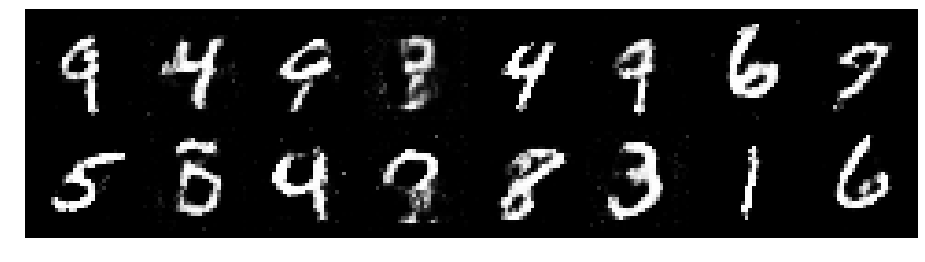

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.3149, Generator Loss: 0.8249
D(x): 0.5285, D(G(z)): 0.4504


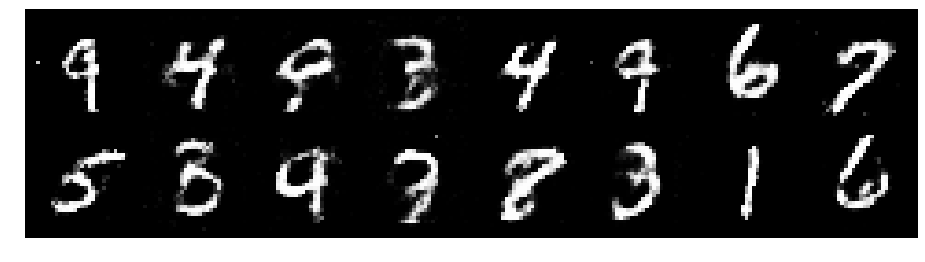

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.2136, Generator Loss: 0.8478
D(x): 0.5467, D(G(z)): 0.4215


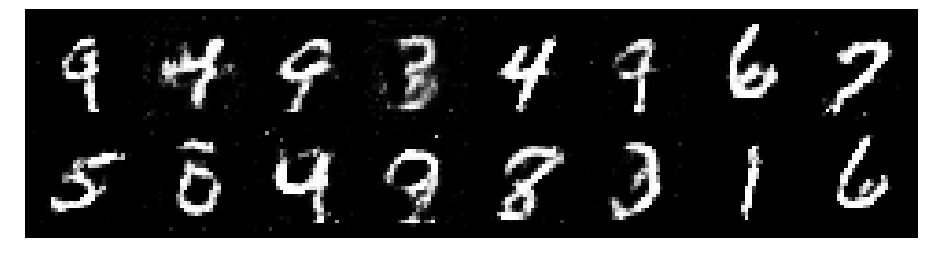

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.3429, Generator Loss: 1.0024
D(x): 0.5419, D(G(z)): 0.4496


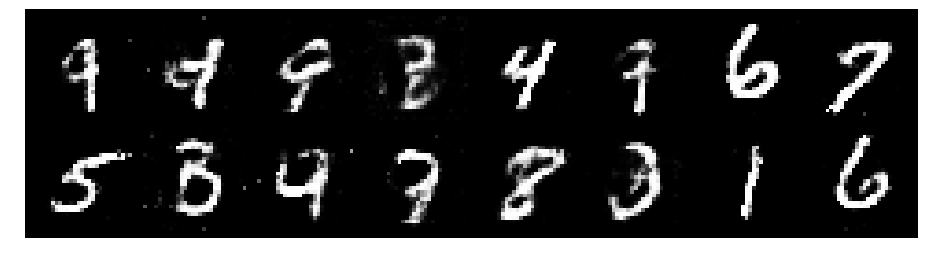

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2398, Generator Loss: 0.8882
D(x): 0.5511, D(G(z)): 0.4200


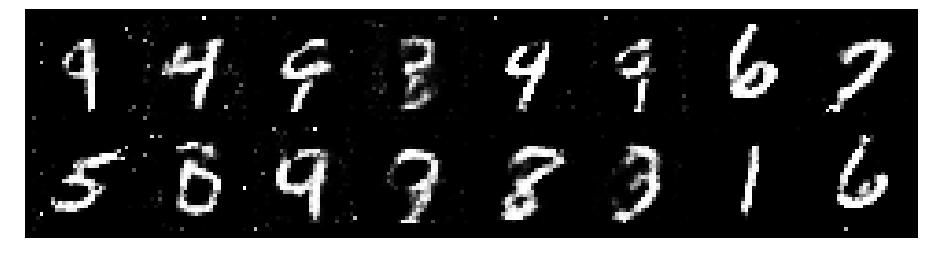

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2858, Generator Loss: 0.8540
D(x): 0.5446, D(G(z)): 0.4399


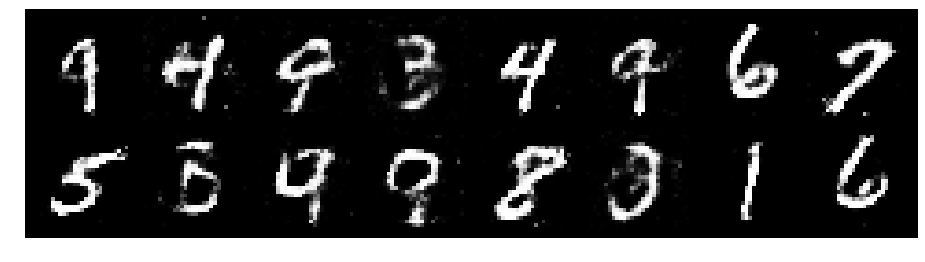

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2403, Generator Loss: 0.9384
D(x): 0.5948, D(G(z)): 0.4429


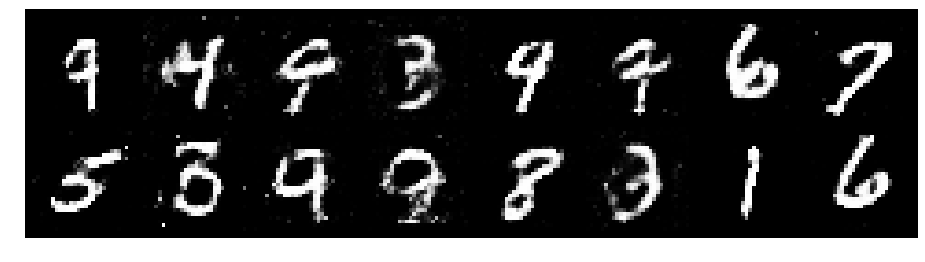

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2475, Generator Loss: 0.8520
D(x): 0.5646, D(G(z)): 0.4416


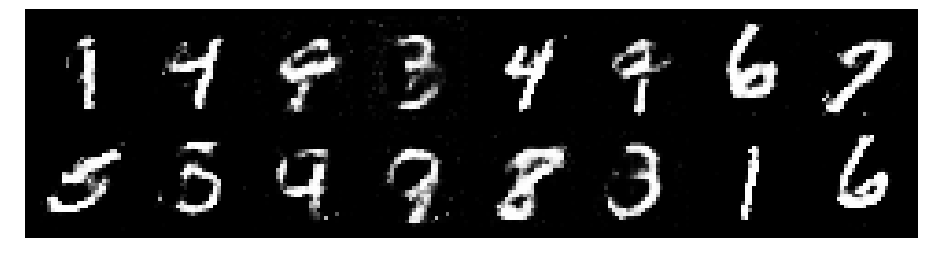

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.2381, Generator Loss: 0.8553
D(x): 0.5946, D(G(z)): 0.4661


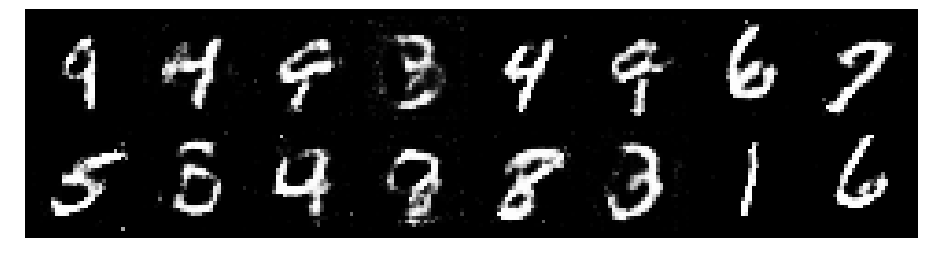

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.1755, Generator Loss: 1.2096
D(x): 0.5952, D(G(z)): 0.4150


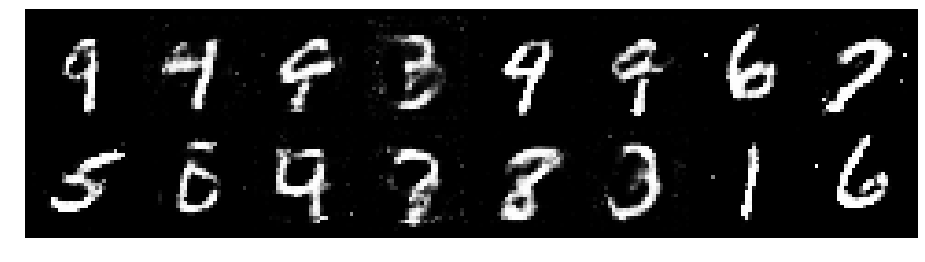

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.0736, Generator Loss: 1.0936
D(x): 0.6246, D(G(z)): 0.3816


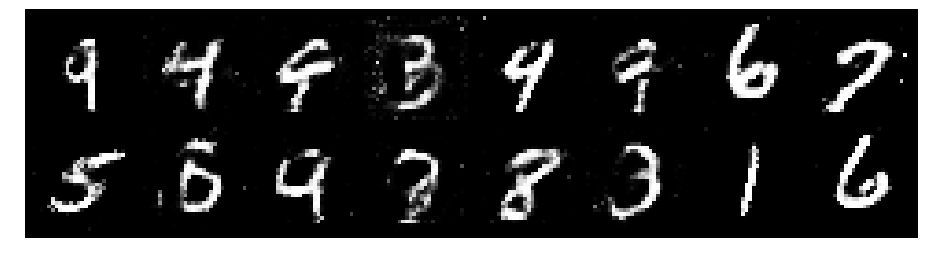

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.1057, Generator Loss: 1.1095
D(x): 0.6344, D(G(z)): 0.4085


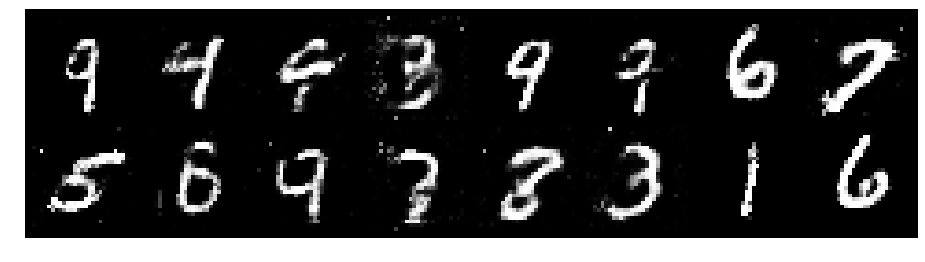

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2154, Generator Loss: 1.0304
D(x): 0.6177, D(G(z)): 0.4508


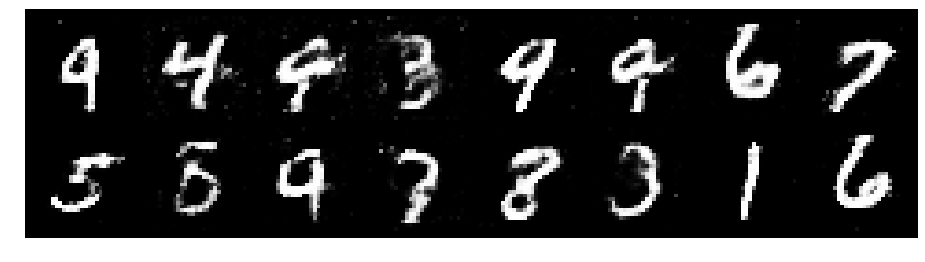

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.1150, Generator Loss: 1.0683
D(x): 0.6535, D(G(z)): 0.4108


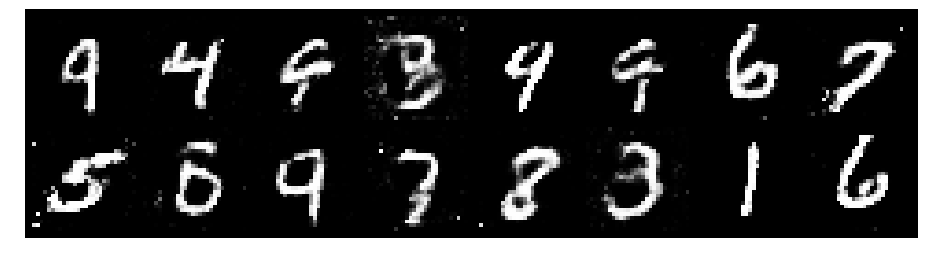

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.1084, Generator Loss: 1.0465
D(x): 0.5584, D(G(z)): 0.3550


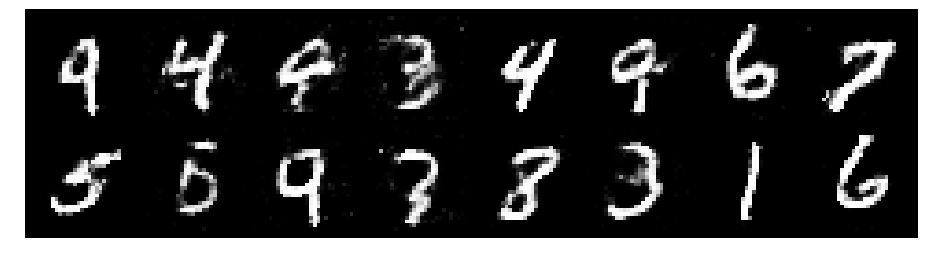

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2358, Generator Loss: 0.8552
D(x): 0.5867, D(G(z)): 0.4472


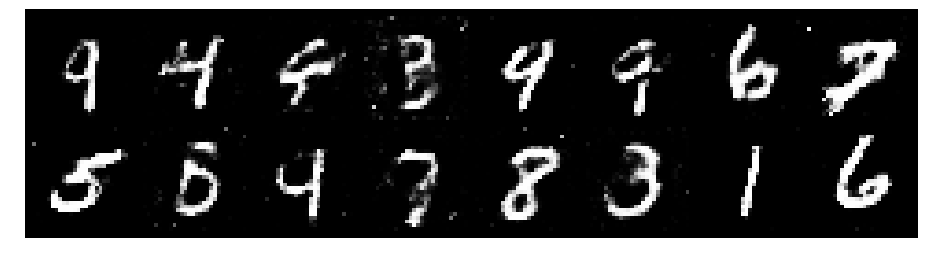

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.1851, Generator Loss: 1.0625
D(x): 0.5348, D(G(z)): 0.3731


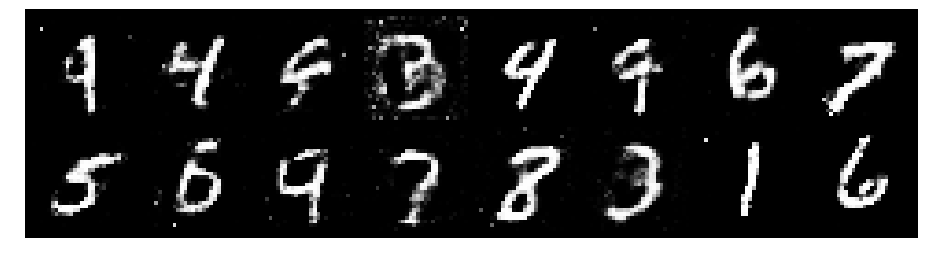

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2731, Generator Loss: 0.9256
D(x): 0.5277, D(G(z)): 0.4237


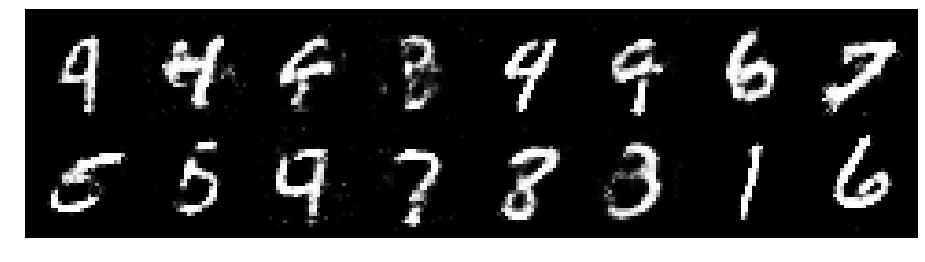

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.1850, Generator Loss: 1.0768
D(x): 0.5665, D(G(z)): 0.3946


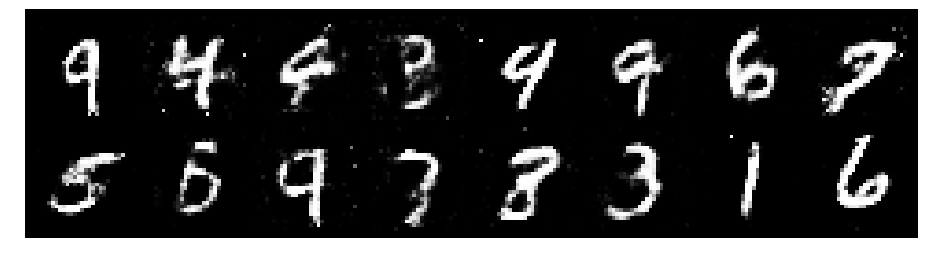

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2397, Generator Loss: 1.0027
D(x): 0.5318, D(G(z)): 0.3933


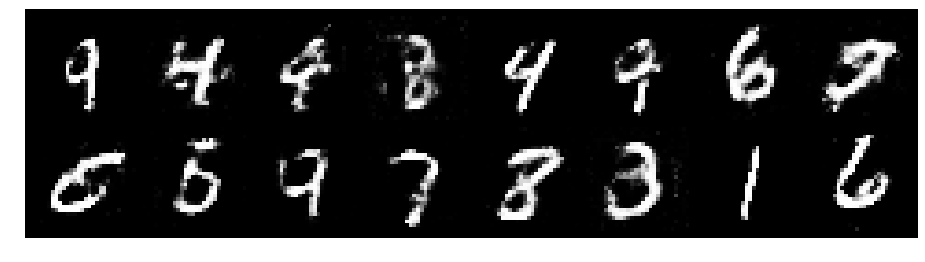

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.1237, Generator Loss: 0.9803
D(x): 0.5744, D(G(z)): 0.3889


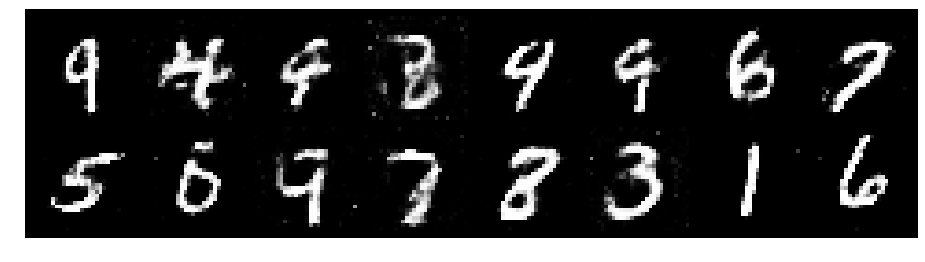

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.1783, Generator Loss: 1.1267
D(x): 0.5462, D(G(z)): 0.3608


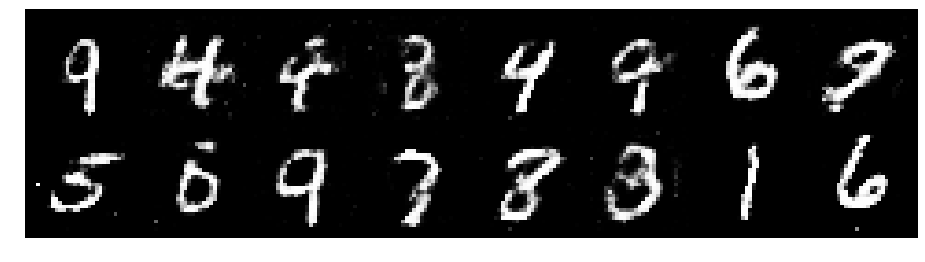

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.3249, Generator Loss: 0.9953
D(x): 0.5324, D(G(z)): 0.4436


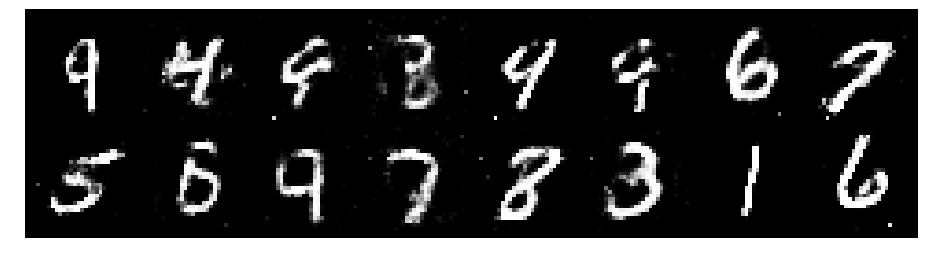

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.3063, Generator Loss: 1.0018
D(x): 0.5450, D(G(z)): 0.4210


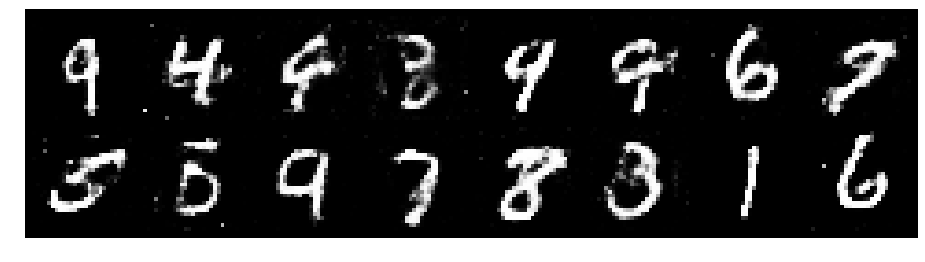

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.2652, Generator Loss: 0.9959
D(x): 0.6074, D(G(z)): 0.4433


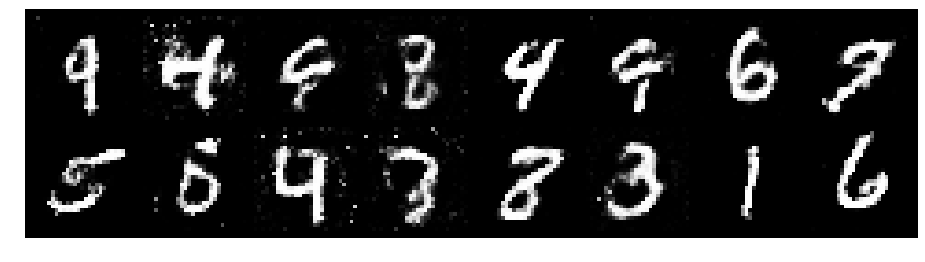

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.1128, Generator Loss: 1.0009
D(x): 0.6345, D(G(z)): 0.4193


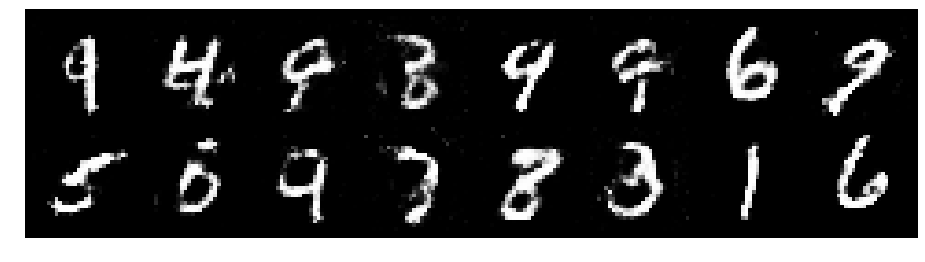

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.0898, Generator Loss: 1.0500
D(x): 0.6127, D(G(z)): 0.3810


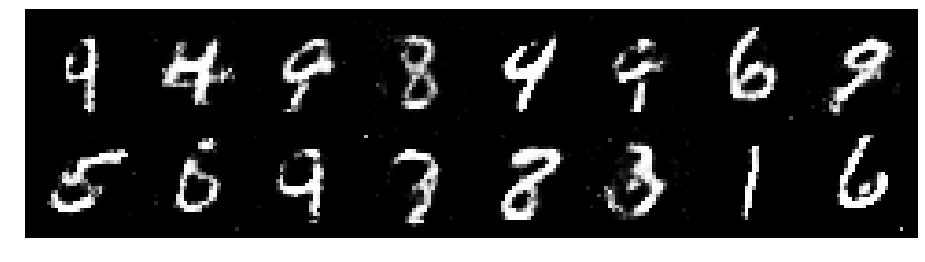

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.3221, Generator Loss: 0.7260
D(x): 0.6111, D(G(z)): 0.5294


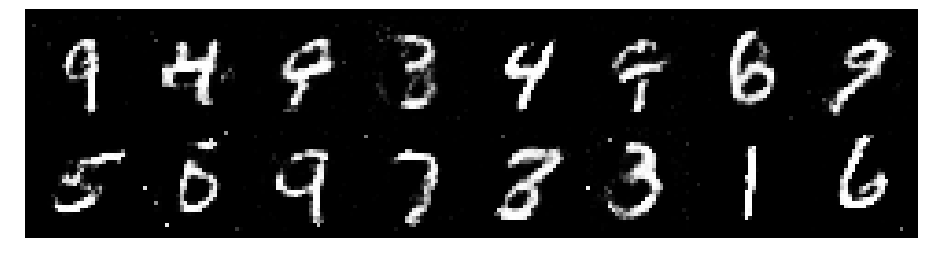

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.1888, Generator Loss: 0.9426
D(x): 0.5910, D(G(z)): 0.4299


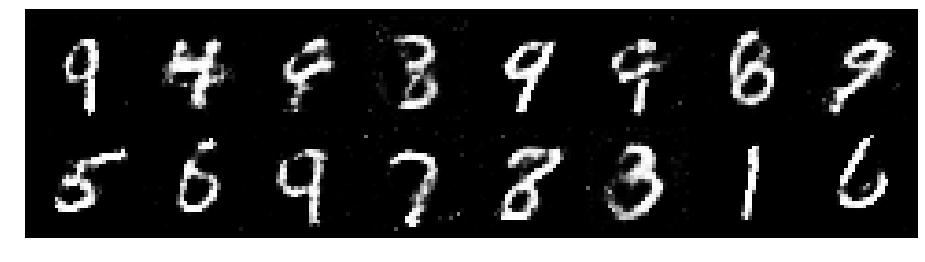

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.2236, Generator Loss: 0.9592
D(x): 0.5664, D(G(z)): 0.4238


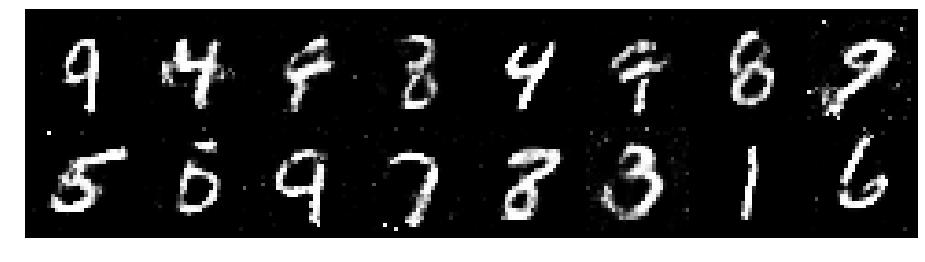

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.2632, Generator Loss: 0.9920
D(x): 0.5482, D(G(z)): 0.4308


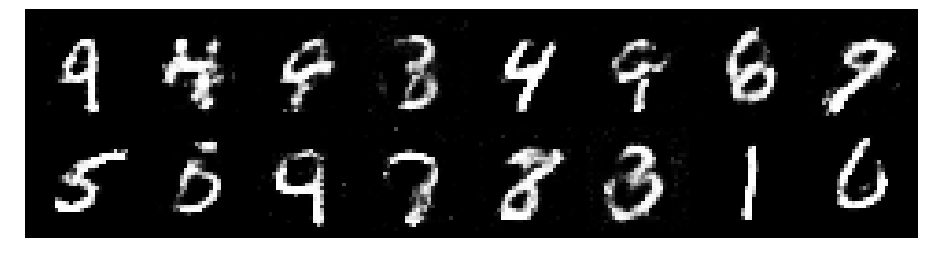

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.2092, Generator Loss: 0.9774
D(x): 0.5775, D(G(z)): 0.4146


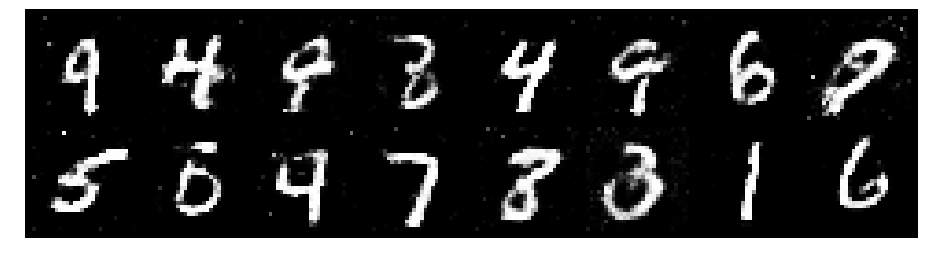

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2463, Generator Loss: 0.8567
D(x): 0.5956, D(G(z)): 0.4711


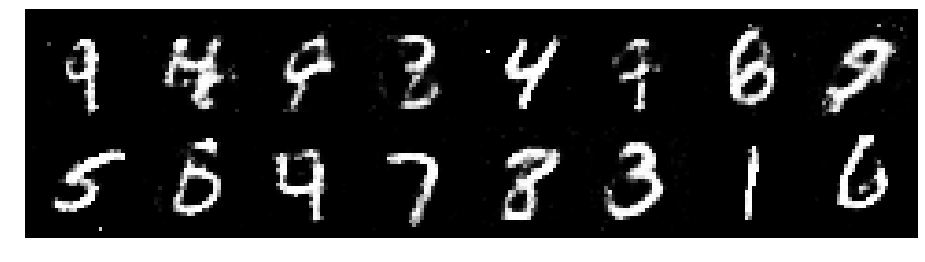

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.1997, Generator Loss: 0.9731
D(x): 0.5831, D(G(z)): 0.4154


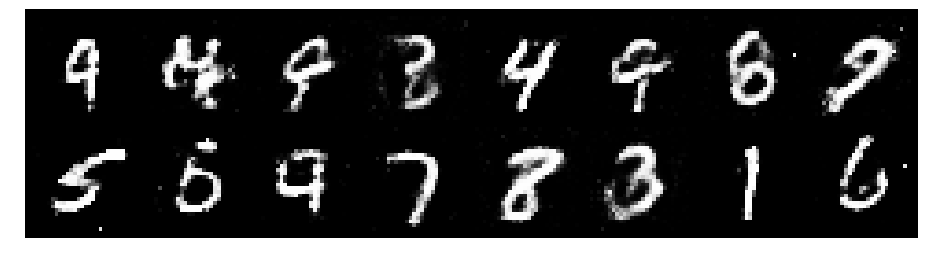

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2171, Generator Loss: 0.8962
D(x): 0.5760, D(G(z)): 0.4489


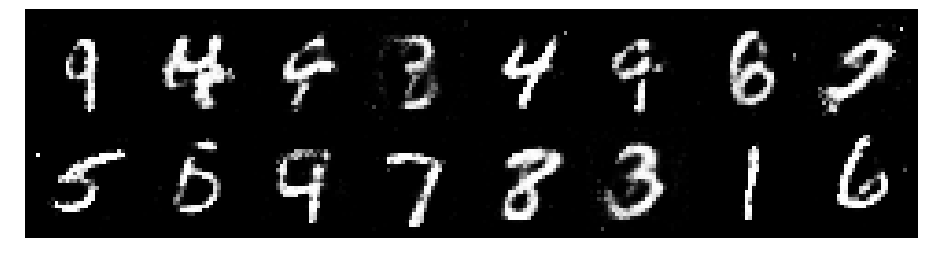

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2161, Generator Loss: 0.7986
D(x): 0.6029, D(G(z)): 0.4687


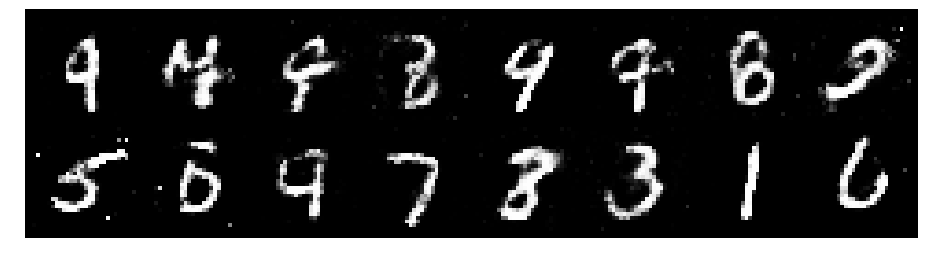

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.1724, Generator Loss: 0.9358
D(x): 0.5787, D(G(z)): 0.4121


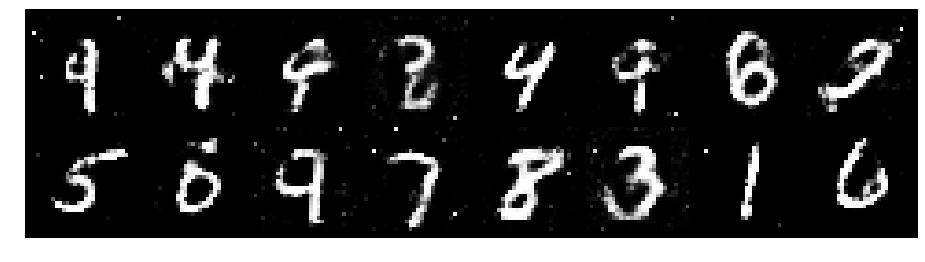

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.3016, Generator Loss: 1.0185
D(x): 0.5499, D(G(z)): 0.4284


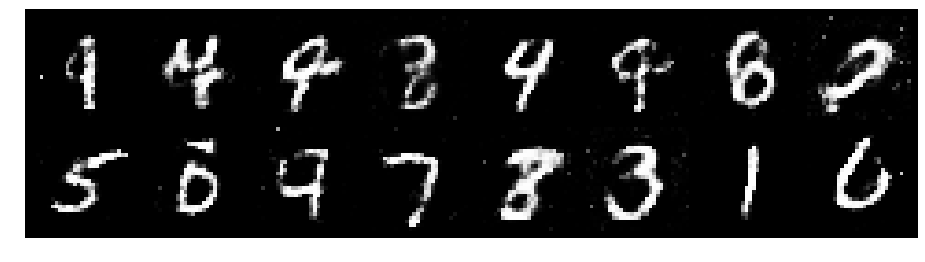

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.2135, Generator Loss: 0.8830
D(x): 0.6125, D(G(z)): 0.4625


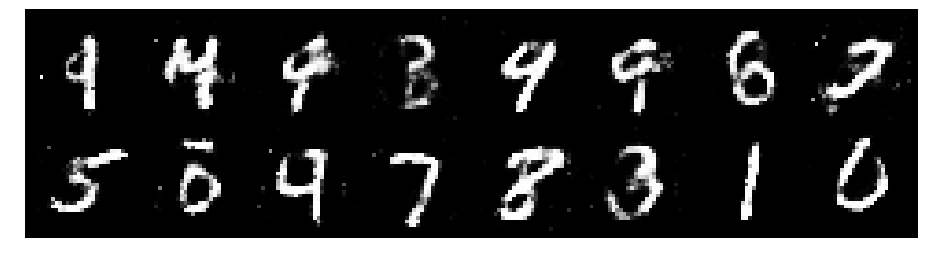

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.1517, Generator Loss: 1.1179
D(x): 0.5721, D(G(z)): 0.3889


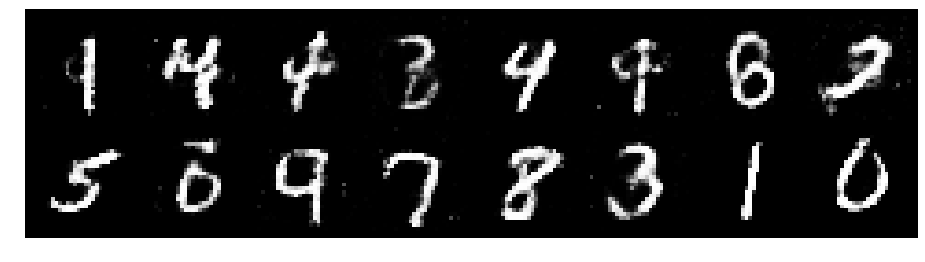

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2151, Generator Loss: 0.9579
D(x): 0.5326, D(G(z)): 0.3810


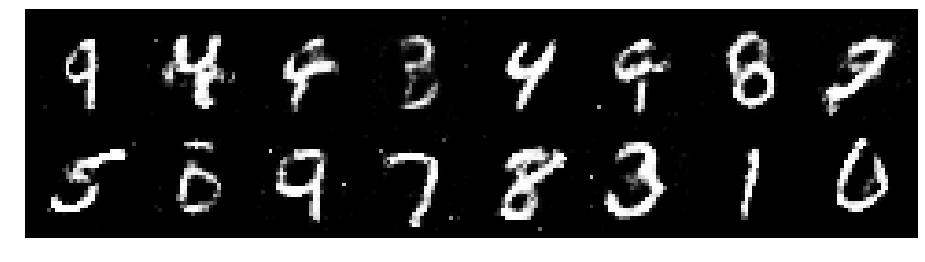

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.3257, Generator Loss: 0.9811
D(x): 0.5320, D(G(z)): 0.4361


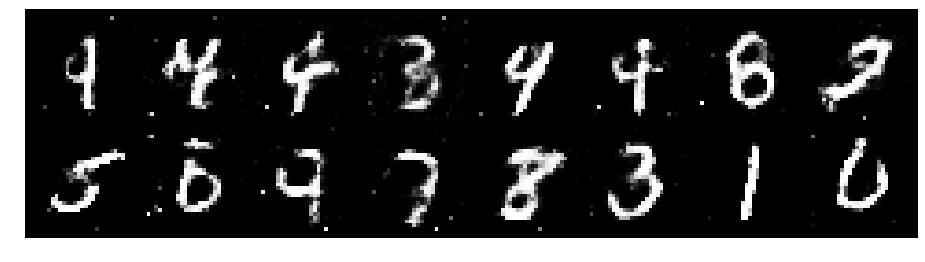

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.3099, Generator Loss: 0.8902
D(x): 0.5734, D(G(z)): 0.4484


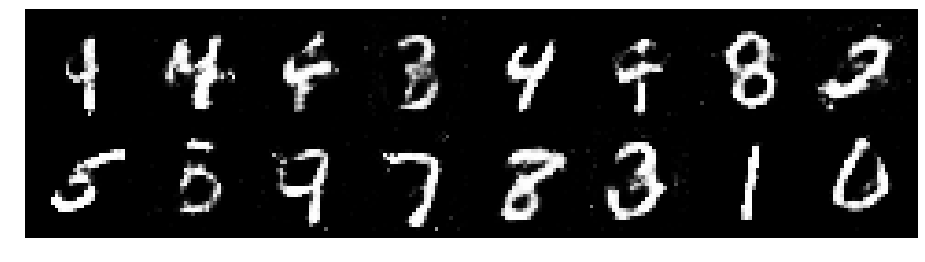

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.0761, Generator Loss: 1.0462
D(x): 0.6009, D(G(z)): 0.3685


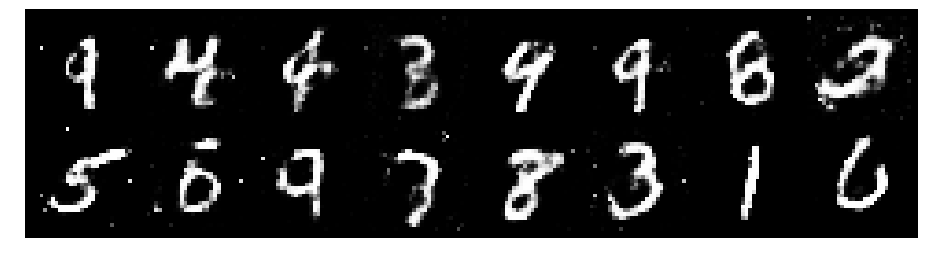

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.2031, Generator Loss: 1.0292
D(x): 0.5566, D(G(z)): 0.3987


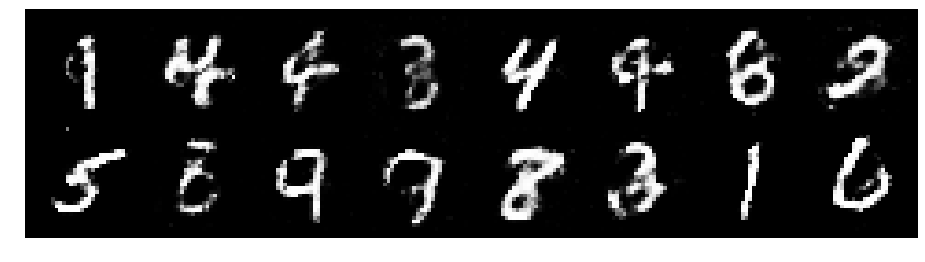

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.1809, Generator Loss: 0.9341
D(x): 0.5998, D(G(z)): 0.4401


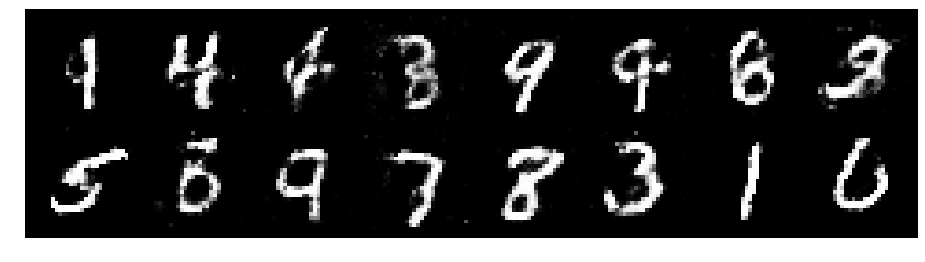

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2463, Generator Loss: 0.8780
D(x): 0.6195, D(G(z)): 0.4713


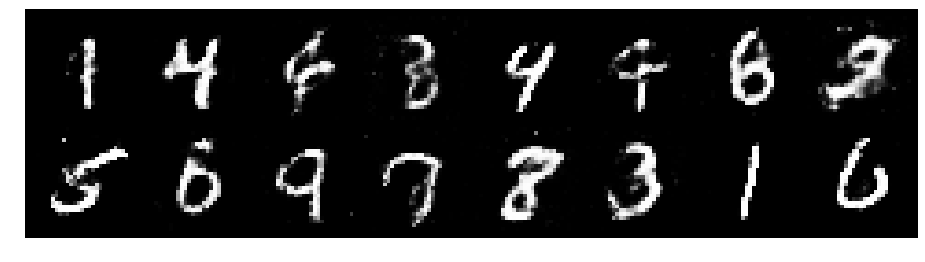

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2486, Generator Loss: 0.9374
D(x): 0.5603, D(G(z)): 0.4293


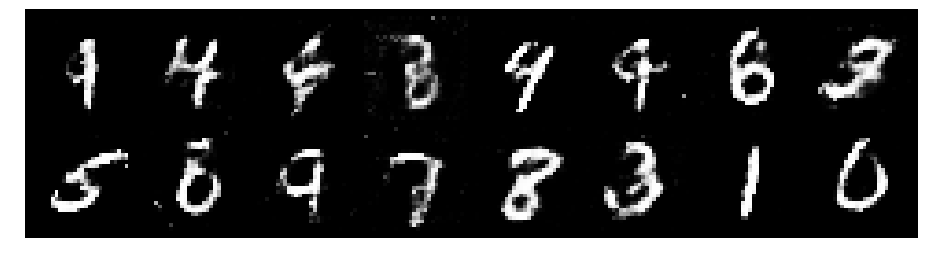

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.2712, Generator Loss: 1.0231
D(x): 0.5359, D(G(z)): 0.4025


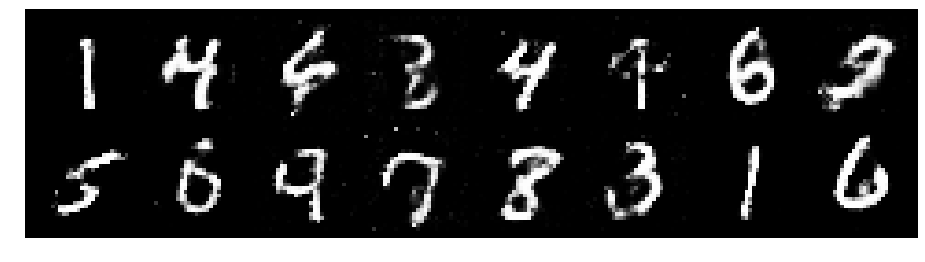

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2902, Generator Loss: 0.9099
D(x): 0.5721, D(G(z)): 0.4510


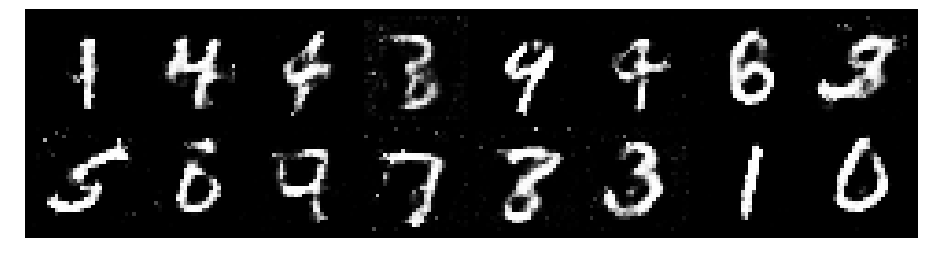

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.3036, Generator Loss: 0.8569
D(x): 0.5487, D(G(z)): 0.4561


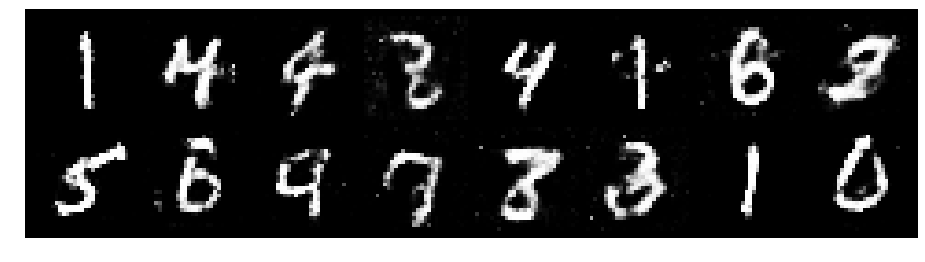

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.1515, Generator Loss: 0.9018
D(x): 0.5784, D(G(z)): 0.4071


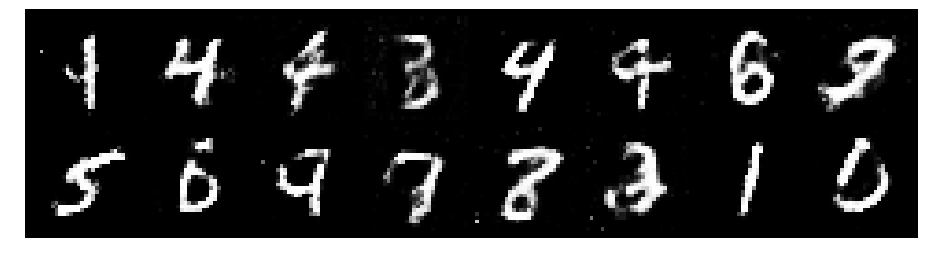

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.4158, Generator Loss: 0.7859
D(x): 0.5341, D(G(z)): 0.4721


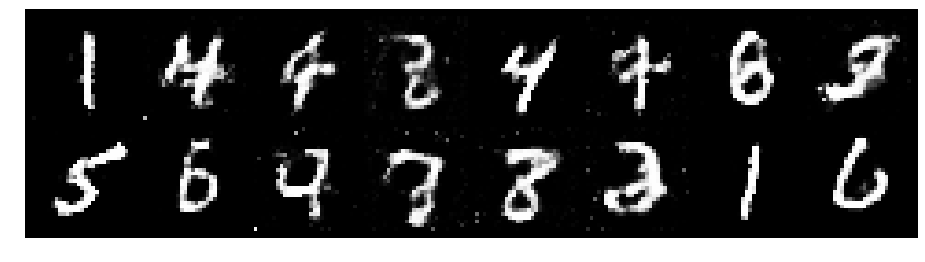

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.3144, Generator Loss: 0.8967
D(x): 0.5558, D(G(z)): 0.4488


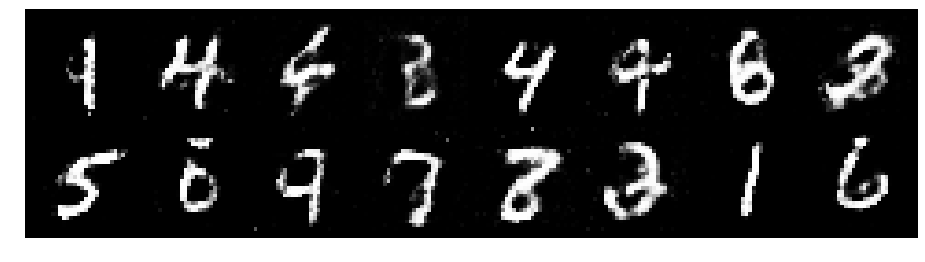

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.2648, Generator Loss: 0.8178
D(x): 0.5951, D(G(z)): 0.4913


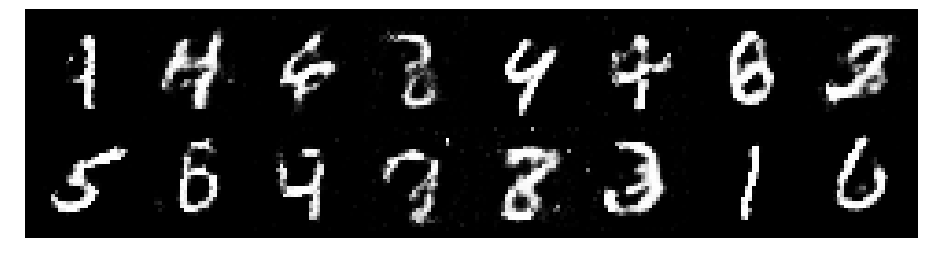

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.3837, Generator Loss: 0.7446
D(x): 0.5601, D(G(z)): 0.5147


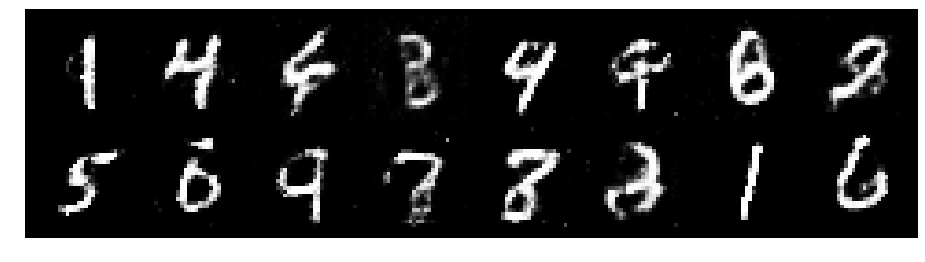

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.3602, Generator Loss: 0.8028
D(x): 0.5742, D(G(z)): 0.4992


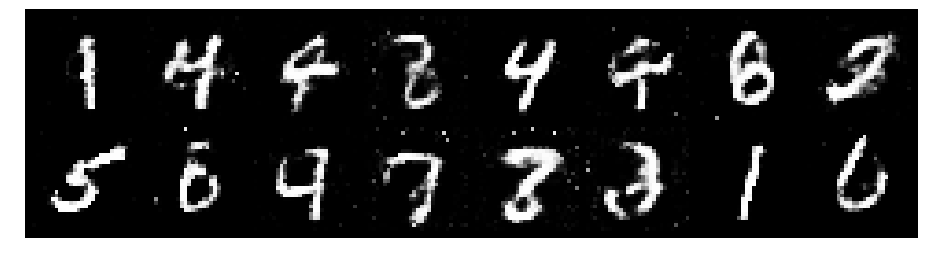

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2730, Generator Loss: 0.8220
D(x): 0.5662, D(G(z)): 0.4610


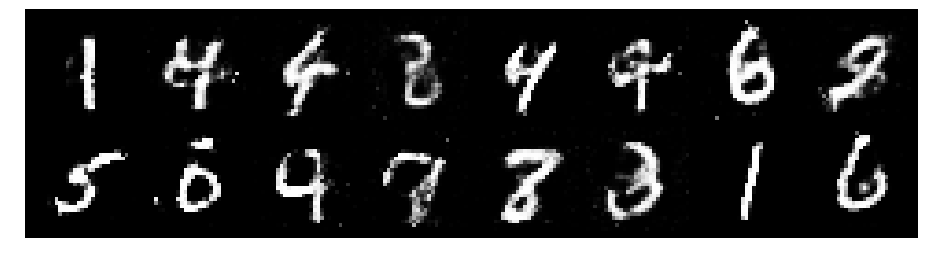

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.1453, Generator Loss: 1.1186
D(x): 0.6491, D(G(z)): 0.4363


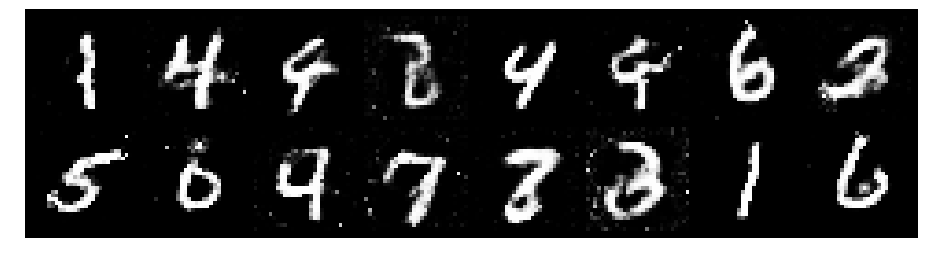

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.2713, Generator Loss: 0.8841
D(x): 0.6012, D(G(z)): 0.4724


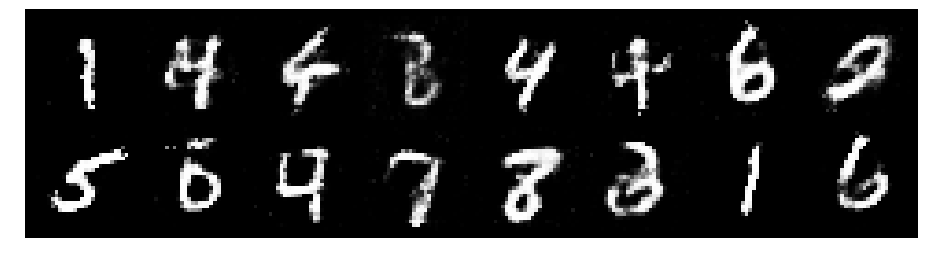

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.1573, Generator Loss: 0.9600
D(x): 0.5514, D(G(z)): 0.3783


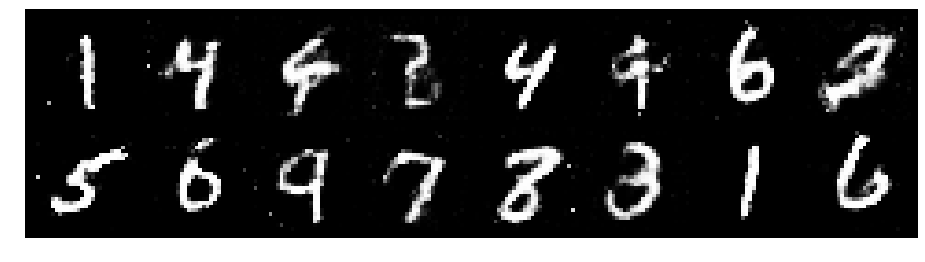

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2411, Generator Loss: 0.9111
D(x): 0.5616, D(G(z)): 0.4285


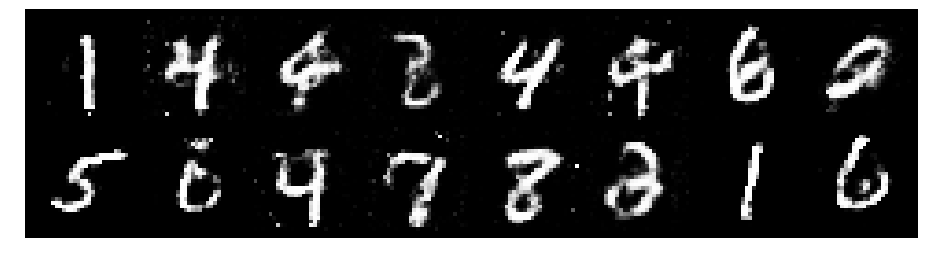

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.1797, Generator Loss: 1.0583
D(x): 0.5676, D(G(z)): 0.3634


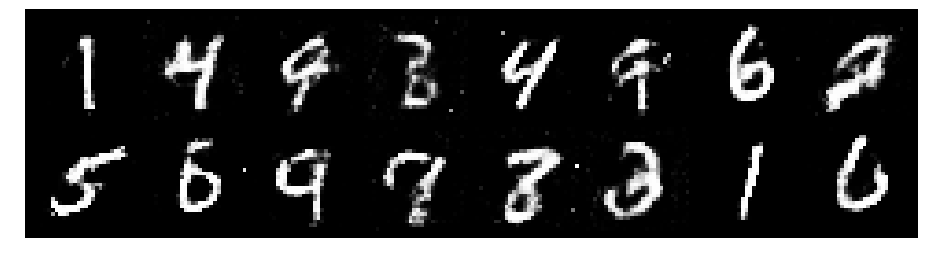

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2814, Generator Loss: 0.9636
D(x): 0.5891, D(G(z)): 0.4654


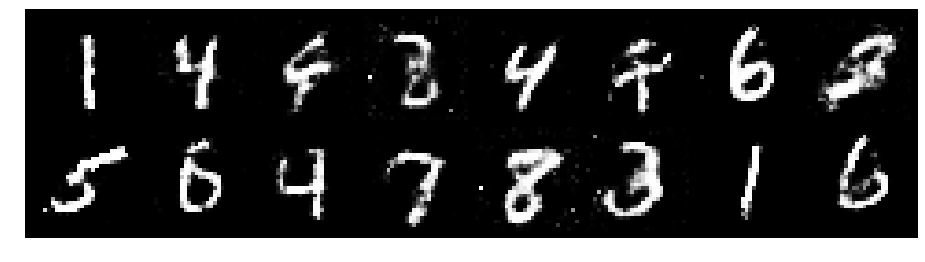

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.2336, Generator Loss: 1.0638
D(x): 0.5199, D(G(z)): 0.3923


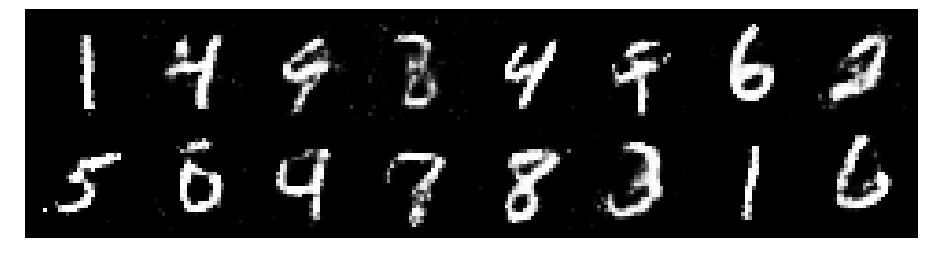

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.1571, Generator Loss: 0.9406
D(x): 0.5940, D(G(z)): 0.4206


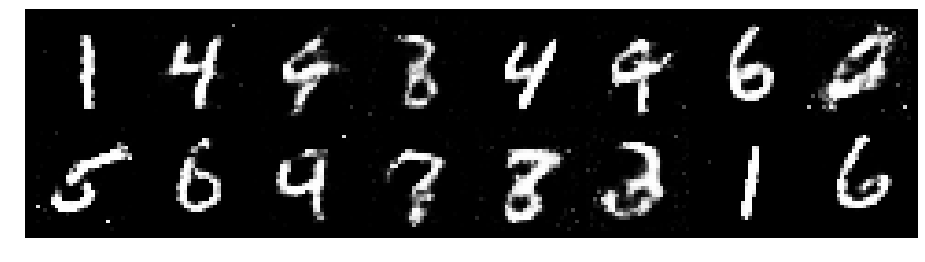

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.3458, Generator Loss: 1.0237
D(x): 0.5257, D(G(z)): 0.4383


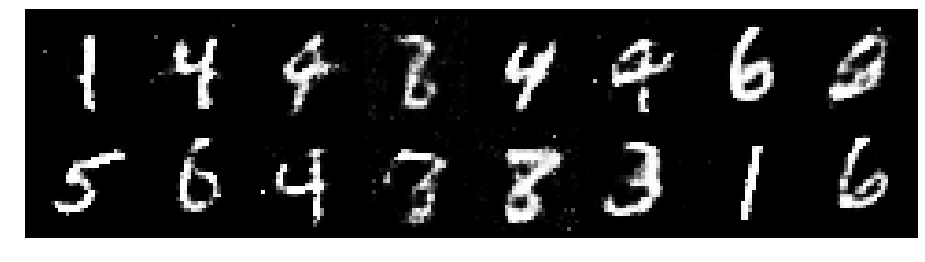

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2367, Generator Loss: 0.7964
D(x): 0.5448, D(G(z)): 0.4393


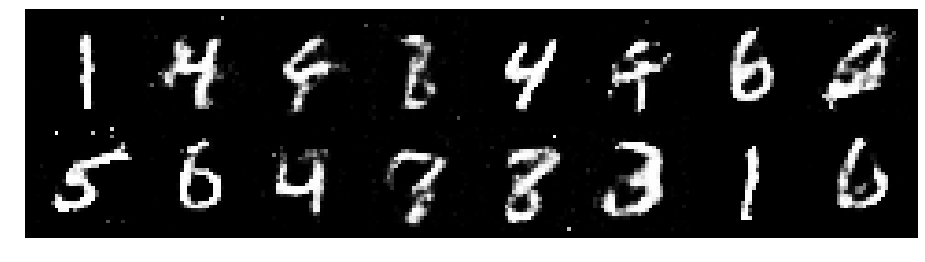

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.3444, Generator Loss: 0.9186
D(x): 0.5260, D(G(z)): 0.4367


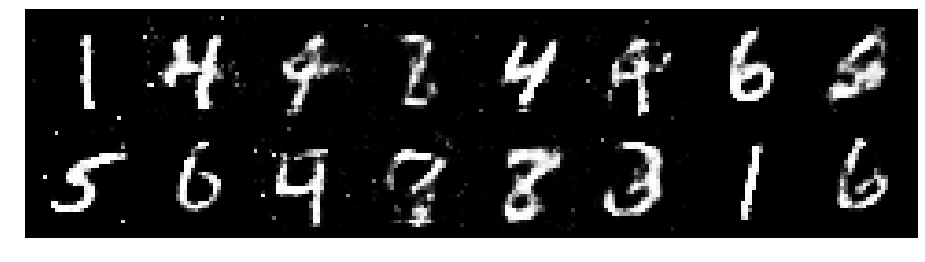

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.1877, Generator Loss: 0.9687
D(x): 0.5894, D(G(z)): 0.4240


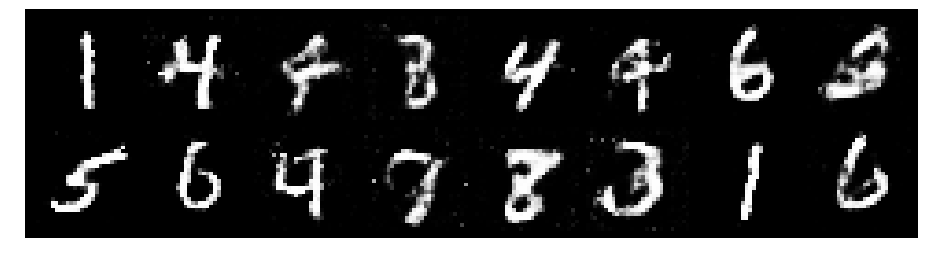

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2246, Generator Loss: 0.8622
D(x): 0.5717, D(G(z)): 0.4351


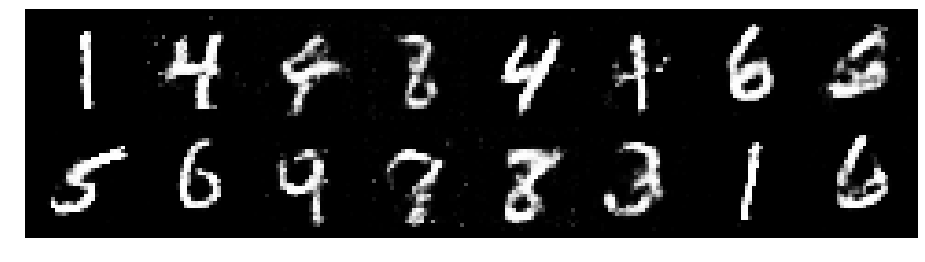

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.3723, Generator Loss: 0.8223
D(x): 0.5900, D(G(z)): 0.5112


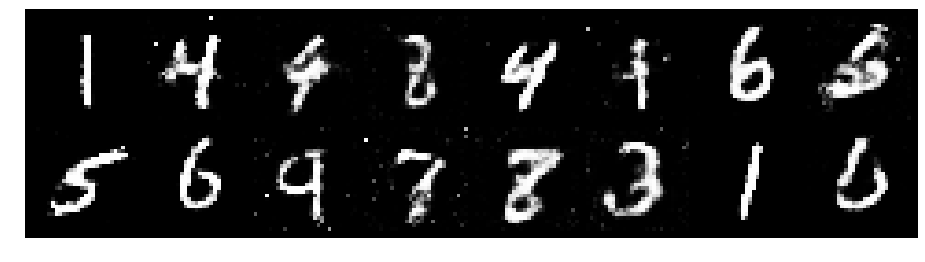

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.1141, Generator Loss: 0.9831
D(x): 0.6093, D(G(z)): 0.4049


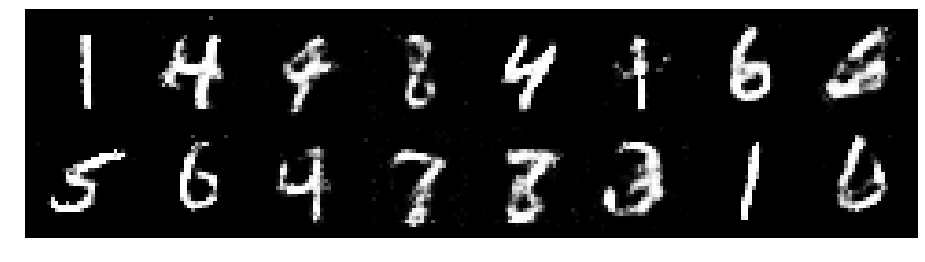

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.1840, Generator Loss: 1.0086
D(x): 0.5570, D(G(z)): 0.3792


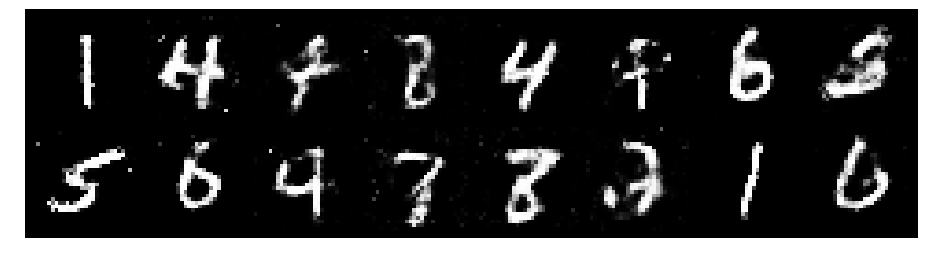

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.3122, Generator Loss: 0.8653
D(x): 0.5504, D(G(z)): 0.4602


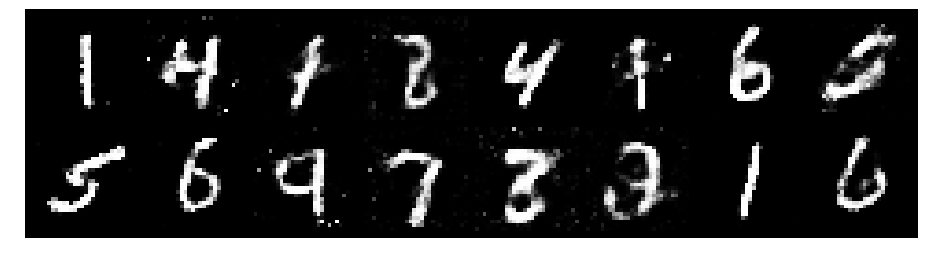

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2985, Generator Loss: 0.8275
D(x): 0.5557, D(G(z)): 0.4627


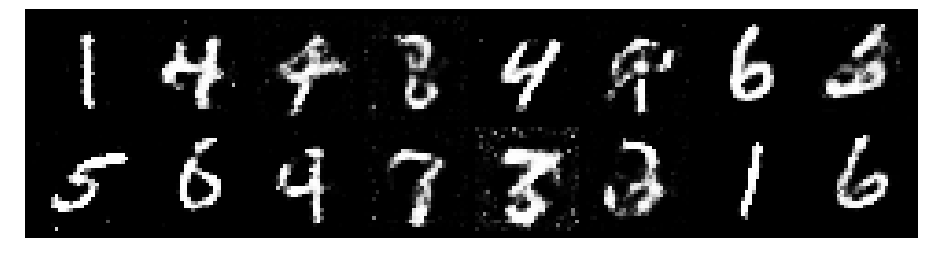

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.3001, Generator Loss: 0.8779
D(x): 0.5648, D(G(z)): 0.4752


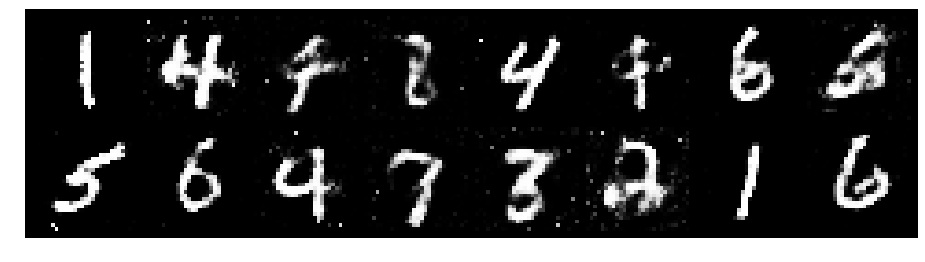

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2017, Generator Loss: 0.9628
D(x): 0.5910, D(G(z)): 0.4399


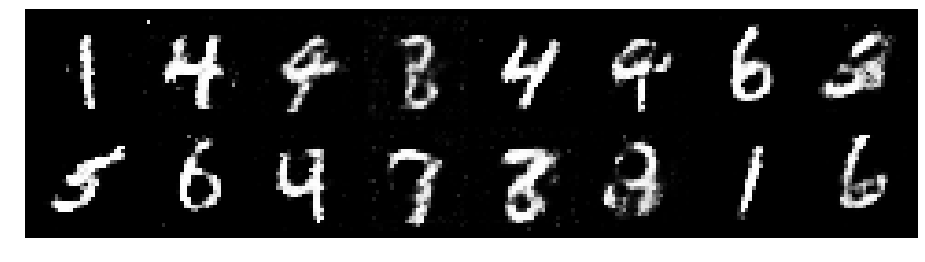

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2346, Generator Loss: 1.0247
D(x): 0.5652, D(G(z)): 0.4273


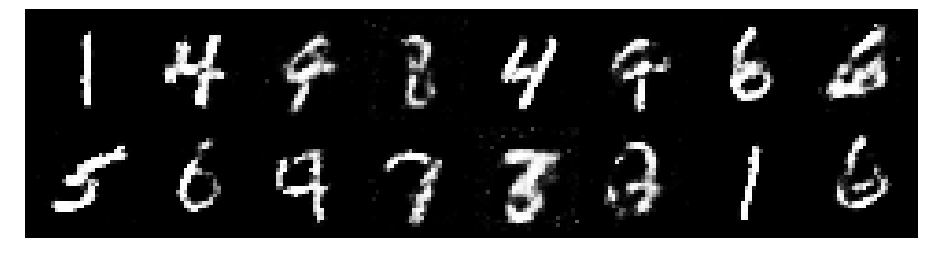

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2212, Generator Loss: 0.8353
D(x): 0.5922, D(G(z)): 0.4489


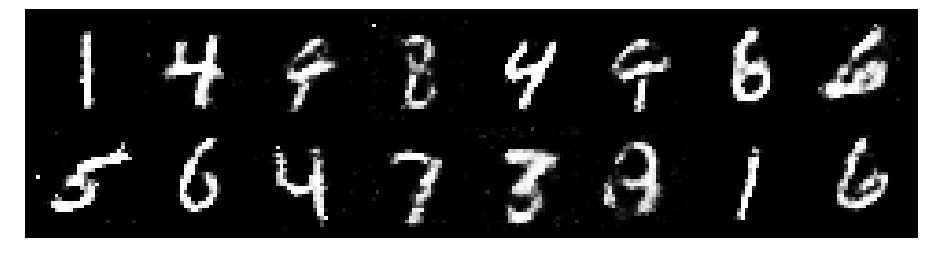

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2821, Generator Loss: 0.8431
D(x): 0.5736, D(G(z)): 0.4770


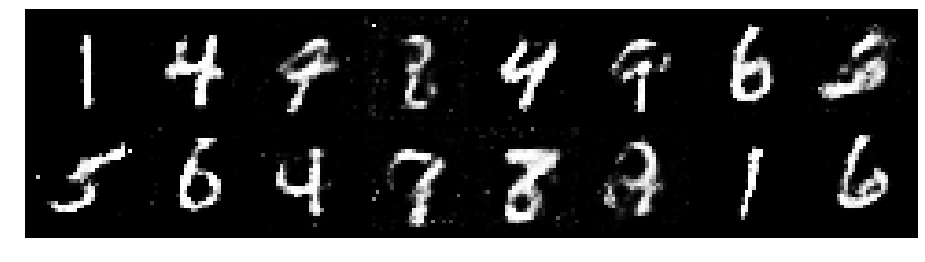

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2913, Generator Loss: 0.8454
D(x): 0.5393, D(G(z)): 0.4532


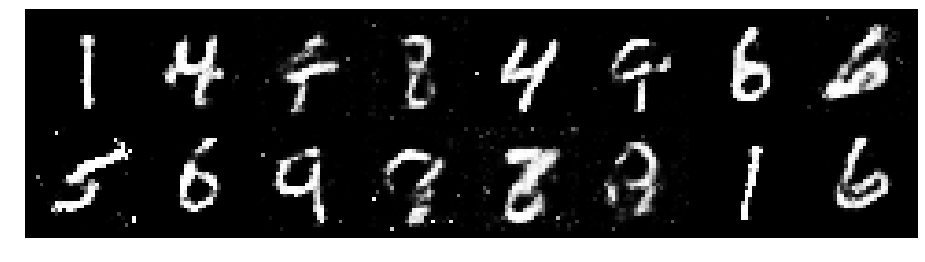

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.3017, Generator Loss: 0.9804
D(x): 0.4986, D(G(z)): 0.3913


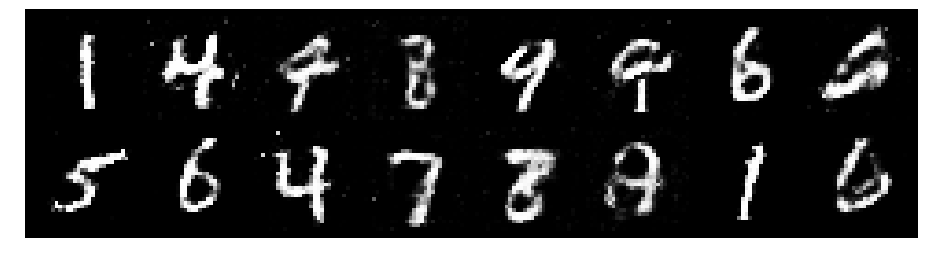

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.1917, Generator Loss: 1.0193
D(x): 0.5575, D(G(z)): 0.3940


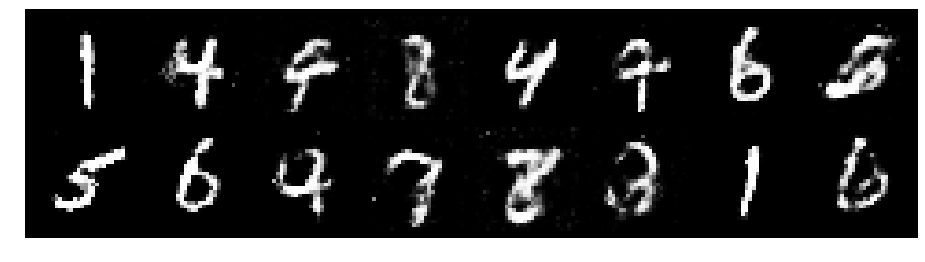

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.3684, Generator Loss: 0.8349
D(x): 0.5783, D(G(z)): 0.5042


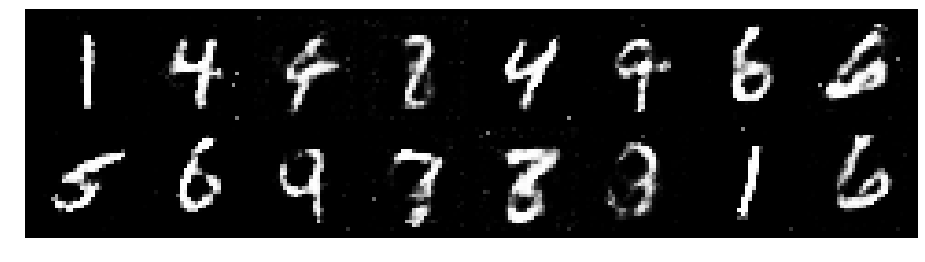

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.1873, Generator Loss: 1.0338
D(x): 0.5834, D(G(z)): 0.4205


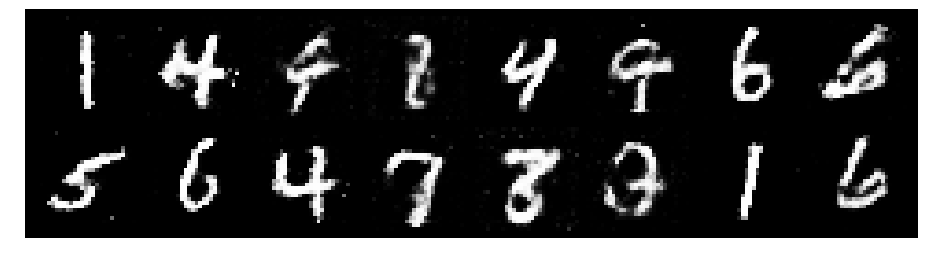

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.1921, Generator Loss: 0.9083
D(x): 0.6038, D(G(z)): 0.4315


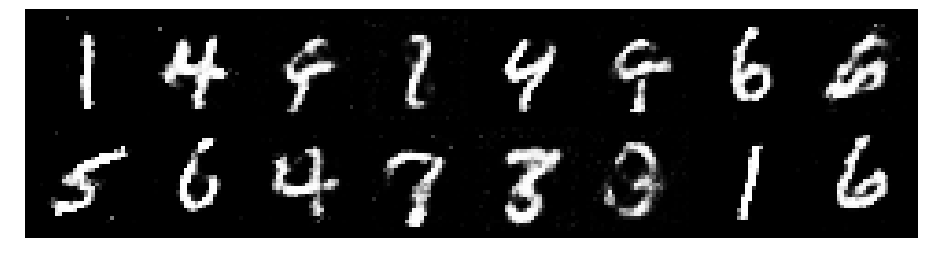

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.3131, Generator Loss: 1.0178
D(x): 0.5758, D(G(z)): 0.4552


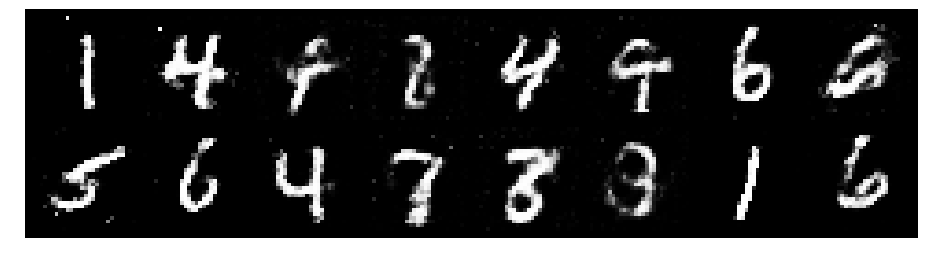

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.2368, Generator Loss: 0.8324
D(x): 0.5899, D(G(z)): 0.4627


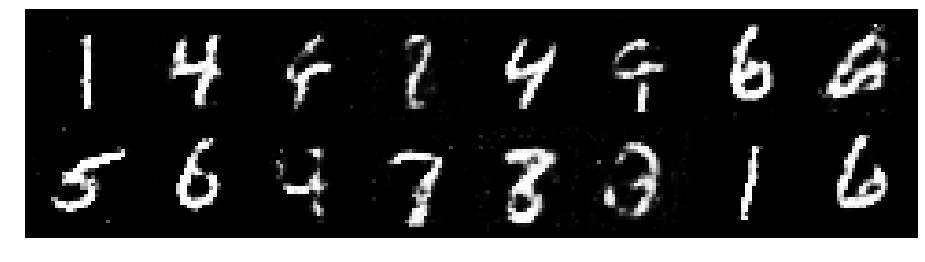

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2348, Generator Loss: 1.0447
D(x): 0.5966, D(G(z)): 0.4320


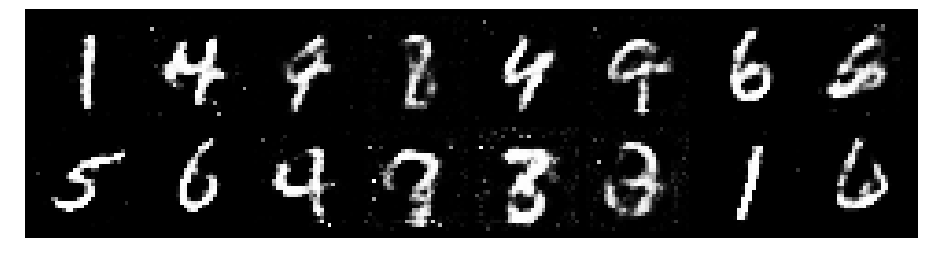

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.2010, Generator Loss: 0.9760
D(x): 0.5761, D(G(z)): 0.4137


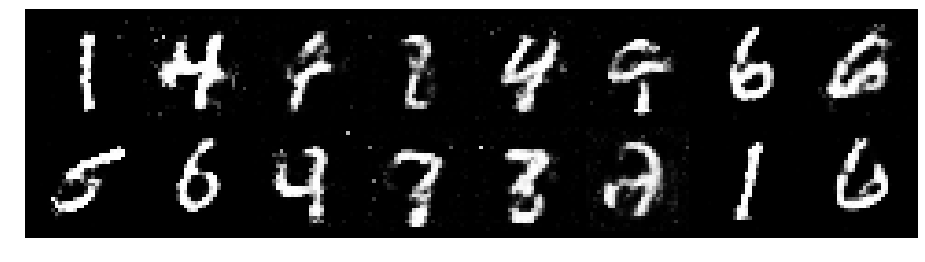

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.3052, Generator Loss: 0.9505
D(x): 0.5576, D(G(z)): 0.4586


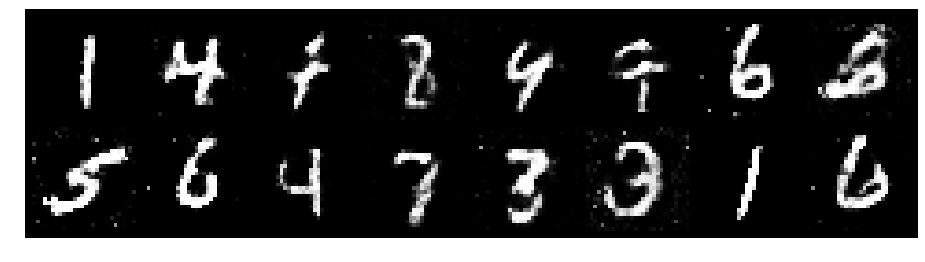

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2416, Generator Loss: 0.9533
D(x): 0.6152, D(G(z)): 0.4632


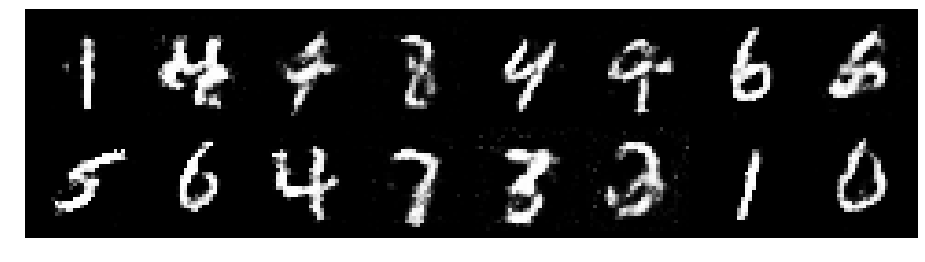

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.1325, Generator Loss: 0.8922
D(x): 0.5715, D(G(z)): 0.3935


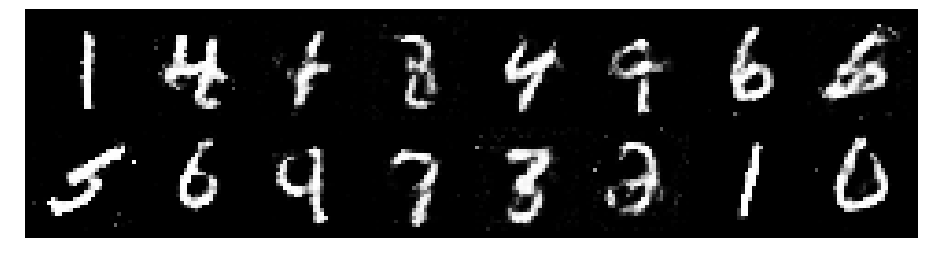

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2831, Generator Loss: 0.8654
D(x): 0.5715, D(G(z)): 0.4598


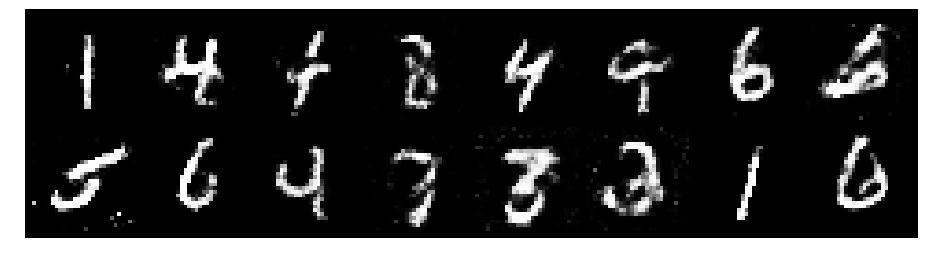

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.1842, Generator Loss: 0.9063
D(x): 0.5561, D(G(z)): 0.4196


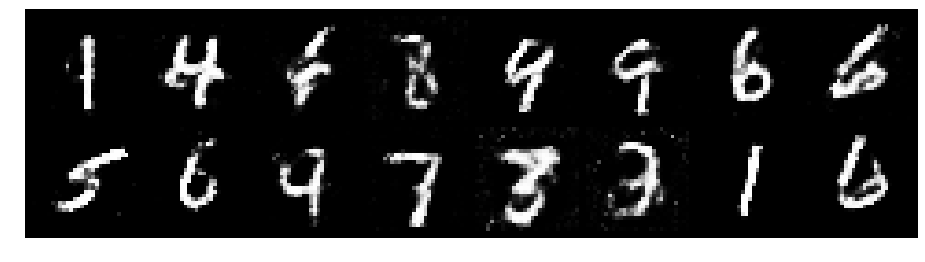

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.3537, Generator Loss: 0.8483
D(x): 0.5289, D(G(z)): 0.4735


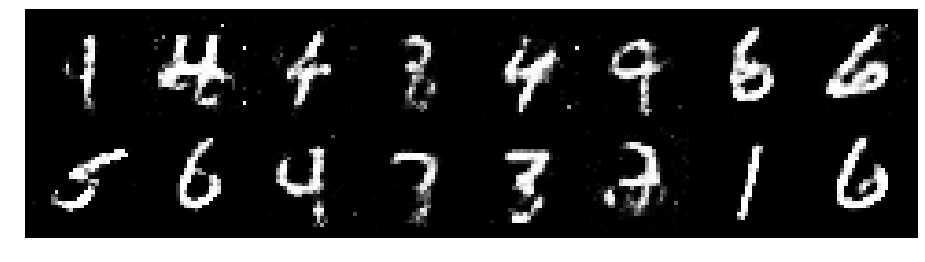

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2376, Generator Loss: 0.9177
D(x): 0.5664, D(G(z)): 0.4383


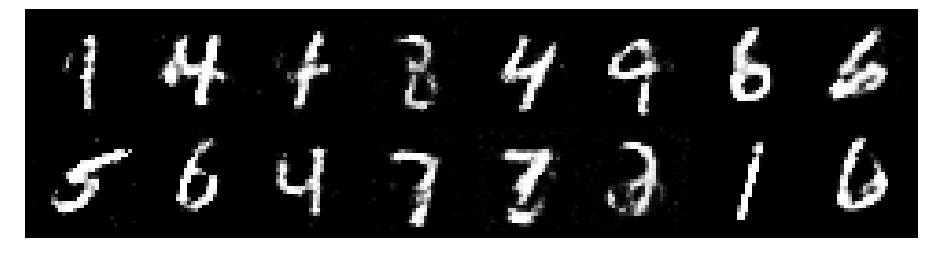

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2866, Generator Loss: 0.8794
D(x): 0.6021, D(G(z)): 0.4712


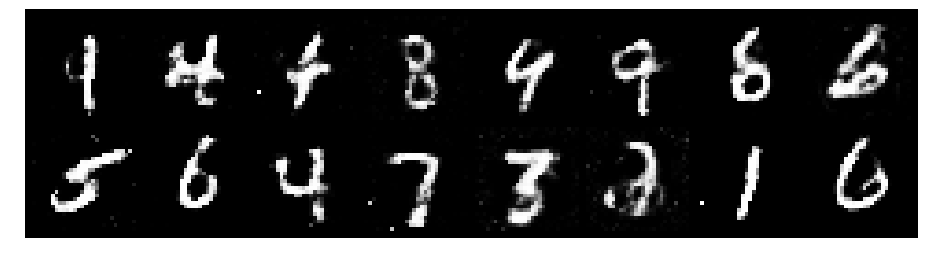

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.4044, Generator Loss: 1.0156
D(x): 0.5002, D(G(z)): 0.4425


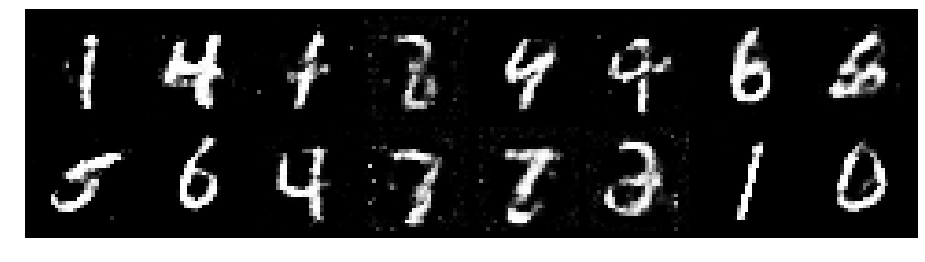

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.2966, Generator Loss: 0.9180
D(x): 0.5401, D(G(z)): 0.4341


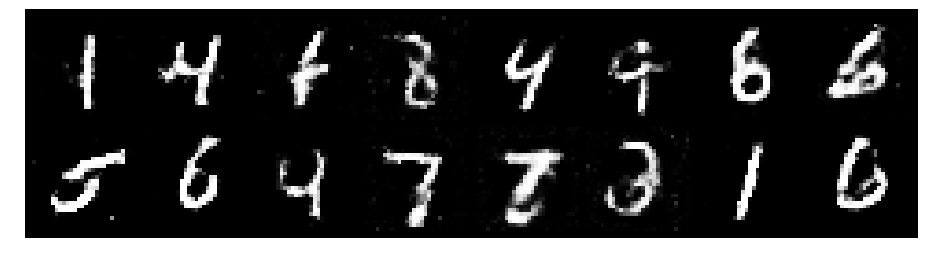

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.3705, Generator Loss: 0.8452
D(x): 0.5519, D(G(z)): 0.4812


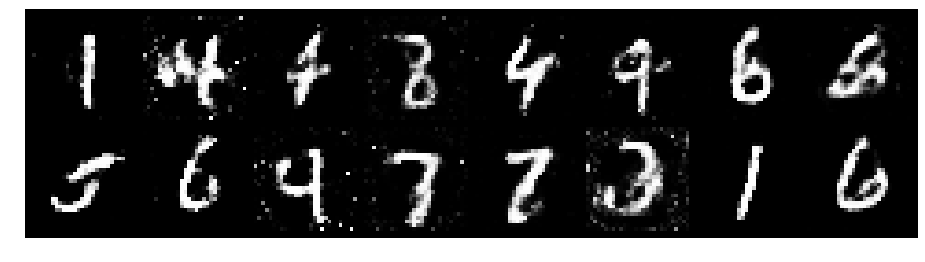

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2649, Generator Loss: 0.8564
D(x): 0.5823, D(G(z)): 0.4544


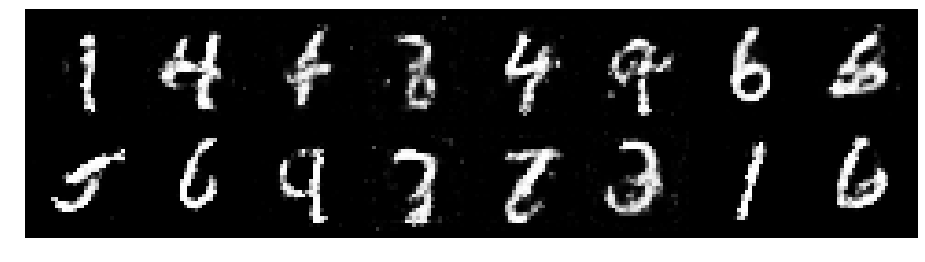

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.2007, Generator Loss: 0.8492
D(x): 0.6004, D(G(z)): 0.4538


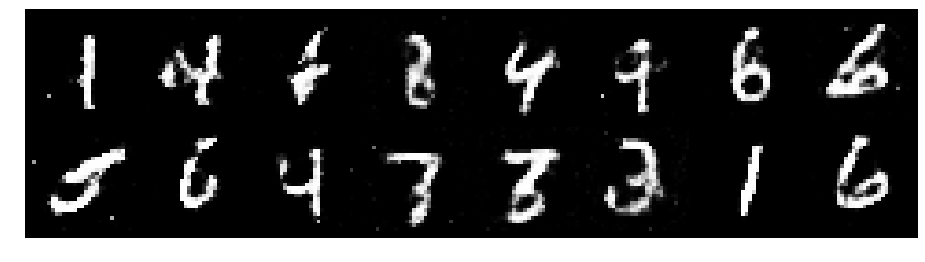

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.2966, Generator Loss: 0.9748
D(x): 0.5131, D(G(z)): 0.4069


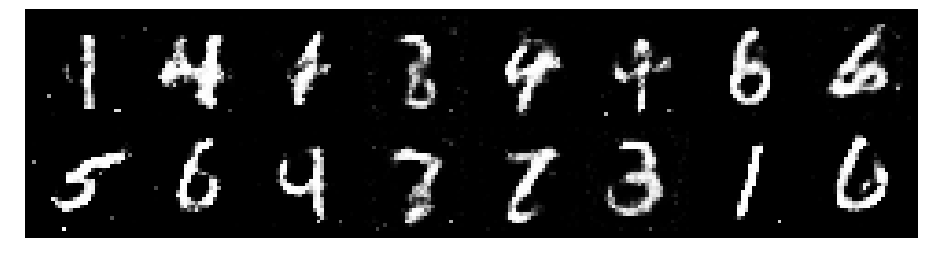

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3022, Generator Loss: 0.7661
D(x): 0.5643, D(G(z)): 0.4811


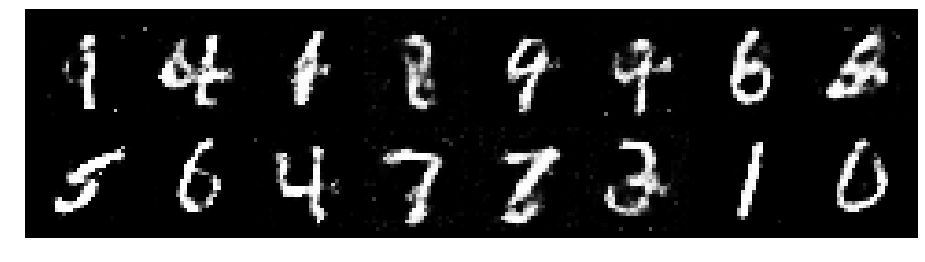

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.3091, Generator Loss: 0.9187
D(x): 0.5398, D(G(z)): 0.4516


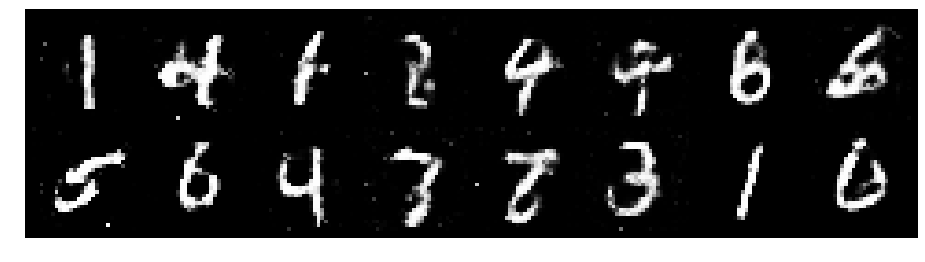

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2046, Generator Loss: 1.1426
D(x): 0.5721, D(G(z)): 0.4042


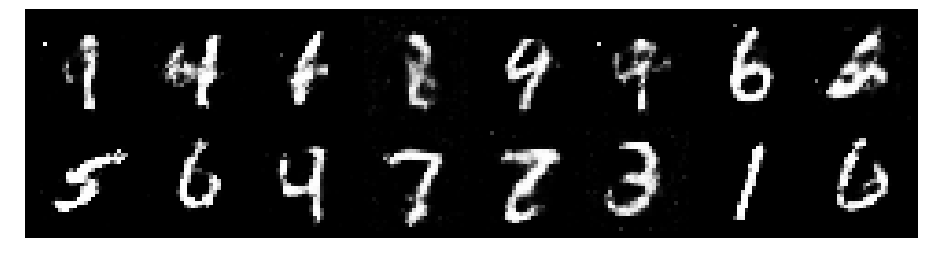

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.1832, Generator Loss: 1.0428
D(x): 0.5820, D(G(z)): 0.4326


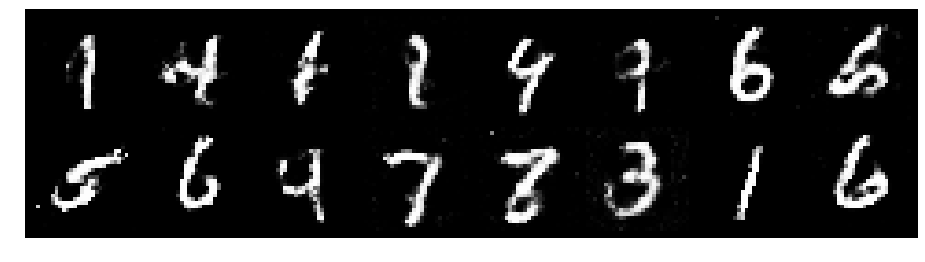

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.2462, Generator Loss: 0.9997
D(x): 0.5361, D(G(z)): 0.4046


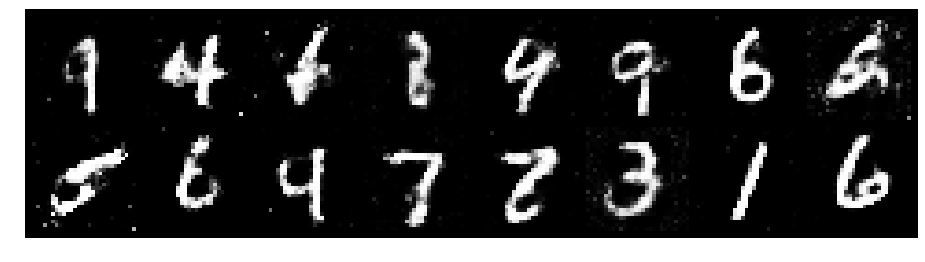

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2587, Generator Loss: 1.0290
D(x): 0.5649, D(G(z)): 0.4336


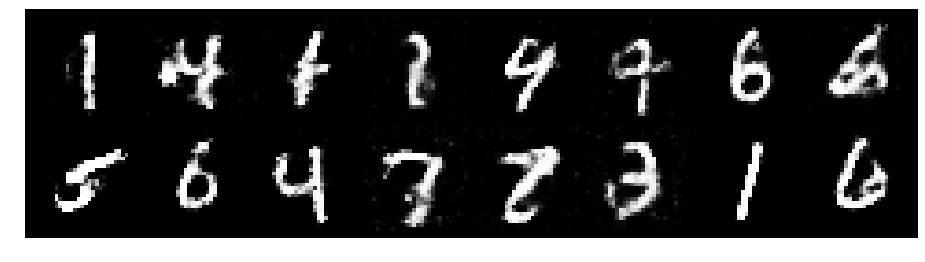

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3081, Generator Loss: 0.8243
D(x): 0.5679, D(G(z)): 0.4756


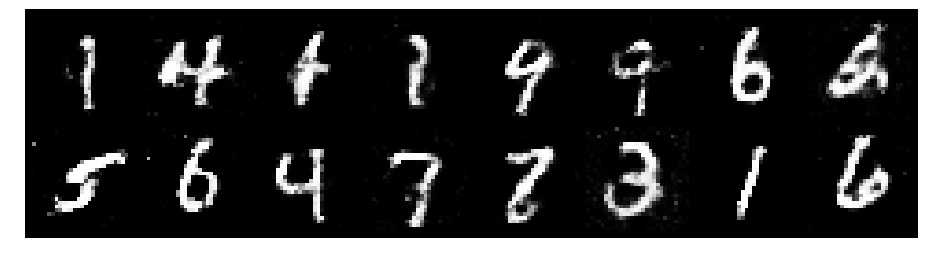

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.2413, Generator Loss: 0.8891
D(x): 0.5585, D(G(z)): 0.4241


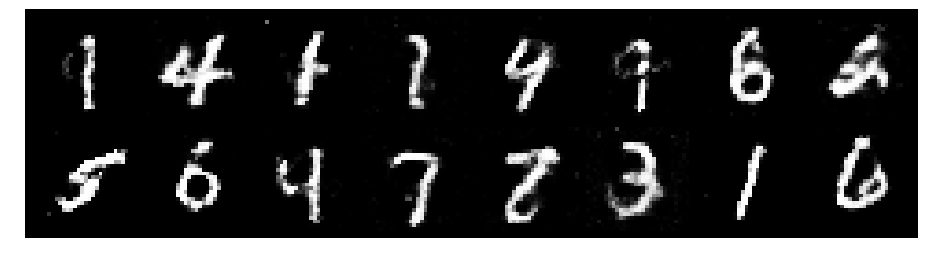

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2335, Generator Loss: 0.9635
D(x): 0.5994, D(G(z)): 0.4622


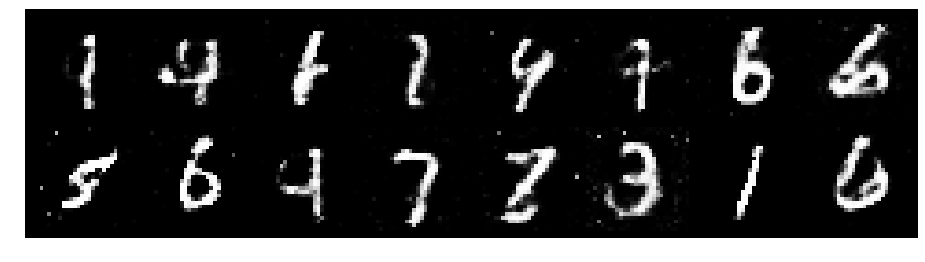

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.2273, Generator Loss: 0.9390
D(x): 0.5784, D(G(z)): 0.4489


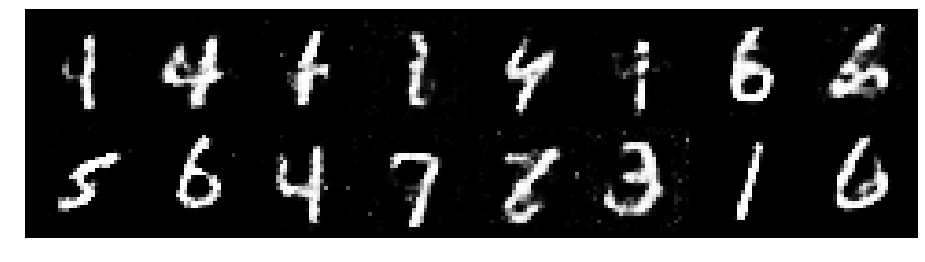

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2362, Generator Loss: 0.9348
D(x): 0.5213, D(G(z)): 0.3887


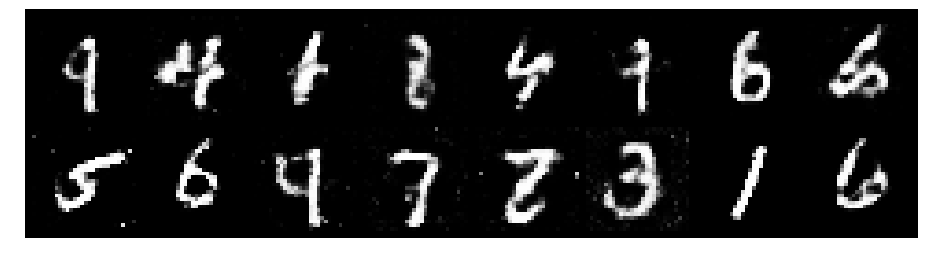

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2334, Generator Loss: 0.9968
D(x): 0.5615, D(G(z)): 0.4265


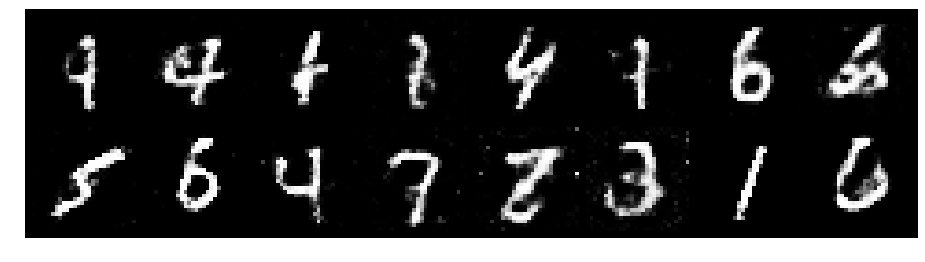

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.2095, Generator Loss: 0.8757
D(x): 0.5846, D(G(z)): 0.4462


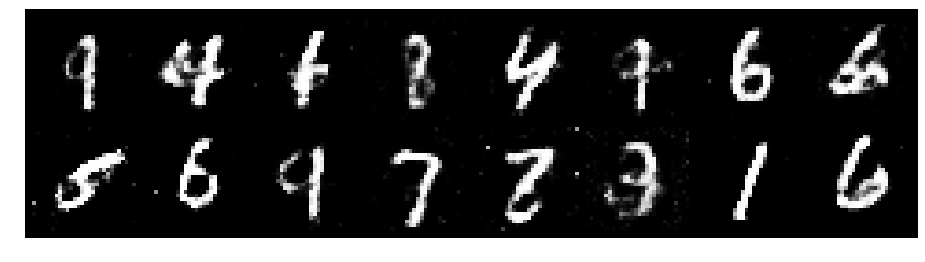

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.1642, Generator Loss: 1.1181
D(x): 0.5745, D(G(z)): 0.3898


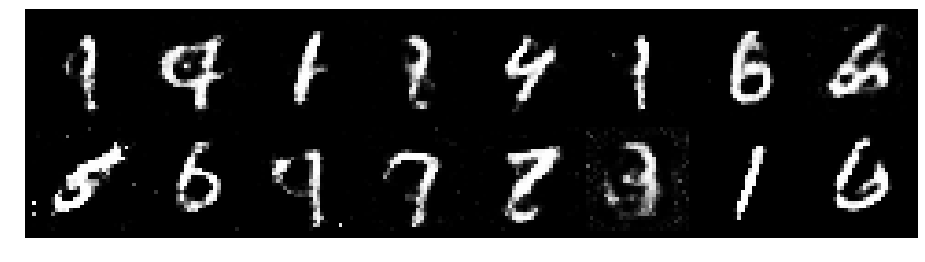

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2730, Generator Loss: 0.8693
D(x): 0.5698, D(G(z)): 0.4662


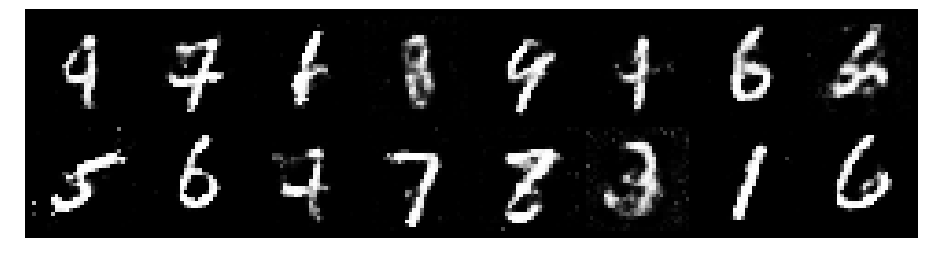

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.1405, Generator Loss: 0.9093
D(x): 0.5717, D(G(z)): 0.3994


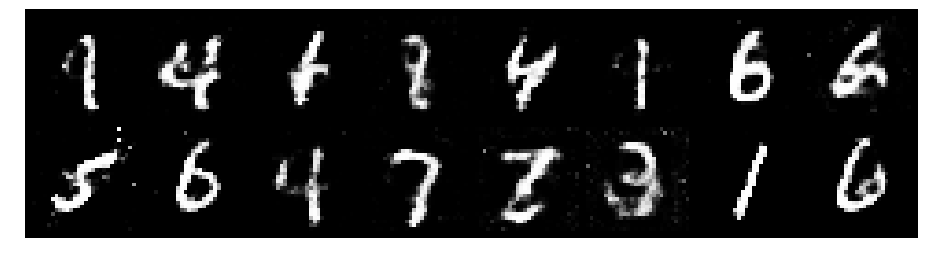

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.2333, Generator Loss: 0.8939
D(x): 0.5340, D(G(z)): 0.4232


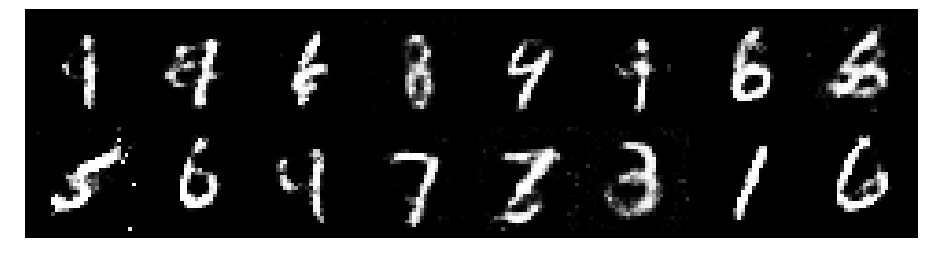

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.1709, Generator Loss: 0.8406
D(x): 0.5892, D(G(z)): 0.4377


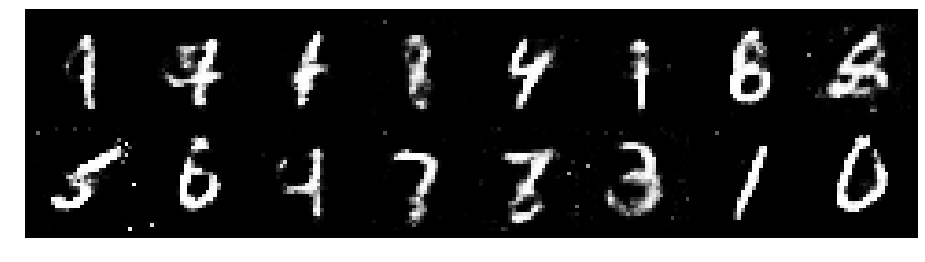

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.3775, Generator Loss: 0.8369
D(x): 0.5108, D(G(z)): 0.4543


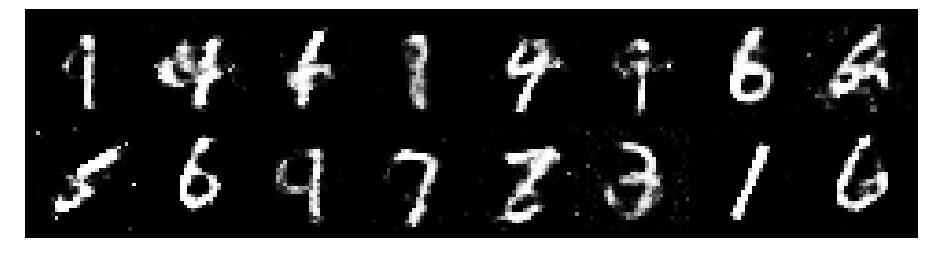

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.3163, Generator Loss: 0.9223
D(x): 0.5502, D(G(z)): 0.4466


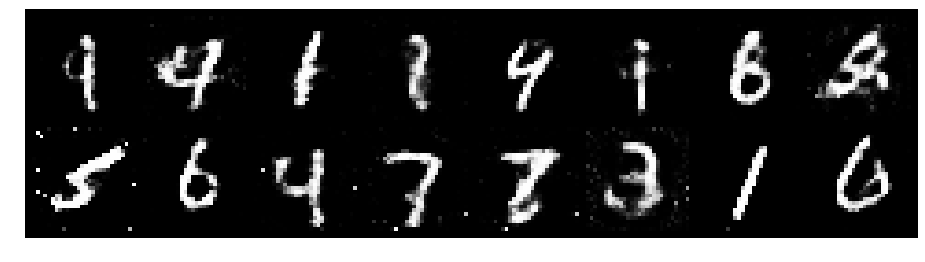

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.2898, Generator Loss: 0.8548
D(x): 0.5478, D(G(z)): 0.4361


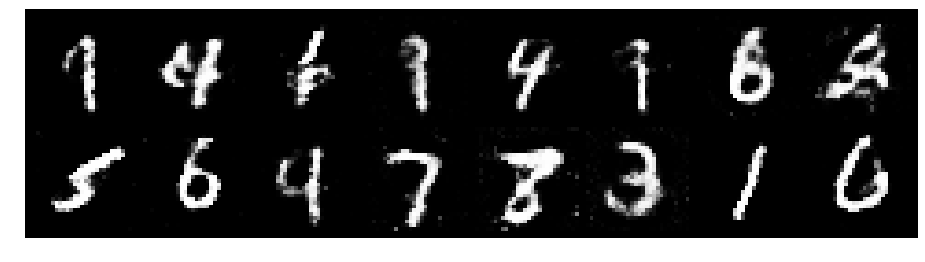

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.2967, Generator Loss: 0.9932
D(x): 0.5747, D(G(z)): 0.4685


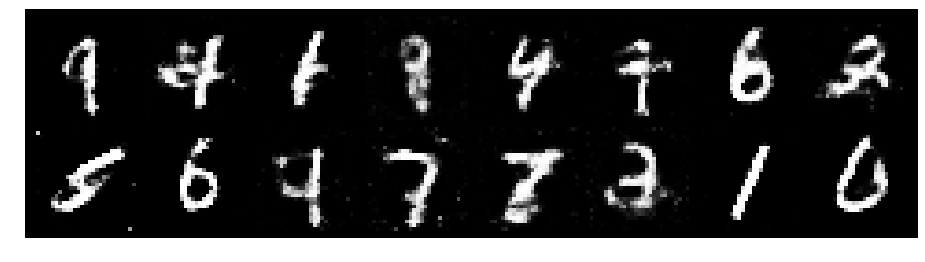

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2915, Generator Loss: 0.9003
D(x): 0.5759, D(G(z)): 0.4686


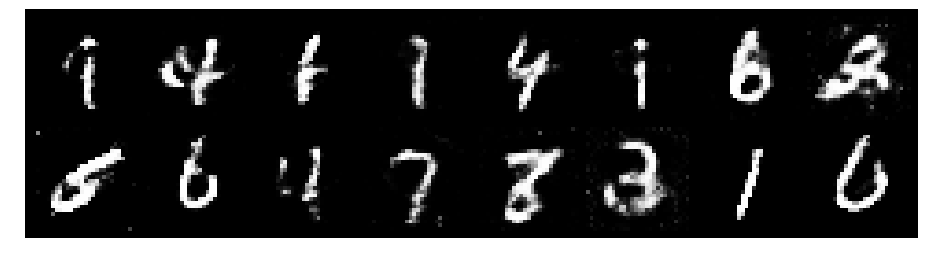

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.3474, Generator Loss: 0.8766
D(x): 0.5291, D(G(z)): 0.4552


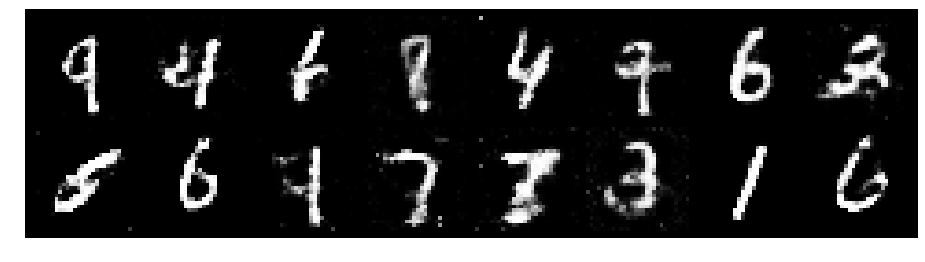

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.1945, Generator Loss: 0.8357
D(x): 0.6192, D(G(z)): 0.4725


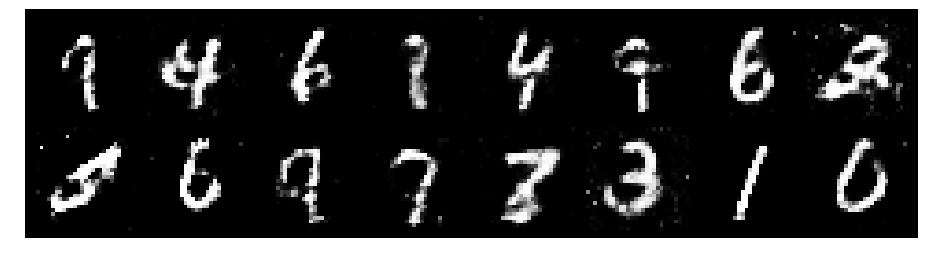

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.3208, Generator Loss: 0.8571
D(x): 0.5344, D(G(z)): 0.4576


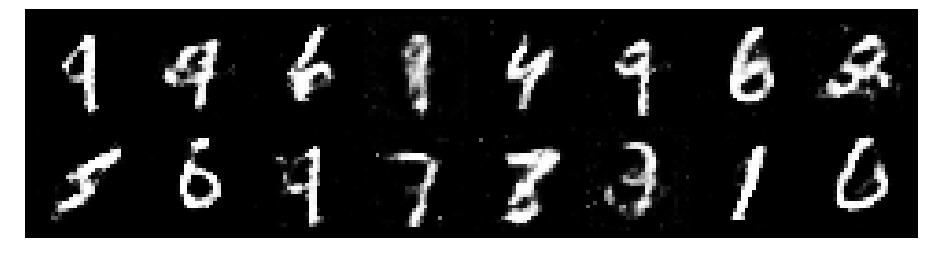

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2520, Generator Loss: 0.9288
D(x): 0.5259, D(G(z)): 0.4000


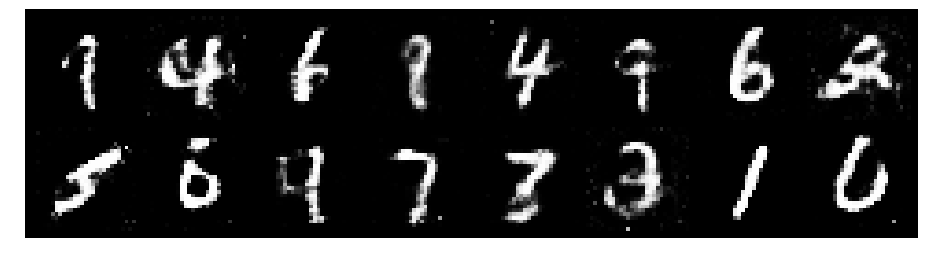

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.2757, Generator Loss: 0.9457
D(x): 0.5946, D(G(z)): 0.4501


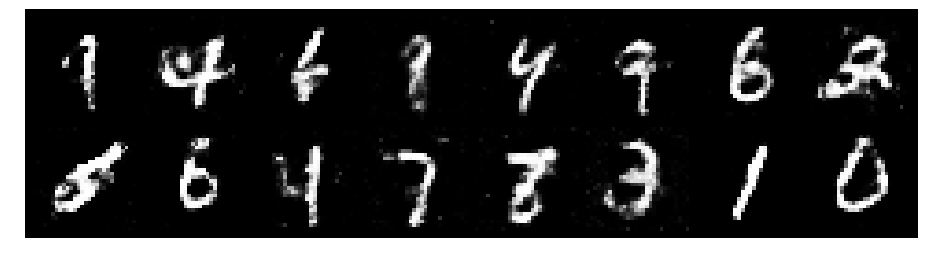

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.1802, Generator Loss: 0.8566
D(x): 0.5830, D(G(z)): 0.4079


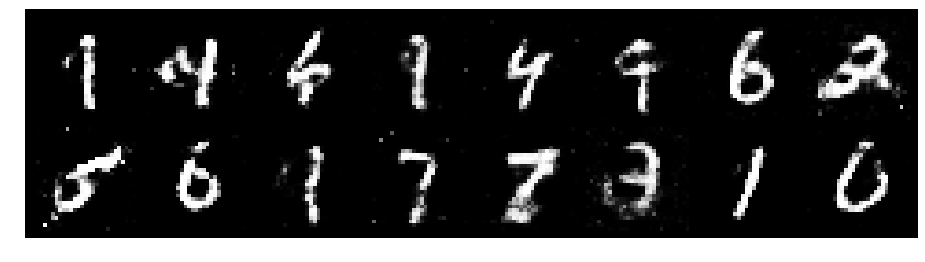

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2006, Generator Loss: 0.8844
D(x): 0.5854, D(G(z)): 0.4465


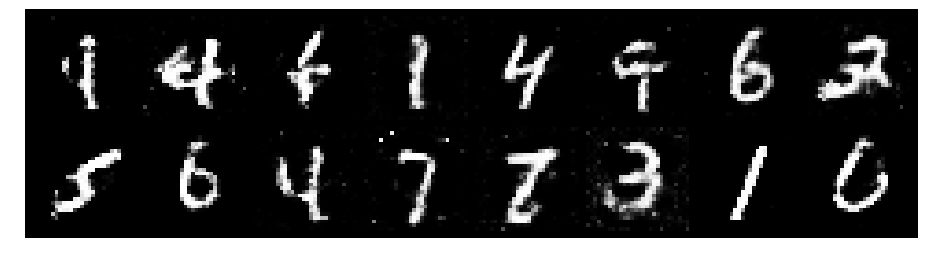

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2871, Generator Loss: 0.9249
D(x): 0.5824, D(G(z)): 0.4700


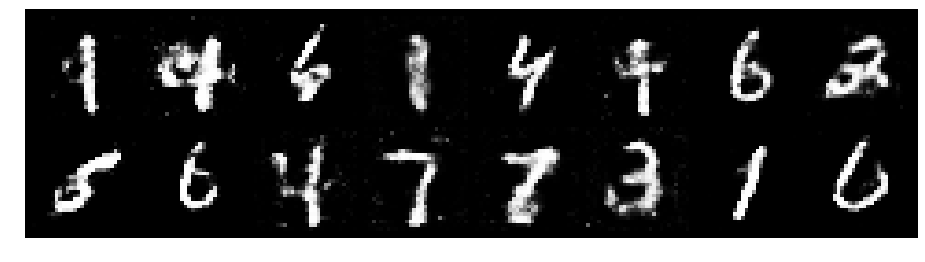

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2623, Generator Loss: 1.0981
D(x): 0.5367, D(G(z)): 0.4013


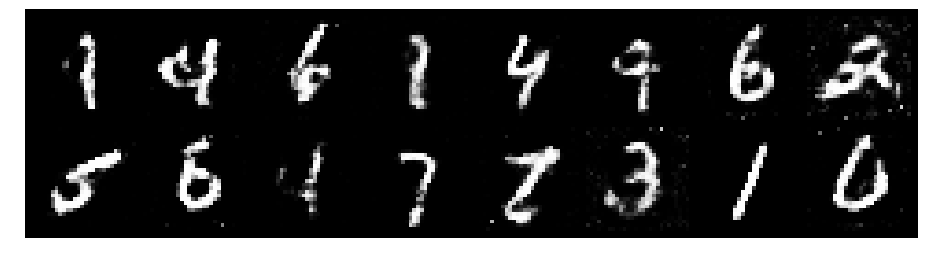

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.1747, Generator Loss: 1.0059
D(x): 0.5891, D(G(z)): 0.4227


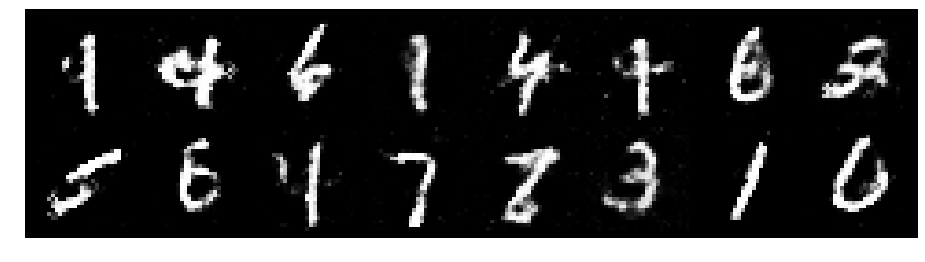

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.1771, Generator Loss: 0.9767
D(x): 0.6118, D(G(z)): 0.4164


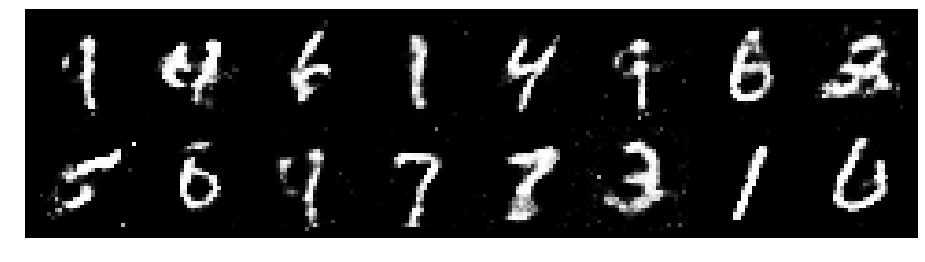

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.3144, Generator Loss: 0.7396
D(x): 0.5558, D(G(z)): 0.4941


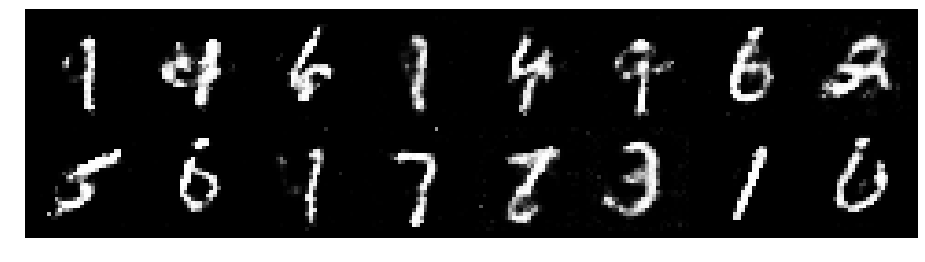

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.3260, Generator Loss: 0.8952
D(x): 0.5229, D(G(z)): 0.4274


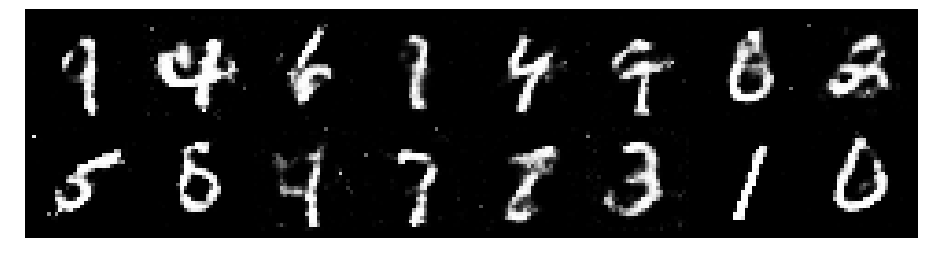

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2400, Generator Loss: 0.9440
D(x): 0.5768, D(G(z)): 0.4377


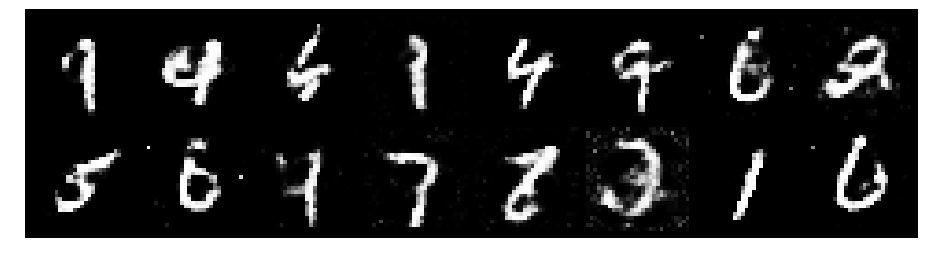

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2684, Generator Loss: 0.9203
D(x): 0.5526, D(G(z)): 0.4372


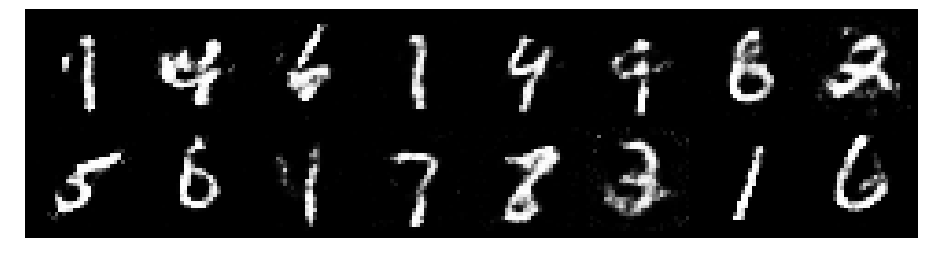

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.2934, Generator Loss: 0.8356
D(x): 0.5487, D(G(z)): 0.4488


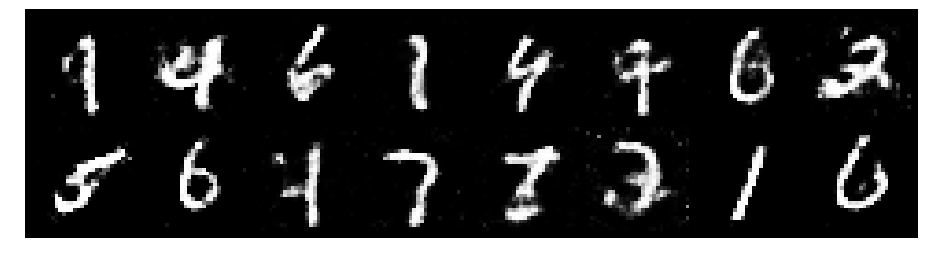

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.3332, Generator Loss: 0.8672
D(x): 0.5382, D(G(z)): 0.4558


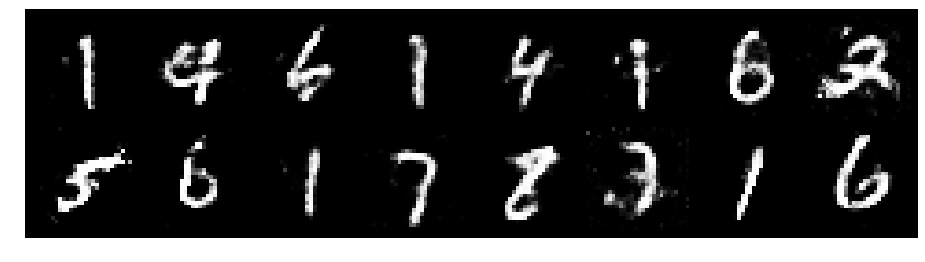

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.2499, Generator Loss: 0.8928
D(x): 0.5604, D(G(z)): 0.4414


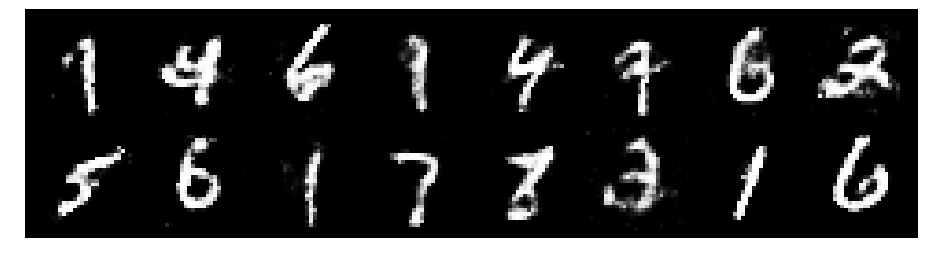

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2190, Generator Loss: 0.8611
D(x): 0.5678, D(G(z)): 0.4396


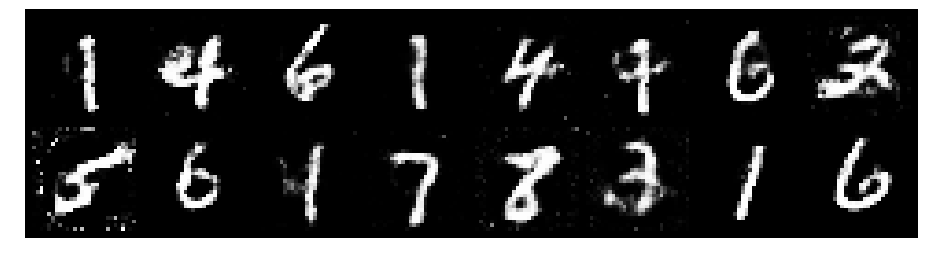

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.4043, Generator Loss: 0.9584
D(x): 0.4876, D(G(z)): 0.4352


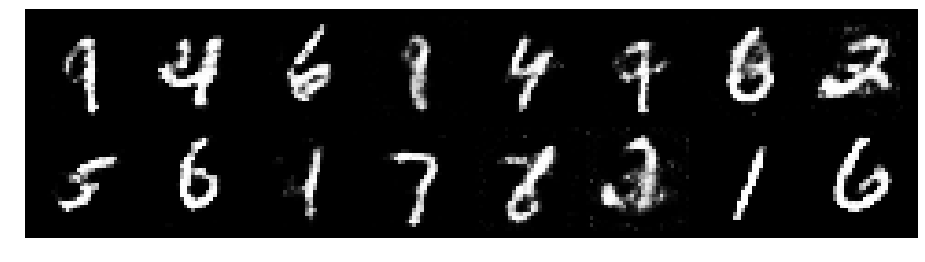

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2734, Generator Loss: 0.8641
D(x): 0.5394, D(G(z)): 0.4334


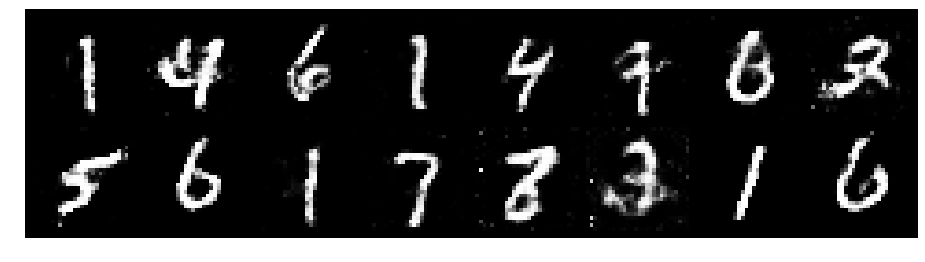

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.3082, Generator Loss: 0.8338
D(x): 0.5514, D(G(z)): 0.4612


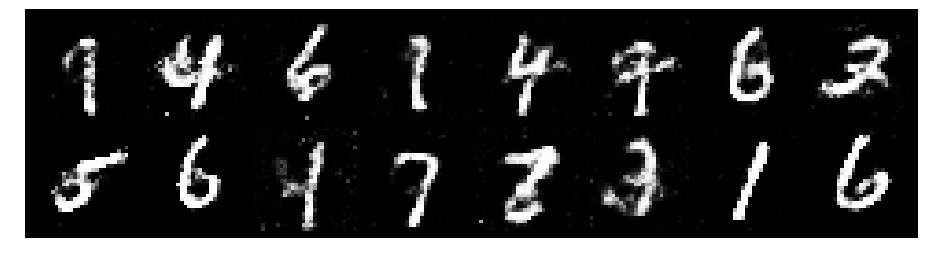

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2379, Generator Loss: 0.8496
D(x): 0.5606, D(G(z)): 0.4494


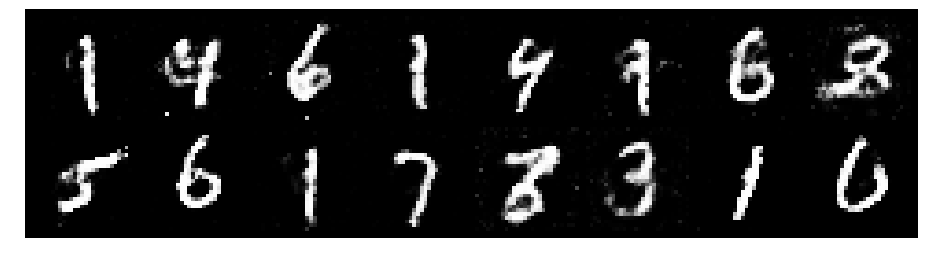

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.3425, Generator Loss: 0.8011
D(x): 0.5622, D(G(z)): 0.4764


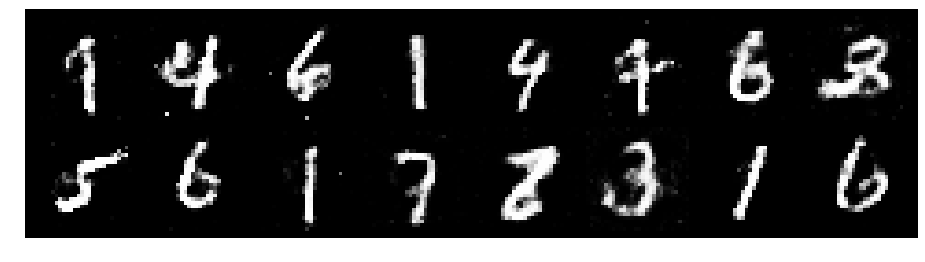

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2565, Generator Loss: 0.7961
D(x): 0.6055, D(G(z)): 0.4705


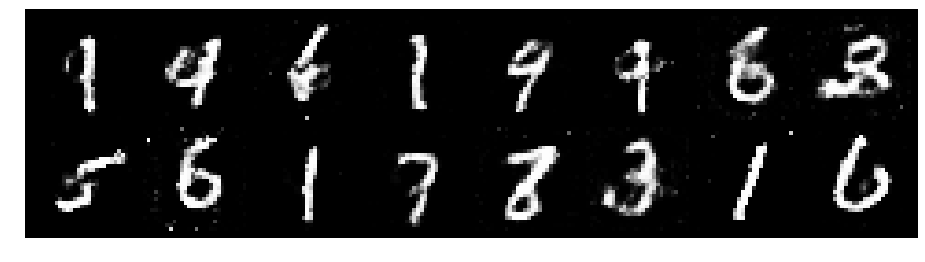

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3898, Generator Loss: 0.8802
D(x): 0.5761, D(G(z)): 0.4655


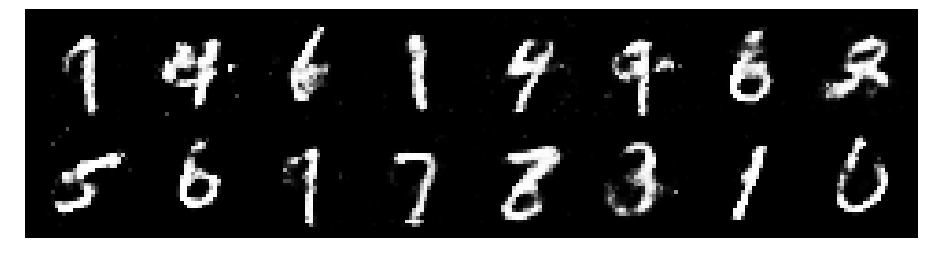

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3454, Generator Loss: 0.9291
D(x): 0.5586, D(G(z)): 0.4568


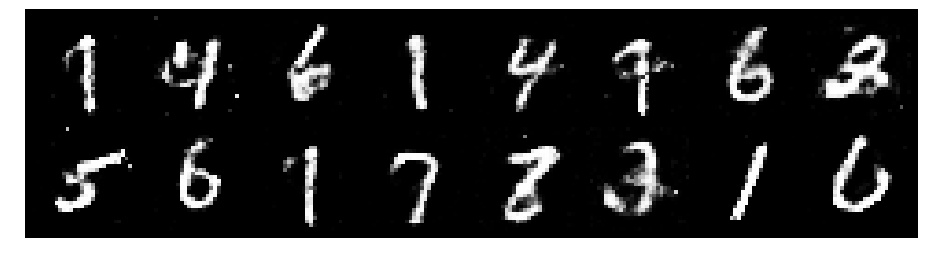

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.1773, Generator Loss: 0.9607
D(x): 0.6393, D(G(z)): 0.4315


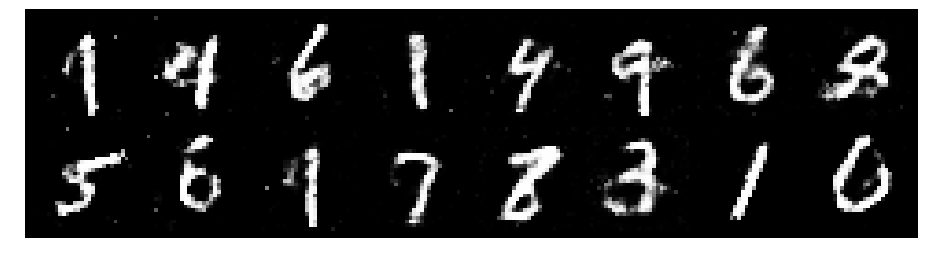

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2032, Generator Loss: 1.1410
D(x): 0.5717, D(G(z)): 0.3744


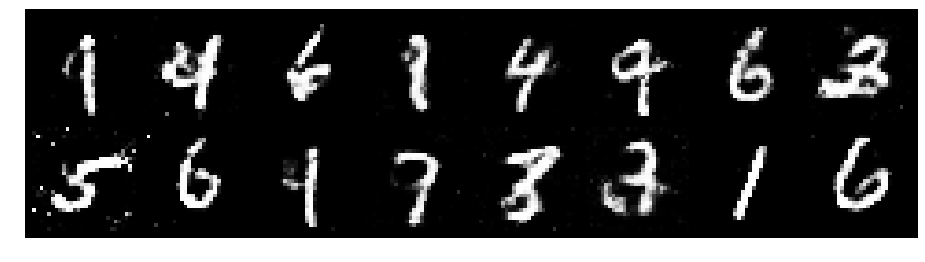

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2914, Generator Loss: 0.8822
D(x): 0.5571, D(G(z)): 0.4513


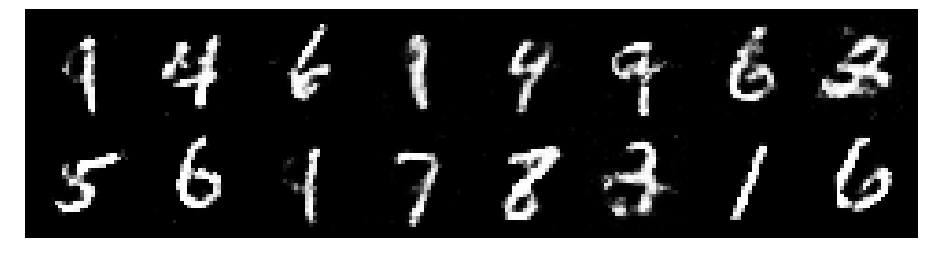

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2145, Generator Loss: 0.9316
D(x): 0.5369, D(G(z)): 0.3953


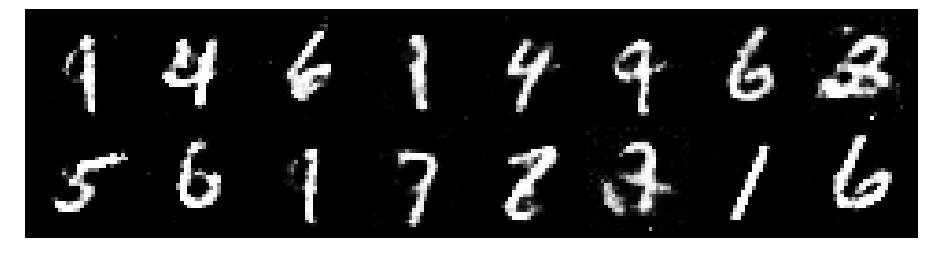

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2735, Generator Loss: 0.9813
D(x): 0.5318, D(G(z)): 0.4198


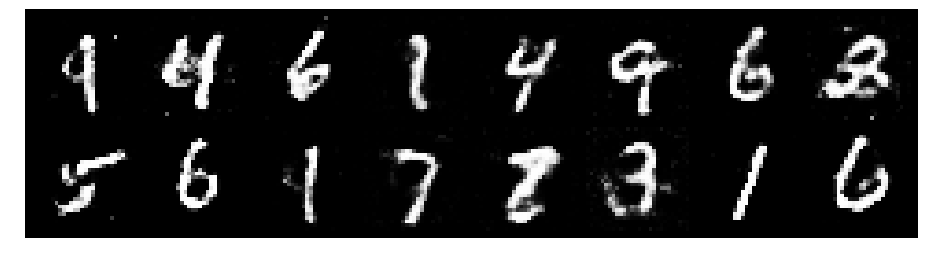

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2291, Generator Loss: 0.8947
D(x): 0.6115, D(G(z)): 0.4489


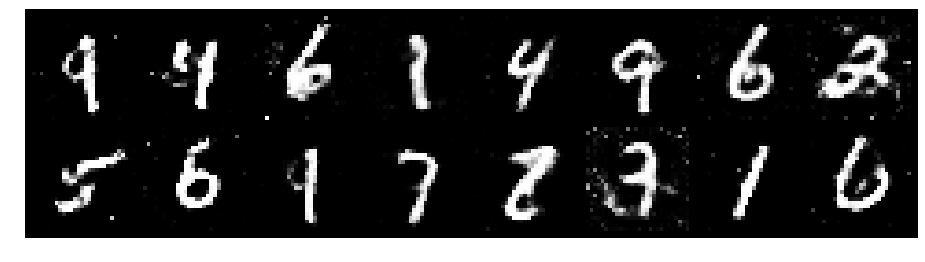

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.1796, Generator Loss: 0.9947
D(x): 0.5822, D(G(z)): 0.4017


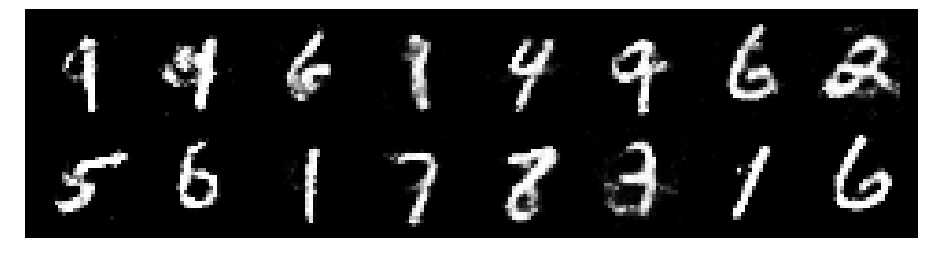

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.1884, Generator Loss: 0.9170
D(x): 0.5804, D(G(z)): 0.4275


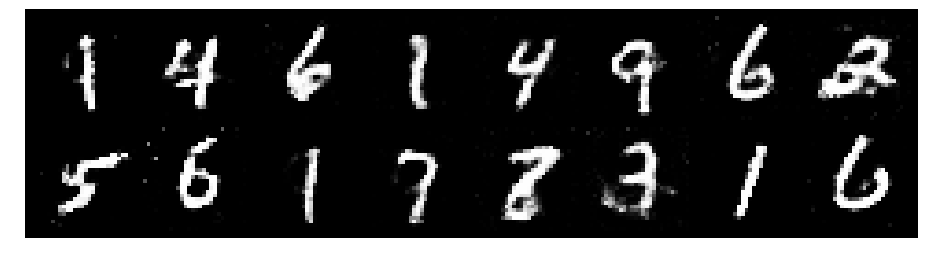

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3131, Generator Loss: 0.8271
D(x): 0.5530, D(G(z)): 0.4592


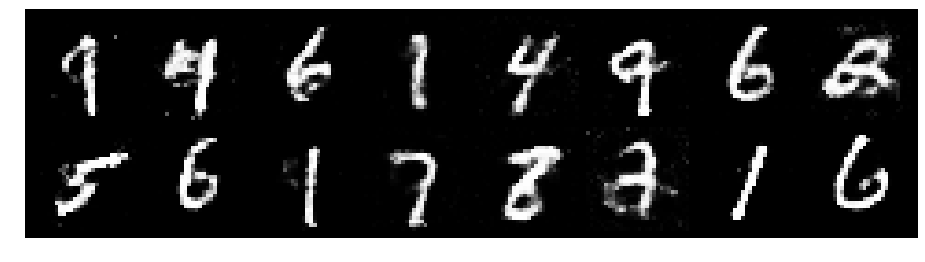

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2381, Generator Loss: 1.0805
D(x): 0.5521, D(G(z)): 0.3847


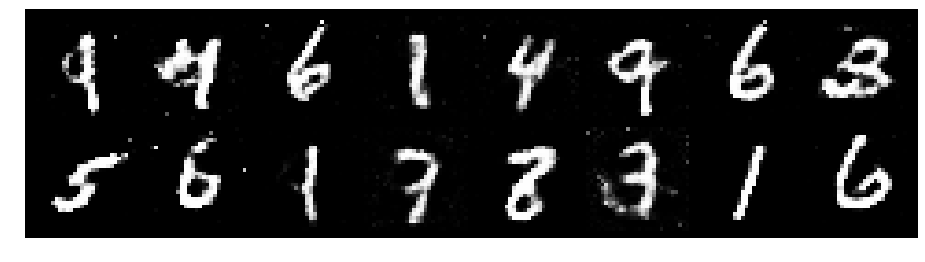

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3078, Generator Loss: 0.8826
D(x): 0.5682, D(G(z)): 0.4521


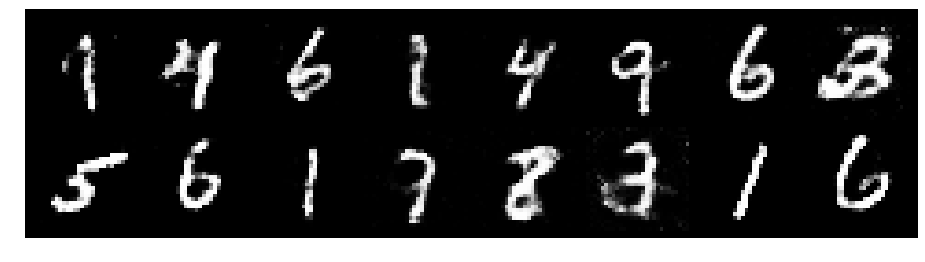

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.3190, Generator Loss: 0.8592
D(x): 0.5872, D(G(z)): 0.4698


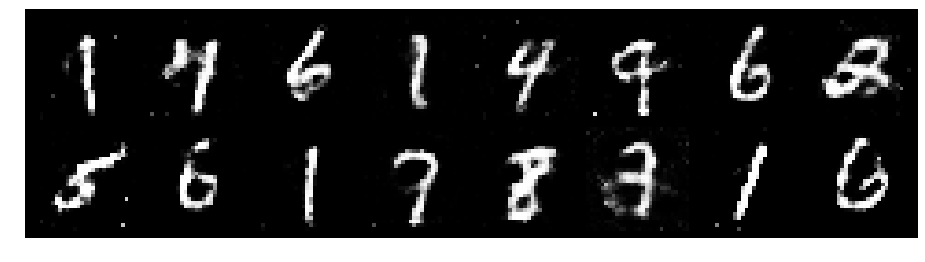

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2525, Generator Loss: 1.1365
D(x): 0.5611, D(G(z)): 0.3985


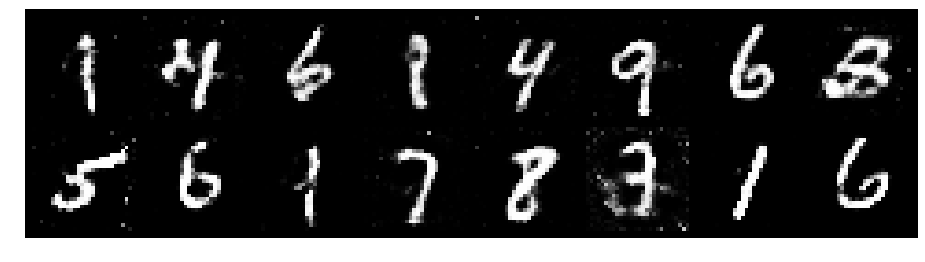

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2632, Generator Loss: 0.9649
D(x): 0.5636, D(G(z)): 0.4318


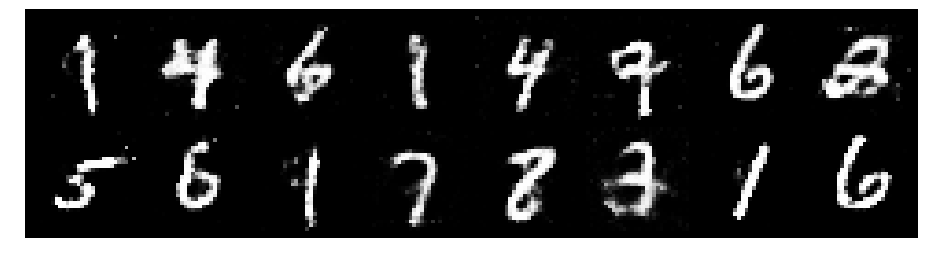

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.3292, Generator Loss: 1.0566
D(x): 0.5005, D(G(z)): 0.3791


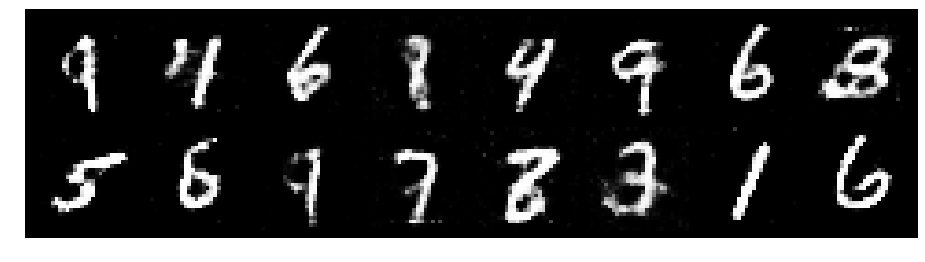

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2987, Generator Loss: 0.9799
D(x): 0.5728, D(G(z)): 0.4605


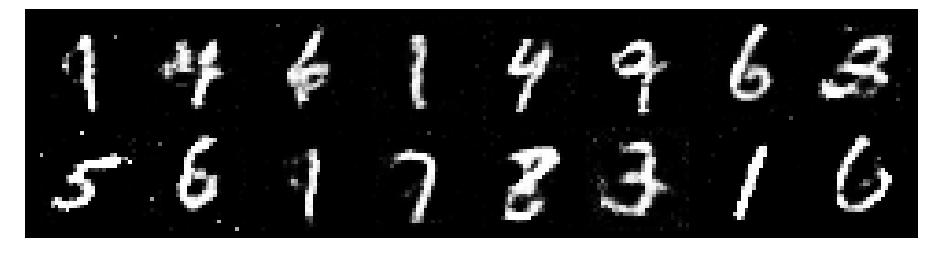

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2623, Generator Loss: 1.0455
D(x): 0.5566, D(G(z)): 0.4142


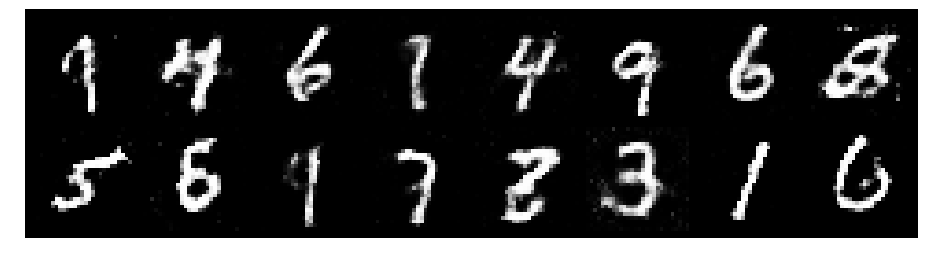

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2217, Generator Loss: 0.9148
D(x): 0.5599, D(G(z)): 0.4212


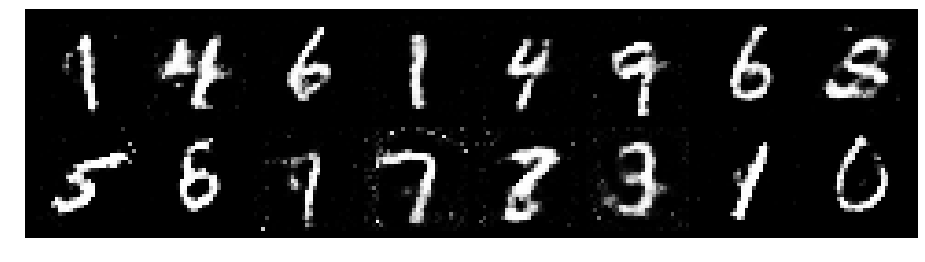

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.2098, Generator Loss: 0.9987
D(x): 0.5777, D(G(z)): 0.4392


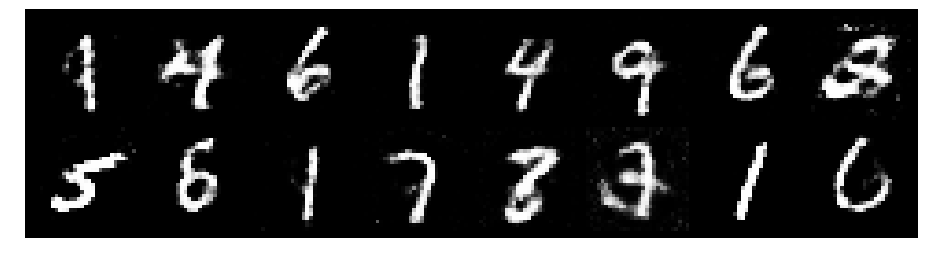

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.0896, Generator Loss: 1.0582
D(x): 0.6020, D(G(z)): 0.3946


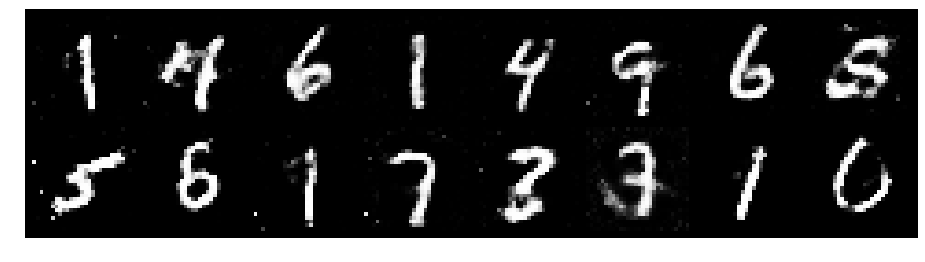

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2414, Generator Loss: 1.0720
D(x): 0.5743, D(G(z)): 0.4386


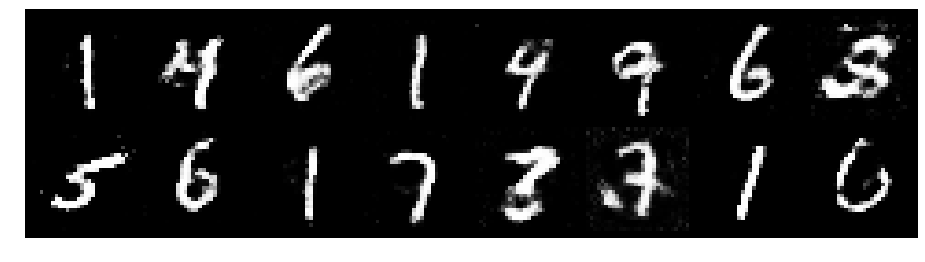

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.2579, Generator Loss: 1.0132
D(x): 0.5875, D(G(z)): 0.4522


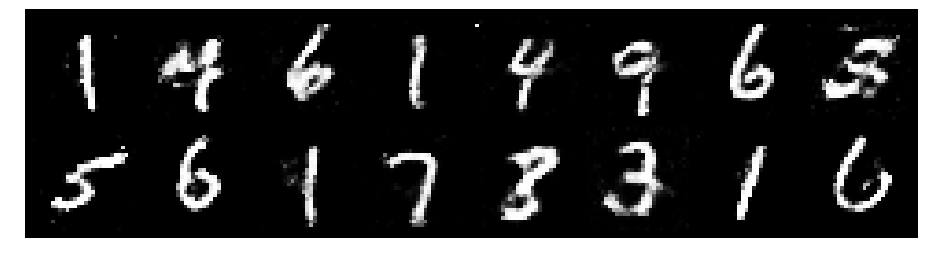

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2612, Generator Loss: 0.9932
D(x): 0.5616, D(G(z)): 0.4076


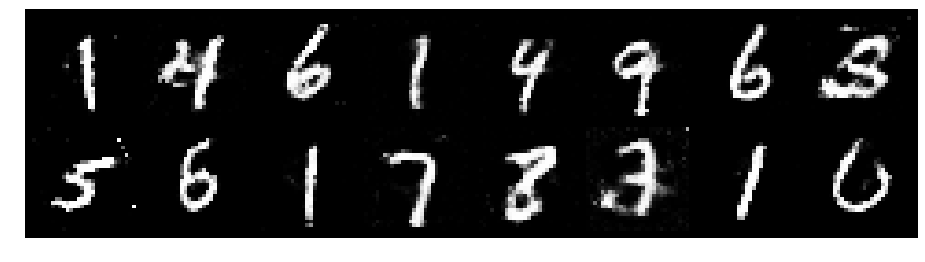

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.1522, Generator Loss: 0.8656
D(x): 0.6067, D(G(z)): 0.4468


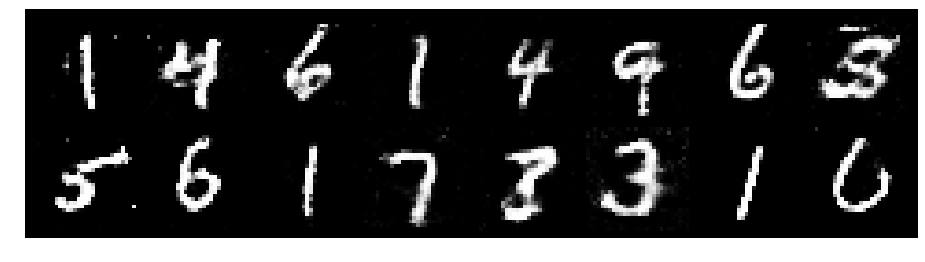

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.4003, Generator Loss: 0.8123
D(x): 0.5200, D(G(z)): 0.4679


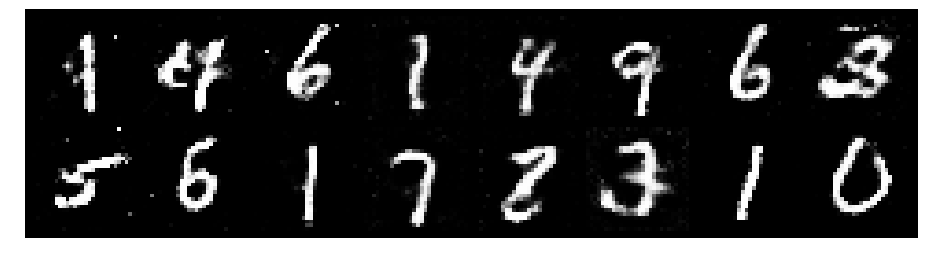

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.3180, Generator Loss: 0.8078
D(x): 0.5370, D(G(z)): 0.4631


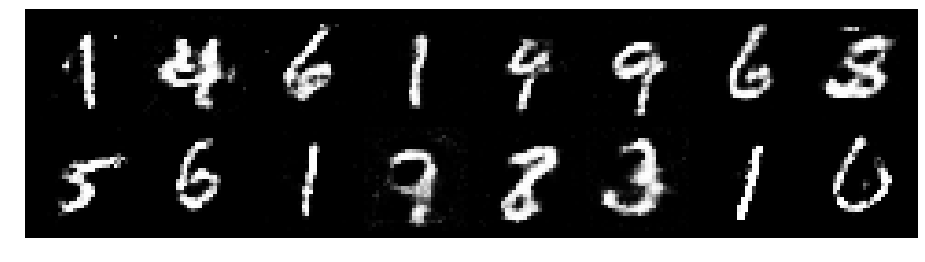

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2339, Generator Loss: 0.8687
D(x): 0.5901, D(G(z)): 0.4573


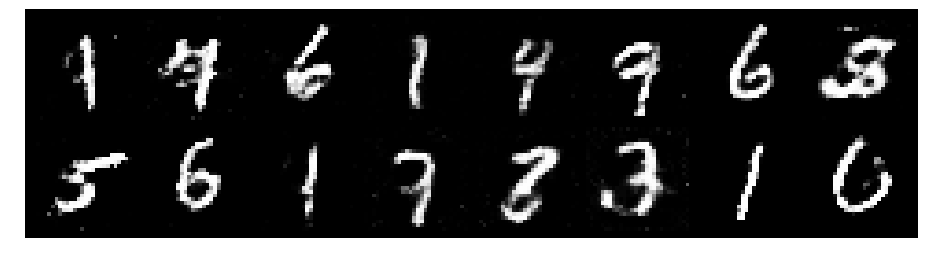

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2888, Generator Loss: 0.9470
D(x): 0.5606, D(G(z)): 0.4380


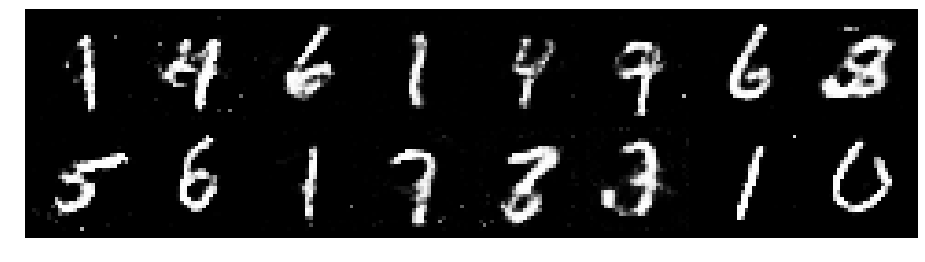

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.1700, Generator Loss: 0.8769
D(x): 0.6505, D(G(z)): 0.4379


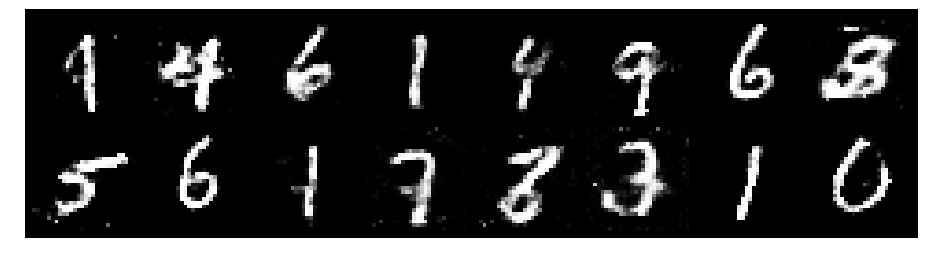

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.1942, Generator Loss: 1.0161
D(x): 0.5611, D(G(z)): 0.3880


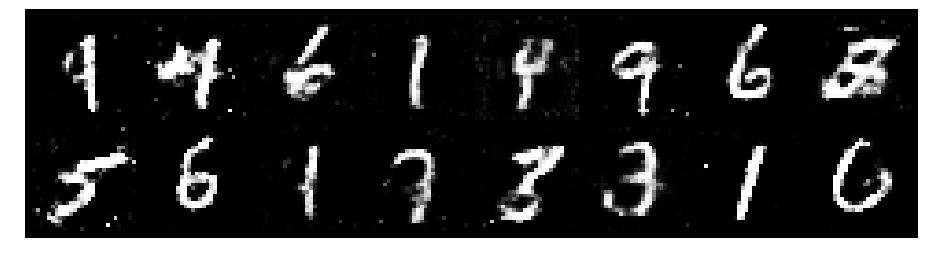

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2799, Generator Loss: 0.9495
D(x): 0.5098, D(G(z)): 0.4106


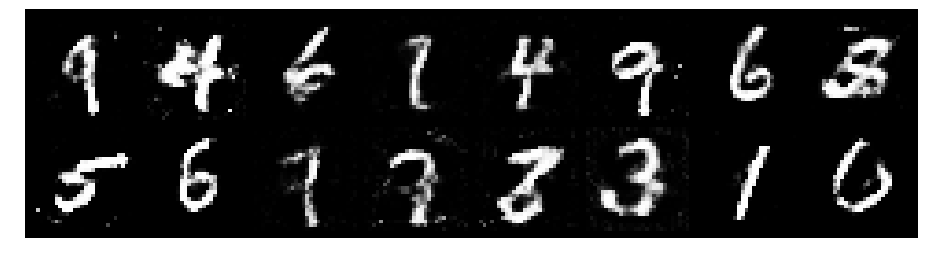

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2027, Generator Loss: 1.0764
D(x): 0.5814, D(G(z)): 0.4179


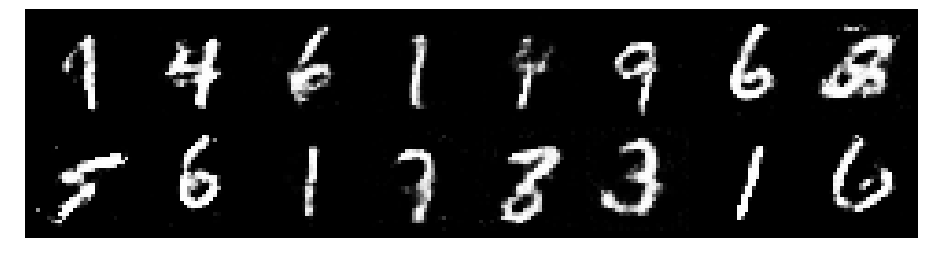

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.2714, Generator Loss: 0.9317
D(x): 0.5928, D(G(z)): 0.4574


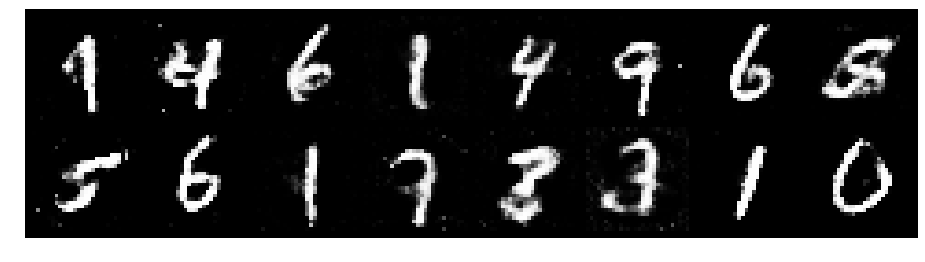

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.3931, Generator Loss: 0.9366
D(x): 0.5410, D(G(z)): 0.4777


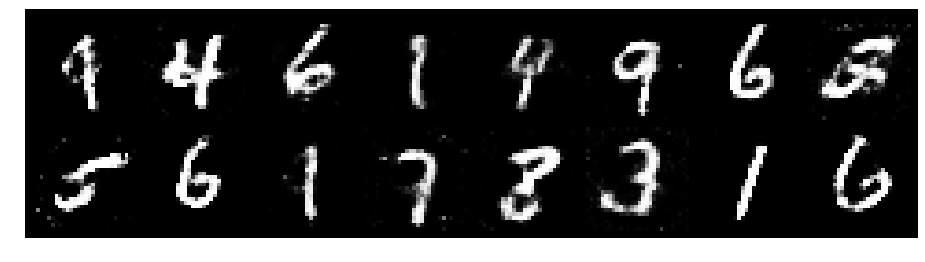

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.1673, Generator Loss: 0.9883
D(x): 0.6056, D(G(z)): 0.4113


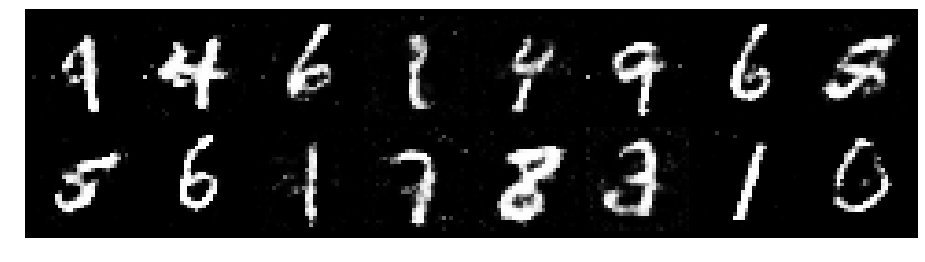

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.1936, Generator Loss: 0.9733
D(x): 0.5694, D(G(z)): 0.4233


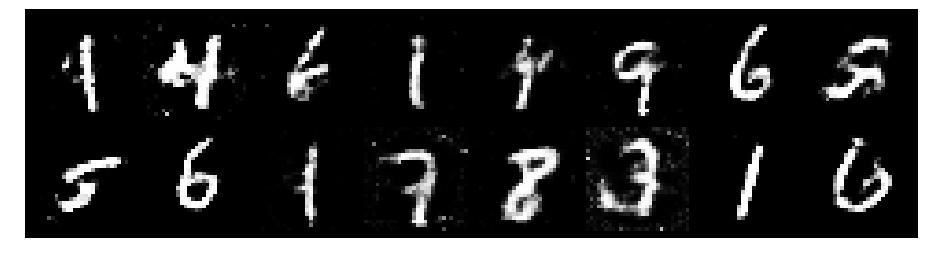

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.4947, Generator Loss: 0.8963
D(x): 0.5082, D(G(z)): 0.4622


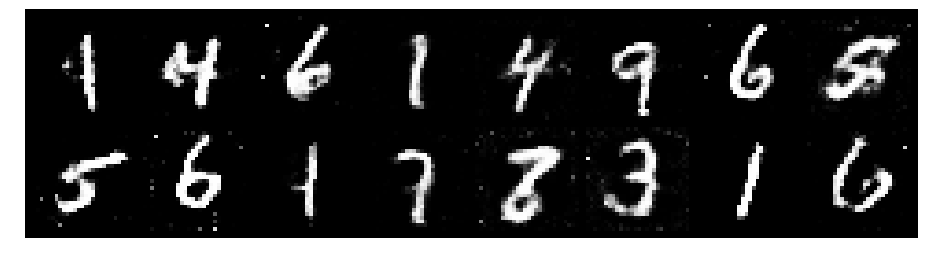

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3024, Generator Loss: 0.8888
D(x): 0.5497, D(G(z)): 0.4332


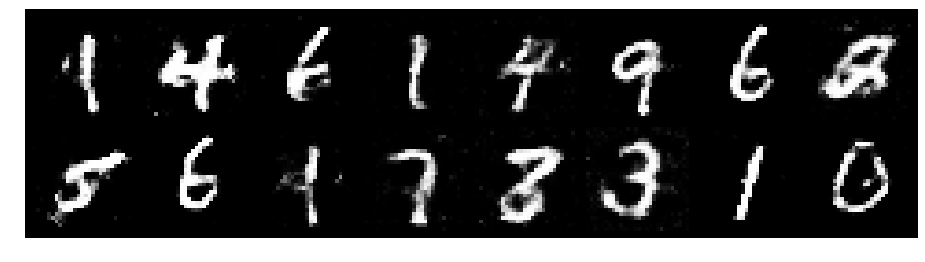

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2102, Generator Loss: 0.8956
D(x): 0.5851, D(G(z)): 0.4328


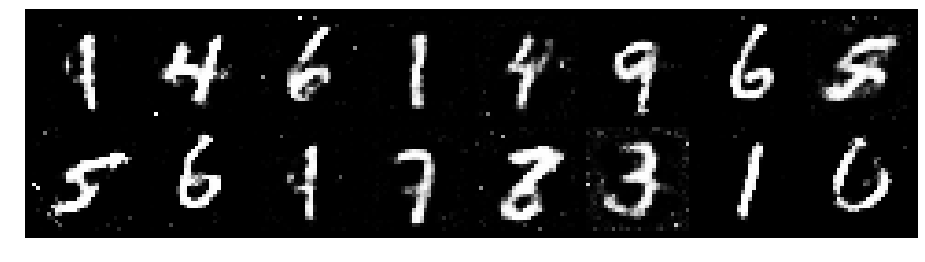

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2602, Generator Loss: 0.8978
D(x): 0.5854, D(G(z)): 0.4690


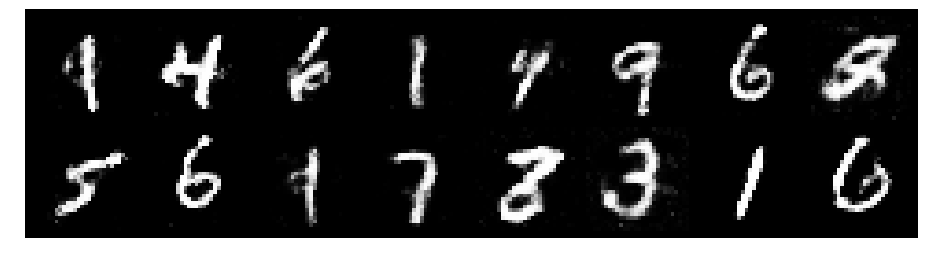

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2004, Generator Loss: 0.8816
D(x): 0.5170, D(G(z)): 0.3864


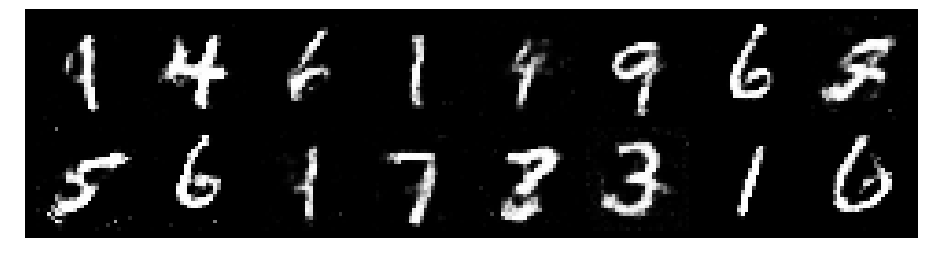

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3488, Generator Loss: 0.9216
D(x): 0.5729, D(G(z)): 0.4835


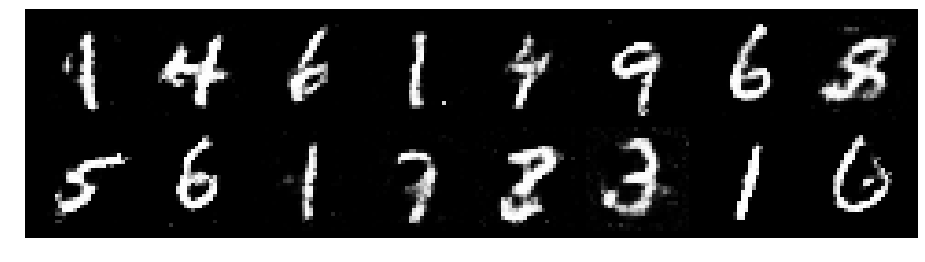

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2702, Generator Loss: 0.8456
D(x): 0.5922, D(G(z)): 0.4726


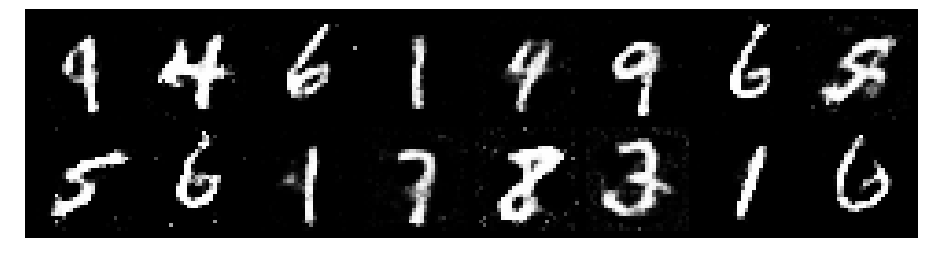

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2349, Generator Loss: 0.8457
D(x): 0.5678, D(G(z)): 0.4397


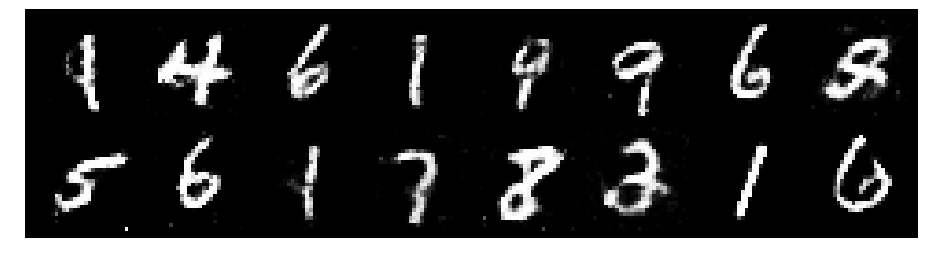

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2480, Generator Loss: 0.8818
D(x): 0.5928, D(G(z)): 0.4646


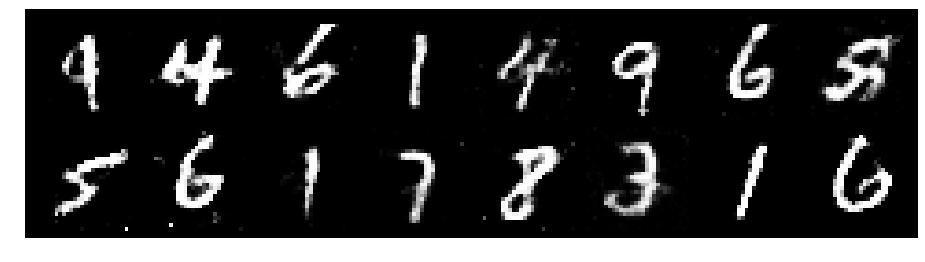

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2416, Generator Loss: 0.8013
D(x): 0.5849, D(G(z)): 0.4687


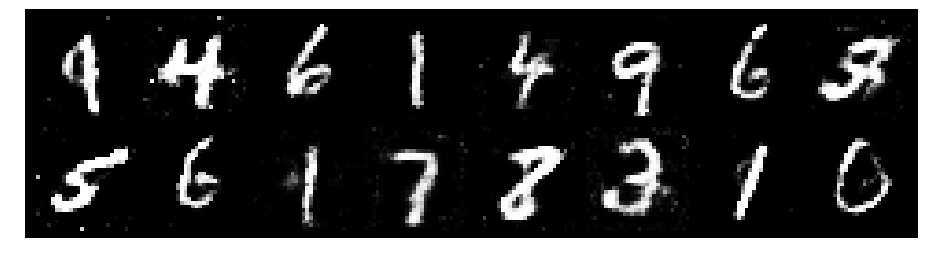

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.1515, Generator Loss: 0.8405
D(x): 0.5817, D(G(z)): 0.4222


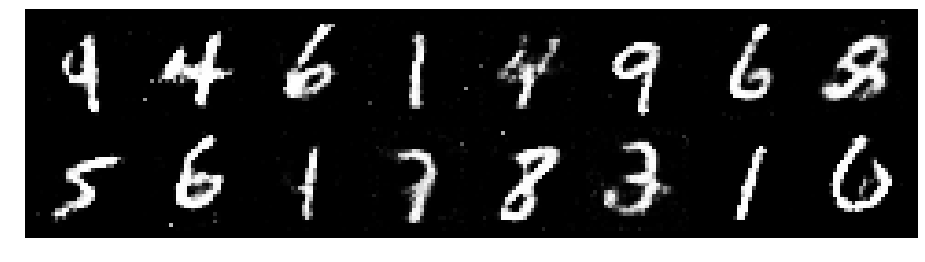

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.1733, Generator Loss: 0.9345
D(x): 0.5662, D(G(z)): 0.4179


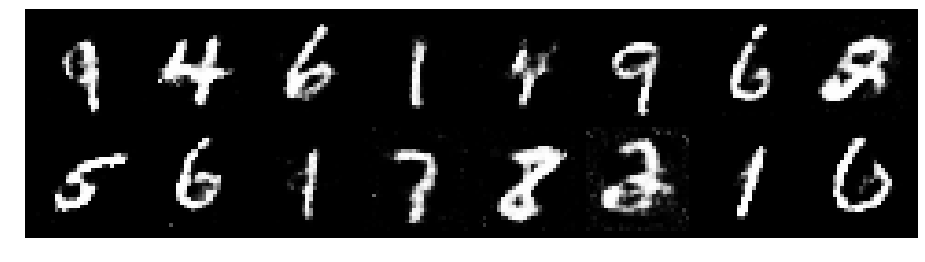

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3505, Generator Loss: 0.9158
D(x): 0.5601, D(G(z)): 0.4614


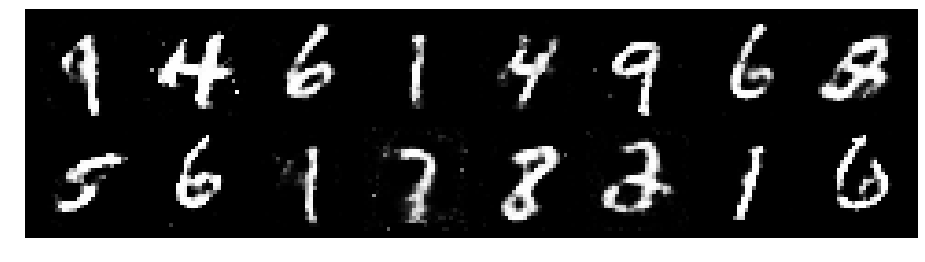

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.3020, Generator Loss: 0.8306
D(x): 0.5589, D(G(z)): 0.4626


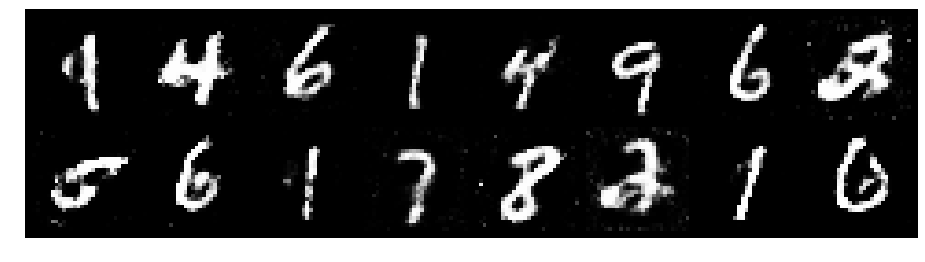

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2501, Generator Loss: 0.8626
D(x): 0.5898, D(G(z)): 0.4631


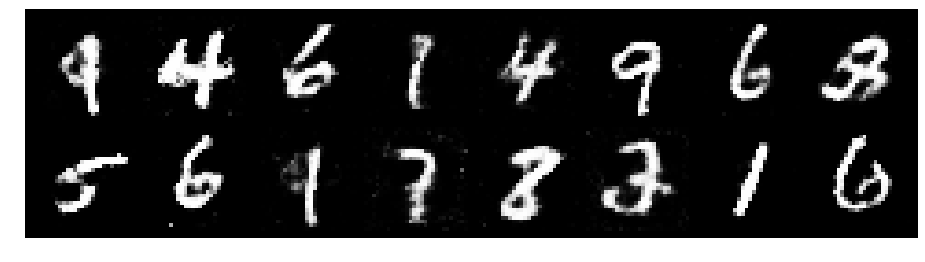

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.1726, Generator Loss: 0.8725
D(x): 0.5697, D(G(z)): 0.4026


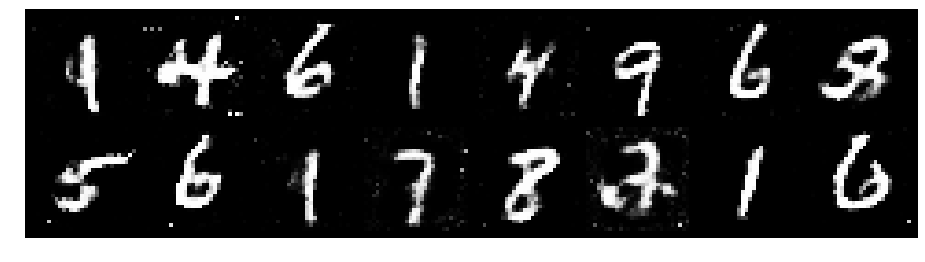

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.1913, Generator Loss: 0.8956
D(x): 0.5811, D(G(z)): 0.4175


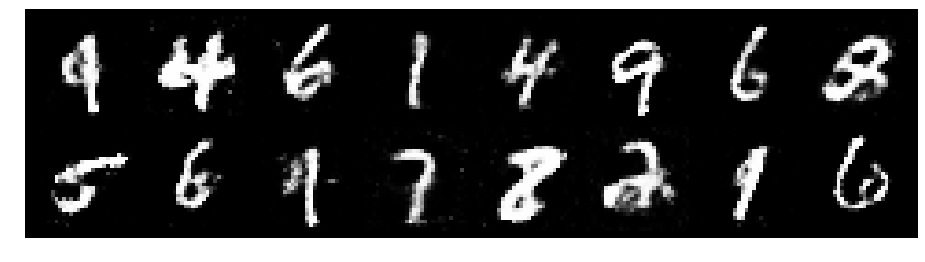

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.3109, Generator Loss: 0.7910
D(x): 0.5389, D(G(z)): 0.4434


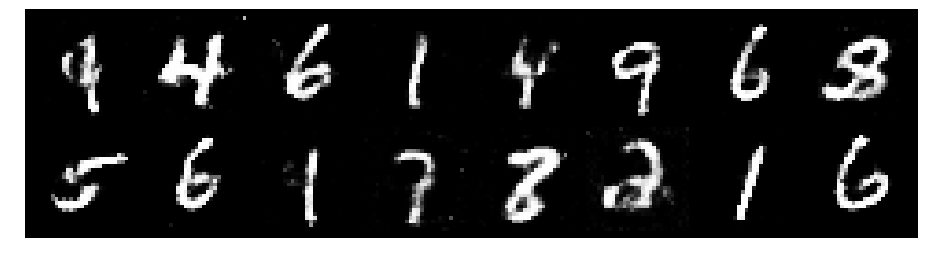

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2451, Generator Loss: 0.9666
D(x): 0.5743, D(G(z)): 0.4291


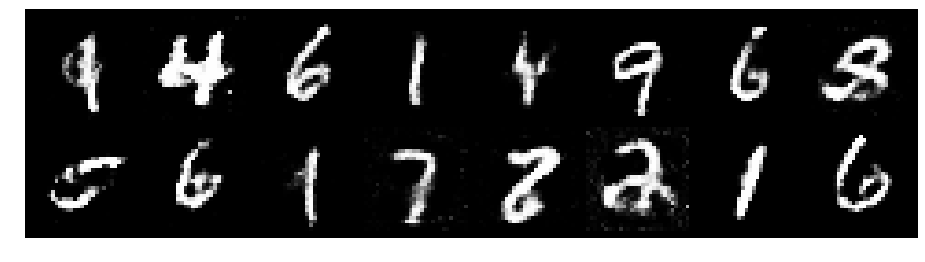

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2978, Generator Loss: 0.9263
D(x): 0.5267, D(G(z)): 0.4434


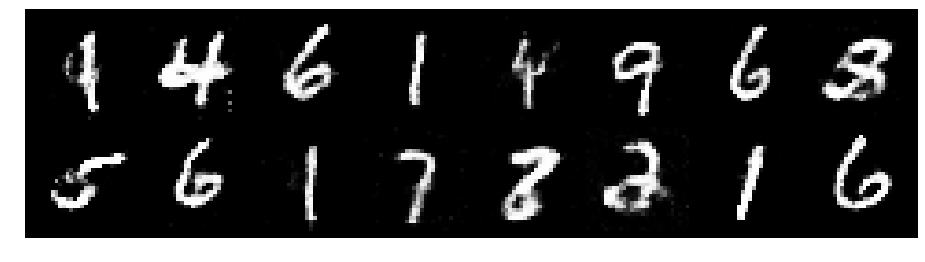

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.2047, Generator Loss: 0.9426
D(x): 0.5960, D(G(z)): 0.4364


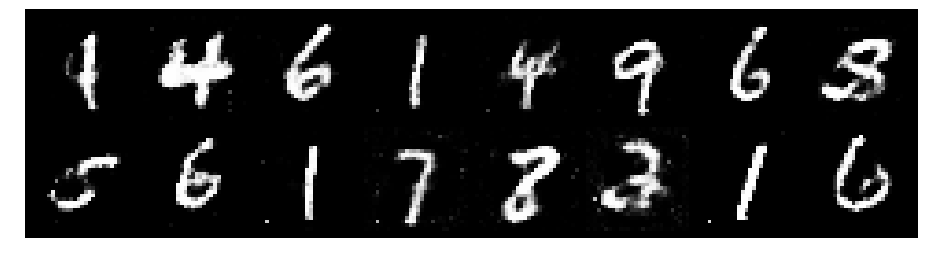

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2473, Generator Loss: 1.0656
D(x): 0.5541, D(G(z)): 0.3848


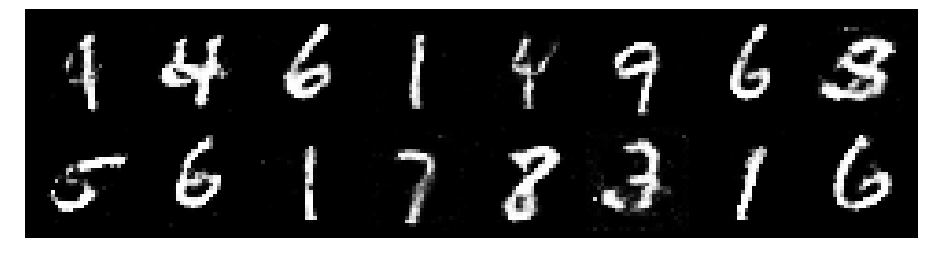

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2386, Generator Loss: 0.9913
D(x): 0.5499, D(G(z)): 0.4163


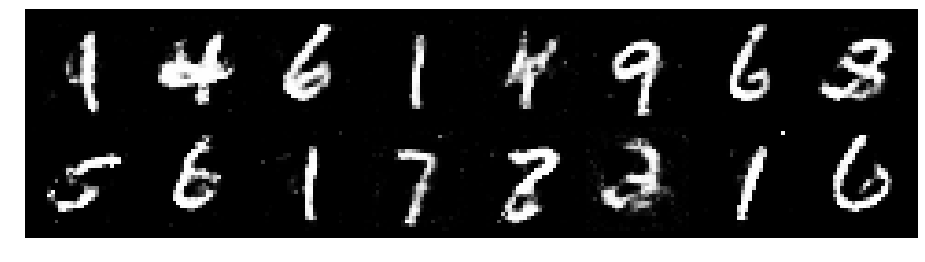

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2379, Generator Loss: 0.8648
D(x): 0.5802, D(G(z)): 0.4599


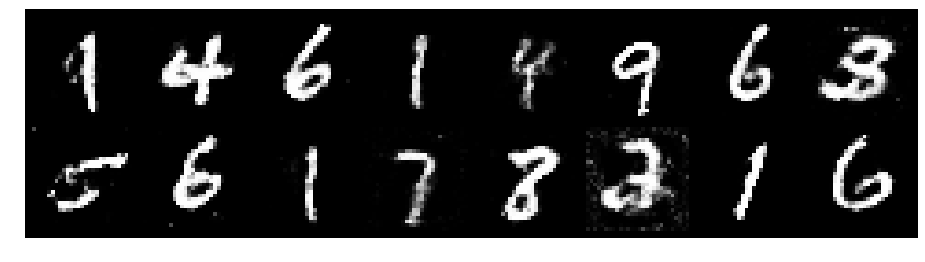

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.2010, Generator Loss: 1.0244
D(x): 0.5830, D(G(z)): 0.4145


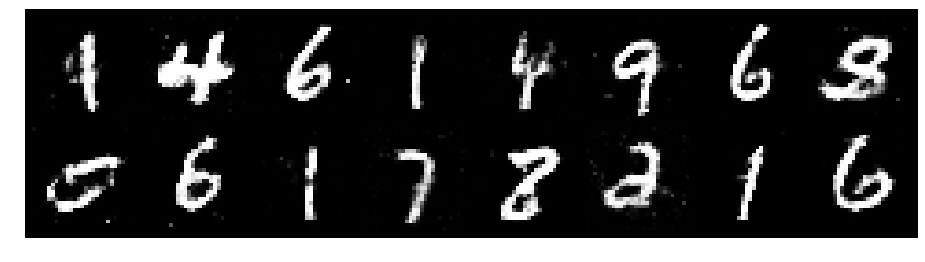

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2178, Generator Loss: 0.9199
D(x): 0.6092, D(G(z)): 0.4391


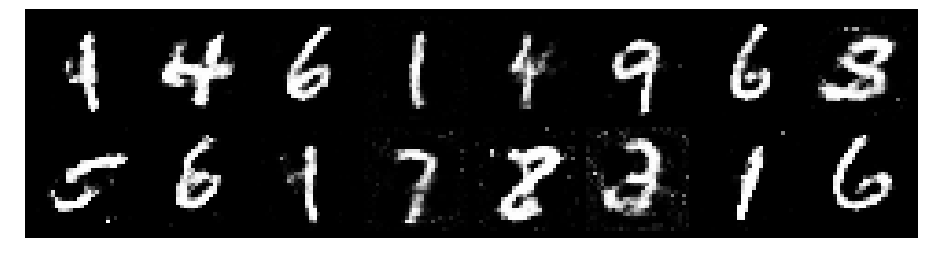

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2901, Generator Loss: 0.7385
D(x): 0.5680, D(G(z)): 0.4759


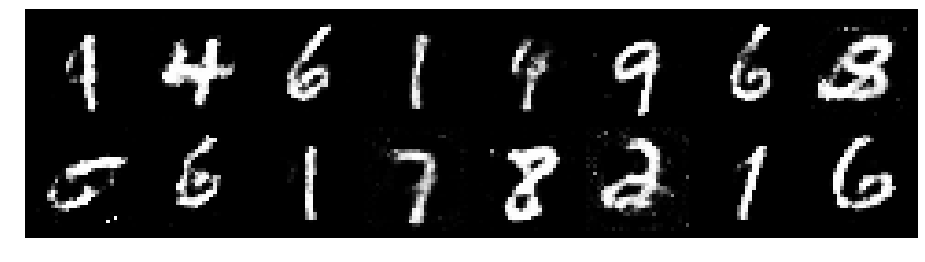

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.3303, Generator Loss: 0.8129
D(x): 0.5689, D(G(z)): 0.4848


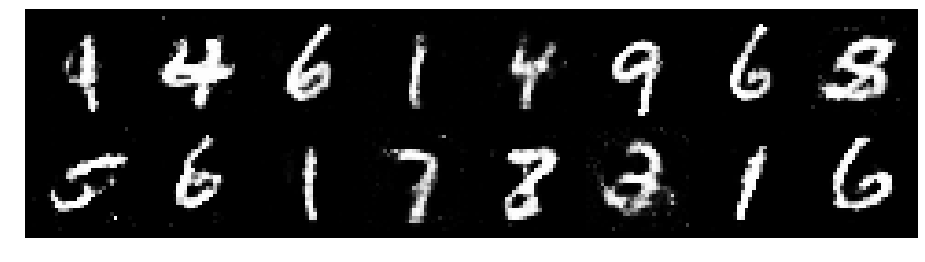

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.1666, Generator Loss: 0.8574
D(x): 0.5896, D(G(z)): 0.4279


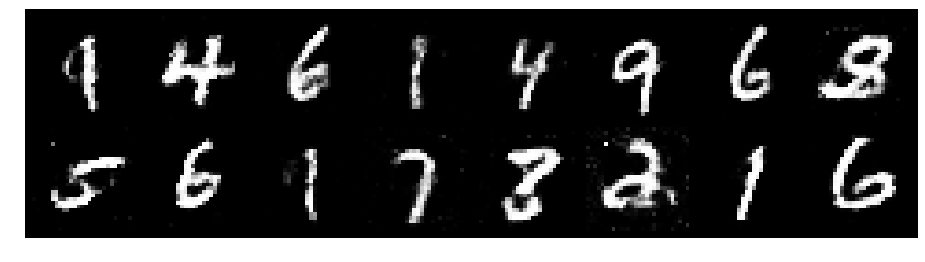

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2737, Generator Loss: 0.9961
D(x): 0.5899, D(G(z)): 0.4667


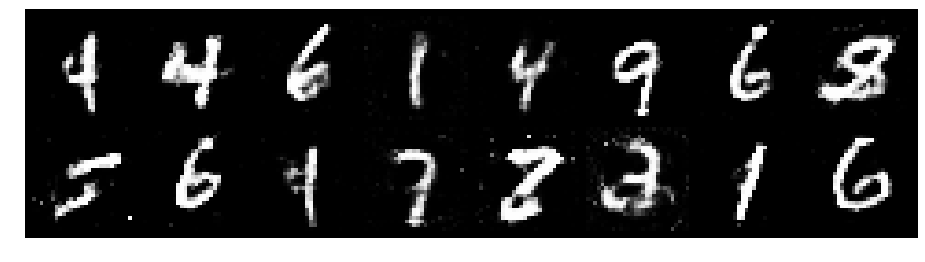

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2255, Generator Loss: 0.8822
D(x): 0.5555, D(G(z)): 0.4166


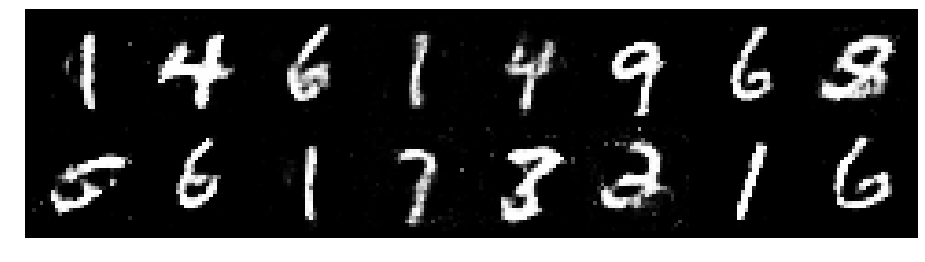

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.3383, Generator Loss: 0.8426
D(x): 0.5373, D(G(z)): 0.4592


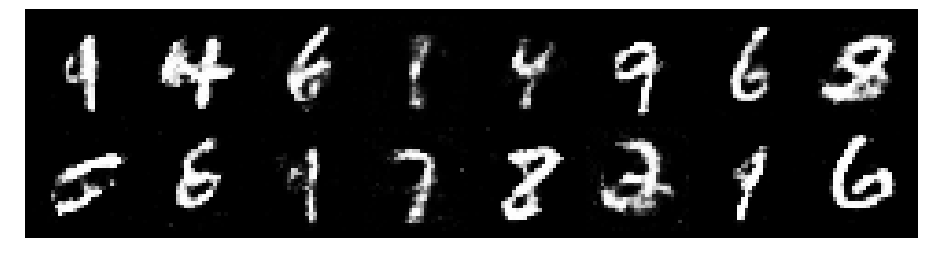

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2113, Generator Loss: 0.9073
D(x): 0.5706, D(G(z)): 0.4462


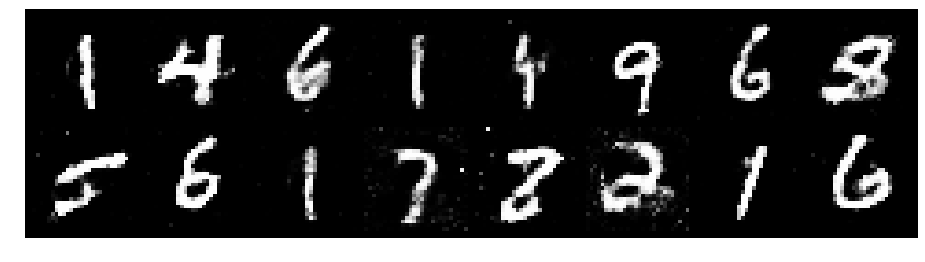

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.3926, Generator Loss: 0.7873
D(x): 0.5199, D(G(z)): 0.4900


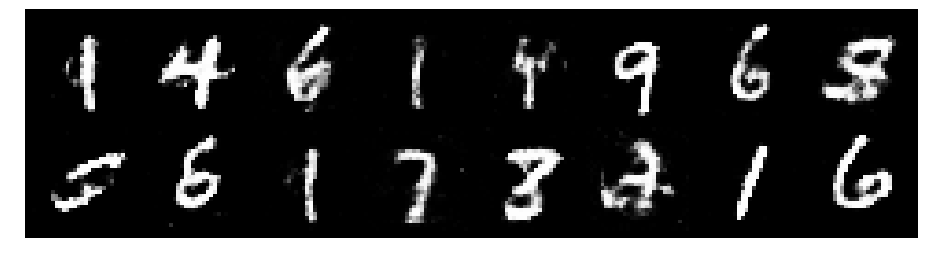

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2901, Generator Loss: 0.7361
D(x): 0.5712, D(G(z)): 0.4756


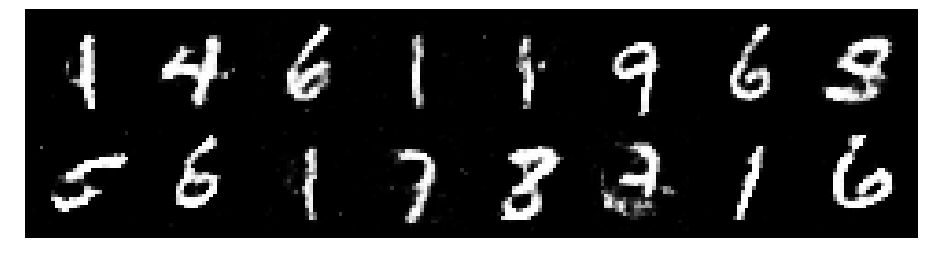

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.3514, Generator Loss: 0.8935
D(x): 0.5076, D(G(z)): 0.4463


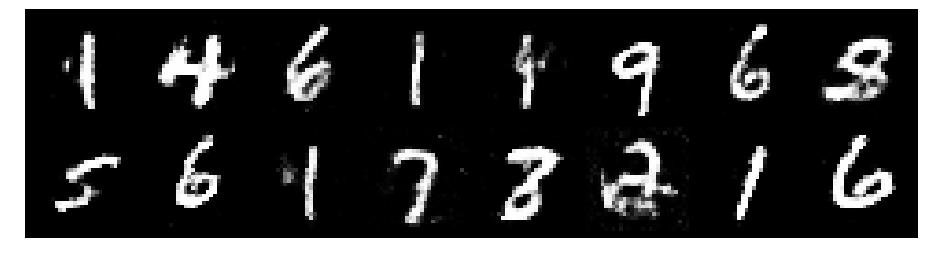

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2813, Generator Loss: 0.8546
D(x): 0.5457, D(G(z)): 0.4502


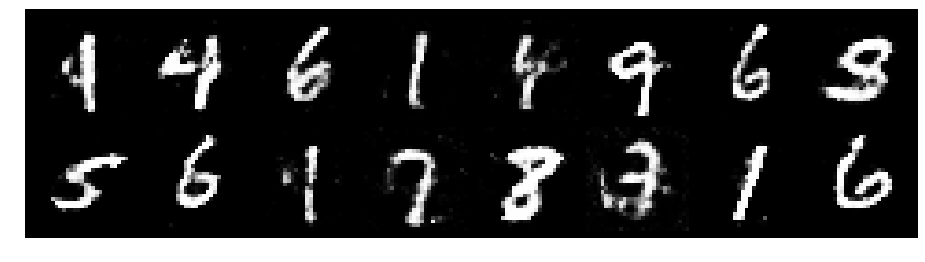

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.3813, Generator Loss: 0.7548
D(x): 0.5132, D(G(z)): 0.4657


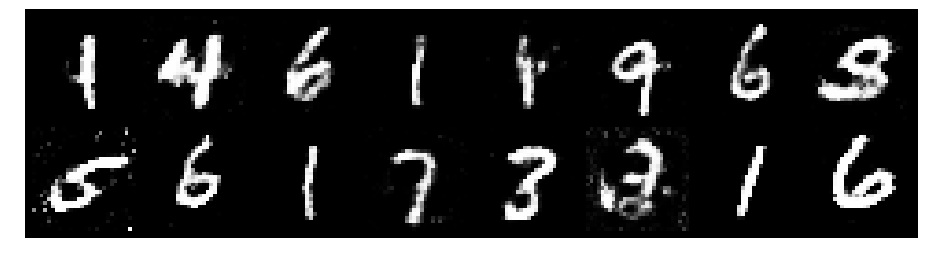

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.3327, Generator Loss: 0.8320
D(x): 0.5666, D(G(z)): 0.4854


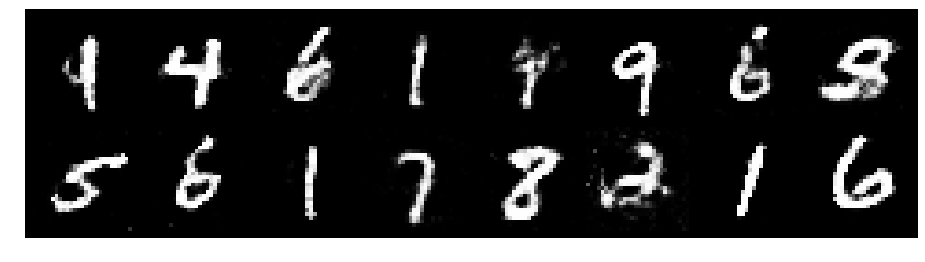

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.3304, Generator Loss: 0.8500
D(x): 0.5521, D(G(z)): 0.4722


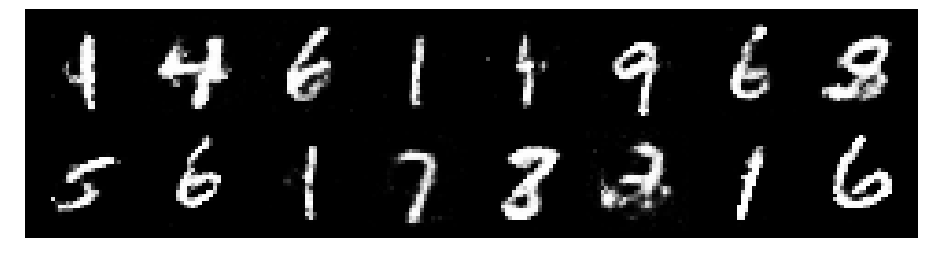

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.3057, Generator Loss: 0.7925
D(x): 0.5396, D(G(z)): 0.4727


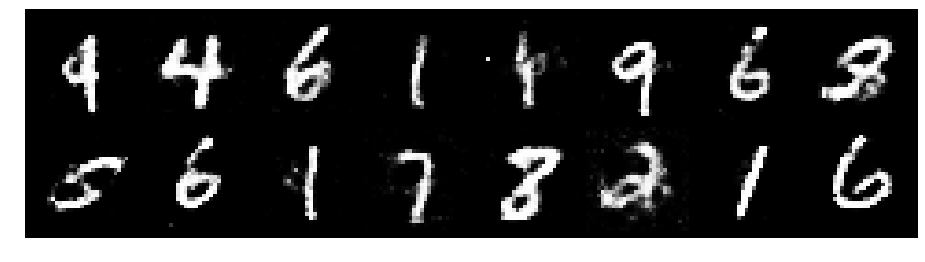

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.3680, Generator Loss: 0.7977
D(x): 0.5612, D(G(z)): 0.4992


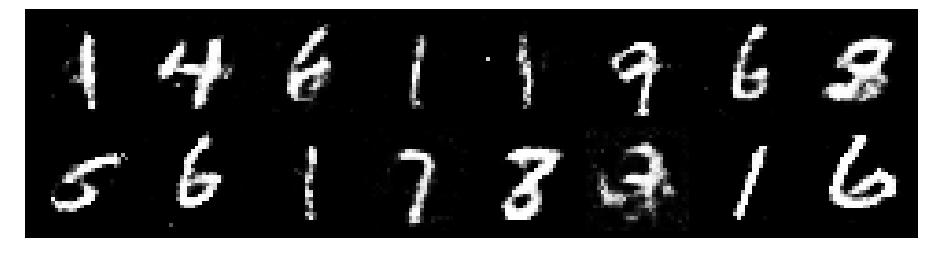

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.2800, Generator Loss: 0.7917
D(x): 0.5420, D(G(z)): 0.4568


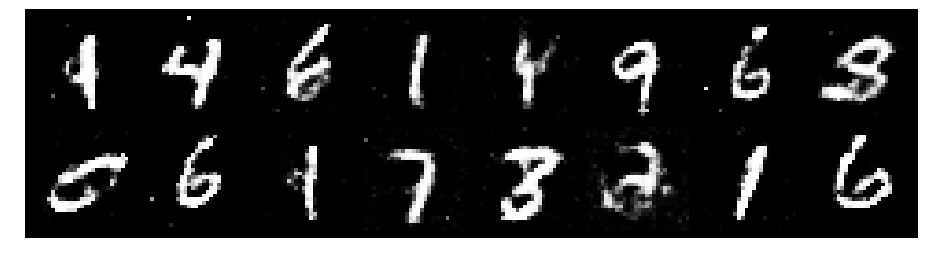

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.3556, Generator Loss: 0.8632
D(x): 0.5356, D(G(z)): 0.4709


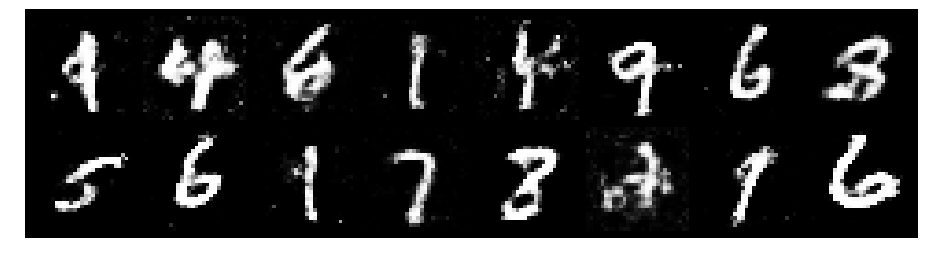

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.2117, Generator Loss: 0.8612
D(x): 0.5983, D(G(z)): 0.4516


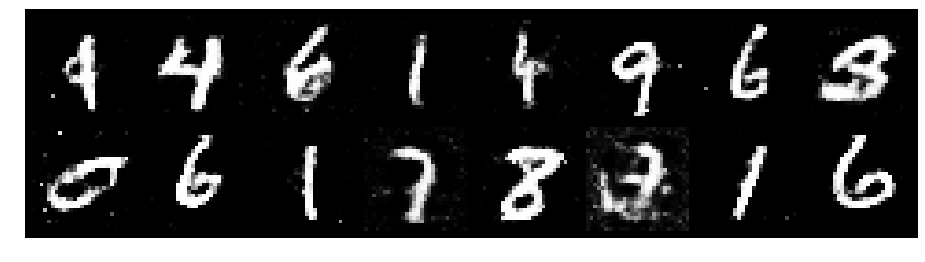

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2658, Generator Loss: 0.8692
D(x): 0.5533, D(G(z)): 0.4567


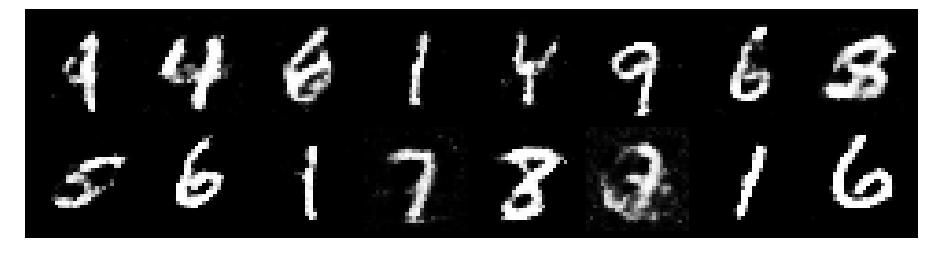

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.2154, Generator Loss: 0.9593
D(x): 0.6098, D(G(z)): 0.4495


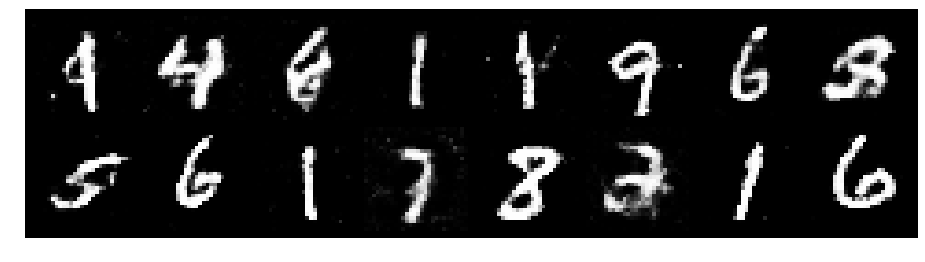

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.3048, Generator Loss: 0.8568
D(x): 0.5196, D(G(z)): 0.4440


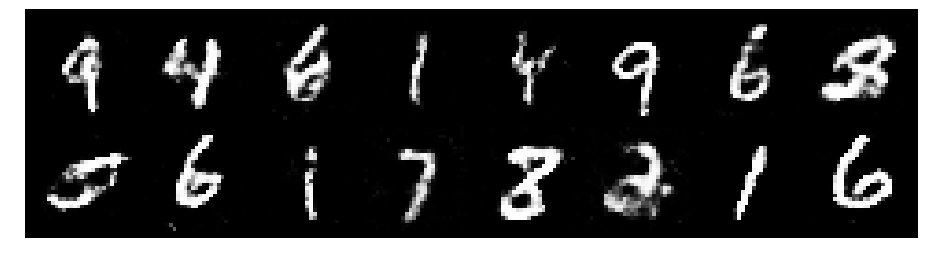

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.2325, Generator Loss: 0.8782
D(x): 0.5935, D(G(z)): 0.4555


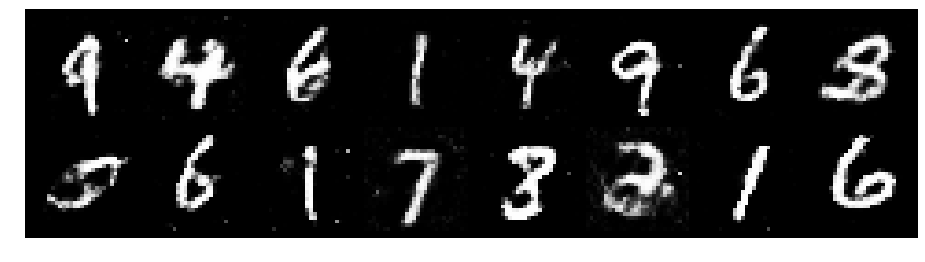

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3015, Generator Loss: 0.7848
D(x): 0.5275, D(G(z)): 0.4648


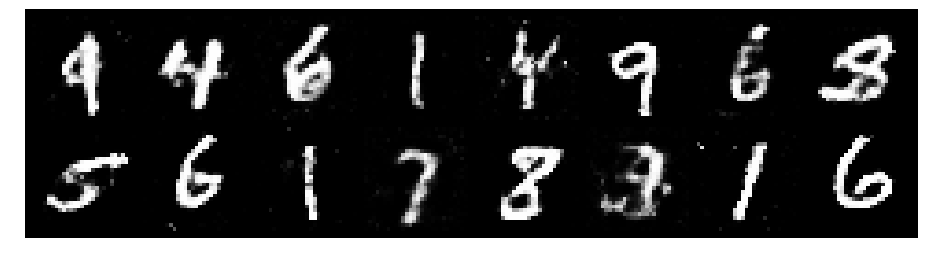

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.2795, Generator Loss: 0.7556
D(x): 0.5806, D(G(z)): 0.4766


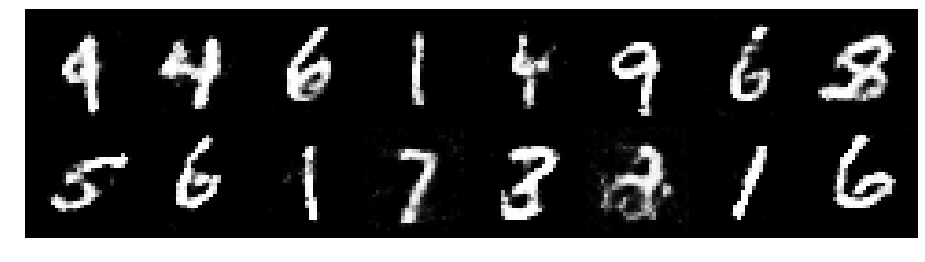

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.3286, Generator Loss: 0.9644
D(x): 0.5500, D(G(z)): 0.4357


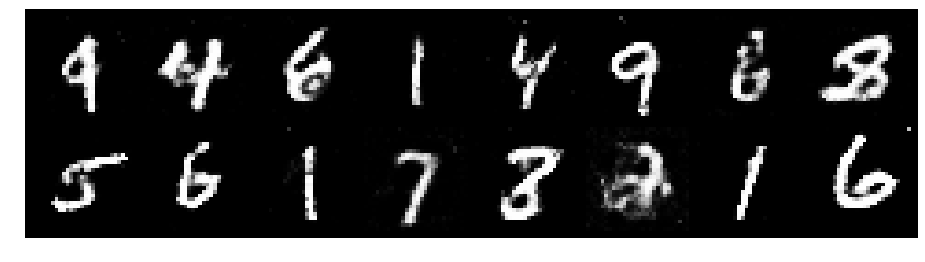

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.3794, Generator Loss: 0.9735
D(x): 0.5286, D(G(z)): 0.4407


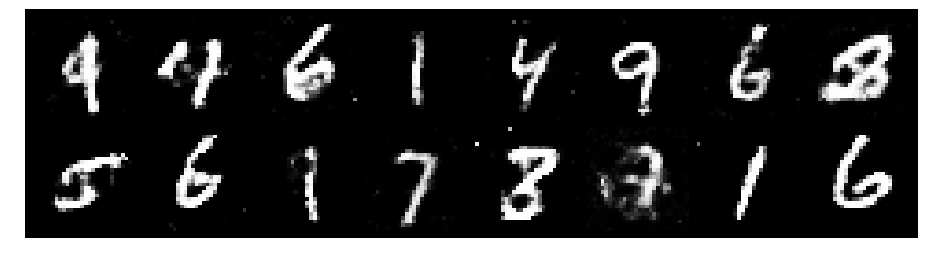

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.4078, Generator Loss: 0.8992
D(x): 0.5556, D(G(z)): 0.4881


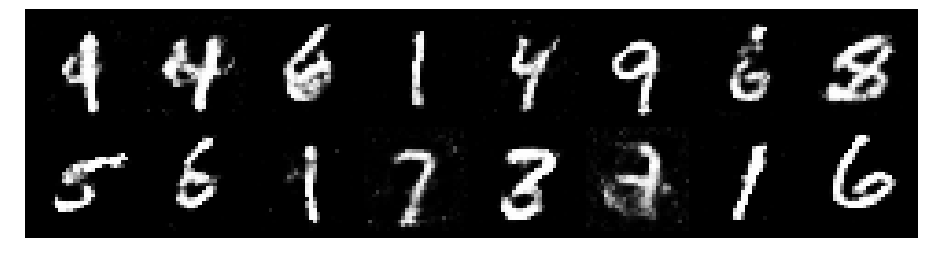

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2897, Generator Loss: 0.9618
D(x): 0.5469, D(G(z)): 0.4453


In [0]:
#Training

# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')

# Total number of epochs to train
num_epochs = 200

for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)

        # 1. Train Discriminator
        real_data = Variable(images_to_vectors(real_batch).cuda())

        # Generate fake data and detach 
        # (so gradients are not calculated for generator)
        fake_data = generator((noise(N).cuda().detach()))

        # Train D
        d_error, d_pred_real, d_pred_fake = \
              train_discriminator(d_optimizer, real_data.cuda(), fake_data.cuda())

        # 2. Train Generator

        # Generate fake data
        fake_data = generator(noise(N).cuda())

        # Train G
        g_error = train_generator(g_optimizer, fake_data)

        # Log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)

        # Display Progress every few batches
        if (n_batch) % 100 == 0: 
            test_images = vectors_to_images(generator(test_noise.cuda()))
            test_images = test_images.data

            logger.log_images(
                test_images.cpu(), num_test_samples, 
                epoch, n_batch, num_batches
            );
            # Display status Logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )

In [18]:
torch.cuda.is_available()

True